In [1]:
# https://www.datacamp.com/community/tutorials/categorical-data
#https://www.reneshbedre.com/blog/principal-component-analysis.html
#https://towardsdatascience.com/principal-component-analysis-algorithm-in-real-life-discovering-patterns-in-a-real-estate-dataset-18134c57ffe7
# https://medium.com/machine-learning-researcher/dimensionality-reduction-pca-and-lda-6be91734f567
#https://academic.oup.com/gji/article/136/2/477/694472
# https://www.oreilly.com/library/view/python-data-science/9781491912126/ch04.html
# https://medium.com/apprentice-journal/pca-application-in-machine-learning-4827c07a61db#:~:text=Principal%20Component%20Analysis%20(PCA)%20is,dimensionality%20reduction%20in%20machine%20learning.
# https://www.kaggle.com/miguelangelnieto/pca-and-regression
# https://realpython.com/python-ai-neural-network/
#!pip install NumPy
#!pip install pandas
#!pip install --user tensorflow
#!pip install --user matplotlib
#!pip install seaborn
#!pip install --user numpy
#!pip install missingno
#!pip install numpy 
#!pip install nnv
#!pip install prince
#!pip uninstall bioinfokit
#!conda install -c bioconda bioinfokit
#!pip install dataframe_image               ####https://pypi.org/project/dataframe-image/
#!pip install jpype1
#!python -m pip install pysimplegui     GUI with Python
#!pip install ggplot
#!pip install feature_selector

In [2]:
# https://www.kaggle.com/miguelangelnieto/pca-and-regression
# https://jakevdp.github.io/PythonDataScienceHandbook/05.09-principal-component-analysis.html
# https://www.kaggle.com/ashydv/country-clustering-hierarchical-clustering-pca
# https://www.datacamp.com/community/tutorials/introduction-factor-analysis
# https://nirpyresearch.com/pca-kernel-pca-explained/
# https://www.kaggle.com/lambdaofgod/kernel-pca-examples
# https://cmdlinetips.com/2019/07/dimensionality-reduction-with-tsne/
# https://towardsdatascience.com/5-must-know-dimensionality-reduction-techniques-via-prince-e6ffb27e55d1
# https://datascienceplus.com/selecting-categorical-features-in-customer-attrition-prediction-using-python/
# http://www.math.u-bordeaux.fr/~mchave100p/wordpress/wp-content/uploads/2013/10/ACM-M2.pdf
# http://www.sthda.com/english/articles/31-principal-component-methods-in-r-practical-guide/115-famd-factor-analysis-of-mixed-data-in-r-essentials/
# https://github.com/MaxHalford/Prince#factor-analysis-of-mixed-data-famd
#https://chrisalbon.com/machine_learning/feature_selection/drop_highly_correlated_features/

#!pip list | grep numpy

In [630]:
import os
import pandas as pd
import seaborn as sns
import matplotlib.pyplot as plt
import dataframe_image as dfi
from matplotlib.patches import PathPatch
import numpy as np
import scipy.cluster.hierarchy as sch
from scipy.stats import pearsonr
from scipy.cluster.hierarchy import dendrogram
#import category_encoders as ce

In [631]:
from mpl_toolkits.mplot3d import Axes3D
import re
from collections import OrderedDict
from time import time
import sqlite3       

from scipy.linalg import svd   
from scipy import stats
from sklearn.decomposition import TruncatedSVD

from sklearn.manifold import TSNE
from scipy.sparse import csr_matrix
#from ggplot import *

from pandas import Timestamp
plt.rcParams['figure.facecolor'] = 'none'
plt.rcParams["font.weight"] = "bold"
plt.rcParams["axes.labelweight"] = "bold"
plt.rcParams.update({'font.size': 22})

import warnings
warnings.filterwarnings('ignore')

In [632]:
from sklearn.cluster import AgglomerativeClustering
from scipy.cluster.hierarchy import dendrogram , linkage
from sklearn.decomposition import PCA

In [633]:
# printing bold and blue output text for standout
from IPython.display import Markdown, display
def printmd(string, color=None):
    colorstr = "<span style='color:{}'>{}</span>".format(color, string)
    display(Markdown(colorstr))

#printmd("**bold and blue**", color="blue")

In [634]:
df15EIS=pd.read_csv('15EIS.csv')
df001=pd.read_csv('dd0001.csv')
df002=pd.read_csv('dd0002.csv')
df003=pd.read_csv('dd0003B.csv')
df004=pd.read_csv('dd0004.csv')

In [635]:
print('15EIS hole shape :',df15EIS.shape)
print('dd001 hole shape :',df001.shape)
print('dd002 hole shape :',df002.shape)
print('dd003 hole shape :',df003.shape)
print('dd004 hole shape :',df004.shape)

15EIS hole shape : (2409, 200)
dd001 hole shape : (669, 200)
dd002 hole shape : (703, 200)
dd003 hole shape : (905, 200)
dd004 hole shape : (1401, 200)


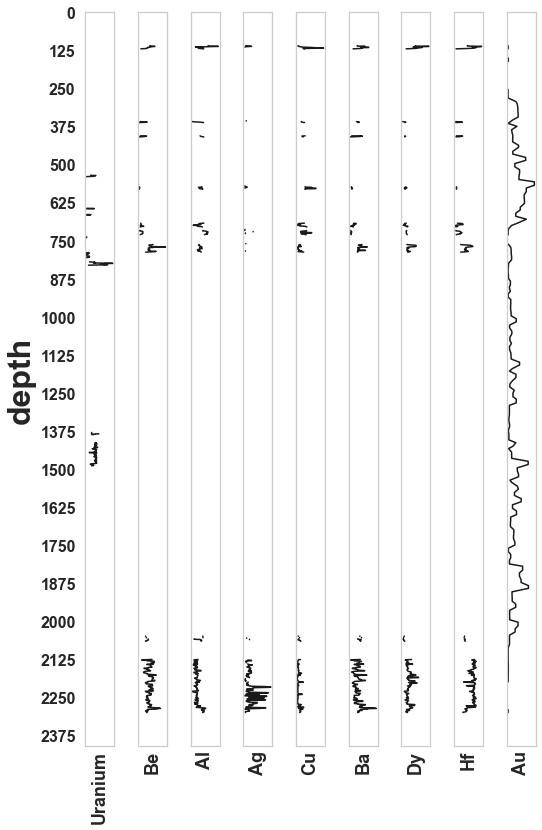

In [636]:
# https://towardsdatascience.com/displaying-lithology-data-using-python-and-matplotlib-58b4d251ee7a
# https://towardsdatascience.com/enhancing-visualization-of-well-logs-with-plot-fills-72d9dcd10c1b


fig = plt.figure(figsize=(8,12))
ax1 = fig.add_subplot(191)
ax1.plot(df15EIS['U_ppm'].values, df15EIS['Depth_m'].values, 'k')
ax1.invert_yaxis()
ax1.set_ylabel('depth',fontsize=32)
ax1.grid(which='minor', alpha=0)
ax1.grid(which='major', alpha=0)
ax1.set_ylim(2410, 0)
ax1.set_yticks(np.arange(0, 2450, 125))
ax1.tick_params(axis='y', labelsize=16)
ax1.set_xticks([])
ax1.set_xlabel('Uranium',rotation=90,fontsize=18)

ax1 = fig.add_subplot(192)
ax1.plot(df15EIS['Be_ppm'].values, df15EIS['Depth_m'].values, 'k')
ax1.invert_yaxis()
ax1.xaxis.tick_top()
ax1.set_xlabel('Be',rotation=90, fontsize=18)
ax1.set_xticks([])
ax1.set_yticks([])

ax1 = fig.add_subplot(193)
ax1.plot(df15EIS['Al_ppm'].values, df15EIS['Depth_m'].values, 'k')
ax1.invert_yaxis()
ax1.xaxis.tick_top()
ax1.set_xlabel('Al',rotation=90, fontsize=18)
ax1.set_xticks([])
ax1.set_yticks([])

ax1 = fig.add_subplot(194)
ax1.plot(df15EIS['Ag_ppm'].values, df15EIS['Depth_m'].values, 'k')
ax1.invert_yaxis()
ax1.xaxis.tick_top()
ax1.set_xlabel('Ag',rotation=90, fontsize=18)
ax1.set_xticks([])
ax1.set_yticks([])

ax1 = fig.add_subplot(195)
ax1.plot(df15EIS['Cu_ppm'].values, df15EIS['Depth_m'].values, 'k')
ax1.invert_yaxis()
ax1.xaxis.tick_top()
ax1.set_xlabel('Cu',rotation=90,fontsize=18)
ax1.set_xticks([])
ax1.set_yticks([])

ax1 = fig.add_subplot(196)
ax1.plot(df15EIS['Ba_ppm'].values, df15EIS['Depth_m'].values, 'k')
ax1.invert_yaxis()
ax1.xaxis.tick_top()
ax1.set_xlabel('Ba',rotation=90,fontsize=18)
ax1.set_xticks([])
ax1.set_yticks([])

ax1 = fig.add_subplot(197)
ax1.plot(df15EIS['Dy_ppm'].values, df15EIS['Depth_m'].values, 'k')
ax1.invert_yaxis()
ax1.xaxis.tick_top()
ax1.set_xlabel('Dy',rotation=90,fontsize=18)
ax1.set_xticks([])
ax1.set_yticks([])

ax1 = fig.add_subplot(198)
ax1.plot(df15EIS['Hf_ppm'].values, df15EIS['Depth_m'].values, 'k')
ax1.invert_yaxis()
ax1.xaxis.tick_top()
ax1.set_xlabel('Hf',rotation=90,fontsize=18)
ax1.set_xticks([])
ax1.set_yticks([])

ax1 = fig.add_subplot(199)
ax1.plot(df15EIS['Au_ppm'].values, df15EIS['Depth_m'].values, 'k')
ax1.invert_yaxis()
ax1.xaxis.tick_top()
ax1.set_xlabel('Au',rotation=90,fontsize=18)
ax1.set_xticks([])
ax1.set_yticks([])

plt.tight_layout()
plt.show()

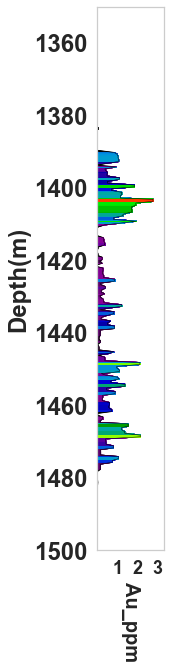

In [637]:
#ax.tick_params(axis='y', labelsize=32)
left_col_value = df15EIS['Au_ppm'].min()
right_col_value = df15EIS['Au_ppm'].max()+df15EIS['Au_ppm'].max()*0.20

#assign the column to a variable for easier reading
curve = df15EIS['Au_ppm']

#calculate the span of values
span = abs(left_col_value - right_col_value)

#assign a color map
cmap = plt.get_cmap('nipy_spectral')

#create array of values to divide up the area under curve
color_index = np.arange(left_col_value, right_col_value, span / 100)

#setup the plot
#df15EIS.plot(x='Res_Deep', y='Depth_m', c='black', lw=0.5, legend=False, figsize=(3,10))
df15EIS.plot(x='Au_ppm', y='Depth_m', c='black', lw=0.5, legend=False, figsize=(1.2,10),fontsize=18)
plt.ylim(1500, 1350)
plt.ylabel('Depth(m)', fontsize=24)
plt.xlabel('Au_ppm',rotation=270,fontsize=20)
plt.yticks(fontsize=24)
#plt.yticks(np.arange(0, 2450, 250))
plt.grid(False)
plt.xlim(left_col_value, right_col_value)
#plt.title('Plot With a Variable Fill to Y-Axis')

#loop through each value in the color_index
for index in sorted(color_index):
    index_value = (index - left_col_value)/span
    color = cmap(index_value) #obtain colour for color index value
    plt.fill_betweenx(df15EIS['Depth_m'], 0 , curve, where = curve >= index,  color = color)
    
plt.show()

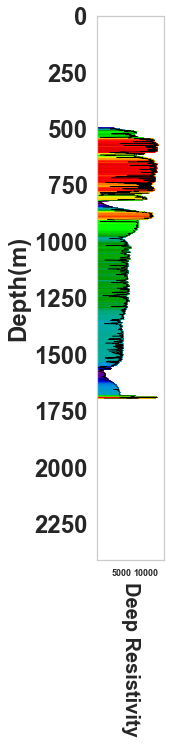

In [638]:
left_col_value = df15EIS['Res_Deep'].min()
right_col_value = df15EIS['Res_Deep'].max()+df15EIS['Res_Deep'].max()*0.10

#assign the column to a variable for easier reading
curve = df15EIS['Res_Deep']

#calculate the span of values
span = abs(left_col_value - right_col_value)

#assign a color map
cmap = plt.get_cmap('nipy_spectral')

#create array of values to divide up the area under curve
color_index = np.arange(left_col_value, right_col_value, span / 100)

#setup the plot
#df15EIS.plot(x='Res_Deep', y='Depth_m', c='black', lw=0.5, legend=False, figsize=(3,10))
df15EIS.plot(x='Res_Deep', y='Depth_m', c='black', lw=0.5, legend=False, figsize=(1.2,10),fontsize=9)
plt.ylim(2409, 0)
plt.yticks(np.arange(0,2409,250),fontsize=24)
plt.ylabel('Depth(m)', fontsize=24)
plt.xlabel('Deep Resistivity',rotation=270,fontsize=20)
plt.grid(False)
plt.xlim(left_col_value, right_col_value)
#plt.title('Plot With a Variable Fill to Y-Axis')

#loop through each value in the color_index
for index in sorted(color_index):
    index_value = (index - left_col_value)/span
    color = cmap(index_value) #obtain colour for color index value
    plt.fill_betweenx(df15EIS['Depth_m'], 0 , curve, where = curve >= index,  color = color)
    
plt.show()

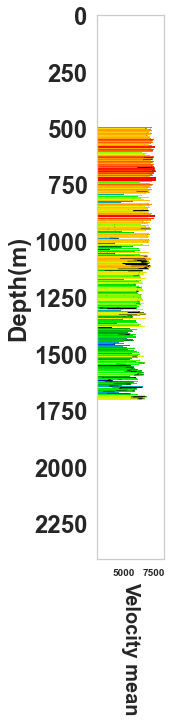

In [639]:
left_col_value = df15EIS['Vel_geomean_ms'].min()
right_col_value = df15EIS['Vel_geomean_ms'].max()+df15EIS['Vel_geomean_ms'].max()*0.10

#assign the column to a variable for easier reading
curve = df15EIS['Vel_geomean_ms']

#calculate the span of values
span = abs(left_col_value - right_col_value)

#assign a color map
cmap = plt.get_cmap('nipy_spectral')

#create array of values to divide up the area under curve
color_index = np.arange(left_col_value, right_col_value, span / 100)

#setup the plot
#df15EIS.plot(x='Res_Deep', y='Depth_m', c='black', lw=0.5, legend=False, figsize=(3,10))
df15EIS.plot(x='Vel_geomean_ms', y='Depth_m', c='black', lw=0.5, legend=False, figsize=(1.2,10),fontsize=10)
plt.ylim(2409, 0)
#plt.yticks(fontsize=24)
plt.yticks(np.arange(0,2409,250),fontsize=24)
plt.ylabel('Depth(m)', fontsize=24)
plt.xlabel('Velocity mean',rotation=270,fontsize=20)
plt.grid(False)
plt.xlim(left_col_value, right_col_value)
#plt.title('Plot With a Variable Fill to Y-Axis')

#loop through each value in the color_index
for index in sorted(color_index):
    index_value = (index - left_col_value)/span
    color = cmap(index_value) #obtain colour for color index value
    plt.fill_betweenx(df15EIS['Depth_m'], 0 , curve, where = curve >= index,  color = color)
    
plt.show()

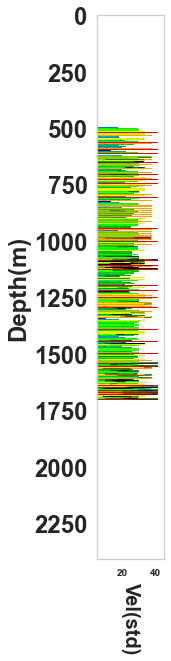

In [640]:
left_col_value = df15EIS['Vel_std_ms'].min()
right_col_value = df15EIS['Vel_std_ms'].max()+df15EIS['Vel_std_ms'].max()*0.10

#assign the column to a variable for easier reading
curve = df15EIS['Vel_std_ms']

#calculate the span of values
span = abs(left_col_value - right_col_value)

#assign a color map
cmap = plt.get_cmap('nipy_spectral')

#create array of values to divide up the area under curve
color_index = np.arange(left_col_value, right_col_value, span / 100)

#setup the plot
#df15EIS.plot(x='Res_Deep', y='Depth_m', c='black', lw=0.5, legend=False, figsize=(3,10))
df15EIS.plot(x='Vel_std_ms', y='Depth_m', c='black', lw=0.5, legend=False, figsize=(1.2,10),fontsize=10)
plt.ylim(2409, 0)
#plt.yticks(fontsize=24)
plt.yticks(np.arange(0,2409,250),fontsize=24)
plt.ylabel('Depth(m)', fontsize=24)
plt.xlabel('Vel(std)',rotation=270,fontsize=20)
plt.grid(False)
plt.xlim(left_col_value, right_col_value)
#plt.title('Plot With a Variable Fill to Y-Axis')

#loop through each value in the color_index
for index in sorted(color_index):
    index_value = (index - left_col_value)/span
    color = cmap(index_value) #obtain colour for color index value
    plt.fill_betweenx(df15EIS['Depth_m'], 0 , curve, where = curve >= index,  color = color)
    
plt.show()

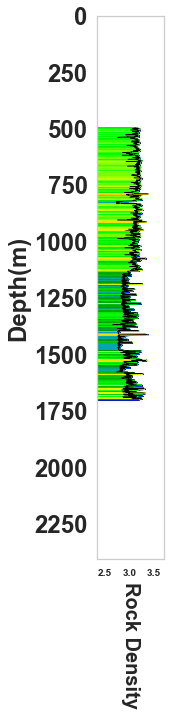

In [641]:
left_col_value = df15EIS['SSD_gcc'].min()
right_col_value = df15EIS['SSD_gcc'].max()+df15EIS['SSD_gcc'].max()*0.10

#assign the column to a variable for easier reading
curve = df15EIS['SSD_gcc']

#calculate the span of values
span = abs(left_col_value - right_col_value)

#assign a color map
cmap = plt.get_cmap('nipy_spectral')

#create array of values to divide up the area under curve
color_index = np.arange(left_col_value, right_col_value, span / 100)

#setup the plot
#df15EIS.plot(x='Res_Deep', y='Depth_m', c='black', lw=0.5, legend=False, figsize=(3,10))
df15EIS.plot(x='SSD_gcc', y='Depth_m', c='black', lw=0.5, legend=False, figsize=(1.2,10),fontsize=10)
plt.ylim(2409, 0)
#plt.yticks(fontsize=24)
plt.yticks(np.arange(0,2409,250),fontsize=24)
plt.ylabel('Depth(m)', fontsize=24)
plt.xlabel('Rock Density',rotation=270,fontsize=20)
plt.grid(False)
plt.xlim(left_col_value, right_col_value)
#plt.title('Plot With a Variable Fill to Y-Axis')

#loop through each value in the color_index
for index in sorted(color_index):
    index_value = (index - left_col_value)/span
    color = cmap(index_value) #obtain colour for color index value
    plt.fill_betweenx(df15EIS['Depth_m'], 0 , curve, where = curve >= index,  color = color)
    
plt.show()

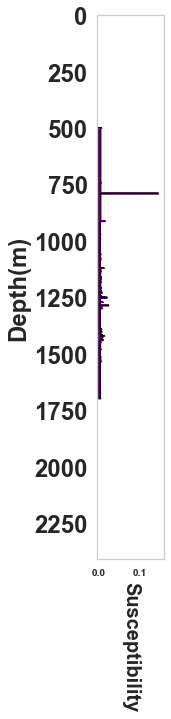

In [642]:
left_col_value = df15EIS['Susc_SI_10-3'].min()
right_col_value = df15EIS['Susc_SI_10-3'].max()+df15EIS['Susc_SI_10-3'].max()*0.1

#assign the column to a variable for easier reading
curve = df15EIS['Susc_SI_10-3']

#calculate the span of values
span = abs(left_col_value - right_col_value)

#assign a color map
cmap = plt.get_cmap('nipy_spectral')

#create array of values to divide up the area under curve
color_index = np.arange(left_col_value, right_col_value, span / 100)

#setup the plot
#df15EIS.plot(x='Res_Deep', y='Depth_m', c='black', lw=0.5, legend=False, figsize=(3,10))
df15EIS.plot(x='Susc_SI_10-3', y='Depth_m', c='black', lw=0.5, legend=False, figsize=(1.2,10),fontsize=10)
plt.ylim(2409, 0)
#plt.yticks(fontsize=24)
plt.yticks(np.arange(0,2409,250),fontsize=24)
plt.ylabel('Depth(m)', fontsize=24)
plt.xlabel('Susceptibility',rotation=270,fontsize=20)
plt.grid(False)
plt.xlim(left_col_value, right_col_value)
#plt.title('Plot With a Variable Fill to Y-Axis')

#loop through each value in the color_index
for index in sorted(color_index):
    index_value = (index - left_col_value)/span
    color = cmap(index_value) #obtain colour for color index value
    plt.fill_betweenx(df15EIS['Depth_m'], 0 , curve, where = curve >= index,  color = color)
    
plt.show()

In [643]:
pd.set_option('display.max_rows',None)
pd.set_option('display.max_column', None)

In [646]:
# convert dataframe as an image 
#!pip install dataframe_image
#import dataframe_image as dfi

In [647]:
df15EIS.describe(include='all').T

,count,unique,top,freq,mean,std,min,25%,50%,75%,max
Hole,2409,1,15EIS,2409,NaN,NaN,NaN,NaN,NaN,NaN,NaN
Row_index,2409,NaN,NaN,NaN,1205,695.563,1,603,1205,1807,2409
Ag_ppm,180,NaN,NaN,NaN,0.178822,0.139925,0.05,0.09,0.14,0.2,0.694
Al_ppm,240,NaN,NaN,NaN,66439.9,8870.17,49933,61293.7,63608.5,71347,113444
Alpha,348,NaN,NaN,NaN,57.2201,15.3623,5,50,60,65,90
Alt1_Code,2409,13,ch,1695,NaN,NaN,NaN,NaN,NaN,NaN,NaN
Alt1_Int,2409,5,s,1054,NaN,NaN,NaN,NaN,NaN,NaN,NaN
Alt1_Style,2409,4,pr,2306,NaN,NaN,NaN,NaN,NaN,NaN,NaN
Alt2_Code,2409,10,bi,1635,NaN,NaN,NaN,NaN,NaN,NaN,NaN
Alt2_Int,2409,5,m,935,NaN,NaN,NaN,NaN,NaN,NaN,NaN


In [648]:
#df15EIS_styled = df15EIS.style.background_gradient() #adding a gradient based on values in cell
#dfi.export(df15EIS_styled,"df15EIS.png")

In [649]:
#df15EIS

In [650]:
#dfi.export(df15EIS, 'df15EIS.tiff', max_rows=5, max_cols=10)

In [651]:
import missingno as msno
import matplotlib.patches as mpatches

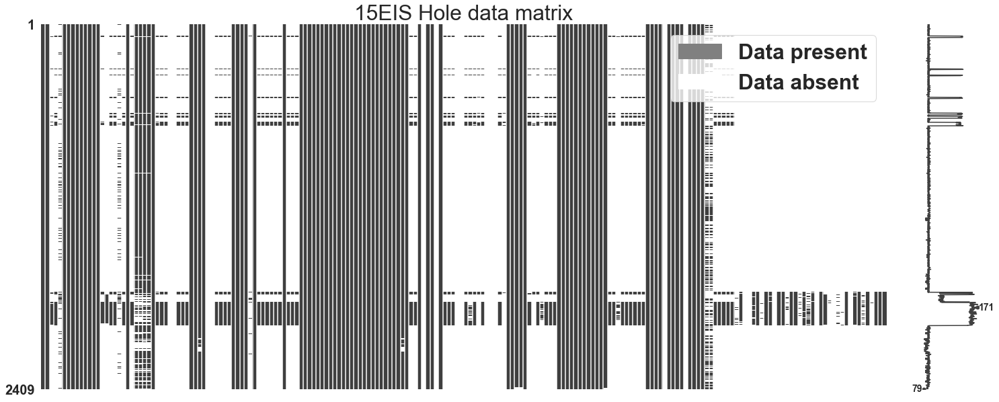

In [652]:
#plt.figure(figsize=(20,12))
#filtered_15EIS = msno.nullity_filter(df15EIS, filter='bottom', n=70, p=1) # or filter='top'
#filtered_15EIS = msno.nullity_sort(df15EIS, sort='descending') # or filter='top'
msno.matrix(df15EIS, labels=False  )
#msno.matrix(df01)
gray_patch = mpatches.Patch(color='grey', label='Data present')
white_patch = mpatches.Patch(color='white', label='Data absent ')
#plt.ylim(2409, 0)
#plt.yticks(np.arange(0, 2450, 500))
plt.legend(handles=[gray_patch, white_patch])
plt.title('15EIS Hole data matrix')
plt.tight_layout()
plt.show()

In [653]:
data_nan = df15EIS.copy()

In [654]:
for num, col in enumerate(data_nan.columns[2:]):
    data_nan[col] = data_nan[col].notnull() * (num + 1)
    data_nan[col].replace(0, num, inplace=True)

In [655]:
grouped = data_nan.groupby('Hole')
#list(grouped)

In [656]:
#Setup the labels we want to display on the x-axis
labels = ['Density_g_cm3','Vel_geomean_ms', 'Vel_std_ms', 'Res_Deep', 'Res_Shallow', 'SSD_gcc']

In [657]:
from sklearn import preprocessing
plt.rc("font", size=10)
from sklearn.linear_model import LogisticRegression
from sklearn.model_selection import train_test_split
import seaborn as sns
sns.set(style="white")
#sns.set(style="whitegrid", color_codes=True)

In [658]:
printmd(df15EIS.shape, color="blue")
printmd(df001.shape, color="blue")
printmd(df002.shape, color="blue")
printmd(df003.shape, color="blue")
printmd(df004.shape, color="blue")
#print(list(df.columns))

<span style='color:blue'>(2409, 200)</span>

<span style='color:blue'>(669, 200)</span>

<span style='color:blue'>(703, 200)</span>

<span style='color:blue'>(905, 200)</span>

<span style='color:blue'>(1401, 200)</span>

In [659]:
df1_15EIS=df15EIS[['As_ppm','Cu_ppm','Pb_ppm','Sb_ppm','W_ppm','Zn_ppm','Alt1_Code','DS_U_TIR_TSA703_Group','DS_U_TIR_TSA703_Mineral',\
       'Felsic-Mafic_Index_Wvl','Felsic-Mafic_Index_wvl_RMean','Lith1_Code','Lith1_GrainSize','Lith1_Struct_Int',\
      'Lith1_Structure','Lith1_Texture1','Res_Deep','SSD_gcc','Sulph1_Code','Sulph1_Style','Susc_SI_10-3','Depth_m','Vel_geomean_ms',\
       'Vel_std_ms','Au_ppm']]

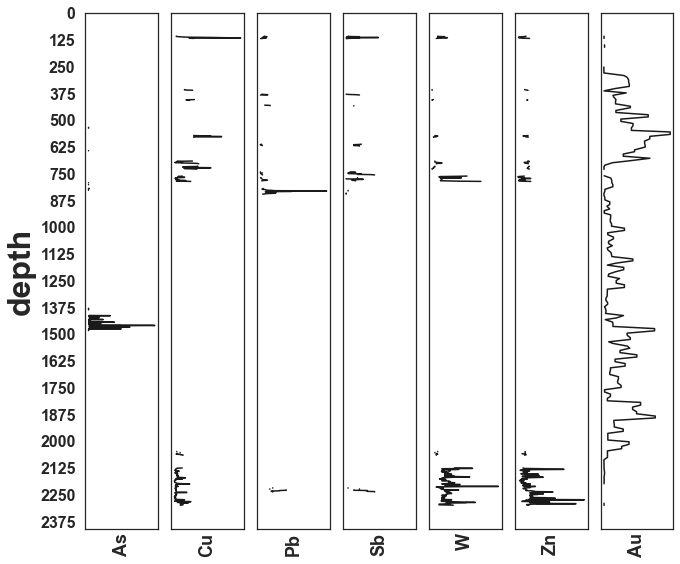

In [660]:
fig = plt.figure(figsize=(12,8))
ax1 = fig.add_subplot(191)
ax1.plot(df15EIS['As_ppm'].values, df15EIS['Depth_m'].values, 'k')
ax1.invert_yaxis()
ax1.set_ylabel('depth',fontsize=32)
ax1.grid(which='minor', alpha=0)
ax1.grid(which='major', alpha=0)
ax1.set_ylim(2410, 0)
ax1.set_yticks(np.arange(0, 2450, 125))
ax1.tick_params(axis='y', labelsize=16)
ax1.set_xticks([])
ax1.set_xlabel('As',rotation=90,fontsize=18)

ax1 = fig.add_subplot(192)
ax1.plot(df15EIS['Cu_ppm'].values, df15EIS['Depth_m'].values, 'k')
ax1.invert_yaxis()
ax1.xaxis.tick_top()
ax1.set_xlabel('Cu',rotation=90, fontsize=18)
ax1.set_xticks([])
ax1.set_yticks([])

ax1 = fig.add_subplot(193)
ax1.plot(df15EIS['Pb_ppm'].values, df15EIS['Depth_m'].values, 'k')
ax1.invert_yaxis()
ax1.xaxis.tick_top()
ax1.set_xlabel('Pb',rotation=90, fontsize=18)
ax1.set_xticks([])
ax1.set_yticks([])

ax1 = fig.add_subplot(194)
ax1.plot(df15EIS['Sb_ppm'].values, df15EIS['Depth_m'].values, 'k')
ax1.invert_yaxis()
ax1.xaxis.tick_top()
ax1.set_xlabel('Sb',rotation=90, fontsize=18)
ax1.set_xticks([])
ax1.set_yticks([])

ax1 = fig.add_subplot(195)
ax1.plot(df15EIS['W_ppm'].values, df15EIS['Depth_m'].values, 'k')
ax1.invert_yaxis()
ax1.xaxis.tick_top()
ax1.set_xlabel('W',rotation=90,fontsize=18)
ax1.set_xticks([])
ax1.set_yticks([])

ax1 = fig.add_subplot(196)
ax1.plot(df15EIS['Zn_ppm'].values, df15EIS['Depth_m'].values, 'k')
ax1.invert_yaxis()
ax1.xaxis.tick_top()
ax1.set_xlabel('Zn',rotation=90,fontsize=18)
ax1.set_xticks([])
ax1.set_yticks([])

ax1 = fig.add_subplot(197)
ax1.plot(df15EIS['Au_ppm'].values, df15EIS['Depth_m'].values, 'k')
ax1.invert_yaxis()
ax1.xaxis.tick_top()
ax1.set_xlabel('Au',rotation=90,fontsize=18)
ax1.set_xticks([])
ax1.set_yticks([])

plt.tight_layout()
plt.show()

In [661]:
#df1.shape
#df1.columns
#df15EIS.head()

In [662]:
df1_001=df001[['As_ppm','Cu_ppm','Pb_ppm','Sb_ppm','W_ppm','Zn_ppm','Alt1_Code','DS_U_TIR_TSA703_Group','DS_U_TIR_TSA703_Mineral',\
       'Felsic-Mafic_Index_Wvl','Felsic-Mafic_Index_wvl_RMean','Lith1_Code','Lith1_GrainSize','Lith1_Struct_Int',\
      'Lith1_Structure','Lith1_Texture1','Res_Deep','SSD_gcc','Sulph1_Code','Sulph1_Style','Susc_SI_10-3','Depth_m','Vel_geomean_ms',\
       'Vel_std_ms','Au_ppm']]

df1_002=df002[['As_ppm','Cu_ppm','Pb_ppm','Sb_ppm','W_ppm','Zn_ppm','Alt1_Code','DS_U_TIR_TSA703_Group','DS_U_TIR_TSA703_Mineral',\
       'Felsic-Mafic_Index_Wvl','Felsic-Mafic_Index_wvl_RMean','Lith1_Code','Lith1_GrainSize','Lith1_Struct_Int',\
      'Lith1_Structure','Lith1_Texture1','Res_Deep','SSD_gcc','Sulph1_Code','Sulph1_Style','Susc_SI_10-3','Depth_m','Vel_geomean_ms',\
       'Vel_std_ms','Au_ppm']]

df1_003=df003[['As_ppm','Cu_ppm','Pb_ppm','Sb_ppm','W_ppm','Zn_ppm','Alt1_Code','DS_U_TIR_TSA703_Group','DS_U_TIR_TSA703_Mineral',\
       'Felsic-Mafic_Index_Wvl','Felsic-Mafic_Index_wvl_RMean','Lith1_Code','Lith1_GrainSize','Lith1_Struct_Int',\
      'Lith1_Structure','Lith1_Texture1','Res_Deep','SSD_gcc','Sulph1_Code','Sulph1_Style','Susc_SI_10-3','Depth_m','Vel_geomean_ms',\
       'Vel_std_ms','Au_ppm']]

df1_004=df004[['As_ppm','Cu_ppm','Pb_ppm','Sb_ppm','W_ppm','Zn_ppm','Alt1_Code','DS_U_TIR_TSA703_Group','DS_U_TIR_TSA703_Mineral',\
       'Felsic-Mafic_Index_Wvl','Felsic-Mafic_Index_wvl_RMean','Lith1_Code','Lith1_GrainSize','Lith1_Struct_Int',\
      'Lith1_Structure','Lith1_Texture1','Res_Deep','SSD_gcc','Sulph1_Code','Sulph1_Style','Susc_SI_10-3','Depth_m','Vel_geomean_ms',\
       'Vel_std_ms','Au_ppm']]

In [663]:
df1_15EIS.columns=['As_ppm','Cu_ppm','Pb_ppm','Sb_ppm','W_ppm','Zn_ppm','Alt1_code','DS_U_grp','DS_U_mnrl','Felsic_mfc_idx',\
            'Felsic_mfc_Rmean','Lith1_code','Lith1_grnsz','Lith1_strctInt','Lith1-strct','Lith1_textr','ResDeep','SSD_gcc',\
            'Sulph1_code','Sulph1_style','Susp_SI','Depth_m','Vel_geomean','Vel_std','Au_ppm']

df1_001.columns=['As_ppm','Cu_ppm','Pb_ppm','Sb_ppm','W_ppm','Zn_ppm','Alt1_code','DS_U_grp','DS_U_mnrl','Felsic_mfc_idx',\
            'Felsic_mfc_Rmean','Lith1_code','Lith1_grnsz','Lith1_strctInt','Lith1-strct','Lith1_textr','ResDeep','SSD_gcc',\
            'Sulph1_code','Sulph1_style','Susp_SI','Depth_m','Vel_geomean','Vel_std','Au_ppm']

df1_002.columns=['As_ppm','Cu_ppm','Pb_ppm','Sb_ppm','W_ppm','Zn_ppm','Alt1_code','DS_U_grp','DS_U_mnrl','Felsic_mfc_idx',\
            'Felsic_mfc_Rmean','Lith1_code','Lith1_grnsz','Lith1_strctInt','Lith1-strct','Lith1_textr','ResDeep','SSD_gcc',\
            'Sulph1_code','Sulph1_style','Susp_SI','Depth_m','Vel_geomean','Vel_std','Au_ppm']

df1_003.columns=['As_ppm','Cu_ppm','Pb_ppm','Sb_ppm','W_ppm','Zn_ppm','Alt1_code','DS_U_grp','DS_U_mnrl','Felsic_mfc_idx',\
            'Felsic_mfc_Rmean','Lith1_code','Lith1_grnsz','Lith1_strctInt','Lith1-strct','Lith1_textr','ResDeep','SSD_gcc',\
            'Sulph1_code','Sulph1_style','Susp_SI','Depth_m','Vel_geomean','Vel_std','Au_ppm']

df1_004.columns=['As_ppm','Cu_ppm','Pb_ppm','Sb_ppm','W_ppm','Zn_ppm','Alt1_code','DS_U_grp','DS_U_mnrl','Felsic_mfc_idx',\
            'Felsic_mfc_Rmean','Lith1_code','Lith1_grnsz','Lith1_strctInt','Lith1-strct','Lith1_textr','ResDeep','SSD_gcc',\
            'Sulph1_code','Sulph1_style','Susp_SI','Depth_m','Vel_geomean','Vel_std','Au_ppm']

In [664]:
df1_15EIS.head()

,As_ppm,Cu_ppm,Pb_ppm,Sb_ppm,W_ppm,Zn_ppm,Alt1_code,DS_U_grp,DS_U_mnrl,Felsic_mfc_idx,Felsic_mfc_Rmean,Lith1_code,Lith1_grnsz,Lith1_strctInt,Lith1-strct,Lith1_textr,ResDeep,SSD_gcc,Sulph1_code,Sulph1_style,Susp_SI,Depth_m,Vel_geomean,Vel_std,Au_ppm
0,NaN,NaN,NaN,NaN,NaN,NaN,ch,AMPHIBOLE,Quartz,9555.8535,9556.0693,Abu,fg,v,sh,ma,0.437919,3.134581,py,ds,-0.002080,495.81237,7316.6562,12.472190,NaN
1,NaN,NaN,NaN,NaN,NaN,NaN,ch,SILICA,Quartz,9649.8671,9671.0957,Abu,fg,v,sh,ma,0.675465,3.108093,py,ds,0.003907,496.27307,7316.6562,12.472190,NaN
2,NaN,NaN,NaN,NaN,NaN,NaN,ch,AMPHIBOLE,Quartz,9743.6796,9735.1005,Abu,fg,v,sh,ma,1.123893,3.109071,py,ds,-0.000964,496.74954,NaN,NaN,NaN
3,NaN,NaN,NaN,NaN,NaN,NaN,ch,AMPHIBOLE,Quartz,9750.4863,9758.8183,Abu,fg,v,sh,ma,128.968990,3.107897,py,ds,-0.002750,497.28299,NaN,NaN,NaN
4,NaN,NaN,NaN,NaN,NaN,NaN,ch,AMPHIBOLE,Quartz,9834.6845,9831.6513,Abu,fg,v,sh,ma,1093.363500,3.147212,py,ds,0.007615,497.72323,6389.9843,14.142135,NaN


In [665]:
df2_15EIS=df1_15EIS.drop(['As_ppm','Cu_ppm','Pb_ppm','W_ppm','Zn_ppm','Sb_ppm','Au_ppm'], axis=1) # for 15EIS hole
df2_001=df1_001.drop(['As_ppm','Cu_ppm','Pb_ppm','W_ppm','Zn_ppm','Sb_ppm','Felsic_mfc_idx','ResDeep','SSD_gcc','Susp_SI','Vel_std','Sulph1_style'], axis=1) #for dd001 hole
df2_002=df1_002.drop(['As_ppm','Cu_ppm','Pb_ppm','W_ppm','Zn_ppm','Sb_ppm','Felsic_mfc_Rmean','ResDeep','SSD_gcc','Susp_SI','Vel_std','Sulph1_style','Vel_geomean'], axis=1) # for dd0002 hole
df2_003=df1_003.drop(['As_ppm','Cu_ppm','Pb_ppm','W_ppm','Zn_ppm','Sb_ppm','Felsic_mfc_idx','ResDeep','SSD_gcc','Sulph1_style'], axis=1) # for dd003B hole
df2_004=df1_004.drop(['As_ppm','Cu_ppm','Pb_ppm','W_ppm','Zn_ppm','Sb_ppm','Felsic_mfc_idx','ResDeep','SSD_gcc','Susp_SI','Sulph1_style'], axis=1) #for dd0004 hole

In [666]:
print(df2_15EIS.info())

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 2409 entries, 0 to 2408
Data columns (total 18 columns):
 #   Column            Non-Null Count  Dtype  
---  ------            --------------  -----  
 0   Alt1_code         2409 non-null   object 
 1   DS_U_grp          2409 non-null   object 
 2   DS_U_mnrl         2409 non-null   object 
 3   Felsic_mfc_idx    2406 non-null   float64
 4   Felsic_mfc_Rmean  2406 non-null   float64
 5   Lith1_code        2409 non-null   object 
 6   Lith1_grnsz       2409 non-null   object 
 7   Lith1_strctInt    2409 non-null   object 
 8   Lith1-strct       2409 non-null   object 
 9   Lith1_textr       2409 non-null   object 
 10  ResDeep           2396 non-null   float64
 11  SSD_gcc           2408 non-null   float64
 12  Sulph1_code       2409 non-null   object 
 13  Sulph1_style      2409 non-null   object 
 14  Susp_SI           2401 non-null   float64
 15  Depth_m           2409 non-null   float64
 16  Vel_geomean       1053 non-null   float64


In [667]:
df2_15EIS.style.background_gradient()

In [668]:
# Export Data frame as image      # https://pypi.org/project/dataframe-image/
#dfi.export(df2_15EIS, 'df15EIS.png', max_rows=30, max_cols=None, fontsize=36 )

In [669]:
cat_df2_15EIS=df2_15EIS.select_dtypes(include=['object'].copy())
cat_df2_001=df2_001.select_dtypes(include=['object'].copy())
cat_df2_002=df2_002.select_dtypes(include=['object'].copy())
cat_df2_003=df2_003.select_dtypes(include=['object'].copy())
cat_df2_004=df2_004.select_dtypes(include=['object'].copy())

<span style="font-family: Arial; font-size:2.1em;color:blue;"> Dropping DS_U_grp from the dataframe to make it variable </p>

In [670]:
# Dropping DS_U_grp column from the dataframe to make it y variables

cat_df3_15EIS=cat_df2_15EIS.drop(['DS_U_grp'], axis=1)

In [671]:
# Separating only numerical variables
num_df2_15EIS=df2_15EIS.select_dtypes(include=['float64'].copy())
num_df2_001=df2_001.select_dtypes(include=['float64'].copy())
num_df2_002=df2_002.select_dtypes(include=['float64'].copy())
num_df2_003=df2_003.select_dtypes(include=['float64'].copy())
num_df2_004=df2_004.select_dtypes(include=['float64'].copy())

In [672]:
#Apply per-column the mean of that columns and fill
num_df2_15EIS_fillna=num_df2_15EIS.apply(lambda x: x.fillna(x.mean()),axis=0)
num_df2_001_fillna=num_df2_001.apply(lambda x: x.fillna(x.mean()),axis=0)
num_df2_002_fillna=num_df2_002.apply(lambda x: x.fillna(x.mean()),axis=0)
num_df2_003_fillna=num_df2_003.apply(lambda x: x.fillna(x.mean()),axis=0)
num_df2_004_fillna=num_df2_004.apply(lambda x: x.fillna(x.mean()),axis=0)

In [673]:
print(num_df2_15EIS_fillna.shape)
print(num_df2_001_fillna.shape)
print(num_df2_002_fillna.shape)
print(num_df2_003_fillna.shape)
print(num_df2_004_fillna.shape)

(2409, 8)
(669, 4)
(703, 3)
(905, 6)
(1401, 5)


<span style="font-family: Bold; font-size:3.5em;color:red;"> DRILL-CORE : 15EIS </p>

<span style="font-family: Bold; font-size:3.5em;color:red;"> Splitting drill core data every 125m depth interval </p>

In [674]:
# splitting dataframe every 125m depth interval (~250 rows in dataframe) for Drill Hole 15EIS (Starting depth from surface 495m and end depth 620m)
df2_15EIS1 = df2_15EIS.iloc[:250,:]
df2_15EIS2 = df2_15EIS.iloc[251:500,:]
df2_15EIS3 = df2_15EIS.iloc[501:750,:]
df2_15EIS4 = df2_15EIS.iloc[751:1000,:]
df2_15EIS5 = df2_15EIS.iloc[1001:1250,:]
df2_15EIS6 = df2_15EIS.iloc[1251:1500,:]
df2_15EIS7 = df2_15EIS.iloc[1501:1750,:]
df2_15EIS8 = df2_15EIS.iloc[1751:2000,:]
df2_15EIS9 = df2_15EIS.iloc[2001:2250,:]
df2_15EIS10 = df2_15EIS.iloc[2251:,:]
df2_15EIS1['Depth_diff']=df2_15EIS1['Depth_m'].diff().fillna(0)
df2_15EIS1['Depth_diff'].sum()

124.43482000000006

In [675]:
#df2_15EIS0_125.shape
df2_15EIS1.head()

,Alt1_code,DS_U_grp,DS_U_mnrl,Felsic_mfc_idx,Felsic_mfc_Rmean,Lith1_code,Lith1_grnsz,Lith1_strctInt,Lith1-strct,Lith1_textr,ResDeep,SSD_gcc,Sulph1_code,Sulph1_style,Susp_SI,Depth_m,Vel_geomean,Vel_std,Depth_diff
0,ch,AMPHIBOLE,Quartz,9555.8535,9556.0693,Abu,fg,v,sh,ma,0.437919,3.134581,py,ds,-0.002080,495.81237,7316.6562,12.472190,0.00000
1,ch,SILICA,Quartz,9649.8671,9671.0957,Abu,fg,v,sh,ma,0.675465,3.108093,py,ds,0.003907,496.27307,7316.6562,12.472190,0.46070
2,ch,AMPHIBOLE,Quartz,9743.6796,9735.1005,Abu,fg,v,sh,ma,1.123893,3.109071,py,ds,-0.000964,496.74954,NaN,NaN,0.47647
3,ch,AMPHIBOLE,Quartz,9750.4863,9758.8183,Abu,fg,v,sh,ma,128.968990,3.107897,py,ds,-0.002750,497.28299,NaN,NaN,0.53345
4,ch,AMPHIBOLE,Quartz,9834.6845,9831.6513,Abu,fg,v,sh,ma,1093.363500,3.147212,py,ds,0.007615,497.72323,6389.9843,14.142135,0.44024


In [676]:
cat_df2_15EIS1 = df2_15EIS1.select_dtypes(include=['object'].copy())
cat_df2_15EIS2 = df2_15EIS2.select_dtypes(include=['object'].copy())
cat_df2_15EIS3 = df2_15EIS3.select_dtypes(include=['object'].copy())
cat_df2_15EIS4 = df2_15EIS4.select_dtypes(include=['object'].copy())
cat_df2_15EIS5 = df2_15EIS5.select_dtypes(include=['object'].copy())
cat_df2_15EIS6 = df2_15EIS6.select_dtypes(include=['object'].copy())
cat_df2_15EIS7 = df2_15EIS7.select_dtypes(include=['object'].copy())
cat_df2_15EIS8 = df2_15EIS8.select_dtypes(include=['object'].copy())
cat_df2_15EIS9 = df2_15EIS9.select_dtypes(include=['object'].copy())
cat_df2_15EIS10 = df2_15EIS10.select_dtypes(include=['object'].copy())

In [677]:
print(cat_df2_15EIS1.shape)
print(cat_df2_15EIS2.shape)
print(cat_df2_15EIS3.shape)
print(cat_df2_15EIS4.shape)
print(cat_df2_15EIS5.shape)
print(cat_df2_15EIS6.shape)
print(cat_df2_15EIS7.shape)
print(cat_df2_15EIS8.shape)
print(cat_df2_15EIS9.shape)
print(cat_df2_15EIS10.shape)

(250, 10)
(249, 10)
(249, 10)
(249, 10)
(249, 10)
(249, 10)
(249, 10)
(249, 10)
(249, 10)
(158, 10)


In [678]:
cat_df2_15EIS2.head()

,Alt1_code,DS_U_grp,DS_U_mnrl,Lith1_code,Lith1_grnsz,Lith1_strctInt,Lith1-strct,Lith1_textr,Sulph1_code,Sulph1_style
251,ch,SILICA,Quartz,Abu,fg,m,sh,ma,py,ds
252,ch,PLAGIOCLASE,Hornblende,Abu,fg,m,sh,ma,py,ds
253,ch,AMPHIBOLE,Hornblende,Abu,fg,m,sh,ma,py,ds
254,ch,AMPHIBOLE,Hornblende,Abu,fg,m,sh,ma,py,ds
255,ch,AMPHIBOLE,Hornblende,Abu,fg,m,sh,ma,py,ds


In [679]:
num_df2_15EIS1 = num_df2_15EIS_fillna.iloc[:250,:]
num_df2_15EIS2 = num_df2_15EIS_fillna.iloc[251:500,:]
num_df2_15EIS3 = num_df2_15EIS_fillna.iloc[501:750,:]
num_df2_15EIS4 = num_df2_15EIS_fillna.iloc[751:1000,:]
num_df2_15EIS5 = num_df2_15EIS_fillna.iloc[1001:1250,:]
num_df2_15EIS6 = num_df2_15EIS_fillna.iloc[1251:1500,:]
num_df2_15EIS7 = num_df2_15EIS_fillna.iloc[1501:1750,:]
num_df2_15EIS8 = num_df2_15EIS_fillna.iloc[1751:2000,:]
num_df2_15EIS9 = num_df2_15EIS_fillna.iloc[2001:2250,:]
num_df2_15EIS10 = num_df2_15EIS.iloc[2251:,:]

In [680]:
num_df2_15EIS2.reset_index(drop=True)
num_df2_15EIS2.head()

,Felsic_mfc_idx,Felsic_mfc_Rmean,ResDeep,SSD_gcc,Susp_SI,Depth_m,Vel_geomean,Vel_std
251,9738.2578,9738.6816,7587.0161,3.123642,0.005,621.21856,6002.075272,23.609871
252,9826.1865,9823.3779,8058.6147,3.145889,0.005,621.82299,6853.331500,4.714045
253,9829.5761,9829.1660,7927.8999,3.140633,0.005,622.16033,6002.075272,23.609871
254,9896.8418,9890.7285,8081.8266,3.154970,0.005,622.78137,6002.075272,23.609871
255,9898.2255,9903.6992,8545.4697,3.190393,0.005,623.23095,6002.075272,23.609871


In [681]:
num_df2_15EIS1_fillna= num_df2_15EIS1.apply(lambda x: x.fillna(x.mean()),axis=0)
num_df2_15EIS2_fillna= num_df2_15EIS2.apply(lambda x: x.fillna(x.mean()),axis=0)
num_df2_15EIS3_fillna= num_df2_15EIS3.apply(lambda x: x.fillna(x.mean()),axis=0)
num_df2_15EIS4_fillna= num_df2_15EIS4.apply(lambda x: x.fillna(x.mean()),axis=0)
num_df2_15EIS5_fillna= num_df2_15EIS5.apply(lambda x: x.fillna(x.mean()),axis=0)
num_df2_15EIS6_fillna= num_df2_15EIS6.apply(lambda x: x.fillna(x.mean()),axis=0)
num_df2_15EIS7_fillna= num_df2_15EIS7.apply(lambda x: x.fillna(x.mean()),axis=0)
num_df2_15EIS8_fillna= num_df2_15EIS8.apply(lambda x: x.fillna(x.mean()),axis=0)
num_df2_15EIS9_fillna= num_df2_15EIS9.apply(lambda x: x.fillna(x.mean()),axis=0)
num_df2_15EIS10_fillna= num_df2_15EIS10.apply(lambda x: x.fillna(x.mean()),axis=0)

In [682]:
#num_df2_15EIS4_fillna.isnull().sum()

In [683]:
from sklearn.preprocessing import StandardScaler
from sklearn.preprocessing import MinMaxScaler
#sc = StandardScaler()
scaler = MinMaxScaler()

In [684]:
scaled_num_df2_15EIS1_fillna = pd.DataFrame(scaler.fit_transform(num_df2_15EIS1_fillna), columns=num_df2_15EIS1_fillna.columns)
scaled_num_df2_15EIS2_fillna = pd.DataFrame(scaler.fit_transform(num_df2_15EIS2_fillna), columns=num_df2_15EIS2_fillna.columns)
scaled_num_df2_15EIS3_fillna = pd.DataFrame(scaler.fit_transform(num_df2_15EIS3_fillna), columns=num_df2_15EIS3_fillna.columns)
scaled_num_df2_15EIS4_fillna = pd.DataFrame(scaler.fit_transform(num_df2_15EIS4_fillna), columns=num_df2_15EIS4_fillna.columns)
scaled_num_df2_15EIS5_fillna = pd.DataFrame(scaler.fit_transform(num_df2_15EIS5_fillna), columns=num_df2_15EIS5_fillna.columns)
scaled_num_df2_15EIS6_fillna = pd.DataFrame(scaler.fit_transform(num_df2_15EIS6_fillna), columns=num_df2_15EIS6_fillna.columns)
scaled_num_df2_15EIS7_fillna = pd.DataFrame(scaler.fit_transform(num_df2_15EIS7_fillna), columns=num_df2_15EIS7_fillna.columns)
scaled_num_df2_15EIS8_fillna = pd.DataFrame(scaler.fit_transform(num_df2_15EIS8_fillna), columns=num_df2_15EIS8_fillna.columns)
scaled_num_df2_15EIS9_fillna = pd.DataFrame(scaler.fit_transform(num_df2_15EIS9_fillna), columns=num_df2_15EIS9_fillna.columns)
scaled_num_df2_15EIS10_fillna = pd.DataFrame(scaler.fit_transform(num_df2_15EIS10_fillna), columns=num_df2_15EIS10_fillna.columns)


In [685]:
cat_df2_15EIS1_ce_onehot = cat_df2_15EIS1.copy()
cat_df2_15EIS2_ce_onehot = cat_df2_15EIS2.copy()
cat_df2_15EIS3_ce_onehot = cat_df2_15EIS3.copy()
cat_df2_15EIS4_ce_onehot = cat_df2_15EIS4.copy()
cat_df2_15EIS5_ce_onehot = cat_df2_15EIS5.copy()
cat_df2_15EIS6_ce_onehot = cat_df2_15EIS6.copy()
cat_df2_15EIS7_ce_onehot = cat_df2_15EIS7.copy()
cat_df2_15EIS8_ce_onehot = cat_df2_15EIS8.copy()
cat_df2_15EIS9_ce_onehot = cat_df2_15EIS9.copy()
cat_df2_15EIS10_ce_onehot = cat_df2_15EIS10.copy()

In [686]:
cat_df2_15EIS1_ce_onehot = pd.get_dummies(cat_df2_15EIS1_ce_onehot, columns=['Alt1_code','DS_U_mnrl','Lith1_code','Lith1_grnsz','Lith1_strctInt','Lith1-strct','Lith1_textr','Sulph1_code','Sulph1_style'], 
                                                 prefix = ['Alt1_code','DS_U_mnrl','Lith1_code','Lith1_grnsz','Lith1_strctInt','Lith1-strct','Lith1_textr','Sulph1_code','Sulph1_style'])
cat_df2_15EIS2_ce_onehot = pd.get_dummies(cat_df2_15EIS2_ce_onehot, columns=['Alt1_code','DS_U_mnrl','Lith1_code','Lith1_grnsz','Lith1_strctInt','Lith1-strct','Lith1_textr','Sulph1_code','Sulph1_style'], 
                                          prefix = ['Alt1_code','DS_U_mnrl','Lith1_code','Lith1_grnsz','Lith1_strctInt','Lith1-strct','Lith1_textr','Sulph1_code','Sulph1_style'])

cat_df2_15EIS3_ce_onehot = pd.get_dummies(cat_df2_15EIS3_ce_onehot, columns=['Alt1_code','DS_U_mnrl','Lith1_code','Lith1_grnsz','Lith1_strctInt','Lith1-strct','Lith1_textr','Sulph1_code','Sulph1_style'], 
                                          prefix = ['Alt1_code','DS_U_mnrl','Lith1_code','Lith1_grnsz','Lith1_strctInt','Lith1-strct','Lith1_textr','Sulph1_code','Sulph1_style'])

cat_df2_15EIS4_ce_onehot = pd.get_dummies(cat_df2_15EIS4_ce_onehot, columns=['Alt1_code','DS_U_mnrl','Lith1_code','Lith1_grnsz','Lith1_strctInt','Lith1-strct','Lith1_textr','Sulph1_code','Sulph1_style'], 
                                          prefix = ['Alt1_code','DS_U_mnrl','Lith1_code','Lith1_grnsz','Lith1_strctInt','Lith1-strct','Lith1_textr','Sulph1_code','Sulph1_style'])

cat_df2_15EIS5_ce_onehot = pd.get_dummies(cat_df2_15EIS5_ce_onehot, columns=['Alt1_code','DS_U_mnrl','Lith1_code','Lith1_grnsz','Lith1_strctInt','Lith1-strct','Lith1_textr','Sulph1_code','Sulph1_style'], 
                                          prefix = ['Alt1_code','DS_U_mnrl','Lith1_code','Lith1_grnsz','Lith1_strctInt','Lith1-strct','Lith1_textr','Sulph1_code','Sulph1_style'])

cat_df2_15EIS6_ce_onehot = pd.get_dummies(cat_df2_15EIS6_ce_onehot, columns=['Alt1_code','DS_U_mnrl','Lith1_code','Lith1_grnsz','Lith1_strctInt','Lith1-strct','Lith1_textr','Sulph1_code','Sulph1_style'], 
                                          prefix = ['Alt1_code','DS_U_mnrl','Lith1_code','Lith1_grnsz','Lith1_strctInt','Lith1-strct','Lith1_textr','Sulph1_code','Sulph1_style'])

cat_df2_15EIS7_ce_onehot = pd.get_dummies(cat_df2_15EIS7_ce_onehot, columns=['Alt1_code','DS_U_mnrl','Lith1_code','Lith1_grnsz','Lith1_strctInt','Lith1-strct','Lith1_textr','Sulph1_code','Sulph1_style'], 
                                          prefix = ['Alt1_code','DS_U_mnrl','Lith1_code','Lith1_grnsz','Lith1_strctInt','Lith1-strct','Lith1_textr','Sulph1_code','Sulph1_style'])

cat_df2_15EIS8_ce_onehot = pd.get_dummies(cat_df2_15EIS8_ce_onehot, columns=['Alt1_code','DS_U_mnrl','Lith1_code','Lith1_grnsz','Lith1_strctInt','Lith1-strct','Lith1_textr','Sulph1_code','Sulph1_style'], 
                                          prefix = ['Alt1_code','DS_U_mnrl','Lith1_code','Lith1_grnsz','Lith1_strctInt','Lith1-strct','Lith1_textr','Sulph1_code','Sulph1_style'])

cat_df2_15EIS9_ce_onehot = pd.get_dummies(cat_df2_15EIS9_ce_onehot, columns=['Alt1_code','DS_U_mnrl','Lith1_code','Lith1_grnsz','Lith1_strctInt','Lith1-strct','Lith1_textr','Sulph1_code','Sulph1_style'], 
                                          prefix = ['Alt1_code','DS_U_mnrl','Lith1_code','Lith1_grnsz','Lith1_strctInt','Lith1-strct','Lith1_textr','Sulph1_code','Sulph1_style'])

cat_df2_15EIS10_ce_onehot = pd.get_dummies(cat_df2_15EIS10_ce_onehot, columns=['Alt1_code','DS_U_mnrl','Lith1_code','Lith1_grnsz','Lith1_strctInt','Lith1-strct','Lith1_textr','Sulph1_code','Sulph1_style'], 
                                           prefix = ['Alt1_code','DS_U_mnrl','Lith1_code','Lith1_grnsz','Lith1_strctInt','Lith1-strct','Lith1_textr','Sulph1_code','Sulph1_style'])



In [687]:
cat_df2_15EIS1_ce_onehot.reset_index(drop=True, inplace=True)
cat_df2_15EIS2_ce_onehot.reset_index(drop=True, inplace=True)
cat_df2_15EIS3_ce_onehot.reset_index(drop=True, inplace=True)
cat_df2_15EIS4_ce_onehot.reset_index(drop=True, inplace=True)
cat_df2_15EIS5_ce_onehot.reset_index(drop=True, inplace=True)
cat_df2_15EIS6_ce_onehot.reset_index(drop=True, inplace=True)
cat_df2_15EIS7_ce_onehot.reset_index(drop=True, inplace=True)
cat_df2_15EIS8_ce_onehot.reset_index(drop=True, inplace=True)
cat_df2_15EIS9_ce_onehot.reset_index(drop=True, inplace=True)
cat_df2_15EIS10_ce_onehot.reset_index(drop=True, inplace=True)
#cat_df2_15EIS1_ce_onehot.head()

In [688]:
# dropping DS_U_grp to make it target 
cat_df3_15EIS1_ce_onehot=cat_df2_15EIS1_ce_onehot.drop(['DS_U_grp'], axis=1)
cat_df3_15EIS2_ce_onehot=cat_df2_15EIS2_ce_onehot.drop(['DS_U_grp'], axis=1)
cat_df3_15EIS3_ce_onehot=cat_df2_15EIS3_ce_onehot.drop(['DS_U_grp'], axis=1)
cat_df3_15EIS4_ce_onehot=cat_df2_15EIS4_ce_onehot.drop(['DS_U_grp'], axis=1)
cat_df3_15EIS5_ce_onehot=cat_df2_15EIS5_ce_onehot.drop(['DS_U_grp'], axis=1)
cat_df3_15EIS6_ce_onehot=cat_df2_15EIS6_ce_onehot.drop(['DS_U_grp'], axis=1)
cat_df3_15EIS7_ce_onehot=cat_df2_15EIS7_ce_onehot.drop(['DS_U_grp'], axis=1)
cat_df3_15EIS8_ce_onehot=cat_df2_15EIS8_ce_onehot.drop(['DS_U_grp'], axis=1)
cat_df3_15EIS9_ce_onehot=cat_df2_15EIS9_ce_onehot.drop(['DS_U_grp'], axis=1)
cat_df3_15EIS10_ce_onehot=cat_df2_15EIS10_ce_onehot.drop(['DS_U_grp'], axis=1)

In [689]:
#cat_df3_15EIS4_ce_onehot.shape
#scaled_num_df2_15EIS4_fillna.shape
#scaled_df_comb_15EIS4.shape

In [690]:
scaled_df_comb_15EIS1 = pd.concat([cat_df3_15EIS1_ce_onehot,scaled_num_df2_15EIS1_fillna],axis=1)
scaled_df_comb_15EIS2 = pd.concat([cat_df3_15EIS2_ce_onehot,scaled_num_df2_15EIS2_fillna],axis=1)
scaled_df_comb_15EIS3 = pd.concat([cat_df3_15EIS3_ce_onehot,scaled_num_df2_15EIS3_fillna],axis=1)
scaled_df_comb_15EIS4 = pd.concat([cat_df3_15EIS4_ce_onehot,scaled_num_df2_15EIS4_fillna],axis=1)
scaled_df_comb_15EIS5 = pd.concat([cat_df3_15EIS5_ce_onehot,scaled_num_df2_15EIS5_fillna],axis=1)
scaled_df_comb_15EIS6 = pd.concat([cat_df3_15EIS6_ce_onehot,scaled_num_df2_15EIS6_fillna],axis=1)
scaled_df_comb_15EIS7 = pd.concat([cat_df3_15EIS7_ce_onehot,scaled_num_df2_15EIS7_fillna],axis=1)
scaled_df_comb_15EIS8 = pd.concat([cat_df3_15EIS8_ce_onehot,scaled_num_df2_15EIS8_fillna],axis=1)
scaled_df_comb_15EIS9 = pd.concat([cat_df3_15EIS9_ce_onehot,scaled_num_df2_15EIS9_fillna],axis=1)
scaled_df_comb_15EIS10 = pd.concat([cat_df3_15EIS10_ce_onehot,scaled_num_df2_15EIS10_fillna],axis=1)

In [691]:
df_PC_15EIS1 = PCA(n_components=10)
df_PC_15EIS2 = PCA(n_components=10)
df_PC_15EIS3 = PCA(n_components=10)
df_PC_15EIS4 = PCA(n_components=10)
df_PC_15EIS5 = PCA(n_components=10)
df_PC_15EIS6 = PCA(n_components=10)
df_PC_15EIS7 = PCA(n_components=10)
df_PC_15EIS8 = PCA(n_components=10)
df_PC_15EIS9 = PCA(n_components=10)
df_PC_15EIS10 = PCA(n_components=10)

In [692]:
pca_15EIS1_out= df_PC_15EIS1.fit(scaled_df_comb_15EIS1)
pca_15EIS2_out= df_PC_15EIS2.fit(scaled_df_comb_15EIS2)
pca_15EIS3_out= df_PC_15EIS3.fit(scaled_df_comb_15EIS3)
pca_15EIS4_out= df_PC_15EIS4.fit(scaled_df_comb_15EIS4)
pca_15EIS5_out= df_PC_15EIS5.fit(scaled_df_comb_15EIS5)
pca_15EIS6_out= df_PC_15EIS6.fit(scaled_df_comb_15EIS6)
pca_15EIS7_out= df_PC_15EIS7.fit(scaled_df_comb_15EIS7)
pca_15EIS8_out = df_PC_15EIS8.fit(scaled_df_comb_15EIS8)
pca_15EIS9_out= df_PC_15EIS9.fit(scaled_df_comb_15EIS9)
pca_15EIS10_out= df_PC_15EIS10.fit(scaled_df_comb_15EIS10)

In [693]:
#pca_15EIS1_out.components_

In [694]:
pca_15EIS_new_1 = df_PC_15EIS1.fit_transform(scaled_df_comb_15EIS1)
pca_15EIS_new_2 = df_PC_15EIS2.fit_transform(scaled_df_comb_15EIS2)
pca_15EIS_new_3 = df_PC_15EIS3.fit_transform(scaled_df_comb_15EIS3)
pca_15EIS_new_4 = df_PC_15EIS4.fit_transform(scaled_df_comb_15EIS4)
pca_15EIS_new_5 = df_PC_15EIS5.fit_transform(scaled_df_comb_15EIS5)
pca_15EIS_new_6 = df_PC_15EIS6.fit_transform(scaled_df_comb_15EIS6)
pca_15EIS_new_7 = df_PC_15EIS7.fit_transform(scaled_df_comb_15EIS7)
pca_15EIS_new_8 = df_PC_15EIS8.fit_transform(scaled_df_comb_15EIS8)
pca_15EIS_new_9 = df_PC_15EIS9.fit_transform(scaled_df_comb_15EIS9)
pca_15EIS_new_10 = df_PC_15EIS10.fit_transform(scaled_df_comb_15EIS10)

In [695]:
# get component loadings (correlation coefficient between original variables and the component) 
# the squared loadings within the PCs always sums to 1
loadings_15EIS_1 = pca_15EIS1_out.components_
#num_pc_15EIS = pca_15EIS_out.n_features_
num_pc_15EIS_1 = len(pca_15EIS1_out.explained_variance_ratio_)
pc_list_15EIS_1 = ["PC"+str(i) for i in list(range(1, num_pc_15EIS_1+1))]
loadings_df_15EIS_1 = pd.DataFrame.from_dict(dict(zip(pc_list_15EIS_1, loadings_15EIS_1)))
loadings_df_15EIS_1['variables'] = scaled_df_comb_15EIS1.columns.values
loadings_df_15EIS_1 = loadings_df_15EIS_1.set_index('variables')
#loadings_df_15EIS_1

# get component loadings (correlation coefficient between original variables and the component) 
# the squared loadings within the PCs always sums to 1
loadings_15EIS_2 = pca_15EIS2_out.components_
num_pc_15EIS_2 = len(pca_15EIS2_out.explained_variance_ratio_)
pc_list_15EIS_2 = ["PC"+str(i) for i in list(range(1, num_pc_15EIS_2+1))]
loadings_df_15EIS_2 = pd.DataFrame.from_dict(dict(zip(pc_list_15EIS_2, loadings_15EIS_2)))
loadings_df_15EIS_2['variables'] = scaled_df_comb_15EIS2.columns.values
loadings_df_15EIS_2 = loadings_df_15EIS_2.set_index('variables')
#loadings_df_15EIS21

# get component loadings (correlation coefficient between original variables and the component) 
# the squared loadings within the PCs always sums to 1
loadings_15EIS_3 = pca_15EIS3_out.components_
num_pc_15EIS_3 = len(pca_15EIS3_out.explained_variance_ratio_)
pc_list_15EIS_3 = ["PC"+str(i) for i in list(range(1, num_pc_15EIS_3+1))]
loadings_df_15EIS_3 = pd.DataFrame.from_dict(dict(zip(pc_list_15EIS_3, loadings_15EIS_3)))
loadings_df_15EIS_3['variables'] = scaled_df_comb_15EIS3.columns.values
loadings_df_15EIS_3 = loadings_df_15EIS_3.set_index('variables')
#loadings_df_15EIS_1

# get component loadings (correlation coefficient between original variables and the component) 
# the squared loadings within the PCs always sums to 1
loadings_15EIS_4 = pca_15EIS4_out.components_
num_pc_15EIS_4 = len(pca_15EIS4_out.explained_variance_ratio_)
pc_list_15EIS_4 = ["PC"+str(i) for i in list(range(1, num_pc_15EIS_4+1))]
loadings_df_15EIS_4 = pd.DataFrame.from_dict(dict(zip(pc_list_15EIS_4, loadings_15EIS_4)))
loadings_df_15EIS_4['variables'] = scaled_df_comb_15EIS4.columns.values
loadings_df_15EIS_4 = loadings_df_15EIS_4.set_index('variables')
#loadings_df_15EIS_1

# get component loadings (correlation coefficient between original variables and the component) 
# the squared loadings within the PCs always sums to 1
loadings_15EIS_5 = pca_15EIS5_out.components_
num_pc_15EIS_5 = len(pca_15EIS5_out.explained_variance_ratio_)
pc_list_15EIS_5 = ["PC"+str(i) for i in list(range(1, num_pc_15EIS_5+1))]
loadings_df_15EIS_5 = pd.DataFrame.from_dict(dict(zip(pc_list_15EIS_5, loadings_15EIS_5)))
loadings_df_15EIS_5['variables'] = scaled_df_comb_15EIS5.columns.values
loadings_df_15EIS_5= loadings_df_15EIS_5.set_index('variables')
#loadings_df_15EIS_1

# get component loadings (correlation coefficient between original variables and the component) 
# the squared loadings within the PCs always sums to 1
loadings_15EIS_6 = pca_15EIS6_out.components_
num_pc_15EIS_6 = len(pca_15EIS6_out.explained_variance_ratio_)
pc_list_15EIS_6 = ["PC"+str(i) for i in list(range(1, num_pc_15EIS_6+1))]
loadings_df_15EIS_6 = pd.DataFrame.from_dict(dict(zip(pc_list_15EIS_6, loadings_15EIS_6)))
loadings_df_15EIS_6['variables'] = scaled_df_comb_15EIS6.columns.values
loadings_df_15EIS_6 = loadings_df_15EIS_6.set_index('variables')
#loadings_df_15EIS_1

# get component loadings (correlation coefficient between original variables and the component) 
# the squared loadings within the PCs always sums to 1
loadings_15EIS_7 = pca_15EIS7_out.components_
num_pc_15EIS_7 = len(pca_15EIS7_out.explained_variance_ratio_)
pc_list_15EIS_7 = ["PC"+str(i) for i in list(range(1, num_pc_15EIS_7+1))]
loadings_df_15EIS_7 = pd.DataFrame.from_dict(dict(zip(pc_list_15EIS_7, loadings_15EIS_7)))
loadings_df_15EIS_7['variables'] = scaled_df_comb_15EIS7.columns.values
loadings_df_15EIS_7 = loadings_df_15EIS_7.set_index('variables')
#loadings_df_15EIS_1

# get component loadings (correlation coefficient between original variables and the component) 
# the squared loadings within the PCs always sums to 1
loadings_15EIS_8 = pca_15EIS8_out.components_
num_pc_15EIS_8 = len(pca_15EIS8_out.explained_variance_ratio_)
pc_list_15EIS_8 = ["PC"+str(i) for i in list(range(1, num_pc_15EIS_8+1))]
loadings_df_15EIS_8 = pd.DataFrame.from_dict(dict(zip(pc_list_15EIS_8, loadings_15EIS_8)))
loadings_df_15EIS_8['variables'] = scaled_df_comb_15EIS8.columns.values
loadings_df_15EIS_8 = loadings_df_15EIS_8.set_index('variables')
#loadings_df_15EIS_1

# get component loadings (correlation coefficient between original variables and the component) 
# the squared loadings within the PCs always sums to 1
loadings_15EIS_9 = pca_15EIS9_out.components_
num_pc_15EIS_9 = len(pca_15EIS9_out.explained_variance_ratio_)
pc_list_15EIS_9 = ["PC"+str(i) for i in list(range(1, num_pc_15EIS_9+1))]
loadings_df_15EIS_9 = pd.DataFrame.from_dict(dict(zip(pc_list_15EIS_9, loadings_15EIS_9)))
loadings_df_15EIS_9['variables'] = scaled_df_comb_15EIS9.columns.values
loadings_df_15EIS_9 = loadings_df_15EIS_9.set_index('variables')
#loadings_df_15EIS_1

# get component loadings (correlation coefficient between original variables and the component) 
# the squared loadings within the PCs always sums to 1
loadings_15EIS_10 = pca_15EIS10_out.components_
#num_pc_15EIS = pca_15EIS_out.n_features_
num_pc_15EIS_10 = len(pca_15EIS10_out.explained_variance_ratio_)
pc_list_15EIS_10 = ["PC"+str(i) for i in list(range(1, num_pc_15EIS_10+1))]
loadings_df_15EIS_10 = pd.DataFrame.from_dict(dict(zip(pc_list_15EIS_10, loadings_15EIS_10)))
loadings_df_15EIS_10['variables'] = scaled_df_comb_15EIS10.columns.values
loadings_df_15EIS_10 = loadings_df_15EIS_10.set_index('variables')
#loadings_df_15EIS_1

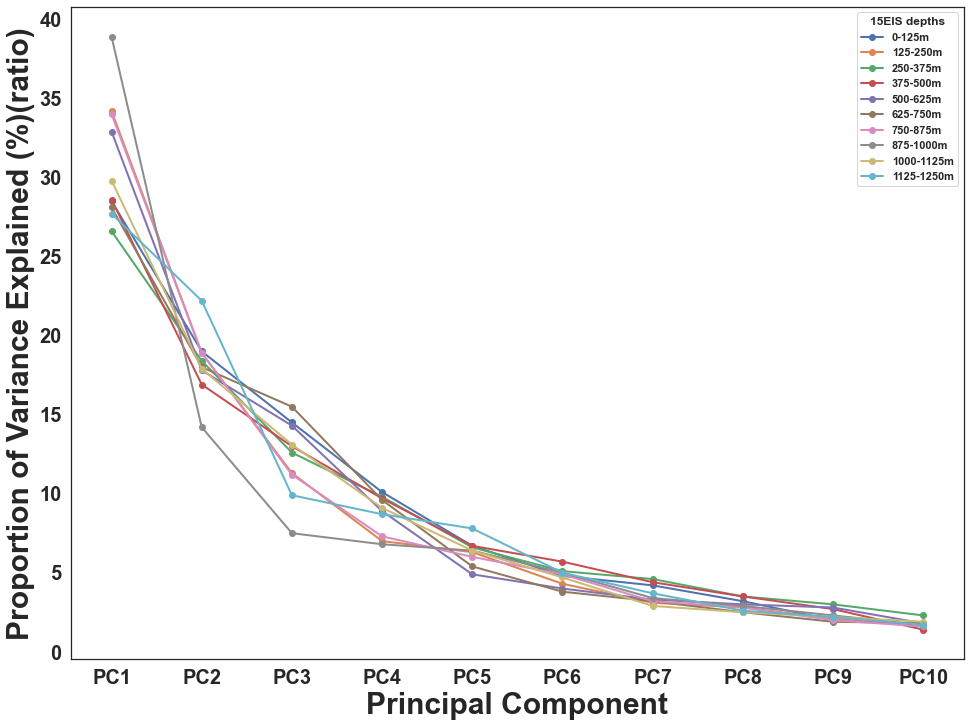

In [696]:
# get scree plot (for scree or elbow test)
#Scree plot will be saved in the same directory with name screeplot.png
plt.figure(figsize=(16,12))
plt.plot(pc_list_15EIS_1, np.round(pca_15EIS1_out.explained_variance_ratio_*100, decimals=1), 'o-', linewidth=2)
plt.plot(pc_list_15EIS_2, np.round(pca_15EIS2_out.explained_variance_ratio_*100, decimals=1), 'o-', linewidth=2)
plt.plot(pc_list_15EIS_3, np.round(pca_15EIS3_out.explained_variance_ratio_*100, decimals=1), 'o-', linewidth=2)
plt.plot(pc_list_15EIS_4, np.round(pca_15EIS4_out.explained_variance_ratio_*100, decimals=1), 'o-', linewidth=2)
plt.plot(pc_list_15EIS_5, np.round(pca_15EIS5_out.explained_variance_ratio_*100, decimals=1), 'o-', linewidth=2)
plt.plot(pc_list_15EIS_6, np.round(pca_15EIS6_out.explained_variance_ratio_*100, decimals=1), 'o-', linewidth=2)
plt.plot(pc_list_15EIS_7, np.round(pca_15EIS7_out.explained_variance_ratio_*100, decimals=1), 'o-', linewidth=2)
plt.plot(pc_list_15EIS_8, np.round(pca_15EIS8_out.explained_variance_ratio_*100, decimals=1), 'o-', linewidth=2)
plt.plot(pc_list_15EIS_9, np.round(pca_15EIS9_out.explained_variance_ratio_*100, decimals=1), 'o-', linewidth=2)
plt.plot(pc_list_15EIS_10, np.round(pca_15EIS10_out.explained_variance_ratio_*100, decimals=1), 'o-', linewidth=2)
#plt.xticks(fontsize=20, rotation=-90)
plt.xticks(fontsize=20)
plt.yticks(fontsize=20)
#plt.title('Elbow Plot')
plt.xlabel('Principal Component',fontsize=30)
plt.ylabel('Proportion of Variance Explained (%)(ratio)',fontsize=30)
plt.gca().legend(['0-125m','125-250m','250-375m','375-500m','500-625m','625-750m','750-875m','875-1000m','1000-1125m','1125-1250m'], title='15EIS depths')
#plt.show()
plt.savefig('/UNSW/PhD/Paper_drafts/Figures/15EIS_Elbowplot.png', dpi=300)

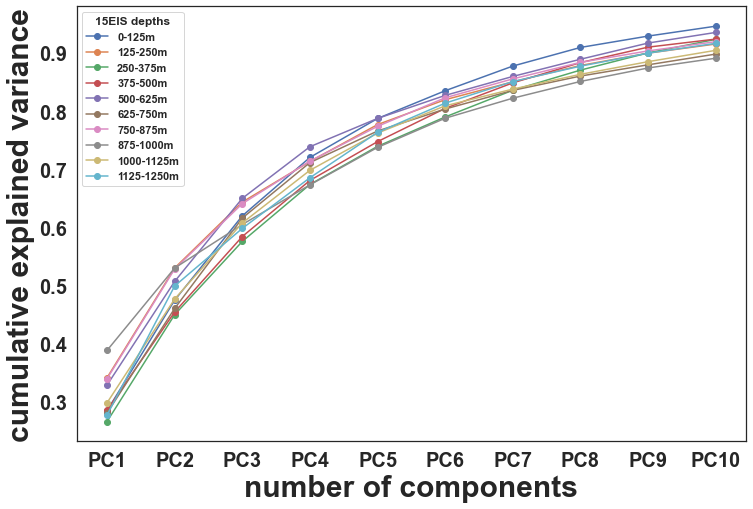

In [106]:
#Making the screeplot - plotting the cumulative variance against the number of components
%matplotlib inline
fig = plt.figure(figsize = (12,8))

plt.plot(pc_list_15EIS_1, np.cumsum(pca_15EIS1_out.explained_variance_ratio_),'o-')
plt.plot(pc_list_15EIS_2, np.cumsum(pca_15EIS2_out.explained_variance_ratio_),'o-')
plt.plot(pc_list_15EIS_3, np.cumsum(pca_15EIS3_out.explained_variance_ratio_),'o-')
plt.plot(pc_list_15EIS_4, np.cumsum(pca_15EIS4_out.explained_variance_ratio_),'o-')
plt.plot(pc_list_15EIS_5, np.cumsum(pca_15EIS5_out.explained_variance_ratio_),'o-')
plt.plot(pc_list_15EIS_6, np.cumsum(pca_15EIS6_out.explained_variance_ratio_),'o-')
plt.plot(pc_list_15EIS_7, np.cumsum(pca_15EIS7_out.explained_variance_ratio_),'o-')
plt.plot(pc_list_15EIS_8, np.cumsum(pca_15EIS8_out.explained_variance_ratio_),'o-')
plt.plot(pc_list_15EIS_9, np.cumsum(pca_15EIS9_out.explained_variance_ratio_),'o-')
plt.plot(pc_list_15EIS_10, np.cumsum(pca_15EIS10_out.explained_variance_ratio_),'o-')
plt.xticks(fontsize=20)
plt.yticks(fontsize=20)
plt.gca().legend(['0-125m','125-250m','250-375m','375-500m','500-625m','625-750m','750-875m','875-1000m','1000-1125m','1125-1250m'],title="15EIS depths")
plt.xlabel('number of components',fontsize=30)
plt.ylabel('cumulative explained variance',fontsize=30)
#plt.title('Scree plot')
#plt.show()
plt.savefig('/UNSW/PhD/Paper_drafts/Figures/15EIS_Screeplot.png', dpi=300)

### The important features are the ones that influence more the components and thus, have a large absolute ## value or coefficient or loading on the component.
#### Get the most important feature name on the PCs

In [69]:
scaled_df_comb_15EIS1.shape

(250, 37)

In [70]:
#scaled_df_comb_15EIS1.columns
scaled_df_comb_15EIS10.columns

Index(['Alt1_code_si', 'Alt1_code_sl', 'DS_U_mnrl_Albite', 'DS_U_mnrl_Edenite',
       'DS_U_mnrl_Hornblende', 'DS_U_mnrl_Labradorite', 'DS_U_mnrl_Oligoclase',
       'DS_U_mnrl_Quartz', 'Lith1_code_Ab', 'Lith1_code_Agpq',
       'Lith1_code_Aiu', 'Lith1_grnsz_cg', 'Lith1_grnsz_fg', 'Lith1_grnsz_mg',
       'Lith1_strctInt_Xobs', 'Lith1_strctInt_m', 'Lith1_strctInt_w',
       'Lith1-strct_Xobs', 'Lith1-strct_fd', 'Lith1-strct_fo',
       'Lith1_textr_bd', 'Lith1_textr_ma', 'Lith1_textr_po',
       'Sulph1_code_Xobs', 'Sulph1_code_po', 'Sulph1_code_py',
       'Sulph1_style_Xobs', 'Sulph1_style_bd', 'Sulph1_style_ds',
       'Sulph1_style_fg', 'Felsic_mfc_idx', 'Felsic_mfc_Rmean', 'ResDeep',
       'SSD_gcc', 'Susp_SI', 'Depth_m', 'Vel_geomean', 'Vel_std'],
      dtype='object')

In [71]:
# number of components
n_pcs_15EIS_1= pca_15EIS1_out.components_.shape[0]
#n_pcs_15EIS_1


# get the index of the most important feature on EACH component i.e. largest absolute value
# using LIST COMPREHENSION HERE
most_important_15EIS_1 = [np.abs(pca_15EIS1_out.components_[i]).argmax() for i in range(n_pcs_15EIS_1)]

initial_features_names_15EIS1 =['Alt1_code_ab', 'Alt1_code_ch', 'DS_U_mnrl_Albite', 'DS_U_mnrl_Calcite',
       'DS_U_mnrl_Chlorite', 'DS_U_mnrl_Edenite', 'DS_U_mnrl_Hornblende',
       'DS_U_mnrl_Kaolinite', 'DS_U_mnrl_Labradorite', 'DS_U_mnrl_Oligoclase',
       'DS_U_mnrl_Quartz', 'Lith1_code_Aau', 'Lith1_code_Abu',
       'Lith1_code_Agp', 'Lith1_code_Agpy', 'Lith1_grnsz_fg', 'Lith1_grnsz_mg',
       'Lith1_strctInt_m', 'Lith1_strctInt_s', 'Lith1_strctInt_v',
       'Lith1_strctInt_w', 'Lith1-strct_sh', 'Lith1-strct_vcb',
       'Lith1_textr_ah', 'Lith1_textr_ma', 'Lith1_textr_po', 'Sulph1_code_po',
       'Sulph1_code_py', 'Sulph1_style_ds', 'Felsic_mfc_idx',
       'Felsic_mfc_Rmean', 'ResDeep', 'SSD_gcc', 'Susp_SI', 'Depth_m',
       'Vel_geomean', 'Vel_std']

# get the names
most_important_names_15EIS_1 = [initial_features_names_15EIS1[most_important_15EIS_1[i]] for i in range(n_pcs_15EIS_1)]

# using LIST COMPREHENSION HERE AGAIN
dic_15EIS_1 = {'15EIS_0-125m-PC{}'.format(i+1): most_important_names_15EIS_1[i] for i in range(n_pcs_15EIS_1)}

# build the dataframe
df_imp_features_15EIS_1 = pd.DataFrame((dic_15EIS_1.items()))

# print important features

df_imp_features_15EIS_1

,0,1
0,15EIS_0-125m-PC1,Lith1-strct_sh
1,15EIS_0-125m-PC2,Lith1_strctInt_w
2,15EIS_0-125m-PC3,Lith1_strctInt_v
3,15EIS_0-125m-PC4,DS_U_mnrl_Quartz
4,15EIS_0-125m-PC5,Lith1_strctInt_s
5,15EIS_0-125m-PC6,DS_U_mnrl_Hornblende
6,15EIS_0-125m-PC7,Lith1_strctInt_w
7,15EIS_0-125m-PC8,Lith1_strctInt_m
8,15EIS_0-125m-PC9,Vel_geomean
9,15EIS_0-125m-PC10,DS_U_mnrl_Albite


In [72]:
# number of components
n_pcs_15EIS_2= pca_15EIS2_out.components_.shape[0]
#n_pcs_15EIS_1


# get the index of the most important feature on EACH component i.e. largest absolute value
# using LIST COMPREHENSION HERE
most_important_15EIS_2 = [np.abs(pca_15EIS2_out.components_[i]).argmax() for i in range(n_pcs_15EIS_2)]

initial_features_names_15EIS2 =['Alt1_code_ch', 'DS_U_mnrl_AmphiboleML48', 'DS_U_mnrl_Edenite',
       'DS_U_mnrl_Hornblende', 'DS_U_mnrl_Labradorite', 'DS_U_mnrl_Quartz',
       'Lith1_code_Abu', 'Lith1_code_Ado', 'Lith1_code_Ala', 'Lith1_code_Aou',
       'Lith1_grnsz_fg', 'Lith1_grnsz_mg', 'Lith1_strctInt_m',
       'Lith1_strctInt_s', 'Lith1-strct_cc', 'Lith1-strct_cx',
       'Lith1-strct_fd', 'Lith1-strct_sh', 'Lith1-strct_vcb', 'Lith1_textr_ah',
       'Lith1_textr_ma', 'Lith1_textr_po', 'Sulph1_code_cp', 'Sulph1_code_po',
       'Sulph1_code_py', 'Sulph1_style_ds', 'Sulph1_style_su',
       'Felsic_mfc_idx', 'Felsic_mfc_Rmean', 'ResDeep', 'SSD_gcc', 'Susp_SI',
       'Depth_m', 'Vel_geomean', 'Vel_std']

# get the names
most_important_names_15EIS_2 = [initial_features_names_15EIS2[most_important_15EIS_2[i]] for i in range(n_pcs_15EIS_2)]

# using LIST COMPREHENSION HERE AGAIN
dic_15EIS_2 = {'15EIS_126-250m-PC{}'.format(i+1): most_important_names_15EIS_2[i] for i in range(n_pcs_15EIS_2)}

# build the dataframe
df_imp_features_15EIS_2 = pd.DataFrame((dic_15EIS_2.items()))

# print important features

df_imp_features_15EIS_2

,0,1
0,15EIS_126-250m-PC1,Sulph1_code_py
1,15EIS_126-250m-PC2,Lith1_grnsz_fg
2,15EIS_126-250m-PC3,DS_U_mnrl_Edenite
3,15EIS_126-250m-PC4,DS_U_mnrl_Quartz
4,15EIS_126-250m-PC5,Lith1-strct_cx
5,15EIS_126-250m-PC6,Lith1-strct_vcb
6,15EIS_126-250m-PC7,Lith1_strctInt_s
7,15EIS_126-250m-PC8,DS_U_mnrl_AmphiboleML48
8,15EIS_126-250m-PC9,Vel_geomean
9,15EIS_126-250m-PC10,Lith1-strct_fd


In [73]:
# number of components
n_pcs_15EIS_3= pca_15EIS3_out.components_.shape[0]
#n_pcs_15EIS_1


# get the index of the most important feature on EACH component i.e. largest absolute value
# using LIST COMPREHENSION HERE
most_important_15EIS_3 = [np.abs(pca_15EIS3_out.components_[i]).argmax() for i in range(n_pcs_15EIS_3)]

initial_features_names_15EIS3 =['Alt1_code_Xobs', 'Alt1_code_ch', 'Alt1_code_sl', 'DS_U_mnrl_Chlorite',
       'DS_U_mnrl_Edenite', 'DS_U_mnrl_Hornblende', 'DS_U_mnrl_Labradorite',
       'DS_U_mnrl_Quartz', 'DS_U_mnrl_Siderite', 'Lith1_code_Abu',
       'Lith1_code_Ala', 'Lith1_code_Asc', 'Lith1_grnsz_fg', 'Lith1_grnsz_mg',
       'Lith1_strctInt_m', 'Lith1_strctInt_s', 'Lith1-strct_bd',
       'Lith1-strct_bx', 'Lith1-strct_cc', 'Lith1-strct_cx', 'Lith1-strct_vcb',
       'Lith1_textr_ah', 'Lith1_textr_ma', 'Lith1_textr_po',
       'Sulph1_code_Xobs', 'Sulph1_code_cp', 'Sulph1_code_po',
       'Sulph1_code_py', 'Sulph1_style_Xobs', 'Sulph1_style_ds',
       'Felsic_mfc_idx', 'Felsic_mfc_Rmean', 'ResDeep', 'SSD_gcc', 'Susp_SI',
       'Depth_m', 'Vel_geomean', 'Vel_std']

# get the names
most_important_names_15EIS_3 = [initial_features_names_15EIS3[most_important_15EIS_3[i]] for i in range(n_pcs_15EIS_3)]

# using LIST COMPREHENSION HERE AGAIN
dic_15EIS_3 = {'15EIS_251-375m-PC{}'.format(i+1): most_important_names_15EIS_3[i] for i in range(n_pcs_15EIS_3)}

# build the dataframe
df_imp_features_15EIS_3 = pd.DataFrame((dic_15EIS_3.items()))

# print important features

df_imp_features_15EIS_3

,0,1
0,15EIS_251-375m-PC1,Lith1_strctInt_m
1,15EIS_251-375m-PC2,Sulph1_code_py
2,15EIS_251-375m-PC3,Lith1_grnsz_fg
3,15EIS_251-375m-PC4,Alt1_code_ch
4,15EIS_251-375m-PC5,DS_U_mnrl_Quartz
5,15EIS_251-375m-PC6,Sulph1_code_cp
6,15EIS_251-375m-PC7,DS_U_mnrl_Edenite
7,15EIS_251-375m-PC8,ResDeep
8,15EIS_251-375m-PC9,DS_U_mnrl_Edenite
9,15EIS_251-375m-PC10,Alt1_code_sl


In [74]:
# number of components
n_pcs_15EIS_4= pca_15EIS4_out.components_.shape[0]
#n_pcs_15EIS_1


# get the index of the most important feature on EACH component i.e. largest absolute value
# using LIST COMPREHENSION HERE
most_important_15EIS_4 = [np.abs(pca_15EIS4_out.components_[i]).argmax() for i in range(n_pcs_15EIS_4)]

initial_features_names_15EIS4 =['Alt1_code_ab', 'Alt1_code_bi', 'Alt1_code_ch',
       'DS_U_mnrl_AmphiboleML48', 'DS_U_mnrl_Andesine', 'DS_U_mnrl_Dolomite',
       'DS_U_mnrl_Edenite', 'DS_U_mnrl_Hornblende', 'DS_U_mnrl_Labradorite',
       'DS_U_mnrl_Oligoclase', 'DS_U_mnrl_Quartz', 'DS_U_mnrl_Siderite',
       'Lith1_code_Abu', 'Lith1_code_Agpf', 'Lith1_code_Agpy',
       'Lith1_code_Aou', 'Lith1_grnsz_fg', 'Lith1_grnsz_mg',
       'Lith1_strctInt_Xobs', 'Lith1_strctInt_m', 'Lith1_strctInt_s',
       'Lith1_strctInt_w', 'Lith1-strct_Xobs', 'Lith1-strct_cx',
       'Lith1-strct_fo', 'Lith1-strct_sh', 'Lith1_textr_bd', 'Lith1_textr_ma',
       'Lith1_textr_po', 'Sulph1_code_po', 'Sulph1_code_py', 'Sulph1_style_ds',
       'Sulph1_style_lm', 'Felsic_mfc_idx', 'Felsic_mfc_Rmean', 'ResDeep',
       'SSD_gcc', 'Susp_SI', 'Depth_m', 'Vel_geomean', 'Vel_std']

# get the names
most_important_names_15EIS_4 = [initial_features_names_15EIS4[most_important_15EIS_4[i]] for i in range(n_pcs_15EIS_4)]

# using LIST COMPREHENSION HERE AGAIN
dic_15EIS_4 = {'15EIS_376-500m-PC{}'.format(i+1): most_important_names_15EIS_4[i] for i in range(n_pcs_15EIS_4)}

# build the dataframe
df_imp_features_15EIS_4 = pd.DataFrame((dic_15EIS_4.items()))

# print important features

df_imp_features_15EIS_4

,0,1
0,15EIS_376-500m-PC1,Lith1_strctInt_w
1,15EIS_376-500m-PC2,Lith1-strct_fo
2,15EIS_376-500m-PC3,DS_U_mnrl_Quartz
3,15EIS_376-500m-PC4,Lith1_strctInt_m
4,15EIS_376-500m-PC5,Lith1_strctInt_Xobs
5,15EIS_376-500m-PC6,DS_U_mnrl_Hornblende
6,15EIS_376-500m-PC7,DS_U_mnrl_Labradorite
7,15EIS_376-500m-PC8,DS_U_mnrl_Hornblende
8,15EIS_376-500m-PC9,Sulph1_style_lm
9,15EIS_376-500m-PC10,Vel_geomean


In [75]:
# number of components
n_pcs_15EIS_5= pca_15EIS5_out.components_.shape[0]
#n_pcs_15EIS_1


# get the index of the most important feature on EACH component i.e. largest absolute value
# using LIST COMPREHENSION HERE
most_important_15EIS_5 = [np.abs(pca_15EIS5_out.components_[i]).argmax() for i in range(n_pcs_15EIS_5)]

initial_features_names_15EIS5 =['Alt1_code_bi', 'Alt1_code_ch', 'DS_U_mnrl_AmphiboleML48',
       'DS_U_mnrl_Edenite', 'DS_U_mnrl_Hornblende', 'DS_U_mnrl_Labradorite',
       'DS_U_mnrl_Oligoclase', 'DS_U_mnrl_Quartz', 'DS_U_mnrl_Siderite',
       'Lith1_code_Abu', 'Lith1_code_Aia', 'Lith1_grnsz_fg', 'Lith1_grnsz_mg',
       'Lith1_strctInt_m', 'Lith1_strctInt_s', 'Lith1_strctInt_w',
       'Lith1-strct_fo', 'Lith1_textr_bd', 'Lith1_textr_ma', 'Sulph1_code_po',
       'Sulph1_style_ds', 'Sulph1_style_lm', 'Felsic_mfc_idx',
       'Felsic_mfc_Rmean', 'ResDeep', 'SSD_gcc', 'Susp_SI', 'Depth_m',
       'Vel_geomean', 'Vel_std']

# get the names
most_important_names_15EIS_5 = [initial_features_names_15EIS5[most_important_15EIS_5[i]] for i in range(n_pcs_15EIS_5)]

# using LIST COMPREHENSION HERE AGAIN
dic_15EIS_5 = {'15EIS_501-625m-PC{}'.format(i+1): most_important_names_15EIS_5[i] for i in range(n_pcs_15EIS_5)}

# build the dataframe
df_imp_features_15EIS_5 = pd.DataFrame((dic_15EIS_5.items()))

# print important features

df_imp_features_15EIS_5

,0,1
0,15EIS_501-625m-PC1,Alt1_code_ch
1,15EIS_501-625m-PC2,DS_U_mnrl_Quartz
2,15EIS_501-625m-PC3,Alt1_code_ch
3,15EIS_501-625m-PC4,DS_U_mnrl_Labradorite
4,15EIS_501-625m-PC5,Depth_m
5,15EIS_501-625m-PC6,Depth_m
6,15EIS_501-625m-PC7,Lith1_strctInt_m
7,15EIS_501-625m-PC8,DS_U_mnrl_Edenite
8,15EIS_501-625m-PC9,Vel_geomean
9,15EIS_501-625m-PC10,Vel_std


In [76]:
# number of components
n_pcs_15EIS_6= pca_15EIS6_out.components_.shape[0]
#n_pcs_15EIS_1


# get the index of the most important feature on EACH component i.e. largest absolute value
# using LIST COMPREHENSION HERE
most_important_15EIS_6 = [np.abs(pca_15EIS6_out.components_[i]).argmax() for i in range(n_pcs_15EIS_6)]

initial_features_names_15EIS6 =['Alt1_code_bi', 'Alt1_code_ch', 'Alt1_code_ep', 'Alt1_code_sl',
       'DS_U_mnrl_Albite', 'DS_U_mnrl_Hornblende', 'DS_U_mnrl_Labradorite',
       'DS_U_mnrl_Oligoclase', 'DS_U_mnrl_Quartz', 'Lith1_code_Abu',
       'Lith1_code_Agp', 'Lith1_code_Aiu', 'Lith1_grnsz_fg', 'Lith1_grnsz_mg',
       'Lith1_strctInt_m', 'Lith1_strctInt_s', 'Lith1_strctInt_w',
       'Lith1-strct_bx', 'Lith1-strct_fo', 'Lith1_textr_Xobs',
       'Lith1_textr_cz', 'Lith1_textr_ma', 'Lith1_textr_sp',
       'Sulph1_code_Xobs', 'Sulph1_code_po', 'Sulph1_style_Xobs',
       'Sulph1_style_ds', 'Felsic_mfc_idx', 'Felsic_mfc_Rmean', 'ResDeep',
       'SSD_gcc', 'Susp_SI', 'Depth_m', 'Vel_geomean', 'Vel_std']

# get the names
most_important_names_15EIS_6 = [initial_features_names_15EIS6[most_important_15EIS_6[i]] for i in range(n_pcs_15EIS_6)]

# using LIST COMPREHENSION HERE AGAIN
dic_15EIS_6 = {'15EIS_626-750m-PC{}'.format(i+1): most_important_names_15EIS_6[i] for i in range(n_pcs_15EIS_6)}

# build the dataframe
df_imp_features_15EIS_6 = pd.DataFrame((dic_15EIS_6.items()))

# print important features

df_imp_features_15EIS_6

,0,1
0,15EIS_626-750m-PC1,Lith1_strctInt_w
1,15EIS_626-750m-PC2,Depth_m
2,15EIS_626-750m-PC3,DS_U_mnrl_Quartz
3,15EIS_626-750m-PC4,Alt1_code_ch
4,15EIS_626-750m-PC5,DS_U_mnrl_Quartz
5,15EIS_626-750m-PC6,Lith1_textr_ma
6,15EIS_626-750m-PC7,Depth_m
7,15EIS_626-750m-PC8,Depth_m
8,15EIS_626-750m-PC9,DS_U_mnrl_Oligoclase
9,15EIS_626-750m-PC10,Susp_SI


In [77]:
# number of components
n_pcs_15EIS_7= pca_15EIS7_out.components_.shape[0]
#n_pcs_15EIS_1


# get the index of the most important feature on EACH component i.e. largest absolute value
# using LIST COMPREHENSION HERE
most_important_15EIS_7 = [np.abs(pca_15EIS7_out.components_[i]).argmax() for i in range(n_pcs_15EIS_7)]

initial_features_names_15EIS7 =['Alt1_code_ch', 'Alt1_code_sl', 'DS_U_mnrl_Albite',
       'DS_U_mnrl_Hornblende', 'DS_U_mnrl_Oligoclase', 'DS_U_mnrl_Prehnite',
       'DS_U_mnrl_Quartz', 'Lith1_code_Ab', 'Lith1_code_Agpy',
       'Lith1_code_Ait', 'Lith1_code_Aiu', 'Lith1_grnsz_fg', 'Lith1_grnsz_mg',
       'Lith1_strctInt_m', 'Lith1_strctInt_s', 'Lith1_strctInt_w',
       'Lith1-strct_fo', 'Lith1-strct_sh', 'Lith1_textr_bd', 'Lith1_textr_be',
       'Lith1_textr_cc', 'Lith1_textr_cx', 'Lith1_textr_ma', 'Lith1_textr_po',
       'Lith1_textr_tu', 'Sulph1_code_Xobs', 'Sulph1_code_py',
       'Sulph1_style_Xobs', 'Sulph1_style_ds', 'Felsic_mfc_idx',
       'Felsic_mfc_Rmean', 'ResDeep', 'SSD_gcc', 'Susp_SI', 'Depth_m',
       'Vel_geomean', 'Vel_std']

# get the names
most_important_names_15EIS_7 = [initial_features_names_15EIS7[most_important_15EIS_7[i]] for i in range(n_pcs_15EIS_7)]

# using LIST COMPREHENSION HERE AGAIN
dic_15EIS_7 = {'15EIS_6751-875m-PC{}'.format(i+1): most_important_names_15EIS_7[i] for i in range(n_pcs_15EIS_7)}

# build the dataframe
df_imp_features_15EIS_7 = pd.DataFrame((dic_15EIS_7.items()))

# print important features

df_imp_features_15EIS_7

,0,1
0,15EIS_6751-875m-PC1,Lith1-strct_fo
1,15EIS_6751-875m-PC2,Lith1_strctInt_s
2,15EIS_6751-875m-PC3,Lith1_strctInt_w
3,15EIS_6751-875m-PC4,DS_U_mnrl_Quartz
4,15EIS_6751-875m-PC5,Sulph1_code_Xobs
5,15EIS_6751-875m-PC6,Lith1_strctInt_m
6,15EIS_6751-875m-PC7,DS_U_mnrl_Oligoclase
7,15EIS_6751-875m-PC8,Depth_m
8,15EIS_6751-875m-PC9,Depth_m
9,15EIS_6751-875m-PC10,DS_U_mnrl_Albite


In [78]:
# number of components
n_pcs_15EIS_8= pca_15EIS8_out.components_.shape[0]
#n_pcs_15EIS_1


# get the index of the most important feature on EACH component i.e. largest absolute value
# using LIST COMPREHENSION HERE
most_important_15EIS_8 = [np.abs(pca_15EIS8_out.components_[i]).argmax() for i in range(n_pcs_15EIS_8)]

initial_features_names_15EIS8 =['Alt1_code_ascb_m', 'Alt1_code_ascb_s', 'Alt1_code_ascb_w',
       'Alt1_code_ch', 'Alt1_code_he', 'Alt1_code_hemag', 'Alt1_code_sacb',
       'Alt1_code_sl', 'DS_U_mnrl_Albite', 'DS_U_mnrl_AmphiboleML48',
       'DS_U_mnrl_Hornblende', 'DS_U_mnrl_Oligoclase', 'DS_U_mnrl_Quartz',
       'Lith1_code_Ab', 'Lith1_code_Agp', 'Lith1_code_Agpy', 'Lith1_code_Agt',
       'Lith1_code_Aiu', 'Lith1_code_Aivc', 'Lith1_grnsz_cg', 'Lith1_grnsz_fg',
       'Lith1_grnsz_mg', 'Lith1_strctInt_m', 'Lith1_strctInt_s',
       'Lith1_strctInt_w', 'Lith1-strct_fo', 'Lith1_textr_bd',
       'Lith1_textr_be', 'Lith1_textr_ma', 'Lith1_textr_po',
       'Sulph1_code_Xobs', 'Sulph1_code_as', 'Sulph1_code_po',
       'Sulph1_code_py', 'Sulph1_style_Xobs', 'Sulph1_style_an',
       'Sulph1_style_bd', 'Sulph1_style_ds', 'Sulph1_style_eu',
       'Sulph1_style_su', 'Felsic_mfc_idx', 'Felsic_mfc_Rmean', 'ResDeep',
       'SSD_gcc', 'Susp_SI', 'Depth_m', 'Vel_geomean', 'Vel_std']

# get the names
most_important_names_15EIS_8 = [initial_features_names_15EIS8[most_important_15EIS_8[i]] for i in range(n_pcs_15EIS_8)]

# using LIST COMPREHENSION HERE AGAIN
dic_15EIS_8 = {'15EIS_876-1000m-PC{}'.format(i+1): most_important_names_15EIS_8[i] for i in range(n_pcs_15EIS_8)}

# build the dataframe
df_imp_features_15EIS_8 = pd.DataFrame((dic_15EIS_8.items()))

# print important features

df_imp_features_15EIS_8

,0,1
0,15EIS_876-1000m-PC1,Lith1_code_Agt
1,15EIS_876-1000m-PC2,Lith1_strctInt_w
2,15EIS_876-1000m-PC3,Sulph1_code_as
3,15EIS_876-1000m-PC4,Lith1_strctInt_s
4,15EIS_876-1000m-PC5,Alt1_code_ascb_s
5,15EIS_876-1000m-PC6,DS_U_mnrl_Quartz
6,15EIS_876-1000m-PC7,Alt1_code_ch
7,15EIS_876-1000m-PC8,Alt1_code_ascb_m
8,15EIS_876-1000m-PC9,Alt1_code_ascb_w
9,15EIS_876-1000m-PC10,Lith1_textr_ma


In [79]:
# number of components
n_pcs_15EIS_9= pca_15EIS9_out.components_.shape[0]
#n_pcs_15EIS_1


# get the index of the most important feature on EACH component i.e. largest absolute value
# using LIST COMPREHENSION HERE
most_important_15EIS_9 = [np.abs(pca_15EIS9_out.components_[i]).argmax() for i in range(n_pcs_15EIS_9)]

initial_features_names_15EIS9 =['Alt1_code_Xobs', 'Alt1_code_bi', 'Alt1_code_he', 'Alt1_code_sl',
       'DS_U_mnrl_Albite', 'DS_U_mnrl_Edenite', 'DS_U_mnrl_Hornblende',
       'DS_U_mnrl_Oligoclase', 'DS_U_mnrl_Quartz', 'Lith1_code_Ab',
       'Lith1_code_Aiu', 'Lith1_code_Asb', 'Lith1_code_Xobs',
       'Lith1_grnsz_Xobs', 'Lith1_grnsz_cg', 'Lith1_grnsz_fg',
       'Lith1_grnsz_mg', 'Lith1_strctInt_Xobs', 'Lith1_strctInt_m',
       'Lith1_strctInt_s', 'Lith1_strctInt_w', 'Lith1-strct_Xobs',
       'Lith1-strct_fd', 'Lith1-strct_fo', 'Lith1-strct_sh',
       'Lith1_textr_Xobs', 'Lith1_textr_bb', 'Lith1_textr_bd',
       'Lith1_textr_cz', 'Lith1_textr_fr', 'Lith1_textr_ma', 'Lith1_textr_si',
       'Sulph1_code_Xobs', 'Sulph1_code_as', 'Sulph1_code_cp',
       'Sulph1_code_po', 'Sulph1_code_py', 'Sulph1_style_Xobs',
       'Sulph1_style_bd', 'Sulph1_style_ds', 'Sulph1_style_su',
       'Felsic_mfc_idx', 'Felsic_mfc_Rmean', 'ResDeep', 'SSD_gcc', 'Susp_SI',
       'Depth_m', 'Vel_geomean', 'Vel_std']

# get the names
most_important_names_15EIS_9 = [initial_features_names_15EIS9[most_important_15EIS_9[i]] for i in range(n_pcs_15EIS_9)]

# using LIST COMPREHENSION HERE AGAIN
dic_15EIS_9 = {'15EIS_1001-1225m-PC{}'.format(i+1): most_important_names_15EIS_9[i] for i in range(n_pcs_15EIS_9)}

# build the dataframe
df_imp_features_15EIS_9 = pd.DataFrame((dic_15EIS_9.items()))

# print important features

df_imp_features_15EIS_9

,0,1
0,15EIS_1001-1225m-PC1,Lith1-strct_fo
1,15EIS_1001-1225m-PC2,Alt1_code_sl
2,15EIS_1001-1225m-PC3,Lith1_grnsz_mg
3,15EIS_1001-1225m-PC4,Lith1_grnsz_fg
4,15EIS_1001-1225m-PC5,Lith1_strctInt_s
5,15EIS_1001-1225m-PC6,DS_U_mnrl_Quartz
6,15EIS_1001-1225m-PC7,Sulph1_code_po
7,15EIS_1001-1225m-PC8,Lith1_textr_bd
8,15EIS_1001-1225m-PC9,Lith1_strctInt_w
9,15EIS_1001-1225m-PC10,Lith1_textr_ma


In [80]:
# number of components
n_pcs_15EIS_10= pca_15EIS10_out.components_.shape[0]
#n_pcs_15EIS_1


# get the index of the most important feature on EACH component i.e. largest absolute value
# using LIST COMPREHENSION HERE
most_important_15EIS_10 = [np.abs(pca_15EIS10_out.components_[i]).argmax() for i in range(n_pcs_15EIS_10)]

initial_features_names_15EIS10 =['Alt1_code_si', 'Alt1_code_sl', 'DS_U_mnrl_Albite', 'DS_U_mnrl_Edenite',
       'DS_U_mnrl_Hornblende', 'DS_U_mnrl_Labradorite', 'DS_U_mnrl_Oligoclase',
       'DS_U_mnrl_Quartz', 'Lith1_code_Ab', 'Lith1_code_Agpq',
       'Lith1_code_Aiu', 'Lith1_grnsz_cg', 'Lith1_grnsz_fg', 'Lith1_grnsz_mg',
       'Lith1_strctInt_Xobs', 'Lith1_strctInt_m', 'Lith1_strctInt_w',
       'Lith1-strct_Xobs', 'Lith1-strct_fd', 'Lith1-strct_fo',
       'Lith1_textr_bd', 'Lith1_textr_ma', 'Lith1_textr_po',
       'Sulph1_code_Xobs', 'Sulph1_code_po', 'Sulph1_code_py',
       'Sulph1_style_Xobs', 'Sulph1_style_bd', 'Sulph1_style_ds',
       'Sulph1_style_fg', 'Felsic_mfc_idx', 'Felsic_mfc_Rmean', 'ResDeep',
       'SSD_gcc', 'Susp_SI', 'Depth_m', 'Vel_geomean', 'Vel_std']

# get the names
most_important_names_15EIS_10 = [initial_features_names_15EIS10[most_important_15EIS_10[i]] for i in range(n_pcs_15EIS_10)]

# using LIST COMPREHENSION HERE AGAIN
dic_15EIS_10 = {'15EIS_1256-1375m-PC{}'.format(i+1): most_important_names_15EIS_10[i] for i in range(n_pcs_15EIS_9)}

# build the dataframe
df_imp_features_15EIS_10 = pd.DataFrame((dic_15EIS_10.items()))

# print important features

df_imp_features_15EIS_10

,0,1
0,15EIS_1256-1375m-PC1,Lith1_strctInt_w
1,15EIS_1256-1375m-PC2,Lith1_strctInt_m
2,15EIS_1256-1375m-PC3,Lith1_grnsz_mg
3,15EIS_1256-1375m-PC4,Sulph1_code_Xobs
4,15EIS_1256-1375m-PC5,Lith1-strct_fd
5,15EIS_1256-1375m-PC6,Alt1_code_si
6,15EIS_1256-1375m-PC7,DS_U_mnrl_Hornblende
7,15EIS_1256-1375m-PC8,Sulph1_code_py
8,15EIS_1256-1375m-PC9,DS_U_mnrl_Quartz
9,15EIS_1256-1375m-PC10,Vel_std


In [81]:
# Printing Dataframes side by side
comb_impfeature = pd.concat([d.reset_index(drop=True) for d in [df_imp_features_15EIS_1, df_imp_features_15EIS_2,
                                              df_imp_features_15EIS_3, df_imp_features_15EIS_4,
                                              df_imp_features_15EIS_5, df_imp_features_15EIS_6,
                                              df_imp_features_15EIS_7, df_imp_features_15EIS_8,
                                              df_imp_features_15EIS_9, df_imp_features_15EIS_10,]], axis=1)

In [82]:
# Creating table as dataframe and exporting as png
comb_15EIS_imofeature=pd.DataFrame(comb_impfeature)
dfi.export(comb_15EIS_imofeature, 'comb_15EIS_imofeature.png', max_rows=None, max_cols=None, fontsize=16 )

<span style="font-family: Bold; font-size:3.5em;color:red;"> Splitting drill core data above fault & below fault </p>

## Splitting the data for 15EIS HOLE in 2 parts above fault which is located at 1390m (1790) and below fault (2409-1790= 619)

In [83]:
#Data frame above fault
df2_b4fault_15EIS = df2_15EIS.iloc[:1790,:]

# Data frame below fault
#df2_afterfault_15EIS = df2_15EIS.iloc[1791:2409:]
df2_afterfault_15EIS = df2_15EIS.iloc[1791:,:]

In [84]:
#Categorical data above fault
cat_df2_b4fault_15EIS=df2_b4fault_15EIS.select_dtypes(include=['object'].copy())
#Categorical data below fault
cat_df2_afterfault_15EIS=df2_afterfault_15EIS.select_dtypes(include=['object'].copy())

In [85]:
#Numerical data above fault
num_df2_15EIS_b4fault_15EIS = num_df2_15EIS_fillna.iloc[:1790,:]

#Numerical data below fault
num_df2_15EIS_afterfault_15EIS = num_df2_15EIS_fillna.iloc[1791:2409:]

In [86]:
num_df2_b4fault_15EIS_fillna=num_df2_15EIS_b4fault_15EIS.apply(lambda x: x.fillna(x.mean()),axis=0)
num_df2_afterfault_15EIS_fillna=num_df2_15EIS_afterfault_15EIS.apply(lambda x: x.fillna(x.mean()),axis=0)

In [87]:
# dropping DS_U_grp to make it target 
cat_df3_b4fault_15EIS=cat_df2_b4fault_15EIS.drop(['DS_U_grp'], axis=1)
cat_df3_afterfault_15EIS = cat_df2_afterfault_15EIS.drop(['DS_U_grp'], axis=1)

In [88]:
cat_df3_b4fault_15EIS_ce = cat_df3_b4fault_15EIS.copy()
cat_df3_afterfault_15EIS_ce = cat_df3_afterfault_15EIS.copy()
cat_df3_b4fault_15EIS_ce.head()

,Alt1_code,DS_U_mnrl,Lith1_code,Lith1_grnsz,Lith1_strctInt,Lith1-strct,Lith1_textr,Sulph1_code,Sulph1_style
0,ch,Quartz,Abu,fg,v,sh,ma,py,ds
1,ch,Quartz,Abu,fg,v,sh,ma,py,ds
2,ch,Quartz,Abu,fg,v,sh,ma,py,ds
3,ch,Quartz,Abu,fg,v,sh,ma,py,ds
4,ch,Quartz,Abu,fg,v,sh,ma,py,ds


In [89]:
#Data frame above fault
cat_df3_b4fault_15EIS_ce_onehot = cat_df3_b4fault_15EIS.copy()

#Data frame below fault
cat_df3_afterfault_15EIS_ce_onehot = cat_df3_afterfault_15EIS.copy()

#Categorical Data frame above fault
cat_df3_b4fault_15EIS_ce_onehot = pd.get_dummies(cat_df3_b4fault_15EIS_ce_onehot, columns=['Alt1_code','DS_U_mnrl','Lith1_code','Lith1_grnsz','Lith1_strctInt','Lith1-strct','Lith1_textr','Sulph1_code','Sulph1_style'], 
                                                 prefix = ['Alt1_code','DS_U_mnrl','Lith1_code','Lith1_grnsz','Lith1_strctInt','Lith1-strct','Lith1_textr','Sulph1_code','Sulph1_style'])

#Categorical Data frame below fault
cat_df3_afterfault_15EIS_ce_onehot = pd.get_dummies(cat_df3_afterfault_15EIS_ce_onehot, columns=['Alt1_code','DS_U_mnrl','Lith1_code','Lith1_grnsz','Lith1_strctInt','Lith1-strct','Lith1_textr','Sulph1_code','Sulph1_style'], 
                                                 prefix = ['Alt1_code','DS_U_mnrl','Lith1_code','Lith1_grnsz','Lith1_strctInt','Lith1-strct','Lith1_textr','Sulph1_code','Sulph1_style'])
#cat_df3_afterfault_15EIS_ce_onehot.isnull().sum()
cat_df3_afterfault_15EIS_ce_onehot.reset_index(drop=True, inplace=True)
cat_df3_afterfault_15EIS_ce_onehot.shape

(618, 58)

In [90]:
scaled_num_df2_b4fault_15EIS_fillna = pd.DataFrame(scaler.fit_transform(num_df2_b4fault_15EIS_fillna), columns=num_df2_b4fault_15EIS_fillna.columns)
scaled_num_df2_afterfault_15EIS_fillna = pd.DataFrame(scaler.fit_transform(num_df2_afterfault_15EIS_fillna), columns=num_df2_afterfault_15EIS_fillna.columns)
#scaled_num_df2_afterfault_15EIS_fillna.isnull().sum()
scaled_num_df2_afterfault_15EIS_fillna.shape

(618, 8)

In [91]:
scaled_df_b4fault_comb_15EIS = pd.concat([cat_df3_b4fault_15EIS_ce_onehot,scaled_num_df2_b4fault_15EIS_fillna],axis=1)
scaled_df_afterfault_comb_15EIS = pd.concat([cat_df3_afterfault_15EIS_ce_onehot,scaled_num_df2_afterfault_15EIS_fillna],axis=1)
#scaled_df_afterfault_comb_15EIS.isnull().sum()

In [92]:
print(scaled_df_b4fault_comb_15EIS.shape)
print(scaled_df_afterfault_comb_15EIS.shape)

(1790, 78)
(618, 66)


In [93]:
#scaled_df_afterfault_comb_15EIS.isnull().sum()

In [94]:
b4fault_PC1_15EIS = PCA(n_components=10)
afterfault_PC2_15EIS = PCA(n_components=10)

In [95]:
b4fault_PC1_15EIS.fit(scaled_df_b4fault_comb_15EIS)
afterfault_PC2_15EIS.fit(scaled_df_afterfault_comb_15EIS)

PCA(n_components=10)

In [96]:
print("b4fault_pc1.components\n",b4fault_PC1_15EIS.components_) # principal components for depth interval 0-1309m (starting depth 495m)
print("afterfault_pc2.components\n",afterfault_PC2_15EIS.components_) # principal components for depth 1309-1702m

b4fault_pc1.components
 [[-1.64316760e-03  1.28057885e-03  7.14117906e-04  8.84253205e-04
  -2.17334065e-02  3.59778406e-03  1.68998401e-02  1.12490327e-02
  -1.09813472e-02  1.69969319e-05 -6.69631045e-04 -1.31433484e-03
  -4.09339996e-04 -1.47026776e-01 -6.95312786e-02 -5.32808118e-04
  -2.18339278e-02  1.25598385e-02  8.80783005e-04  2.28285159e-01
  -6.92366730e-04 -2.97202295e-04  2.52598089e-03 -3.98577825e-01
  -1.25516420e-03  2.47233239e-04  2.33704037e-04  3.46559297e-03
   7.14117906e-04  1.06002704e-04  1.70406269e-03  3.93017796e-01
  -2.36081667e-03  1.81507904e-04  2.95009296e-04 -1.54801643e-02
   1.54801643e-02 -1.07330283e-02 -8.15014463e-02 -3.50115839e-04
  -2.77089677e-02  1.20293558e-01 -1.07330283e-02  1.19057292e-04
   2.20046662e-03 -2.79107474e-02 -9.83090883e-02 -7.71299922e-03
   2.55393600e-01  4.19302885e-02 -1.54977550e-01  3.59778406e-03
  -3.83861455e-02 -2.71413605e-03  1.27126748e-01  1.00524779e-03
   7.31332585e-04  8.84892232e-04 -7.42334709e-02 -2

In [97]:
# Dump components relations with features:
b4fault_PC1_features_dump_15EIS=pd.DataFrame(b4fault_PC1_15EIS.components_,columns= scaled_df_b4fault_comb_15EIS.columns,index = ['PC1-1','PC1-2','PC1-3','PC1-4','PC1-5','PC1-6','PC1-7','PC1-8','PC1-9','PC1-10'])
afterfault_PC2_features_dump_15EIS=pd.DataFrame(afterfault_PC2_15EIS.components_,columns= scaled_df_afterfault_comb_15EIS.columns,index = ['PC2-1','PC2-2','PC2-3','PC2-4','PC2-5','PC2-6','PC2-7','PC2-8','PC2-9','PC2-10'])

In [98]:
from matplotlib.ticker import MaxNLocator
PC_b4fault_values_15EIS = np.arange(b4fault_PC1_15EIS.n_components_) + 1
PC_afterfault_values_15EIS = np.arange(afterfault_PC2_15EIS.n_components_) + 1

In [100]:
num_pc_15EIS_b4fault = len(b4fault_PC1_15EIS.explained_variance_ratio_)
pc_list_15EIS_b4fault = ["PC"+str(i) for i in list(range(1, num_pc_15EIS_b4fault+1))]
pc_list_15EIS_b4fault 

['PC1', 'PC2', 'PC3', 'PC4', 'PC5', 'PC6', 'PC7', 'PC8', 'PC9', 'PC10']

In [102]:
num_pc_15EIS_afterfault = len(afterfault_PC2_15EIS.explained_variance_ratio_)
pc_list_15EIS_afterfault = ["PC"+str(i) for i in list(range(1, num_pc_15EIS_afterfault+1))]
pc_list_15EIS_afterfault 

['PC1', 'PC2', 'PC3', 'PC4', 'PC5', 'PC6', 'PC7', 'PC8', 'PC9', 'PC10']

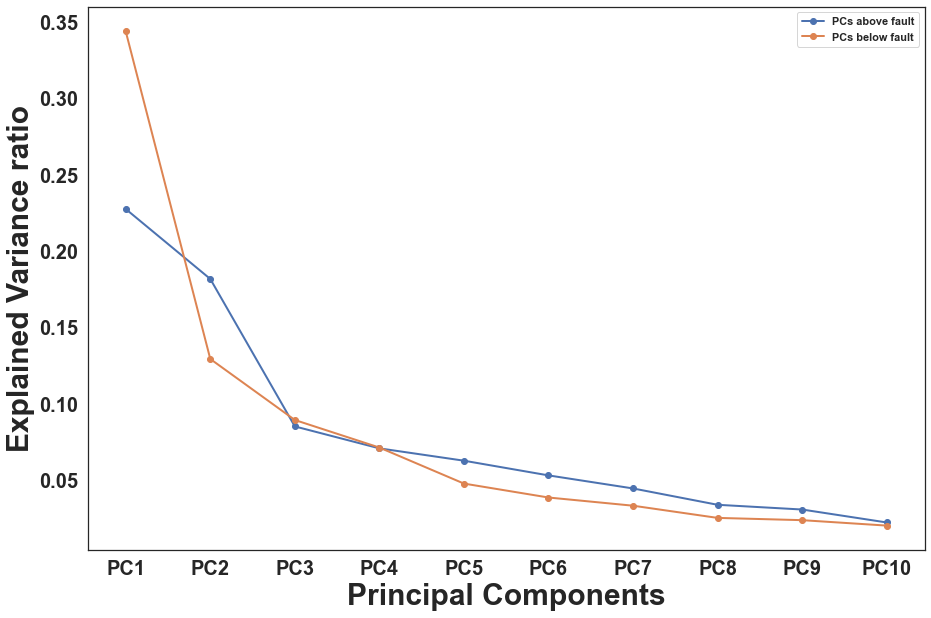

In [109]:
plt.figure(figsize=(15,10))
#plt.subplot(4, 3, 1)
plt.plot(pc_list_15EIS_b4fault , b4fault_PC1_15EIS.explained_variance_ratio_, 'o-', linewidth=2)
plt.plot(pc_list_15EIS_afterfault, afterfault_PC2_15EIS.explained_variance_ratio_, 'o-', linewidth=2)
plt.xticks(fontsize=20)
plt.yticks(fontsize=20)
plt.xlabel('Principal Components', fontsize=30)
plt.ylabel('Explained Variance ratio', fontsize=30)
plt.legend(["PCs above fault", "PCs below fault"])
#plt.show()
plt.savefig('/UNSW/PhD/Paper_drafts/Figures/15EIS_b4After_ElbowPlot.png', dpi=300)

In [110]:
#scaled_df_b4fault_comb_15EIS.columns
scaled_df_b4fault_comb_15EIS.shape

(1790, 78)

In [111]:
##Extracting important features according to principal components befor the fault
import pandas as pd
import numpy as np
np.random.seed(0)
# 2409 samples with 104 features
train_features_b4fault_15EIS = np.random.rand(1790, 78)

model_b4fault_15EIS = PCA(n_components=10).fit(train_features_b4fault_15EIS)
X_pc1_b4fault_15EIS = model_b4fault_15EIS.transform(train_features_b4fault_15EIS)
# number of components
n_pcs_b4fault_15EIS= model_b4fault_15EIS.components_.shape[0]

# get the index of the most important feature on EACH component i.e. largest absolute value
# using LIST COMPREHENSION HERE
most_important_b4fault_15EIS = [np.abs(model_b4fault_15EIS.components_[i]).argmax() for i in range(n_pcs_b4fault_15EIS)]

initial_feature_b4fault_15EIS = ['Alt1_code_Xobs', 'Alt1_code_ab', 'Alt1_code_ascb_s', 'Alt1_code_bi',
       'Alt1_code_ch', 'Alt1_code_ep', 'Alt1_code_sl', 'DS_U_mnrl_Albite',
       'DS_U_mnrl_AmphiboleML48', 'DS_U_mnrl_Andesine', 'DS_U_mnrl_Calcite',
       'DS_U_mnrl_Chlorite', 'DS_U_mnrl_Dolomite', 'DS_U_mnrl_Edenite',
       'DS_U_mnrl_Hornblende', 'DS_U_mnrl_Kaolinite', 'DS_U_mnrl_Labradorite',
       'DS_U_mnrl_Oligoclase', 'DS_U_mnrl_Prehnite', 'DS_U_mnrl_Quartz',
       'DS_U_mnrl_Siderite', 'Lith1_code_Aau', 'Lith1_code_Ab',
       'Lith1_code_Abu', 'Lith1_code_Ado', 'Lith1_code_Agp', 'Lith1_code_Agpf',
       'Lith1_code_Agpy', 'Lith1_code_Agt', 'Lith1_code_Aia', 'Lith1_code_Ait',
       'Lith1_code_Aiu', 'Lith1_code_Ala', 'Lith1_code_Aou', 'Lith1_code_Asc',
       'Lith1_grnsz_fg', 'Lith1_grnsz_mg', 'Lith1_strctInt_Xobs',
       'Lith1_strctInt_m', 'Lith1_strctInt_s', 'Lith1_strctInt_v',
       'Lith1_strctInt_w', 'Lith1-strct_Xobs', 'Lith1-strct_bd',
       'Lith1-strct_bx', 'Lith1-strct_cc', 'Lith1-strct_cx', 'Lith1-strct_fd',
       'Lith1-strct_fo', 'Lith1-strct_sh', 'Lith1-strct_vcb',
       'Lith1_textr_Xobs', 'Lith1_textr_ah', 'Lith1_textr_bd',
       'Lith1_textr_be', 'Lith1_textr_cc', 'Lith1_textr_cx', 'Lith1_textr_cz',
       'Lith1_textr_ma', 'Lith1_textr_po', 'Lith1_textr_sp', 'Lith1_textr_tu',
       'Sulph1_code_Xobs', 'Sulph1_code_cp', 'Sulph1_code_po',
       'Sulph1_code_py', 'Sulph1_style_Xobs', 'Sulph1_style_ds',
       'Sulph1_style_lm', 'Sulph1_style_su', 'Felsic_mfc_idx',
       'Felsic_mfc_Rmean', 'ResDeep', 'SSD_gcc', 'Susp_SI', 'Depth_m',
       'Vel_geomean', 'Vel_std']

# get the names
most_important_b4fault_15EIS = [initial_feature_b4fault_15EIS[most_important_b4fault_15EIS[i]] for i in range(n_pcs_b4fault_15EIS)]

# using LIST COMPREHENSION HERE AGAIN
dic_b4fault_15EIS = {'Before_fault_PC{}'.format(i+1): most_important_b4fault_15EIS[i] for i in range(n_pcs_b4fault_15EIS)}

# build the dataframe
#imp_features_b4fault_15EIS = pd.DataFrame(sorted(dic_b4fault_15EIS.items()))
imp_features_b4fault_15EIS = pd.DataFrame((dic_b4fault_15EIS.items()))
imp_features_b4fault_15EIS


,0,1
0,Before_fault_PC1,DS_U_mnrl_Prehnite
1,Before_fault_PC2,DS_U_mnrl_Dolomite
2,Before_fault_PC3,Lith1-strct_bd
3,Before_fault_PC4,Lith1-strct_fd
4,Before_fault_PC5,Lith1_code_Aou
5,Before_fault_PC6,DS_U_mnrl_Andesine
6,Before_fault_PC7,Lith1_textr_cz
7,Before_fault_PC8,Lith1_code_Agpf
8,Before_fault_PC9,SSD_gcc
9,Before_fault_PC10,Lith1_grnsz_mg


In [112]:
#scaled_df_afterfault_comb_15EIS.columns
scaled_df_afterfault_comb_15EIS.shape

(618, 66)

In [113]:
##Extracting umportant features according to principal components after the fault

import pandas as pd
import numpy as np
np.random.seed(0)
# 2409 samples with 104 features
train_features_afterfault_15EIS = np.random.rand(618, 66)

model_afterfault_15EIS = PCA(n_components=10).fit(train_features_afterfault_15EIS)
X_pc1_afterfault_15EIS = model_afterfault_15EIS.transform(train_features_afterfault_15EIS)

# number of components
n_pcs_afterfault_15EIS= model_afterfault_15EIS.components_.shape[0]

# get the index of the most important feature on EACH component i.e. largest absolute value
# using LIST COMPREHENSION HERE
most_important_afterfault_15EIS = [np.abs(model_afterfault_15EIS.components_[i]).argmax() for i in range(n_pcs_afterfault_15EIS)]

initial_feature_afterfault_15EIS =['Alt1_code_Xobs', 'Alt1_code_ascb_m', 'Alt1_code_ascb_s',
       'Alt1_code_ascb_w', 'Alt1_code_bi', 'Alt1_code_ch', 'Alt1_code_he',
       'Alt1_code_hemag', 'Alt1_code_sacb', 'Alt1_code_si', 'Alt1_code_sl',
       'DS_U_mnrl_Albite', 'DS_U_mnrl_AmphiboleML48', 'DS_U_mnrl_Edenite',
       'DS_U_mnrl_Hornblende', 'DS_U_mnrl_Labradorite', 'DS_U_mnrl_Oligoclase',
       'DS_U_mnrl_Quartz', 'Lith1_code_Ab', 'Lith1_code_Agp',
       'Lith1_code_Agpq', 'Lith1_code_Agt', 'Lith1_code_Aiu',
       'Lith1_code_Aivc', 'Lith1_code_Asb', 'Lith1_code_Xobs',
       'Lith1_grnsz_Xobs', 'Lith1_grnsz_cg', 'Lith1_grnsz_fg',
       'Lith1_grnsz_mg', 'Lith1_strctInt_Xobs', 'Lith1_strctInt_m',
       'Lith1_strctInt_s', 'Lith1_strctInt_w', 'Lith1-strct_Xobs',
       'Lith1-strct_fd', 'Lith1-strct_fo', 'Lith1-strct_sh',
       'Lith1_textr_Xobs', 'Lith1_textr_bb', 'Lith1_textr_bd',
       'Lith1_textr_cz', 'Lith1_textr_fr', 'Lith1_textr_ma', 'Lith1_textr_po',
       'Lith1_textr_si', 'Sulph1_code_Xobs', 'Sulph1_code_as',
       'Sulph1_code_cp', 'Sulph1_code_po', 'Sulph1_code_py',
       'Sulph1_style_Xobs', 'Sulph1_style_an', 'Sulph1_style_bd',
       'Sulph1_style_ds', 'Sulph1_style_eu', 'Sulph1_style_fg',
       'Sulph1_style_su', 'Felsic_mfc_idx', 'Felsic_mfc_Rmean', 'ResDeep',
       'SSD_gcc', 'Susp_SI', 'Depth_m', 'Vel_geomean', 'Vel_std']

# get the names
most_important_afterfault_15EIS = [initial_feature_afterfault_15EIS[most_important_afterfault_15EIS[i]] for i in range(n_pcs_afterfault_15EIS)]

# using LIST COMPREHENSION HERE AGAIN
dic_afterfault_15EIS = {'AfterFault_PC{}'.format(i+1): most_important_afterfault_15EIS[i] for i in range(n_pcs_afterfault_15EIS)}

# build the dataframe
imp_features_afterfault_15EIS = pd.DataFrame((dic_afterfault_15EIS.items()))

imp_features_afterfault_15EIS

,0,1
0,AfterFault_PC1,Lith1_textr_si
1,AfterFault_PC2,Lith1-strct_Xobs
2,AfterFault_PC3,DS_U_mnrl_Labradorite
3,AfterFault_PC4,Felsic_mfc_Rmean
4,AfterFault_PC5,Lith1_code_Agt
5,AfterFault_PC6,Lith1_code_Asb
6,AfterFault_PC7,Lith1_grnsz_fg
7,AfterFault_PC8,Alt1_code_bi
8,AfterFault_PC9,Lith1_grnsz_mg
9,AfterFault_PC10,Alt1_code_ch


In [114]:
# Printing Dataframes side by side
comb_fault_impfeatures = pd.concat([d.reset_index(drop=True) for d in [imp_features_b4fault_15EIS, imp_features_afterfault_15EIS]], axis=1)
comb_fault_impfeatures

,0,1,0,1
0,Before_fault_PC1,DS_U_mnrl_Prehnite,AfterFault_PC1,Lith1_textr_si
1,Before_fault_PC2,DS_U_mnrl_Dolomite,AfterFault_PC2,Lith1-strct_Xobs
2,Before_fault_PC3,Lith1-strct_bd,AfterFault_PC3,DS_U_mnrl_Labradorite
3,Before_fault_PC4,Lith1-strct_fd,AfterFault_PC4,Felsic_mfc_Rmean
4,Before_fault_PC5,Lith1_code_Aou,AfterFault_PC5,Lith1_code_Agt
5,Before_fault_PC6,DS_U_mnrl_Andesine,AfterFault_PC6,Lith1_code_Asb
6,Before_fault_PC7,Lith1_textr_cz,AfterFault_PC7,Lith1_grnsz_fg
7,Before_fault_PC8,Lith1_code_Agpf,AfterFault_PC8,Alt1_code_bi
8,Before_fault_PC9,SSD_gcc,AfterFault_PC9,Lith1_grnsz_mg
9,Before_fault_PC10,Lith1_grnsz_mg,AfterFault_PC10,Alt1_code_ch


In [115]:
# export combined table as image
dfi.export(comb_fault_impfeatures, 'comb_fault_impfeatures.png')

In [116]:
# Dump components relations with features:
df_components_featuresb4fault_15EIS=pd.DataFrame(b4fault_PC1_15EIS.components_,columns=scaled_df_b4fault_comb_15EIS.columns,index = ['PC1','PC2','PC3','PC4','PC5','PC6','PC7','PC8','PC9','PC10'])
df_components_featuresAfterfault_15EIS=pd.DataFrame(afterfault_PC2_15EIS.components_,columns=scaled_df_afterfault_comb_15EIS.columns,index = ['PC1','PC2','PC3','PC4','PC5','PC6','PC7','PC8','PC9','PC10'])


In [117]:
# Writing Principal compenents as columns
df_componentsb4fault_15EIS = df_components_featuresb4fault_15EIS.T
df_componentsAfterfault_15EIS = df_components_featuresAfterfault_15EIS.T

In [118]:
# Calculate linkage
data_link_componentsb4fault_15EIS = linkage(df_componentsb4fault_15EIS.values, 'ward') # computing the linkage (Can try complete or Average)
data_link_componentsAfterfault_15EIS = linkage(df_componentsAfterfault_15EIS.values, 'ward') # computing the linkage (Can try complete or Average)

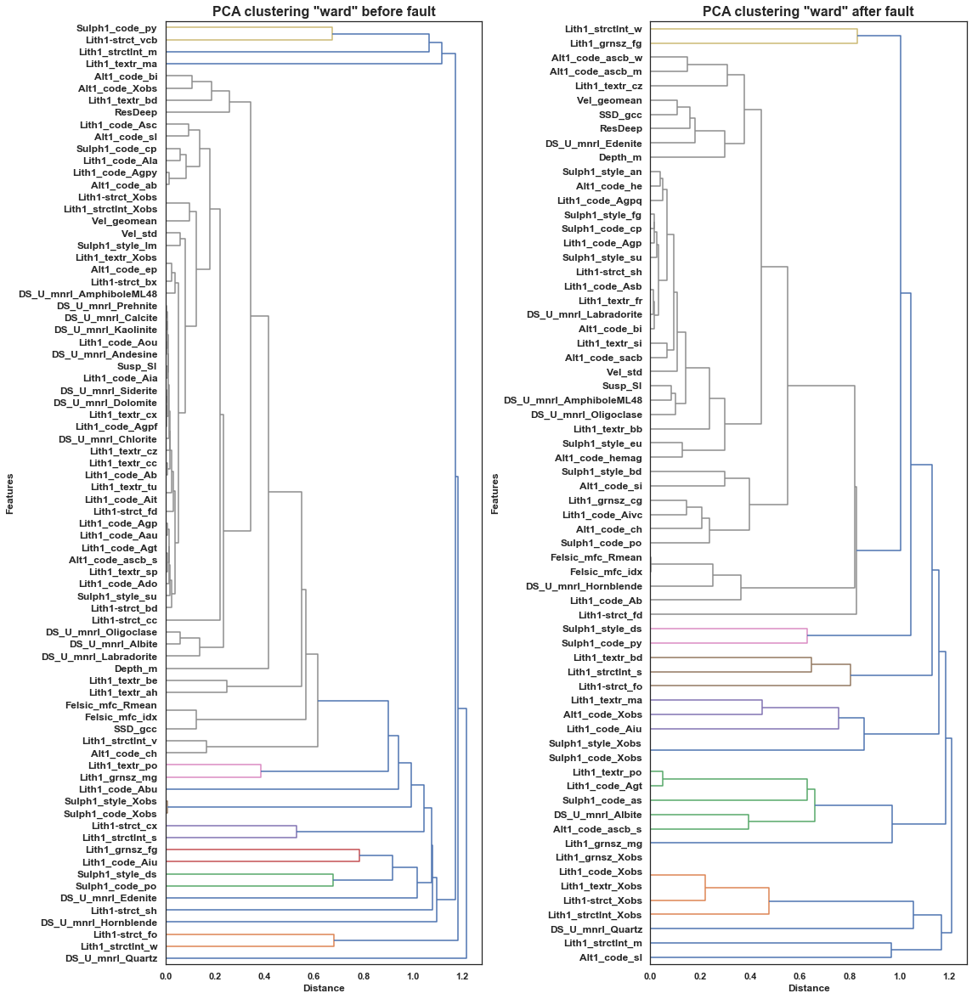

In [119]:
plt.rcParams['figure.figsize'] = (16,32)
plt.subplot(2,2,1)
dendrogram(data_link_componentsb4fault_15EIS, labels=df_componentsb4fault_15EIS.index, orientation = 'right',  leaf_rotation=0, leaf_font_size=12) 
plt.grid(False)
plt.xlabel('Distance')
plt.ylabel('Features')
plt.title('PCA clustering "ward" before fault', fontweight='bold', fontsize=16);
plt.subplot(2,2,2)
dendrogram(data_link_componentsAfterfault_15EIS, labels=df_componentsAfterfault_15EIS.index, orientation = 'right',  leaf_rotation=0, leaf_font_size=12) 
plt.grid(False)
plt.xlabel('Distance')
plt.ylabel('Features')
plt.title('PCA clustering "ward" after fault', fontweight='bold', fontsize=16);
plt.tight_layout()
plt.show()

<span style="font-family: Bold; font-size:3.5em;color:red;"> Drill-core Variables display with depth  </p>

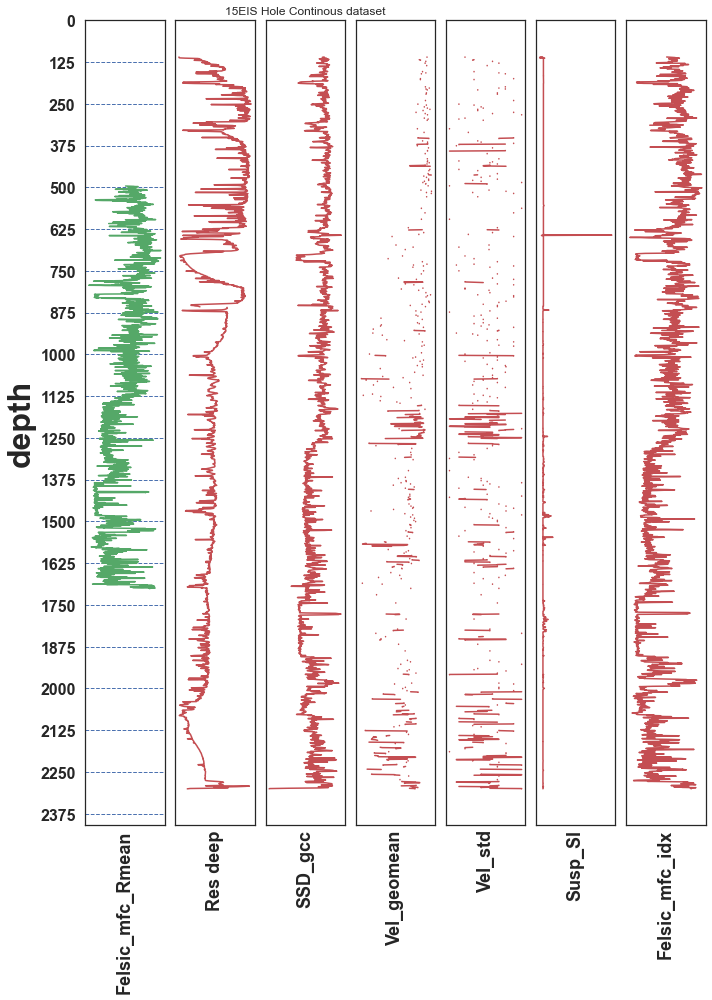

In [120]:
fig = plt.figure(figsize=(10,14))
ax1 = fig.add_subplot(171)
ax1.plot(df2_15EIS['Felsic_mfc_Rmean'].values, df2_15EIS['Depth_m'].values, 'g')
ax1.invert_yaxis()
ax1.set_ylabel('depth',fontsize=32)
ax1.tick_params(axis='y', labelsize=16)
ax1.grid(False)
ax1.set_ylim(2410, 0)
ax1.set_yticks(np.arange(0, 2450, 125))
ax1.set_xticks([])
ax1.yaxis.grid(linestyle='--', color='b')
ax1.set_xlabel('Felsic_mfc_Rmean',rotation=90,fontsize=18)

ax1 = fig.add_subplot(172)
ax1.plot(df2_15EIS['ResDeep'].values, df2_15EIS['Depth_m'].values, 'r')
ax1.invert_yaxis()
ax1.xaxis.tick_top()
ax1.set_xlabel('Res deep',rotation=90,fontsize=18)
ax1.set_xticks([])
ax1.set_yticks([])


ax1 = fig.add_subplot(173)
ax1.plot(df2_15EIS['SSD_gcc'].values, df2_15EIS['Depth_m'].values, 'r')
ax1.invert_yaxis()
ax1.xaxis.tick_top()
ax1.set_xlabel('SSD_gcc',rotation=90,fontsize=18)
ax1.set_xticks([])
ax1.set_yticks([])
plt.title('15EIS Hole Continous dataset')

ax1 = fig.add_subplot(174)
ax1.plot(df2_15EIS['Vel_geomean'].values, df2_15EIS['Depth_m'].values, 'r')
ax1.invert_yaxis()
ax1.xaxis.tick_top()
ax1.set_xlabel('Vel_geomean',rotation=90,fontsize=18)
ax1.set_xticks([])
ax1.set_yticks([])


ax1 = fig.add_subplot(175)
ax1.plot(df2_15EIS['Vel_std'].values, df2_15EIS['Depth_m'].values, 'r')
ax1.invert_yaxis()
ax1.xaxis.tick_top()
ax1.set_xlabel('Vel_std',rotation=90,fontsize=18)
ax1.set_xticks([])
ax1.set_yticks([])


ax1 = fig.add_subplot(176)
ax1.plot(df2_15EIS['Susp_SI'].values, df2_15EIS['Depth_m'].values, 'r')
ax1.invert_yaxis()
ax1.xaxis.tick_top()
ax1.set_xlabel('Susp_SI',rotation=90,fontsize=18)
ax1.set_xticks([])
ax1.set_yticks([])

ax1 = fig.add_subplot(177)
ax1.plot(df2_15EIS['Felsic_mfc_idx'].values, df2_15EIS['Depth_m'].values, 'r')
ax1.invert_yaxis()
ax1.xaxis.tick_top()
ax1.set_xlabel('Felsic_mfc_idx',rotation=90,fontsize=18)
ax1.set_xticks([])
ax1.set_yticks([])

plt.tight_layout()
plt.show()

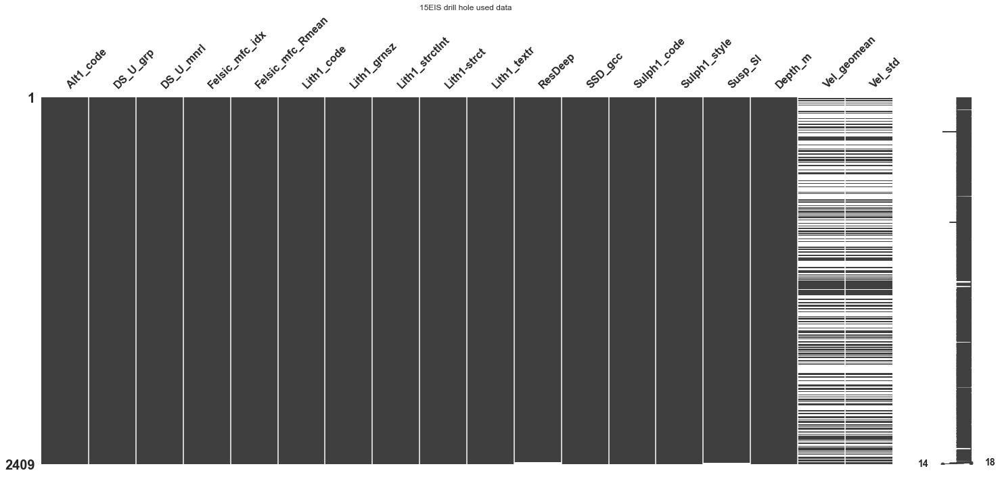

In [121]:
msno.matrix(df2_15EIS)
plt.title('15EIS drill hole used data ')
plt.show()

In [122]:
cat_df2_15EIS=df2_15EIS.select_dtypes(include=['object'].copy())
cat_df2_001=df2_001.select_dtypes(include=['object'].copy())
cat_df2_002=df2_002.select_dtypes(include=['object'].copy())
cat_df2_003=df2_003.select_dtypes(include=['object'].copy())
cat_df2_004=df2_004.select_dtypes(include=['object'].copy())

##<font color='red'> Dropping DS_U_grp from the dataframe to make it variables</font>

<span style="font-family: Arial; font-size:2.1em;color:blue;"> Dropping DS_U_grp from the dataframe to make it variable </p>

In [123]:
# Dropping DS_U_grp column from the dataframe to make it y variables

cat_df3_15EIS=cat_df2_15EIS.drop(['DS_U_grp'], axis=1)

In [124]:
num_df2_15EIS=df2_15EIS.select_dtypes(include=['float64'].copy())
num_df2_001=df2_001.select_dtypes(include=['float64'].copy())
num_df2_002=df2_002.select_dtypes(include=['float64'].copy())
num_df2_003=df2_003.select_dtypes(include=['float64'].copy())
num_df2_004=df2_004.select_dtypes(include=['float64'].copy())

In [125]:
cat_df3_15EIS.head()

,Alt1_code,DS_U_mnrl,Lith1_code,Lith1_grnsz,Lith1_strctInt,Lith1-strct,Lith1_textr,Sulph1_code,Sulph1_style
0,ch,Quartz,Abu,fg,v,sh,ma,py,ds
1,ch,Quartz,Abu,fg,v,sh,ma,py,ds
2,ch,Quartz,Abu,fg,v,sh,ma,py,ds
3,ch,Quartz,Abu,fg,v,sh,ma,py,ds
4,ch,Quartz,Abu,fg,v,sh,ma,py,ds


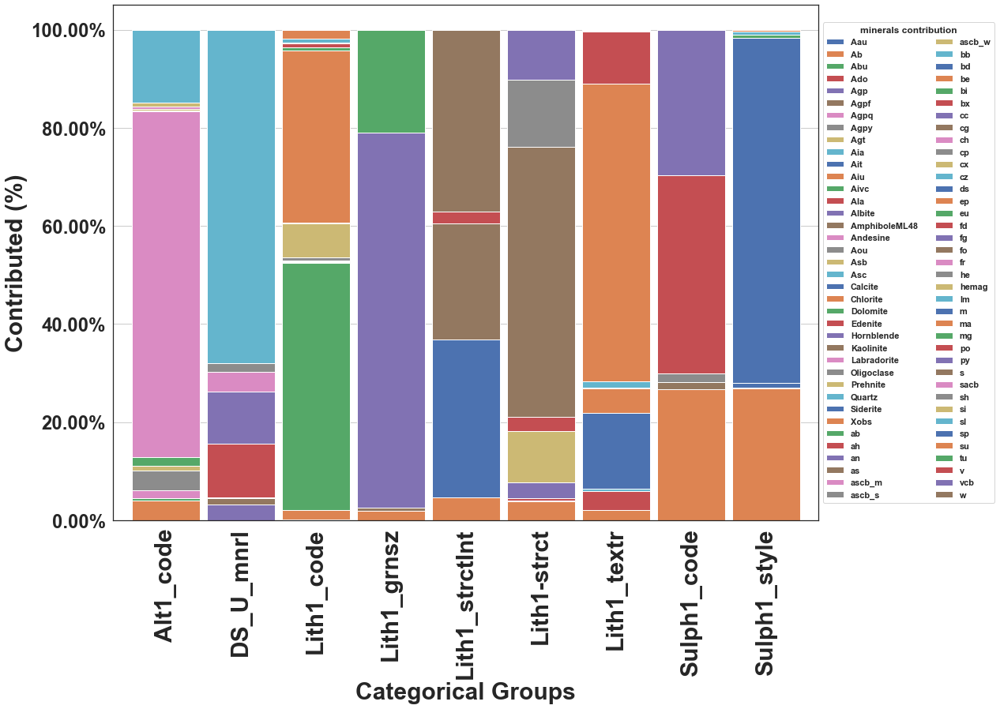

In [126]:
counts = cat_df3_15EIS.apply(lambda x: x.value_counts() / len(x)).transpose()
fig = plt.figure(figsize=(16,12))
ax = fig.add_subplot(111)
counts.plot(ax=ax,kind='bar', stacked=True, width=0.9, rot=90,fontsize=30)
vals = ax.get_yticks()
ax.set_yticklabels(['{:3.2f}%'.format(x*100) for x in vals], fontsize=24)
ax.set_xlabel('Categorical Groups',fontsize=30)
ax.set_ylabel('Contributed (%)',fontsize=30)
ax.yaxis.grid(True)
#ax.ylabels(rotation=90)
ax.set_axisbelow(True)
ax.legend(ncol=2,loc='center left',title='minerals contribution', bbox_to_anchor=(1, 0.5))
plt.show()

In [127]:
from statsmodels.graphics.mosaicplot import mosaic

In [128]:
num_df2_15EIS.head()

,Felsic_mfc_idx,Felsic_mfc_Rmean,ResDeep,SSD_gcc,Susp_SI,Depth_m,Vel_geomean,Vel_std
0,9555.8535,9556.0693,0.437919,3.134581,-0.002080,495.81237,7316.6562,12.472190
1,9649.8671,9671.0957,0.675465,3.108093,0.003907,496.27307,7316.6562,12.472190
2,9743.6796,9735.1005,1.123893,3.109071,-0.000964,496.74954,NaN,NaN
3,9750.4863,9758.8183,128.968990,3.107897,-0.002750,497.28299,NaN,NaN
4,9834.6845,9831.6513,1093.363500,3.147212,0.007615,497.72323,6389.9843,14.142135


In [129]:
#Apply per-column the mean of that columns and fill
num_df2_15EIS_fillna=num_df2_15EIS.apply(lambda x: x.fillna(x.mean()),axis=0)
num_df2_001_fillna=num_df2_001.apply(lambda x: x.fillna(x.mean()),axis=0)
num_df2_002_fillna=num_df2_002.apply(lambda x: x.fillna(x.mean()),axis=0)
num_df2_003_fillna=num_df2_003.apply(lambda x: x.fillna(x.mean()),axis=0)
num_df2_004_fillna=num_df2_004.apply(lambda x: x.fillna(x.mean()),axis=0)

In [130]:
print(num_df2_15EIS_fillna.shape)
print(num_df2_001_fillna.shape)
print(num_df2_002_fillna.shape)
print(num_df2_003_fillna.shape)
print(num_df2_004_fillna.shape)

(2409, 8)
(669, 4)
(703, 3)
(905, 6)
(1401, 5)


In [131]:
num_df2_15EIS_fillna.head()

,Felsic_mfc_idx,Felsic_mfc_Rmean,ResDeep,SSD_gcc,Susp_SI,Depth_m,Vel_geomean,Vel_std
0,9555.8535,9556.0693,0.437919,3.134581,-0.002080,495.81237,7316.656200,12.472190
1,9649.8671,9671.0957,0.675465,3.108093,0.003907,496.27307,7316.656200,12.472190
2,9743.6796,9735.1005,1.123893,3.109071,-0.000964,496.74954,6002.075272,23.609871
3,9750.4863,9758.8183,128.968990,3.107897,-0.002750,497.28299,6002.075272,23.609871
4,9834.6845,9831.6513,1093.363500,3.147212,0.007615,497.72323,6389.984300,14.142135


In [132]:
print(cat_df2_15EIS.isnull().sum())

Alt1_code         0
DS_U_grp          0
DS_U_mnrl         0
Lith1_code        0
Lith1_grnsz       0
Lith1_strctInt    0
Lith1-strct       0
Lith1_textr       0
Sulph1_code       0
Sulph1_style      0
dtype: int64


In [133]:
cat_df2_15EIS.columns

Index(['Alt1_code', 'DS_U_grp', 'DS_U_mnrl', 'Lith1_code', 'Lith1_grnsz',
       'Lith1_strctInt', 'Lith1-strct', 'Lith1_textr', 'Sulph1_code',
       'Sulph1_style'],
      dtype='object')

In [134]:
print(cat_df2_15EIS['Alt1_code'].value_counts())

ch        1695
sl         359
ascb_s      99
Xobs        98
bi          45
ascb_m      36
ascb_w      22
si          20
ab          11
sacb         9
hemag        8
ep           4
he           3
Name: Alt1_code, dtype: int64


In [135]:
print("Alt1_code:",cat_df2_15EIS['Lith1_textr'].value_counts())

Alt1_code: ma      1463
bd       372
po       255
be       120
ah        93
Xobs      50
cz        29
bb        13
si         4
tu         3
sp         3
cc         2
fr         1
cx         1
Name: Lith1_textr, dtype: int64


In [136]:
print("Alt1_code:",cat_df2_15EIS['Alt1_code'].value_counts().count())
print("Lith1_textr:",cat_df2_15EIS['Lith1_textr'].value_counts().count())
print("Sulph_code:",cat_df2_15EIS['Sulph1_code'].value_counts().count())
print("Sulph_style:",cat_df2_15EIS['Sulph1_style'].value_counts().count())

Alt1_code: 13
Lith1_textr: 14
Sulph_code: 5
Sulph_style: 8


In [137]:
#Alt1_code_count = cat_df2_15EIS['Alt1_code'].value_counts()
#Alt1_code_count.sum()

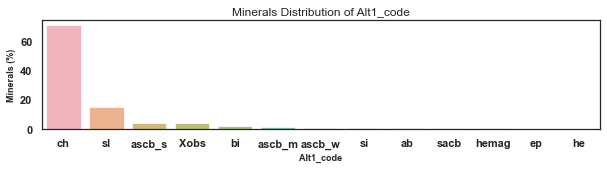

In [138]:
%matplotlib inline
import seaborn as sns
import matplotlib.pyplot as plt
plt.figure(figsize=(10,2))
Alt1_code_count = cat_df2_15EIS['Alt1_code'].value_counts()
#sns.set(style="darkgrid")
sns.barplot(Alt1_code_count.index, (Alt1_code_count.values/2409)*100, alpha=0.7)
plt.title('Minerals Distribution of Alt1_code')
plt.ylabel('Minerals (%)', fontsize=9)
plt.xlabel('Alt1_code', fontsize=9)
#plt.figure(figsize=(21,9))
plt.show()

In [139]:
labels = cat_df2_15EIS['Alt1_code'].astype('category').cat.categories.tolist()
#labels
counts = cat_df2_15EIS['Alt1_code'].value_counts()
count1= counts<10
count1

ch        False
sl        False
ascb_s    False
Xobs      False
bi        False
ascb_m    False
ascb_w    False
si        False
ab        False
sacb       True
hemag      True
ep         True
he         True
Name: Alt1_code, dtype: bool

<Figure size 432x288 with 0 Axes>

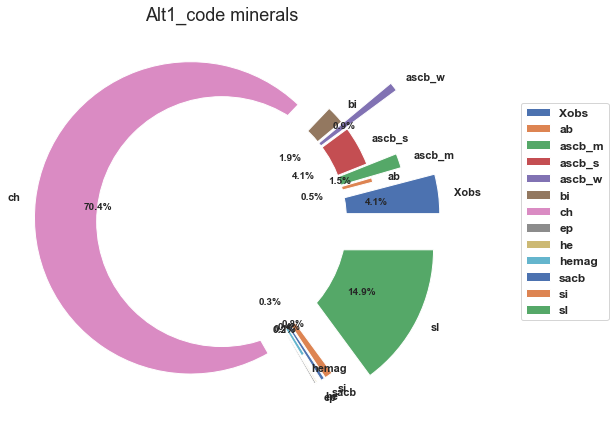

In [140]:
plt.figure(0)
labels = cat_df2_15EIS['Alt1_code'].astype('category').cat.categories.tolist()
counts = ((cat_df2_15EIS['Alt1_code'].value_counts()))
explode = (0.4, 0, 0.2, 0, 0.4, 0, 0.2, 0.2, 0.2, 0, 0.2, 0.2, 0.4)  # explode alternate slice
sizes = [counts[var_cat] for var_cat in labels]
#fig1, ax1 = plt.subplots()
##ax1.pie(sizes, labels=labels, explode=explode, autopct='%1.1f%%', shadow=False) #autopct is show the % on plot
#ax1.pie(sizes,  explode=explode,  shadow=False) #autopct is show the % on plot
#ax1.axis('equal')
plt.figure(figsize= (10,6))
plt.pie(sizes, labels=labels, autopct='%1.1f%%', startangle=0, explode =explode)
centre_circle = plt.Circle((0,0),0.80,fc='white')
fig = plt.gcf()
fig.gca().add_artist(centre_circle)
plt.legend(labels, bbox_to_anchor=(1.0,0.5), loc="center right", fontsize=12, 
           bbox_transform=plt.gcf().transFigure)
plt.title('Alt1_code minerals',fontsize=18)
plt.tight_layout()
plt.show()

<Figure size 432x288 with 0 Axes>

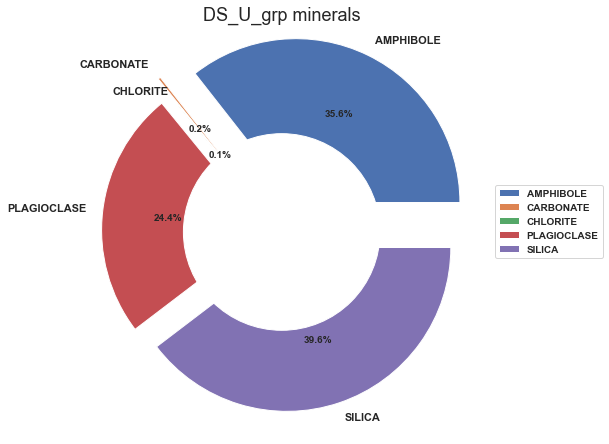

In [141]:
plt.figure(0)
#plt.rcParams["figure.figsize"] = (7,7)
labels = cat_df2_15EIS['DS_U_grp'].astype('category').cat.categories.tolist()
counts = cat_df2_15EIS['DS_U_grp'].value_counts()
explode = (0.2, 0.2, 0, 0.1, 0.1)  # explode alternate slice
sizes = [counts[var_cat] for var_cat in labels]
#fig1, ax1 = plt.subplots()
#ax1.pie(sizes, labels=labels, explode=explode, autopct='%1.1f%%', shadow=True) #autopct is show the % on plot
#ax1.pie(sizes, labels=labels, explode=explode,  shadow=True) #autopct is show the % on plot
#ax1.axis('equal')
plt.figure(figsize= (8,8))
plt.pie(sizes, labels=labels, autopct='%1.1f%%', startangle=0, explode =explode)
centre_circle = plt.Circle((0,0),0.60,fc='white')
fig = plt.gcf()
fig.gca().add_artist(centre_circle)
plt.legend(labels, bbox_to_anchor=(1.05,0.5), loc="center right", fontsize=10, 
           bbox_transform=plt.gcf().transFigure)
plt.title('DS_U_grp minerals',fontsize=18)
plt.tight_layout()
plt.show()

<Figure size 432x288 with 0 Axes>

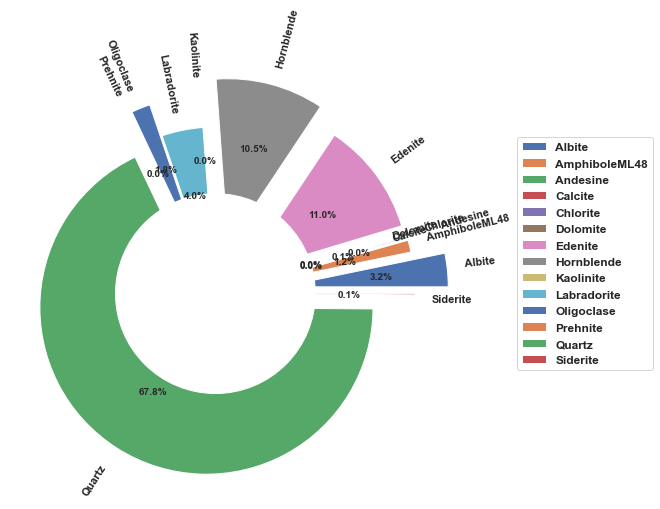

In [142]:
plt.figure(0)
labels = cat_df2_15EIS['DS_U_mnrl'].astype('category').cat.categories.tolist()
counts = cat_df2_15EIS['DS_U_mnrl'].value_counts()
explode = (0.4, 0.2, 0.3, 0, 0.2, 0, 0.2, 0.3, 0.2, 0, 0.2, 0.2, 0.1,0.2)  # explode alternate slice
sizes = [counts[var_cat] for var_cat in labels]
#fig1, ax1 = plt.subplots()
#ax1.pie(sizes, labels=labels, explode=explode, shadow=False,pctdistance=1.1, labeldistance=0.3,rotatelabels = 270) #autopct is show the % on plot
#ax1.axis('equal')
plt.figure(figsize= (8,8))
plt.pie(sizes, labels=labels, autopct='%1.1f%%', startangle=0, explode =explode,rotatelabels = 270)
centre_circle = plt.Circle((0,0),0.60,fc='white')
fig = plt.gcf()
fig.gca().add_artist(centre_circle)
plt.legend(labels, bbox_to_anchor=(1.15,0.5), loc="center right", fontsize=12, 
           bbox_transform=plt.gcf().transFigure)
#plt.title('DS_U_mnrl minerals',fontsize=24)

plt.tight_layout()
plt.show()

<Figure size 432x288 with 0 Axes>

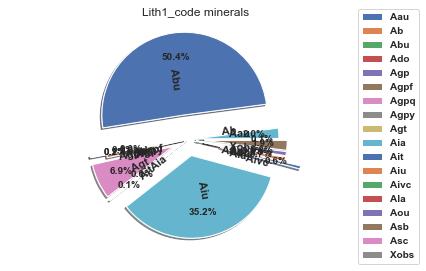

In [143]:
#plt.figure(figsize=(12,12))
plt.figure(0)
labels = cat_df2_15EIS['Lith1_code'].astype('category').cat.categories.tolist()
counts = cat_df2_15EIS['Lith1_code'].value_counts()
explode = (0.2, 0.1, 0.3, 0.1, 0.2, 0, 0.2, 0, 0.2, 0, 0.2, 0.2, 0.4,0.2,0.1,0.2,0.2,0.2)  # explode alternate slice
sizes = [counts[var_cat] for var_cat in labels]
fig1, ax1 = plt.subplots()
ax1.pie(sizes, labels=labels, explode=explode, autopct='%1.1f%%',pctdistance=0.7,labeldistance=0.3, shadow=False, rotatelabels=270) #autopct is show the % on plot
ax1.pie(sizes,  explode=explode,  shadow=True) #autopct is show the % on plot
ax1.axis('equal')
plt.legend(labels, bbox_to_anchor=(0.99,0.5), loc="center right", fontsize=10, 
           bbox_transform=plt.gcf().transFigure)
plt.title('Lith1_code minerals',fontsize=12)
plt.tight_layout()
plt.show()

<Figure size 432x288 with 0 Axes>

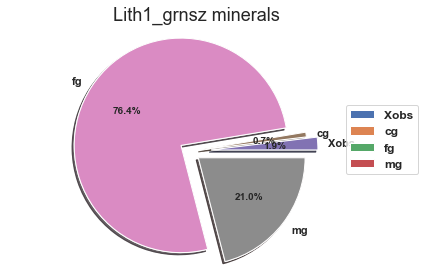

In [144]:
plt.figure(0)
labels = cat_df2_15EIS['Lith1_grnsz'].astype('category').cat.categories.tolist()
counts = cat_df2_15EIS['Lith1_grnsz'].value_counts()
explode = (0.2, 0.1, 0.1, 0.1)  # explode alternate slice
sizes = [counts[var_cat] for var_cat in labels]
fig1, ax1 = plt.subplots()
ax1.pie(sizes, labels=labels, explode=explode, autopct='%1.1f%%', shadow=True) #autopct is show the % on plot
ax1.pie(sizes, explode=explode,  shadow=True)
ax1.axis('equal')
plt.legend(labels, bbox_to_anchor=(0.99,0.5), loc="center right", fontsize=12, 
           bbox_transform=plt.gcf().transFigure)
plt.title('Lith1_grnsz minerals',fontsize=18)
plt.tight_layout()
plt.show()

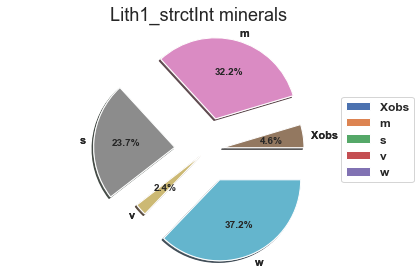

In [145]:
labels = cat_df2_15EIS['Lith1_strctInt'].astype('category').cat.categories.tolist()
counts = cat_df2_15EIS['Lith1_strctInt'].value_counts()
explode = (0.2, 0.4, 0.4, 0.1,0.4)  # explode alternate slice
sizes = [counts[var_cat] for var_cat in labels]
fig1, ax1 = plt.subplots()
ax1.pie(sizes, labels=labels, explode=explode, autopct='%1.1f%%', shadow=True) #autopct is show the % on plot
ax1.pie(sizes, labels=labels, explode=explode, shadow=True) #autopct is show the % on plot
ax1.axis('equal')
plt.legend(labels, bbox_to_anchor=(0.98,0.5), loc="center right", fontsize=12, 
           bbox_transform=plt.gcf().transFigure)
plt.title('Lith1_strctInt minerals',fontsize=18)
plt.tight_layout()
plt.show()

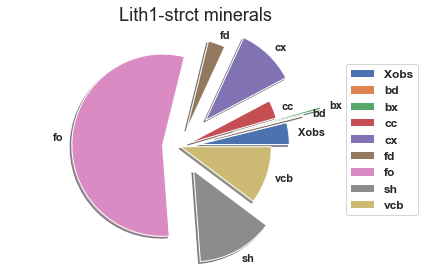

In [146]:
labels = cat_df2_15EIS['Lith1-strct'].astype('category').cat.categories.tolist()
counts = cat_df2_15EIS['Lith1-strct'].value_counts()
explode = (0.2, 0.4, 0.6, 0.1,0.4,0.2,0.2,0.3,0)  # explode alternate slice
sizes = [counts[var_cat] for var_cat in labels]
fig1, ax1 = plt.subplots()
ax1.pie(sizes, labels=labels, explode=explode,  shadow=True) #autopct is show the % on plot
ax1.axis('equal')
plt.legend(labels, bbox_to_anchor=(0.99,0.5), loc="center right", fontsize=12, 
           bbox_transform=plt.gcf().transFigure)
plt.title('Lith1-strct minerals',fontsize=18)
plt.tight_layout()
plt.show()

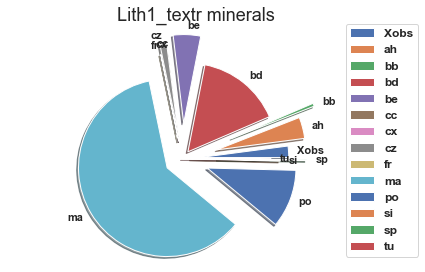

In [147]:
labels = cat_df2_15EIS['Lith1_textr'].astype('category').cat.categories.tolist()
counts = cat_df2_15EIS['Lith1_textr'].value_counts()
explode = (0.2, 0.4, 0.6, 0.1,0.4,0.2,0.2,0.3,0.2,0.2,0.3,0.1,0.4,0)  # explode alternate slice
sizes = [counts[var_cat] for var_cat in labels]
fig1, ax1 = plt.subplots()
ax1.pie(sizes, labels=labels, explode=explode, shadow=True) #autopct is show the % on plot
ax1.axis('equal')
plt.legend(labels, bbox_to_anchor=(0.99,0.5), loc="center right", fontsize=12, 
           bbox_transform=plt.gcf().transFigure)
plt.title('Lith1_textr minerals',fontsize=18)
plt.tight_layout()
plt.show()

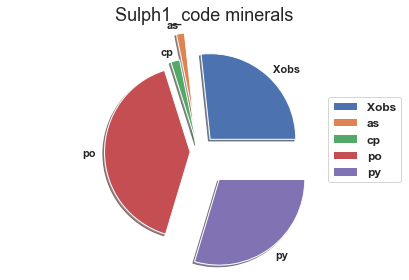

In [148]:


labels = cat_df2_15EIS['Sulph1_code'].astype('category').cat.categories.tolist()
counts = cat_df2_15EIS['Sulph1_code'].value_counts()
explode = (0.2, 0.4, 0.1, 0.1,0.4)  # explode alternate slice
sizes = [counts[var_cat] for var_cat in labels]
fig1, ax1 = plt.subplots()
ax1.pie(sizes, labels=labels, explode=explode, shadow=True) #autopct is show the % on plot
ax1.axis('equal')
plt.legend(labels, bbox_to_anchor=(0.95,0.5), loc="center right", fontsize=12, 
           bbox_transform=plt.gcf().transFigure)
plt.title('Sulph1_code minerals',fontsize=18)
plt.tight_layout()
plt.show()

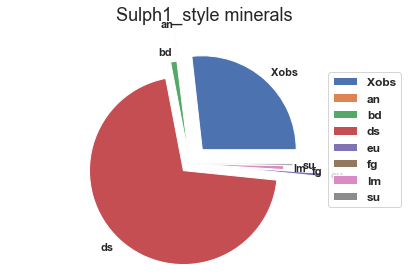

In [149]:
labels = cat_df2_15EIS['Sulph1_style'].astype('category').cat.categories.tolist()
counts = cat_df2_15EIS['Sulph1_style'].value_counts()
explode = (0.2, 0.4, 0.1, 0.1,0.4,0.2,0,0.1)  # explode alternate slice
sizes = [counts[var_cat] for var_cat in labels]
fig1, ax1 = plt.subplots()
#ax1.pie(sizes, labels=labels, explode=explode, autopct='%1.1f%%', shadow=True) #autopct is show the % on plot
ax1.pie(sizes, labels=labels, explode=explode, shadow=False) #autopct is show the % on plot
ax1.axis('equal')
plt.legend(labels, bbox_to_anchor=(0.95,0.5), loc="center right", fontsize=12, 
           bbox_transform=plt.gcf().transFigure)
plt.title('Sulph1_style minerals',fontsize=18)
plt.tight_layout()
plt.show()

In [150]:

from sklearn.preprocessing import LabelBinarizer
#import category_encoders as ce

In [151]:
#!pip install category_encoders

In [152]:
import category_encoders as ce



<div class="alert alert-block alert-info">
<font color='red'>cat_df2_15EIS has all the variable . DS_U_grp column has been drop to make it y variable</font>
</div>

In [153]:
# cat_df2_15EIS has all the variable . DS_U_grp column has been drop to make it y variable,
cat_df3_15EIS.head()

,Alt1_code,DS_U_mnrl,Lith1_code,Lith1_grnsz,Lith1_strctInt,Lith1-strct,Lith1_textr,Sulph1_code,Sulph1_style
0,ch,Quartz,Abu,fg,v,sh,ma,py,ds
1,ch,Quartz,Abu,fg,v,sh,ma,py,ds
2,ch,Quartz,Abu,fg,v,sh,ma,py,ds
3,ch,Quartz,Abu,fg,v,sh,ma,py,ds
4,ch,Quartz,Abu,fg,v,sh,ma,py,ds


In [154]:
#cat_df2_ce.head()
cat_df3_15EIS.columns

Index(['Alt1_code', 'DS_U_mnrl', 'Lith1_code', 'Lith1_grnsz', 'Lith1_strctInt',
       'Lith1-strct', 'Lith1_textr', 'Sulph1_code', 'Sulph1_style'],
      dtype='object')

In [155]:
cat_df2_001.columns

Index(['Alt1_code', 'DS_U_grp', 'DS_U_mnrl', 'Lith1_code', 'Lith1_grnsz',
       'Lith1_strctInt', 'Lith1-strct', 'Lith1_textr', 'Sulph1_code'],
      dtype='object')

In [156]:
cat_df2_002.columns

Index(['Alt1_code', 'DS_U_grp', 'DS_U_mnrl', 'Lith1_code', 'Lith1_grnsz',
       'Lith1_strctInt', 'Lith1-strct', 'Lith1_textr', 'Sulph1_code'],
      dtype='object')

In [157]:
cat_df2_003.columns

Index(['Alt1_code', 'DS_U_grp', 'DS_U_mnrl', 'Lith1_code', 'Lith1_grnsz',
       'Lith1_strctInt', 'Lith1-strct', 'Lith1_textr', 'Sulph1_code'],
      dtype='object')

In [158]:
cat_df2_004.columns

Index(['Alt1_code', 'DS_U_grp', 'DS_U_mnrl', 'Lith1_code', 'Lith1_grnsz',
       'Lith1_strctInt', 'Lith1-strct', 'Lith1_textr', 'Sulph1_code'],
      dtype='object')

In [159]:
cat_df3_15EIS_ce = cat_df3_15EIS.copy()
cat_df2_001_ce = cat_df2_001.copy()
cat_df2_002_ce = cat_df2_002.copy()
cat_df2_003_ce = cat_df2_003.copy()
cat_df2_004_ce = cat_df2_004.copy()

In [160]:
#cat_df2_002_ce.shape

In [161]:
cat_df3_15EIS_ce_onehot = cat_df3_15EIS.copy()
cat_df3_15EIS_ce_onehot = pd.get_dummies(cat_df3_15EIS_ce_onehot, columns=['Alt1_code','DS_U_mnrl','Lith1_code','Lith1_grnsz','Lith1_strctInt','Lith1-strct','Lith1_textr','Sulph1_code','Sulph1_style'], 
                                   prefix = ['Alt1_code','DS_U_mnrl','Lith1_code','Lith1_grnsz','Lith1_strctInt','Lith1-strct','Lith1_textr','Sulph1_code','Sulph1_style'])

In [162]:
cat_df2_001_ce_onehot = cat_df2_001.copy()
cat_df2_001_ce_onehot = pd.get_dummies(cat_df2_001_ce_onehot, columns=['Alt1_code', 'DS_U_grp', 'DS_U_mnrl', 'Lith1_code', 'Lith1_grnsz',
       'Lith1_strctInt', 'Lith1-strct', 'Lith1_textr', 'Sulph1_code'], 
                                   prefix = ['Alt1_code', 'DS_U_grp', 'DS_U_mnrl', 'Lith1_code', 'Lith1_grnsz',
       'Lith1_strctInt', 'Lith1-strct', 'Lith1_textr', 'Sulph1_code'])

In [163]:
cat_df2_002_ce_onehot = cat_df2_002.copy()
cat_df2_002_ce_onehot = pd.get_dummies(cat_df2_002_ce_onehot, columns=['Alt1_code', 'DS_U_grp', 'DS_U_mnrl', 'Lith1_code', 'Lith1_grnsz',
       'Lith1_strctInt', 'Lith1-strct', 'Lith1_textr', 'Sulph1_code'], 
                                   prefix = ['Alt1_code', 'DS_U_grp', 'DS_U_mnrl', 'Lith1_code', 'Lith1_grnsz',
       'Lith1_strctInt', 'Lith1-strct', 'Lith1_textr', 'Sulph1_code'])

In [164]:
cat_df2_003_ce_onehot = cat_df2_003.copy()
cat_df2_003_ce_onehot = pd.get_dummies(cat_df2_003_ce_onehot, columns=['Alt1_code', 'DS_U_grp', 'DS_U_mnrl', 'Lith1_code', 'Lith1_grnsz',
       'Lith1_strctInt', 'Lith1-strct', 'Lith1_textr', 'Sulph1_code'], 
                                   prefix = ['Alt1_code', 'DS_U_grp', 'DS_U_mnrl', 'Lith1_code', 'Lith1_grnsz',
       'Lith1_strctInt', 'Lith1-strct', 'Lith1_textr', 'Sulph1_code'])

In [165]:
cat_df2_004_ce_onehot = cat_df2_004.copy()
cat_df2_004_ce_onehot = pd.get_dummies(cat_df2_004_ce_onehot, columns=['Alt1_code', 'DS_U_grp', 'DS_U_mnrl', 'Lith1_code', 'Lith1_grnsz',
       'Lith1_strctInt', 'Lith1-strct', 'Lith1_textr', 'Sulph1_code'], 
                                   prefix = ['Alt1_code', 'DS_U_grp', 'DS_U_mnrl', 'Lith1_code', 'Lith1_grnsz',
       'Lith1_strctInt', 'Lith1-strct', 'Lith1_textr', 'Sulph1_code'])

In [166]:
cat_df3_15EIS_ce_onehot.head()

,Alt1_code_Xobs,Alt1_code_ab,Alt1_code_ascb_m,Alt1_code_ascb_s,Alt1_code_ascb_w,Alt1_code_bi,Alt1_code_ch,Alt1_code_ep,Alt1_code_he,Alt1_code_hemag,Alt1_code_sacb,Alt1_code_si,Alt1_code_sl,DS_U_mnrl_Albite,DS_U_mnrl_AmphiboleML48,DS_U_mnrl_Andesine,DS_U_mnrl_Calcite,DS_U_mnrl_Chlorite,DS_U_mnrl_Dolomite,DS_U_mnrl_Edenite,DS_U_mnrl_Hornblende,DS_U_mnrl_Kaolinite,DS_U_mnrl_Labradorite,DS_U_mnrl_Oligoclase,DS_U_mnrl_Prehnite,DS_U_mnrl_Quartz,DS_U_mnrl_Siderite,Lith1_code_Aau,Lith1_code_Ab,Lith1_code_Abu,Lith1_code_Ado,Lith1_code_Agp,Lith1_code_Agpf,Lith1_code_Agpq,Lith1_code_Agpy,Lith1_code_Agt,Lith1_code_Aia,Lith1_code_Ait,Lith1_code_Aiu,Lith1_code_Aivc,Lith1_code_Ala,Lith1_code_Aou,Lith1_code_Asb,Lith1_code_Asc,Lith1_code_Xobs,Lith1_grnsz_Xobs,Lith1_grnsz_cg,Lith1_grnsz_fg,Lith1_grnsz_mg,Lith1_strctInt_Xobs,Lith1_strctInt_m,Lith1_strctInt_s,Lith1_strctInt_v,Lith1_strctInt_w,Lith1-strct_Xobs,Lith1-strct_bd,Lith1-strct_bx,Lith1-strct_cc,Lith1-strct_cx,Lith1-strct_fd,Lith1-strct_fo,Lith1-strct_sh,Lith1-strct_vcb,Lith1_textr_Xobs,Lith1_textr_ah,Lith1_textr_bb,Lith1_textr_bd,Lith1_textr_be,Lith1_textr_cc,Lith1_textr_cx,Lith1_textr_cz,Lith1_textr_fr,Lith1_textr_ma,Lith1_textr_po,Lith1_textr_si,Lith1_textr_sp,Lith1_textr_tu,Sulph1_code_Xobs,Sulph1_code_as,Sulph1_code_cp,Sulph1_code_po,Sulph1_code_py,Sulph1_style_Xobs,Sulph1_style_an,Sulph1_style_bd,Sulph1_style_ds,Sulph1_style_eu,Sulph1_style_fg,Sulph1_style_lm,Sulph1_style_su
0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,1,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,1,0,0,0,1,0,0,0,0
1,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,1,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,1,0,0,0,1,0,0,0,0
2,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,1,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,1,0,0,0,1,0,0,0,0
3,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,1,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,1,0,0,0,1,0,0,0,0
4,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,1,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,1,0,0,0,1,0,0,0,0


In [167]:
#df_bde.describe()
#df_bde.info()
#df_bde.dtypes

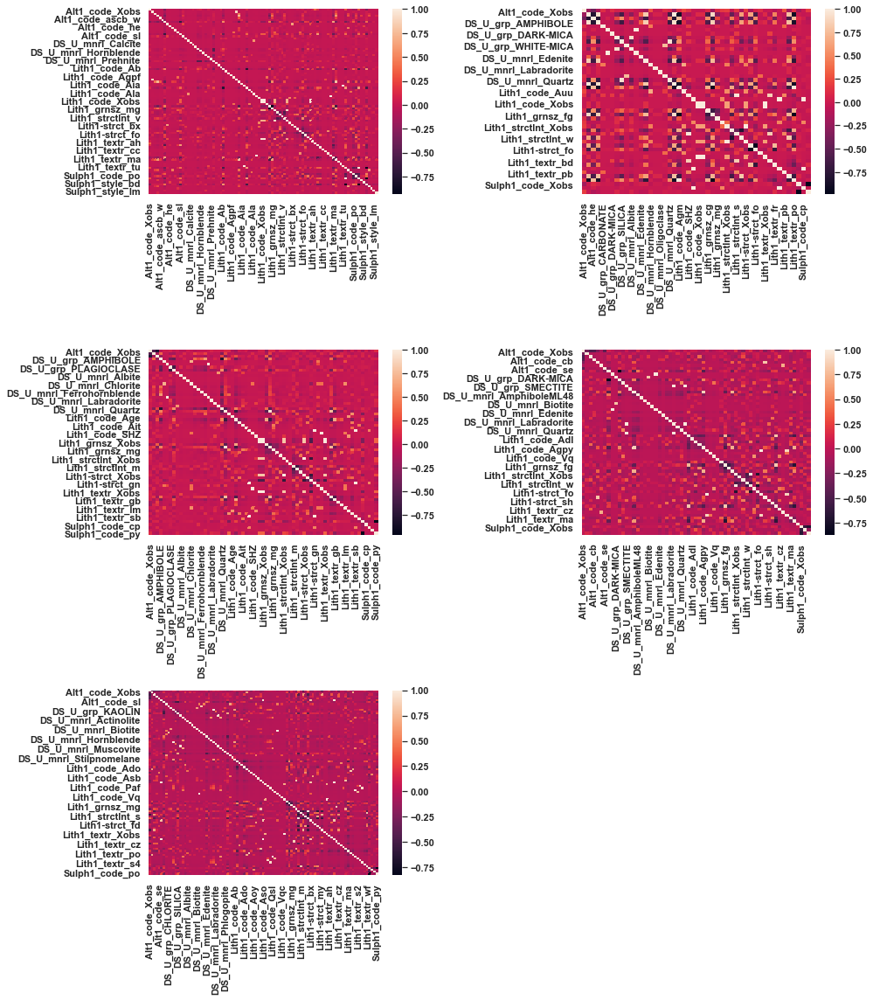

In [168]:
plt.figure(figsize=(14,16))
plt.subplot(3,2,1)
sns.heatmap(cat_df3_15EIS_ce_onehot.corr())

plt.subplot(3,2,2)
sns.heatmap(cat_df2_001_ce_onehot.corr())

plt.subplot(3,2,3)
sns.heatmap(cat_df2_002_ce_onehot.corr())

plt.subplot(3,2,4)
sns.heatmap(cat_df2_003_ce_onehot.corr())

plt.subplot(3,2,5)
sns.heatmap(cat_df2_004_ce_onehot.corr())

plt.tight_layout()

plt.show()

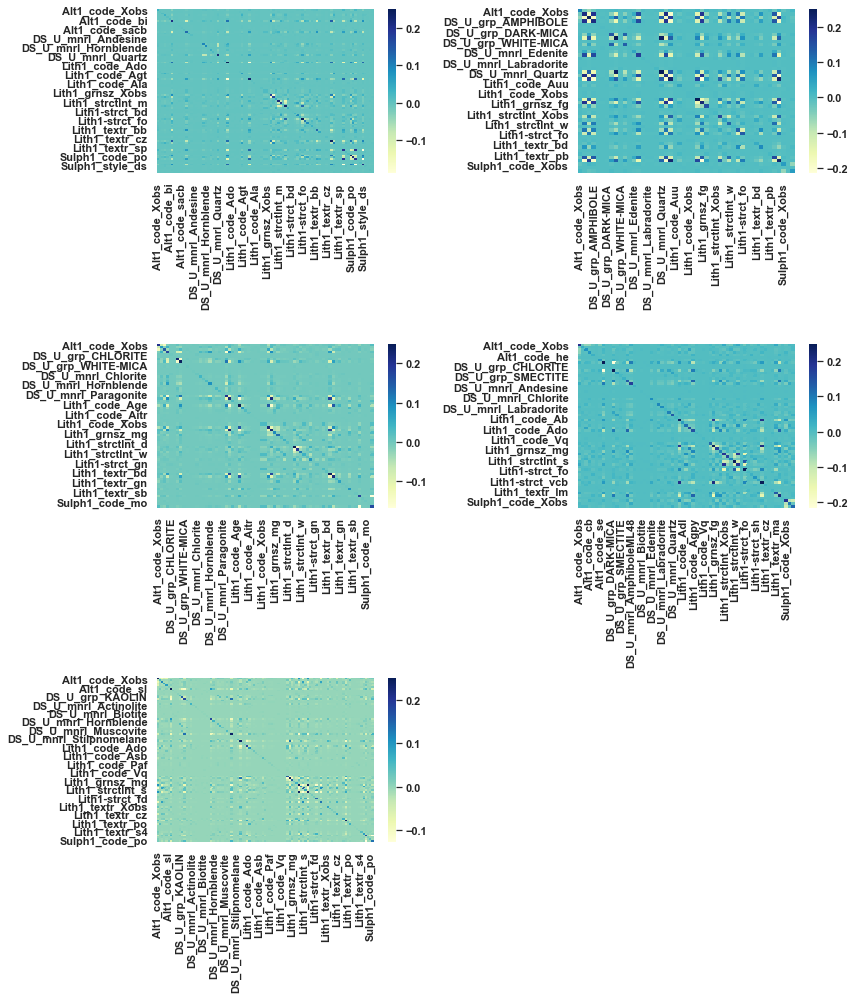

In [169]:

plt.figure(figsize=(12,14))
plt.subplot(3,2,1)
sns.heatmap(cat_df3_15EIS_ce_onehot.cov(), cmap="YlGnBu")

plt.subplot(3,2,2)
sns.heatmap(cat_df2_001_ce_onehot.cov(), cmap="YlGnBu")

plt.subplot(3,2,3)
sns.heatmap(cat_df2_002_ce_onehot.cov(), cmap="YlGnBu")

plt.subplot(3,2,4)
sns.heatmap(cat_df2_003_ce_onehot.cov(), cmap="YlGnBu")

plt.subplot(3,2,5)
sns.heatmap(cat_df2_004_ce_onehot.cov(), cmap="YlGnBu")

plt.tight_layout()

plt.show()

# <span style='background:yellow'> Principal Component Analysis (PCA) </span>

In [170]:
# Categorical features for 15EIS
print(cat_df3_15EIS_ce_onehot.keys())

Index(['Alt1_code_Xobs', 'Alt1_code_ab', 'Alt1_code_ascb_m',
       'Alt1_code_ascb_s', 'Alt1_code_ascb_w', 'Alt1_code_bi', 'Alt1_code_ch',
       'Alt1_code_ep', 'Alt1_code_he', 'Alt1_code_hemag', 'Alt1_code_sacb',
       'Alt1_code_si', 'Alt1_code_sl', 'DS_U_mnrl_Albite',
       'DS_U_mnrl_AmphiboleML48', 'DS_U_mnrl_Andesine', 'DS_U_mnrl_Calcite',
       'DS_U_mnrl_Chlorite', 'DS_U_mnrl_Dolomite', 'DS_U_mnrl_Edenite',
       'DS_U_mnrl_Hornblende', 'DS_U_mnrl_Kaolinite', 'DS_U_mnrl_Labradorite',
       'DS_U_mnrl_Oligoclase', 'DS_U_mnrl_Prehnite', 'DS_U_mnrl_Quartz',
       'DS_U_mnrl_Siderite', 'Lith1_code_Aau', 'Lith1_code_Ab',
       'Lith1_code_Abu', 'Lith1_code_Ado', 'Lith1_code_Agp', 'Lith1_code_Agpf',
       'Lith1_code_Agpq', 'Lith1_code_Agpy', 'Lith1_code_Agt',
       'Lith1_code_Aia', 'Lith1_code_Ait', 'Lith1_code_Aiu', 'Lith1_code_Aivc',
       'Lith1_code_Ala', 'Lith1_code_Aou', 'Lith1_code_Asb', 'Lith1_code_Asc',
       'Lith1_code_Xobs', 'Lith1_grnsz_Xobs', 'Lith1_grnsz

In [171]:
# # Categorical features for  dd0001
print(cat_df2_001_ce_onehot.keys())

Index(['Alt1_code_Xobs', 'Alt1_code_ch', 'Alt1_code_he', 'DS_U_grp_AMPHIBOLE',
       'DS_U_grp_CARBONATE', 'DS_U_grp_CHLORITE', 'DS_U_grp_DARK-MICA',
       'DS_U_grp_PLAGIOCLASE', 'DS_U_grp_SILICA', 'DS_U_grp_WHITE-MICA',
       'DS_U_mnrl_Albite', 'DS_U_mnrl_Chlorite', 'DS_U_mnrl_Edenite',
       'DS_U_mnrl_Ferrohornblende', 'DS_U_mnrl_Hornblende',
       'DS_U_mnrl_Labradorite', 'DS_U_mnrl_Oligoclase', 'DS_U_mnrl_Paragonite',
       'DS_U_mnrl_Quartz', 'Lith1_code_Abu', 'Lith1_code_Agm',
       'Lith1_code_Auu', 'Lith1_code_SHZ', 'Lith1_code_Vq', 'Lith1_code_Xobs',
       'Lith1_grnsz_Xobs', 'Lith1_grnsz_cg', 'Lith1_grnsz_fg',
       'Lith1_grnsz_mg', 'Lith1_grnsz_vcg', 'Lith1_strctInt_Xobs',
       'Lith1_strctInt_m', 'Lith1_strctInt_s', 'Lith1_strctInt_w',
       'Lith1-strct_Xobs', 'Lith1-strct_bx', 'Lith1-strct_fo',
       'Lith1-strct_sc', 'Lith1_textr_Xobs', 'Lith1_textr_bd',
       'Lith1_textr_fr', 'Lith1_textr_ma', 'Lith1_textr_pb', 'Lith1_textr_pi',
       'Lith1_textr_po

In [172]:
# # Categorical features for  dd0002
print(cat_df2_002_ce_onehot.keys())

Index(['Alt1_code_Xobs', 'Alt1_code_ep', 'Alt1_code_he', 'DS_U_grp_AMPHIBOLE',
       'DS_U_grp_CHLORITE', 'DS_U_grp_KAOLIN', 'DS_U_grp_PLAGIOCLASE',
       'DS_U_grp_SILICA', 'DS_U_grp_WHITE-MICA', 'DS_U_mnrl_Albite',
       'DS_U_mnrl_Anorthite', 'DS_U_mnrl_Bytownite', 'DS_U_mnrl_Chlorite',
       'DS_U_mnrl_Edenite', 'DS_U_mnrl_Epidote', 'DS_U_mnrl_Ferrohornblende',
       'DS_U_mnrl_Hornblende', 'DS_U_mnrl_Kaolinite', 'DS_U_mnrl_Labradorite',
       'DS_U_mnrl_Oligoclase', 'DS_U_mnrl_Paragonite', 'DS_U_mnrl_Quartz',
       'Lith1_code_Abu', 'Lith1_code_Ado', 'Lith1_code_Age', 'Lith1_code_Agmq',
       'Lith1_code_Agt', 'Lith1_code_Ait', 'Lith1_code_Aitr',
       'Lith1_code_LODE', 'Lith1_code_SHZ', 'Lith1_code_UNKN',
       'Lith1_code_Xobs', 'Lith1_grnsz_Xobs', 'Lith1_grnsz_cg',
       'Lith1_grnsz_fg', 'Lith1_grnsz_mg', 'Lith1_grnsz_vcg',
       'Lith1_grnsz_vfg', 'Lith1_strctInt_Xobs', 'Lith1_strctInt_d',
       'Lith1_strctInt_i', 'Lith1_strctInt_m', 'Lith1_strctInt_s',
       

In [173]:
# # Categorical features for  dd0003
print(cat_df2_003_ce_onehot.keys())

Index(['Alt1_code_Xobs', 'Alt1_code_ab', 'Alt1_code_bi', 'Alt1_code_cb',
       'Alt1_code_he', 'Alt1_code_qc', 'Alt1_code_se', 'DS_U_grp_AMPHIBOLE',
       'DS_U_grp_CHLORITE', 'DS_U_grp_DARK-MICA', 'DS_U_grp_PLAGIOCLASE',
       'DS_U_grp_SILICA', 'DS_U_grp_SMECTITE', 'DS_U_mnrl_Actinolite',
       'DS_U_mnrl_Albite', 'DS_U_mnrl_AmphiboleML48', 'DS_U_mnrl_Andesine',
       'DS_U_mnrl_Anorthite', 'DS_U_mnrl_Biotite', 'DS_U_mnrl_Bytownite',
       'DS_U_mnrl_Chlorite', 'DS_U_mnrl_Edenite', 'DS_U_mnrl_Epidote',
       'DS_U_mnrl_Hornblende', 'DS_U_mnrl_Labradorite',
       'DS_U_mnrl_Montmorillonite', 'DS_U_mnrl_Oligoclase', 'DS_U_mnrl_Quartz',
       'Lith1_code_Ab', 'Lith1_code_Abu', 'Lith1_code_Adl', 'Lith1_code_Adm',
       'Lith1_code_Ado', 'Lith1_code_Agpy', 'Lith1_code_Aivc',
       'Lith1_code_Asm', 'Lith1_code_Vq', 'Lith1_grnsz_Xobs', 'Lith1_grnsz_cg',
       'Lith1_grnsz_fg', 'Lith1_grnsz_mg', 'Lith1_grnsz_vcg',
       'Lith1_strctInt_Xobs', 'Lith1_strctInt_m', 'Lith1_strctInt

In [174]:
# # Categorical features for  dd0001
print(cat_df2_004_ce_onehot.keys())

Index(['Alt1_code_Xobs', 'Alt1_code_ab', 'Alt1_code_bi', 'Alt1_code_cb',
       'Alt1_code_se', 'Alt1_code_sl', 'DS_U_grp_AMPHIBOLE',
       'DS_U_grp_CARBONATE', 'DS_U_grp_CHLORITE', 'DS_U_grp_DARK-MICA',
       'DS_U_grp_KAOLIN', 'DS_U_grp_PLAGIOCLASE', 'DS_U_grp_SILICA',
       'DS_U_grp_SMECTITE', 'DS_U_grp_WHITE-MICA', 'DS_U_mnrl_Actinolite',
       'DS_U_mnrl_Albite', 'DS_U_mnrl_AmphiboleML48', 'DS_U_mnrl_Andesine',
       'DS_U_mnrl_Anorthite', 'DS_U_mnrl_Biotite', 'DS_U_mnrl_Calcite',
       'DS_U_mnrl_Chlorite', 'DS_U_mnrl_Dolomite', 'DS_U_mnrl_Edenite',
       'DS_U_mnrl_Hornblende', 'DS_U_mnrl_Illite', 'DS_U_mnrl_Kaolinite',
       'DS_U_mnrl_Labradorite', 'DS_U_mnrl_Montmorillonite',
       'DS_U_mnrl_Muscovite', 'DS_U_mnrl_Oligoclase', 'DS_U_mnrl_Phlogopite',
       'DS_U_mnrl_Quartz', 'DS_U_mnrl_Siderite', 'DS_U_mnrl_Stilpnomelane',
       'Lith1_code_Ab', 'Lith1_code_Abu', 'Lith1_code_Adl', 'Lith1_code_Adm',
       'Lith1_code_Ado', 'Lith1_code_Adq', 'Lith1_code_Agpf',
 

In [175]:
cat_features_15EIS =['Alt1_code_Xobs', 'Alt1_code_ab', 'Alt1_code_ascb_m',
       'Alt1_code_ascb_s', 'Alt1_code_ascb_w', 'Alt1_code_bi', 'Alt1_code_ch',
       'Alt1_code_ep', 'Alt1_code_he', 'Alt1_code_hemag', 'Alt1_code_sacb',
       'Alt1_code_si', 'Alt1_code_sl','DS_U_mnrl_Albite', 'DS_U_mnrl_AmphiboleML48',
       'DS_U_mnrl_Andesine', 'DS_U_mnrl_Calcite', 'DS_U_mnrl_Chlorite',
       'DS_U_mnrl_Dolomite', 'DS_U_mnrl_Edenite', 'DS_U_mnrl_Hornblende',
       'DS_U_mnrl_Kaolinite', 'DS_U_mnrl_Labradorite', 'DS_U_mnrl_Oligoclase',
       'DS_U_mnrl_Prehnite', 'DS_U_mnrl_Quartz', 'DS_U_mnrl_Siderite',
       'Lith1_code_Aau', 'Lith1_code_Ab', 'Lith1_code_Abu', 'Lith1_code_Ado',
       'Lith1_code_Agp', 'Lith1_code_Agpf', 'Lith1_code_Agpq',
       'Lith1_code_Agpy', 'Lith1_code_Agt', 'Lith1_code_Aia', 'Lith1_code_Ait',
       'Lith1_code_Aiu', 'Lith1_code_Aivc', 'Lith1_code_Ala', 'Lith1_code_Aou',
       'Lith1_code_Asb', 'Lith1_code_Asc', 'Lith1_code_Xobs',
       'Lith1_grnsz_Xobs', 'Lith1_grnsz_cg', 'Lith1_grnsz_fg',
       'Lith1_grnsz_mg', 'Lith1_strctInt_Xobs', 'Lith1_strctInt_m',
       'Lith1_strctInt_s', 'Lith1_strctInt_v', 'Lith1_strctInt_w',
       'Lith1-strct_Xobs', 'Lith1-strct_bd', 'Lith1-strct_bx',
       'Lith1-strct_cc', 'Lith1-strct_cx', 'Lith1-strct_fd', 'Lith1-strct_fo',
       'Lith1-strct_sh', 'Lith1-strct_vcb', 'Lith1_textr_Xobs',
       'Lith1_textr_ah', 'Lith1_textr_bb', 'Lith1_textr_bd', 'Lith1_textr_be',
       'Lith1_textr_cc', 'Lith1_textr_cx', 'Lith1_textr_cz', 'Lith1_textr_fr',
       'Lith1_textr_ma', 'Lith1_textr_po', 'Lith1_textr_si', 'Lith1_textr_sp',
       'Lith1_textr_tu', 'Sulph1_code_Xobs', 'Sulph1_code_as',
       'Sulph1_code_cp', 'Sulph1_code_po', 'Sulph1_code_py',
       'Sulph1_style_Xobs', 'Sulph1_style_an', 'Sulph1_style_bd',
       'Sulph1_style_ds', 'Sulph1_style_eu', 'Sulph1_style_fg',
       'Sulph1_style_lm', 'Sulph1_style_su']

In [176]:
from sklearn.preprocessing import StandardScaler
from sklearn.preprocessing import MinMaxScaler

In [177]:
#sc = StandardScaler()
scaler = MinMaxScaler()


In [178]:
scaled_num_df2_15EIS_fillna = pd.DataFrame(scaler.fit_transform(num_df2_15EIS_fillna), columns=num_df2_15EIS_fillna.columns)
scaled_num_df2_001_fillna = pd.DataFrame(scaler.fit_transform(num_df2_001_fillna), columns=num_df2_001_fillna.columns)
scaled_num_df2_002_fillna = pd.DataFrame(scaler.fit_transform(num_df2_002_fillna), columns=num_df2_002_fillna.columns)
scaled_num_df2_003_fillna = pd.DataFrame(scaler.fit_transform(num_df2_003_fillna), columns=num_df2_003_fillna.columns)
scaled_num_df2_004_fillna = pd.DataFrame(scaler.fit_transform(num_df2_004_fillna), columns=num_df2_004_fillna.columns)

In [179]:
scaled_num_df2_15EIS_fillna.describe()

,Felsic_mfc_idx,Felsic_mfc_Rmean,ResDeep,SSD_gcc,Susp_SI,Depth_m,Vel_geomean,Vel_std
count,2409.000000,2409.000000,2409.000000,2409.000000,2409.000000,2409.000000,2409.000000,2409.000000
mean,0.476740,0.475681,0.498541,0.663720,0.049627,0.499674,0.665967,0.523274
std,0.241071,0.240654,0.235128,0.136362,0.020778,0.288896,0.153310,0.160923
min,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
25%,0.253871,0.253779,0.366916,0.537035,0.045378,0.249675,0.665967,0.523274
50%,0.498614,0.500843,0.458171,0.695670,0.046301,0.499380,0.665967,0.523274
75%,0.682438,0.680805,0.638231,0.779200,0.052100,0.749541,0.675872,0.523274
max,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000


In [180]:
df_comb_15EIS = pd.concat([cat_df3_15EIS_ce_onehot,scaled_num_df2_15EIS_fillna],axis=1)
df_comb_001 = pd.concat([cat_df2_001_ce_onehot,scaled_num_df2_001_fillna],axis=1)
df_comb_002 = pd.concat([cat_df2_002_ce_onehot,scaled_num_df2_002_fillna],axis=1)
df_comb_003 = pd.concat([cat_df2_003_ce_onehot,scaled_num_df2_003_fillna],axis=1)
df_comb_004 = pd.concat([cat_df2_004_ce_onehot,scaled_num_df2_004_fillna],axis=1)

In [181]:
print(df_comb_15EIS.shape)
print(df_comb_001.shape)
print(df_comb_002.shape)
print(df_comb_003.shape)
print(df_comb_004.shape)

(2409, 98)
(669, 52)
(703, 70)
(905, 69)
(1401, 102)


In [182]:
#list(df_comb_15EIS.columns)

In [183]:
features_15EIS =['Alt1_code_Xobs', 'Alt1_code_ab', 'Alt1_code_ascb_m',
       'Alt1_code_ascb_s', 'Alt1_code_ascb_w', 'Alt1_code_bi', 'Alt1_code_ch',
       'Alt1_code_ep', 'Alt1_code_he', 'Alt1_code_hemag', 'Alt1_code_sacb',
       'Alt1_code_si', 'Alt1_code_sl','DS_U_mnrl_Albite', 'DS_U_mnrl_AmphiboleML48',
       'DS_U_mnrl_Andesine', 'DS_U_mnrl_Calcite', 'DS_U_mnrl_Chlorite',
       'DS_U_mnrl_Dolomite', 'DS_U_mnrl_Edenite', 'DS_U_mnrl_Hornblende',
       'DS_U_mnrl_Kaolinite', 'DS_U_mnrl_Labradorite', 'DS_U_mnrl_Oligoclase',
       'DS_U_mnrl_Prehnite', 'DS_U_mnrl_Quartz', 'DS_U_mnrl_Siderite',
       'Lith1_code_Aau', 'Lith1_code_Ab', 'Lith1_code_Abu', 'Lith1_code_Ado',
       'Lith1_code_Agp', 'Lith1_code_Agpf', 'Lith1_code_Agpq',
       'Lith1_code_Agpy', 'Lith1_code_Agt', 'Lith1_code_Aia', 'Lith1_code_Ait',
       'Lith1_code_Aiu', 'Lith1_code_Aivc', 'Lith1_code_Ala', 'Lith1_code_Aou',
       'Lith1_code_Asb', 'Lith1_code_Asc', 'Lith1_code_Xobs',
       'Lith1_grnsz_Xobs', 'Lith1_grnsz_cg', 'Lith1_grnsz_fg',
       'Lith1_grnsz_mg', 'Lith1_strctInt_Xobs', 'Lith1_strctInt_m',
       'Lith1_strctInt_s', 'Lith1_strctInt_v', 'Lith1_strctInt_w',
       'Lith1-strct_Xobs', 'Lith1-strct_bd', 'Lith1-strct_bx',
       'Lith1-strct_cc', 'Lith1-strct_cx', 'Lith1-strct_fd', 'Lith1-strct_fo',
       'Lith1-strct_sh', 'Lith1-strct_vcb', 'Lith1_textr_Xobs',
       'Lith1_textr_ah', 'Lith1_textr_bb', 'Lith1_textr_bd', 'Lith1_textr_be',
       'Lith1_textr_cc', 'Lith1_textr_cx', 'Lith1_textr_cz', 'Lith1_textr_fr',
       'Lith1_textr_ma', 'Lith1_textr_po', 'Lith1_textr_si', 'Lith1_textr_sp',
       'Lith1_textr_tu', 'Sulph1_code_Xobs', 'Sulph1_code_as',
       'Sulph1_code_cp', 'Sulph1_code_po', 'Sulph1_code_py',
       'Sulph1_style_Xobs', 'Sulph1_style_an', 'Sulph1_style_bd',
       'Sulph1_style_ds', 'Sulph1_style_eu', 'Sulph1_style_fg',
       'Sulph1_style_lm', 'Sulph1_style_su','Felsic_mfc_idx', 'Felsic_mfc_Rmean', 'ResDeep',
       'SSD_gcc', 'Susp_SI', 'Depth_m', 'Vel_geomean', 'Vel_std']

In [184]:
scaled_df_comb_15EIS=df_comb_15EIS.copy()
scaled_df_comb_001=df_comb_001.copy()
scaled_df_comb_002=df_comb_002.copy()
scaled_df_comb_003=df_comb_003.copy()
scaled_df_comb_004=df_comb_004.copy()

In [185]:
scaled_df_comb_15EIS.describe().T

,count,mean,std,min,25%,50%,75%,max
Alt1_code_Xobs,2409.0,0.040681,0.197591,0.0,0.000000,0.000000,0.000000,1.0
Alt1_code_ab,2409.0,0.004566,0.067433,0.0,0.000000,0.000000,0.000000,1.0
Alt1_code_ascb_m,2409.0,0.014944,0.121354,0.0,0.000000,0.000000,0.000000,1.0
Alt1_code_ascb_s,2409.0,0.041096,0.198553,0.0,0.000000,0.000000,0.000000,1.0
Alt1_code_ascb_w,2409.0,0.009132,0.095146,0.0,0.000000,0.000000,0.000000,1.0
Alt1_code_bi,2409.0,0.018680,0.135420,0.0,0.000000,0.000000,0.000000,1.0
Alt1_code_ch,2409.0,0.703611,0.456759,0.0,0.000000,1.000000,1.000000,1.0
Alt1_code_ep,2409.0,0.001660,0.040723,0.0,0.000000,0.000000,0.000000,1.0
Alt1_code_he,2409.0,0.001245,0.035275,0.0,0.000000,0.000000,0.000000,1.0
Alt1_code_hemag,2409.0,0.003321,0.057543,0.0,0.000000,0.000000,0.000000,1.0


In [186]:
#scaled_df_comb_15EIS.describe().T
#scaled_df_comb_15EIS = (scaled_df_comb_15EIS-scaled_df_comb_15EIS.mean())/scaled_df_comb_15EIS.std(ddof=0)
#scaled_df_comb_15EIS.describe().T

<AxesSubplot:>

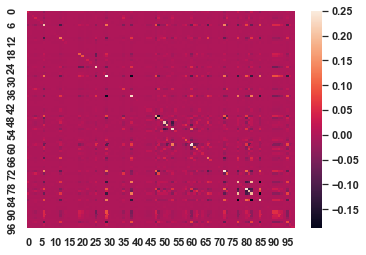

In [187]:
sns.heatmap(np.cov(scaled_df_comb_15EIS.T))

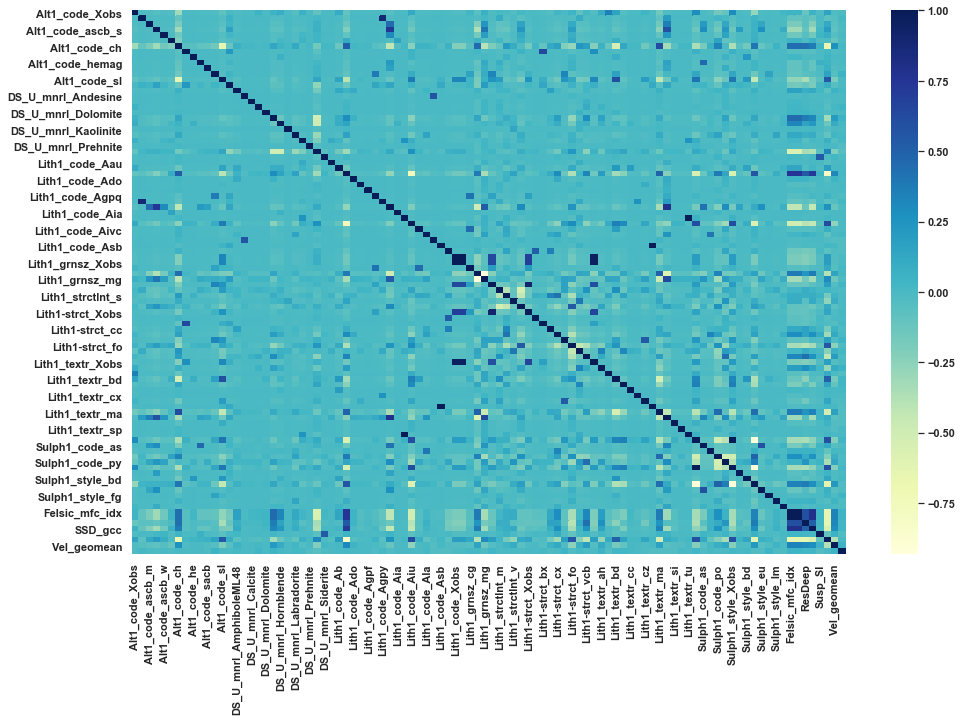

In [188]:
# Let's check the correlation coefficients to see which variables are highly correlated
plt.figure(figsize = (16, 10))
sns.heatmap(scaled_df_comb_15EIS.corr(), cmap="YlGnBu")
plt.savefig('corrplot')
plt.show()

###### Reference https://towardsai.net/p/data-science/how-when-and-why-should-you-normalize-standardize-rescale-your-data-3f083def38ff
###### Reference https://medium.com/cascade-bio-blog/creating-visualizations-to-better-understand-your-data-and-models-part-1-a51e7e5af9c0
###### https://jakevdp.github.io/PythonDataScienceHandbook/05.09-principal-component-analysis.html

In [189]:
#sc = StandardScaler()
#sc.fit(X_train)
#X_train_std = sc.transform(X_train)
#X_test_std = sc.transform(X_test)
#print('Standard deviation\n\n',scaled_df_comb.std(axis=0)) #checking for scalar (for good scalar std~1 & mean~0)
#print('Mean\n\n',scaled_df_comb.mean(axis=0)) 
#covmat_x_std = np.cov(X_std_15EIS)
#covmat_x_std

In [190]:
scaled_df_comb_15EIS.head()

,Alt1_code_Xobs,Alt1_code_ab,Alt1_code_ascb_m,Alt1_code_ascb_s,Alt1_code_ascb_w,Alt1_code_bi,Alt1_code_ch,Alt1_code_ep,Alt1_code_he,Alt1_code_hemag,Alt1_code_sacb,Alt1_code_si,Alt1_code_sl,DS_U_mnrl_Albite,DS_U_mnrl_AmphiboleML48,DS_U_mnrl_Andesine,DS_U_mnrl_Calcite,DS_U_mnrl_Chlorite,DS_U_mnrl_Dolomite,DS_U_mnrl_Edenite,DS_U_mnrl_Hornblende,DS_U_mnrl_Kaolinite,DS_U_mnrl_Labradorite,DS_U_mnrl_Oligoclase,DS_U_mnrl_Prehnite,DS_U_mnrl_Quartz,DS_U_mnrl_Siderite,Lith1_code_Aau,Lith1_code_Ab,Lith1_code_Abu,Lith1_code_Ado,Lith1_code_Agp,Lith1_code_Agpf,Lith1_code_Agpq,Lith1_code_Agpy,Lith1_code_Agt,Lith1_code_Aia,Lith1_code_Ait,Lith1_code_Aiu,Lith1_code_Aivc,Lith1_code_Ala,Lith1_code_Aou,Lith1_code_Asb,Lith1_code_Asc,Lith1_code_Xobs,Lith1_grnsz_Xobs,Lith1_grnsz_cg,Lith1_grnsz_fg,Lith1_grnsz_mg,Lith1_strctInt_Xobs,Lith1_strctInt_m,Lith1_strctInt_s,Lith1_strctInt_v,Lith1_strctInt_w,Lith1-strct_Xobs,Lith1-strct_bd,Lith1-strct_bx,Lith1-strct_cc,Lith1-strct_cx,Lith1-strct_fd,Lith1-strct_fo,Lith1-strct_sh,Lith1-strct_vcb,Lith1_textr_Xobs,Lith1_textr_ah,Lith1_textr_bb,Lith1_textr_bd,Lith1_textr_be,Lith1_textr_cc,Lith1_textr_cx,Lith1_textr_cz,Lith1_textr_fr,Lith1_textr_ma,Lith1_textr_po,Lith1_textr_si,Lith1_textr_sp,Lith1_textr_tu,Sulph1_code_Xobs,Sulph1_code_as,Sulph1_code_cp,Sulph1_code_po,Sulph1_code_py,Sulph1_style_Xobs,Sulph1_style_an,Sulph1_style_bd,Sulph1_style_ds,Sulph1_style_eu,Sulph1_style_fg,Sulph1_style_lm,Sulph1_style_su,Felsic_mfc_idx,Felsic_mfc_Rmean,ResDeep,SSD_gcc,Susp_SI,Depth_m,Vel_geomean,Vel_std
0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,1,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,1,0,0,0,1,0,0,0,0,0.510125,0.509152,0.000000,0.763027,0.004504,0.000000,0.937945,0.214843
1,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,1,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,1,0,0,0,1,0,0,0,0,0.569692,0.581917,0.000019,0.737739,0.044752,0.000382,0.937945,0.214843
2,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,1,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,1,0,0,0,1,0,0,0,0,0.629132,0.622406,0.000054,0.738673,0.012007,0.000778,0.665967,0.523274
3,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,1,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,1,0,0,0,1,0,0,0,0,0.633445,0.637410,0.010180,0.737552,0.000000,0.001220,0.665967,0.523274
4,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,1,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,1,0,0,0,1,0,0,0,0,0.686793,0.683484,0.086563,0.775085,0.069683,0.001585,0.746222,0.261088


In [191]:
# splitting dataframe every 125m depth interval (~250 rows in dataframe) for Drill Hole 15EIS (Starting depth from surface 495m and end depth 620m)
df_check_15EIS = num_df2_15EIS_fillna.iloc[:250,:]
df_check_15EIS['Depth_diff']=df_check_15EIS['Depth_m'].diff().fillna(0)
df_check_15EIS['Depth_diff'].sum()

124.43482000000006

In [774]:
from sklearn.decomposition import PCA

In [775]:
pca_15EIS = PCA(n_components=12)
#pca_15EIS = PCA(n_components=0.95)
pca_15EIS_out=pca_15EIS.fit(scaled_df_comb_15EIS)

In [776]:
pca_15EIS_new = pca_15EIS.fit_transform(scaled_df_comb_15EIS)          # X_train = pca.fit_transform(data)
print(scaled_df_comb_15EIS.shape)
print(pca_15EIS_new.shape)

(2409, 98)
(2409, 12)


### Covariance Matrix
https://analyticsindiamag.com/principal-component-analysis-on-matrix-using-python/

https://www.districtdatalabs.com/principal-component-analysis-with-python

https://www.bogotobogo.com/python/scikit-learn/scikit_machine_learning_Data_Compresssion_via_Dimensionality_Reduction_1_Principal_component_analysis%20_PCA.php

In [777]:
# Covariance Matrix
cov_mat_15EIS = np.cov(pca_15EIS_new.T)
print('Covariance Matix',cov_mat_15EIS)

Covariance Matix [[ 1.35628975e+00 -5.90151774e-17  8.85227661e-18  4.13106242e-17
  -4.13106242e-17 -2.36060710e-17 -1.77045532e-17 -1.77045532e-17
   9.95881118e-18  3.98352447e-17  1.65980186e-17 -2.36060710e-17]
 [-5.90151774e-17  6.42164048e-01 -1.60816358e-16 -2.43437607e-17
   2.17618467e-17 -2.21306915e-17 -1.47537943e-17 -1.32784149e-17
   1.36472598e-17  1.10653458e-17  1.95948831e-17  8.11458689e-18]
 [ 8.85227661e-18 -1.60816358e-16  6.02353221e-01  4.13106242e-17
  -1.34997218e-16 -1.38685667e-16  2.95075887e-17 -1.62291738e-17
   9.22112147e-19 -9.22112147e-19  3.68844859e-19 -1.77045532e-17]
 [ 4.13106242e-17 -2.43437607e-17  4.13106242e-17  3.45940904e-01
  -2.26470743e-16 -6.08594017e-17 -6.63920746e-17  1.18030355e-17
  -5.09005905e-17 -3.17206578e-17 -2.58191401e-18  2.65568298e-17]
 [-4.13106242e-17  2.17618467e-17 -1.34997218e-16 -2.26470743e-16
   3.00611421e-01  1.74094773e-16  1.47537943e-17 -1.91799327e-17
  -1.27251476e-17  2.28683812e-17 -4.76270924e-17  8.09

Text(0.5, 1.0, ' Heatmap of covariance matrix with 12 PCs (95% variance)')

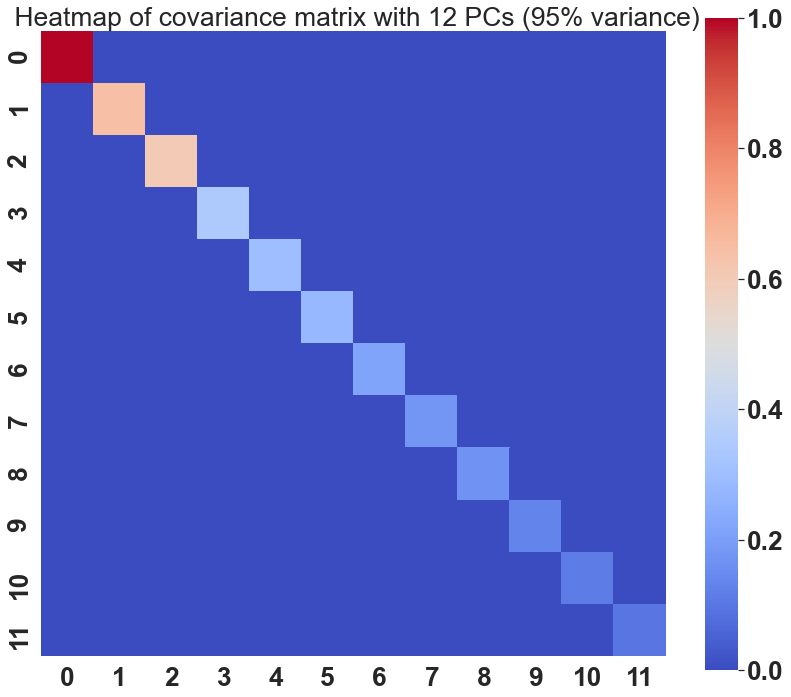

In [778]:
# Heatmap of covariance matrix
plt.figure(figsize=(14,12))
sns.heatmap(cov_mat_15EIS, vmax=1, square=True,annot=False,cmap='coolwarm')
#sns.heatmap(cov_mat_15EIS)
plt.title(' Heatmap of covariance matrix with 12 PCs (95% variance)')

In [779]:
# Eigen Decomposition on covariance matrix

eig_vals_15EIS, eig_vecs_15EIS = np.linalg.eig(cov_mat_15EIS)
print('Eigenvectors for covariance matrix\n%s' %eig_vecs_15EIS)
print('\nEigenvalues of covariance matrix \n%s' %eig_vals_15EIS)

Eigenvectors for covariance matrix
[[ 1.00000000e+00  8.26397606e-17  1.17414082e-17 -4.08874857e-17
  -3.91318291e-17 -2.19496219e-17  1.55244264e-17 -1.87247661e-17
  -1.33226447e-17  3.24907164e-17 -1.50114418e-17 -8.35879114e-18]
 [ 0.00000000e+00  1.00000000e+00 -3.71949759e-15  2.34888056e-16
  -2.79508723e-17  4.38172260e-17  1.84527242e-17  1.17922726e-16
  -8.63539152e-18 -3.69714966e-17 -3.76532013e-17 -7.24878032e-17]
 [ 0.00000000e+00 -6.21106248e-15 -1.00000000e+00 -1.83305791e-17
  -3.56176785e-16 -6.11956585e-16 -2.03787212e-16  1.80317246e-16
   1.10732197e-16  4.83795038e-18  6.12451893e-17  2.83184643e-17]
 [ 0.00000000e+00 -2.25222408e-16  2.05825688e-16  1.00000000e+00
  -4.37713911e-15 -8.09493186e-16  5.41082406e-16 -1.22693784e-16
  -8.14964354e-17 -8.16213634e-17 -1.57768536e-16  3.76273597e-16]
 [ 0.00000000e+00  2.03869762e-17  2.82091591e-16 -3.98802085e-15
  -1.00000000e+00  4.02390052e-15 -5.05887457e-17  3.72679368e-16
   4.30025202e-16 -3.06517748e-16 -4.

Big dataset would be difficult to visualise which is why we use eigendecomposition to generate the eigenvevtors
The eigenvectors with the lowest eigenvalues describe the least amount of variation within the dataset. Therefore, 
these values can be dropped. First, lets order the eigenvalues in descending order:

In [780]:
# Visually confirm that the list is correctly sorted by decreasing eigenvalues
eig_pairs_15EIS = [(np.abs(eig_vals_15EIS[i]), eig_vecs_15EIS[:,i]) for i in range(len(eig_vals_15EIS))]
print('Eigenvalues in descending order:')
for i in eig_pairs_15EIS:
    print(i[0])

Eigenvalues in descending order:
1.3562897542886874
0.6421640477884748
0.602353220804536
0.34594090419792456
0.3006114210647099
0.2808238054174517
0.21585771469638276
0.09560265996566258
0.11043962390590899
0.1302396964956602
0.17688583627402918
0.16487211843721106


In [781]:
print(scaled_df_comb_15EIS.shape)
print(scaled_df_comb_001.shape)
print(scaled_df_comb_002.shape)
print(scaled_df_comb_003.shape)
print(scaled_df_comb_004.shape)

(2409, 98)
(669, 52)
(703, 70)
(905, 69)
(1401, 102)


In [782]:
# get the component variance
# Proportion of Variance (from PC1 to PC12)
pca_15EIS_out.explained_variance_ratio_*100

array([25.30680154, 11.98204002, 11.23921593,  6.45485803,  5.60906219,
        5.23984811,  4.02765584,  3.30048556,  3.07632345,  2.43012243,
        2.06067593,  1.7838353 ])

In [783]:
# Cumulative proportion of variance (from PC1 to PC12)   
>>> np.cumsum(pca_15EIS_out.explained_variance_ratio_)

array([0.25306802, 0.37288842, 0.48528057, 0.54982916, 0.60591978,
       0.65831826, 0.69859482, 0.73159967, 0.76236291, 0.78666413,
       0.80727089, 0.82510924])

In [784]:
num_pc_15EIS = len(pca_15EIS_out.explained_variance_ratio_)
num_pc_15EIS

12

In [785]:
loadings_15EIS = pca_15EIS_out.components_
len(loadings_15EIS)

12

In [786]:
# get component loadings (correlation coefficient between original variables and the component) 
# the squared loadings within the PCs always sums to 1
loadings_15EIS = pca_15EIS_out.components_
#num_pc_15EIS = pca_15EIS_out.n_features_
num_pc_15EIS = len(pca_15EIS_out.explained_variance_ratio_)
pc_list_15EIS = ["PC"+str(i) for i in list(range(1, num_pc_15EIS+1))]
loadings_df_15EIS = pd.DataFrame.from_dict(dict(zip(pc_list_15EIS, loadings_15EIS)))
loadings_df_15EIS['variables'] = df_comb_15EIS.columns.values
loadings_df_15EIS = loadings_df_15EIS.set_index('variables')
loadings_df_15EIS.head()

,PC1,PC2,PC3,PC4,PC5,PC6,PC7,PC8,PC9,PC10,PC11,PC12
variables,,,,,,,,,,,,
Alt1_code_Xobs,0.037259,-0.021981,-0.010059,0.005681,0.078692,0.075648,-0.024914,-0.002469,-0.000840,-0.140153,-0.016859,-0.088808
Alt1_code_ab,0.001030,0.000568,0.007372,0.004914,-0.004231,-0.009121,0.005657,-0.012314,0.016696,0.014442,0.024301,-0.023893
Alt1_code_ascb_m,0.009168,0.026988,0.047803,-0.019219,-0.005318,0.009115,-0.002130,-0.008645,-0.002922,-0.012363,0.021969,-0.038533
Alt1_code_ascb_s,0.025625,0.071185,0.134229,-0.047199,-0.009208,0.024918,-0.022828,-0.033812,-0.015052,-0.029788,0.090664,-0.162173
Alt1_code_ascb_w,0.005085,0.014993,0.028269,-0.008963,-0.006464,0.005040,-0.006130,0.001582,-0.007955,0.000421,0.006115,-0.010344


In [787]:
loadings_df_15EIS = pd.DataFrame(loadings_df_15EIS)
loadings_df_15EIS_styled = loadings_df_15EIS.style.background_gradient()
loadings_df_15EIS_styled

,PC1,PC2,PC3,PC4,PC5,PC6,PC7,PC8,PC9,PC10,PC11,PC12
variables,,,,,,,,,,,,
Alt1_code_Xobs,0.037259,-0.021981,-0.010059,0.005681,0.078692,0.075648,-0.024914,-0.002469,-0.000840,-0.140153,-0.016859,-0.088808
Alt1_code_ab,0.001030,0.000568,0.007372,0.004914,-0.004231,-0.009121,0.005657,-0.012314,0.016696,0.014442,0.024301,-0.023893
Alt1_code_ascb_m,0.009168,0.026988,0.047803,-0.019219,-0.005318,0.009115,-0.002130,-0.008645,-0.002922,-0.012363,0.021969,-0.038533
Alt1_code_ascb_s,0.025625,0.071185,0.134229,-0.047199,-0.009208,0.024918,-0.022828,-0.033812,-0.015052,-0.029788,0.090664,-0.162173
Alt1_code_ascb_w,0.005085,0.014993,0.028269,-0.008963,-0.006464,0.005040,-0.006130,0.001582,-0.007955,0.000421,0.006115,-0.010344
Alt1_code_bi,-0.004489,0.023122,-0.003943,0.030984,0.024576,-0.004854,0.035751,0.008417,0.018693,-0.031671,-0.028744,-0.041917
Alt1_code_ch,-0.273664,-0.076192,-0.200178,-0.173621,-0.211368,-0.026774,-0.277999,-0.185585,0.135216,0.040333,-0.083595,0.258647
Alt1_code_ep,0.001716,-0.000699,-0.001116,-0.001792,0.001541,0.006494,0.000696,-0.001876,-0.002806,0.005391,0.007949,-0.005073
Alt1_code_he,0.000827,-0.000439,0.001047,0.000278,0.001250,-0.000133,-0.002339,0.010522,0.001723,0.004418,-0.004833,-0.002885


In [788]:
dfi.export(loadings_df_15EIS_styled,'loadings_df_15EIS_styled.png')

In [789]:
t1_sort=loadings_df_15EIS.sort_values(by=["PC1"],ascending=False)
t2_sort=loadings_df_15EIS.sort_values(by=["PC2"],ascending=False)
#t1_sort.head()

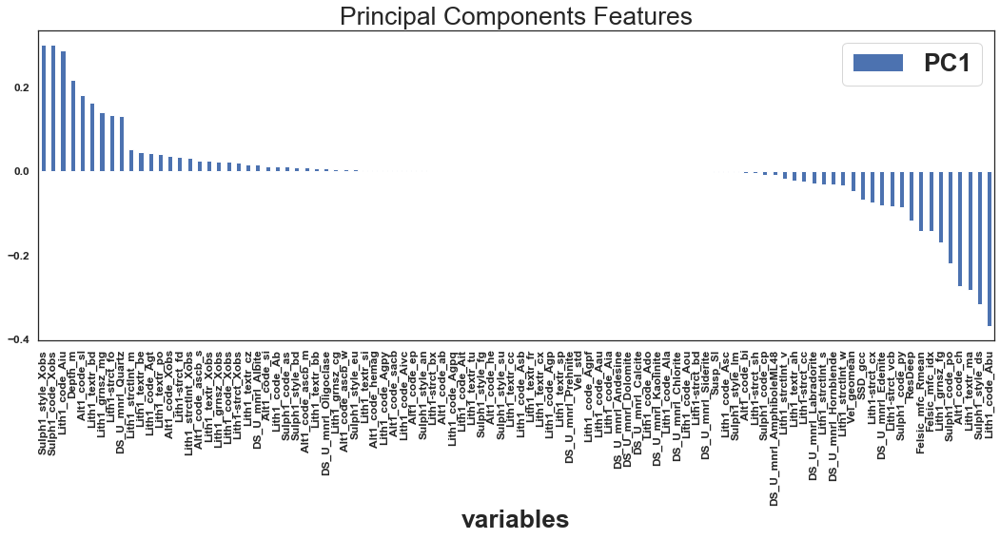

In [790]:
#plt.subplot(2,1,1)
t1_sort[['PC1']].plot(kind='bar', title ="Principal Components Features",figsize=(18,6),legend=True, fontsize=12)
#plt.subplot(2,1,2)
#t1_sort[['PC1']].plot(kind='bar', title ="Principal Components Features",figsize=(18,6),legend=True, fontsize=12)
#ax.set_xlabel("features",fontsize=12)
#ax.set_ylabel("Values",fontsize=12)
plt.show()

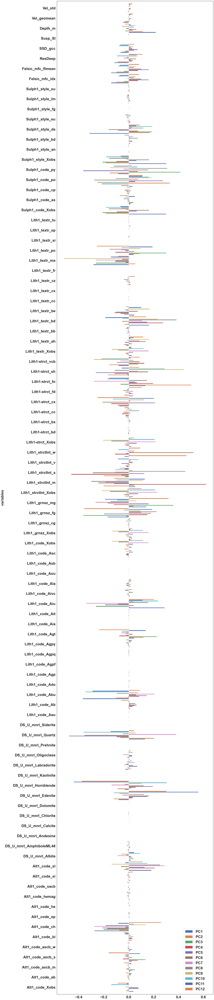

In [791]:
#plt.figure(figsize=(14,12))
loadings_df_15EIS.plot.barh(figsize=(20,130),width=0.9)
plt.legend(loc="lower left",bbox_to_anchor=(0.8,0))

In [792]:
# positive and negative values in component loadings reflects the positive and negative 
# correlation of the variables with the PCs. 

### Principal component (PC) retention
As the number of PCs is equal to the number of original variables, We should keep only the PCs which explain the most variance (70-95%) to make the interpretation easier. More the PCs you include that explains most variation in the original data, better will be the PCA model. This is highly subjective and based on the user interpretation (Cangelosi et al., 2007).
The eigenvalues for PCs can help to retain the number of PCs. Generally, PCs with eigenvalues > 1 contributes greater variance and should be retained for further analysis.
Scree plot (for elbow test) is another graphical technique useful in PCs retention. We should keep the PCs where there is a sharp change in the slope of the line connecting adjacent PCs.

In [793]:
# get eigenvalues (from PC1 to PC12)  
pca_15EIS_out.explained_variance_

array([1.35628975, 0.64216405, 0.60235322, 0.3459409 , 0.30061142,
       0.28082381, 0.21585771, 0.17688584, 0.16487212, 0.1302397 ,
       0.11043962, 0.09560266])

In [794]:
print(pc_list_15EIS)

['PC1', 'PC2', 'PC3', 'PC4', 'PC5', 'PC6', 'PC7', 'PC8', 'PC9', 'PC10', 'PC11', 'PC12']


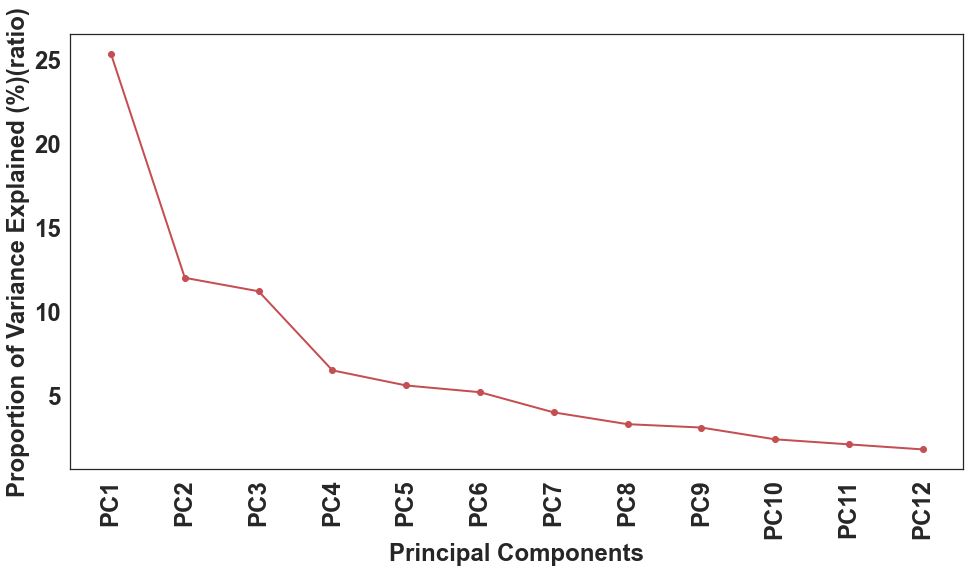

In [795]:
# get scree plot (for scree or elbow test)
#Scree plot will be saved in the same directory with name screeplot.png
plt.figure(figsize=(16,8))
plt.plot(pc_list_15EIS, np.round(pca_15EIS_out.explained_variance_ratio_*100, decimals=1), 'ro-', linewidth=2)
plt.xticks(fontsize=24, rotation=90)
plt.yticks(fontsize=24)
#plt.title('Elbow Plot' , fontsize=18)
plt.xlabel('Principal Components' , fontsize=24)
plt.ylabel('Proportion of Variance Explained (%)(ratio)' , fontsize=24)
plt.show()
#plt.xticks(fontsize=4, rotation=90)

In [796]:
# feature selection techniques
# https://www.tutorialspoint.com/machine_learning_with_python/machine_learning_with_python_data_feature_selection.htm
#!pip install pca

In [797]:
# https://pypi.org/project/pca/
from pca import pca
# Initialize to reduce the data up to the number of componentes that explains 95% of the variance.
#model = pca(n_components=0.80)

model_15EIS = pca(n_components=12)

[pca] >Cleaning previous fitted model results..
[pca] >Processing dataframe..
[pca] >The PCA reduction is performed on the [98] columns of the input dataframe.
[pca] >Fitting using PCA..
[pca] >Computing loadings and PCs..
[pca] >Computing explained variance..
[pca] >Outlier detection using Hotelling T2 test with alpha=[0.05] and n_components=[5]
[pca] >Outlier detection using SPE/DmodX with n_std=[2]


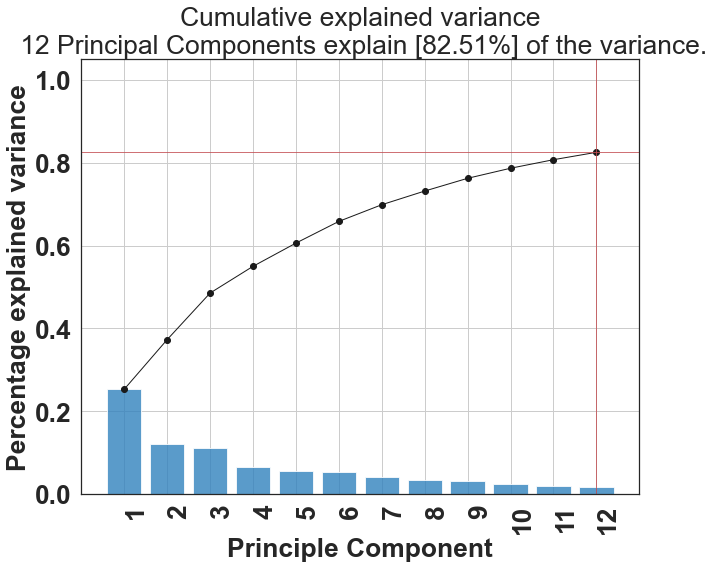

<Figure size 1080x360 with 0 Axes>

In [769]:
import matplotlib.pylab as pylab
# Fit transform
results = model_15EIS.fit_transform(scaled_df_comb_15EIS)

params = {'legend.fontsize': 'large',
          'figure.figsize': (15, 5),
         'axes.labelsize': 'large',
         'axes.titlesize':'large',
         'xtick.labelsize':'large',
         'ytick.labelsize':'large'}
pylab.rcParams.update(params)
# Plot explained variance
#plt.rcParams["figure.figsize"]=(25,25)
#plt.rcParams['font.size'] = 22.0
fig, ax = model_15EIS.plot()
plt.show()

(array([-2. , -1.5, -1. , -0.5,  0. ,  0.5,  1. ,  1.5,  2. ]),
 [Text(0, 0, ''),
  Text(0, 0, ''),
  Text(0, 0, ''),
  Text(0, 0, ''),
  Text(0, 0, ''),
  Text(0, 0, ''),
  Text(0, 0, ''),
  Text(0, 0, ''),
  Text(0, 0, '')])

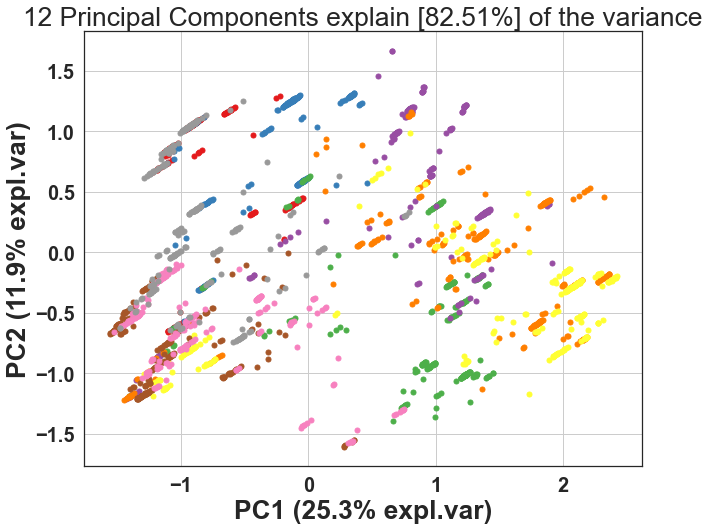

In [767]:
# https://www.youtube.com/watch?v=FgakZw6K1QQ
# Plot explained variance
import matplotlib.pylab as pylab
params = {'legend.fontsize': 'large',
          'figure.figsize': (15, 5),
         'axes.labelsize': 'large',
         'axes.titlesize':'large',
         'xtick.labelsize':'large',
         'ytick.labelsize':'large'}
pylab.rcParams.update(params)
fig, ax = model_15EIS.scatter(legend=False,label=False)
plt.xticks(fontsize=20)
plt.yticks(fontsize=20)

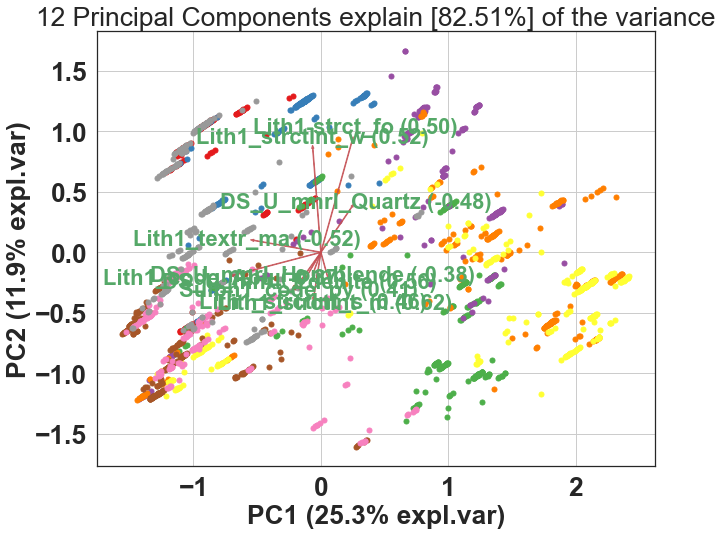

In [770]:
# Make biplot with the number of features
fig, ax = model_15EIS.biplot(n_feat=10,legend=False, label=False)
#plt.xticks(fontsize=24)
#plt.yticks(fontsize=24)

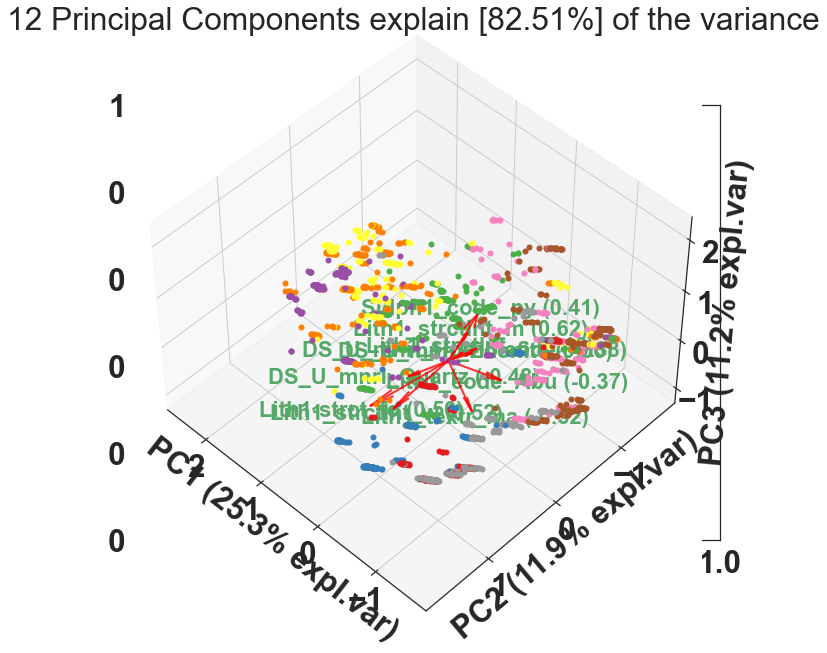

In [219]:
# Make 3D plot
ax = model_15EIS.biplot3d(n_feat=10, legend=False)

In [798]:
# to get how much variance was retained
print(np.round(pca_15EIS_out.explained_variance_ratio_.sum()*100, decimals=2),"%")

82.51 %


In [799]:
# get PCA loadings plots (2D and 3D)
# 2D
#cluster.pcaplot(x=loadings_15EIS[0], y=loadings_15EIS[1], labels=loadings_df_15EIS.T.columns.values, 
#var1=round(pca_15EIS_out.explained_variance_ratio_[0]*100, 2),
#var2=round(pca_15EIS_out.explained_variance_ratio_[1]*100, 2))

In [800]:
X1_pc = scaled_df_comb_15EIS.copy()
colnames = list(X1_pc.columns)
print(colnames)

['Alt1_code_Xobs', 'Alt1_code_ab', 'Alt1_code_ascb_m', 'Alt1_code_ascb_s', 'Alt1_code_ascb_w', 'Alt1_code_bi', 'Alt1_code_ch', 'Alt1_code_ep', 'Alt1_code_he', 'Alt1_code_hemag', 'Alt1_code_sacb', 'Alt1_code_si', 'Alt1_code_sl', 'DS_U_mnrl_Albite', 'DS_U_mnrl_AmphiboleML48', 'DS_U_mnrl_Andesine', 'DS_U_mnrl_Calcite', 'DS_U_mnrl_Chlorite', 'DS_U_mnrl_Dolomite', 'DS_U_mnrl_Edenite', 'DS_U_mnrl_Hornblende', 'DS_U_mnrl_Kaolinite', 'DS_U_mnrl_Labradorite', 'DS_U_mnrl_Oligoclase', 'DS_U_mnrl_Prehnite', 'DS_U_mnrl_Quartz', 'DS_U_mnrl_Siderite', 'Lith1_code_Aau', 'Lith1_code_Ab', 'Lith1_code_Abu', 'Lith1_code_Ado', 'Lith1_code_Agp', 'Lith1_code_Agpf', 'Lith1_code_Agpq', 'Lith1_code_Agpy', 'Lith1_code_Agt', 'Lith1_code_Aia', 'Lith1_code_Ait', 'Lith1_code_Aiu', 'Lith1_code_Aivc', 'Lith1_code_Ala', 'Lith1_code_Aou', 'Lith1_code_Asb', 'Lith1_code_Asc', 'Lith1_code_Xobs', 'Lith1_grnsz_Xobs', 'Lith1_grnsz_cg', 'Lith1_grnsz_fg', 'Lith1_grnsz_mg', 'Lith1_strctInt_Xobs', 'Lith1_strctInt_m', 'Lith1_strct

In [801]:
pcs_df_15EIS = pd.DataFrame({'PC1':pca_15EIS_out.components_[0],'PC2':pca_15EIS_out.components_[1], 
                             'PC3':pca_15EIS_out.components_[2],'PC4':pca_15EIS_out.components_[3],
                             'PC5':pca_15EIS_out.components_[4],'PC6':pca_15EIS_out.components_[5],
                             'PC7':pca_15EIS_out.components_[6],'PC8':pca_15EIS_out.components_[7],
                             'PC9':pca_15EIS_out.components_[8],'PC10':pca_15EIS_out.components_[9],
                             'PC11':pca_15EIS_out.components_[10],'PC12':pca_15EIS_out.components_[11],
                             'feature':colnames})
pcs_df_15EIS.head()

,PC1,PC2,PC3,PC4,PC5,PC6,PC7,PC8,PC9,PC10,PC11,PC12,feature
0,0.037259,-0.021981,-0.010059,0.005681,0.078692,0.075648,-0.024914,-0.002469,-0.000840,-0.140153,-0.016859,-0.088808,Alt1_code_Xobs
1,0.001030,0.000568,0.007372,0.004914,-0.004231,-0.009121,0.005657,-0.012314,0.016696,0.014442,0.024301,-0.023893,Alt1_code_ab
2,0.009168,0.026988,0.047803,-0.019219,-0.005318,0.009115,-0.002130,-0.008645,-0.002922,-0.012363,0.021969,-0.038533,Alt1_code_ascb_m
3,0.025625,0.071185,0.134229,-0.047199,-0.009208,0.024918,-0.022828,-0.033812,-0.015052,-0.029788,0.090664,-0.162173,Alt1_code_ascb_s
4,0.005085,0.014993,0.028269,-0.008963,-0.006464,0.005040,-0.006130,0.001582,-0.007955,0.000421,0.006115,-0.010344,Alt1_code_ascb_w


In [224]:
#loadings_df_15EIS.head()

In [225]:
#test_df1.variables

In [226]:
#sns.pairplot(pcs_df_15EIS, hue = 'feature')

# Writing Principal compenents as columns
df_components_15EIS = loadings_df_15EIS.copy()
pcs_comp_15EIS=df_components_15EIS.reset_index()
pcs_comp_15EIS

In [227]:
#pcs_df_15EIS.feature

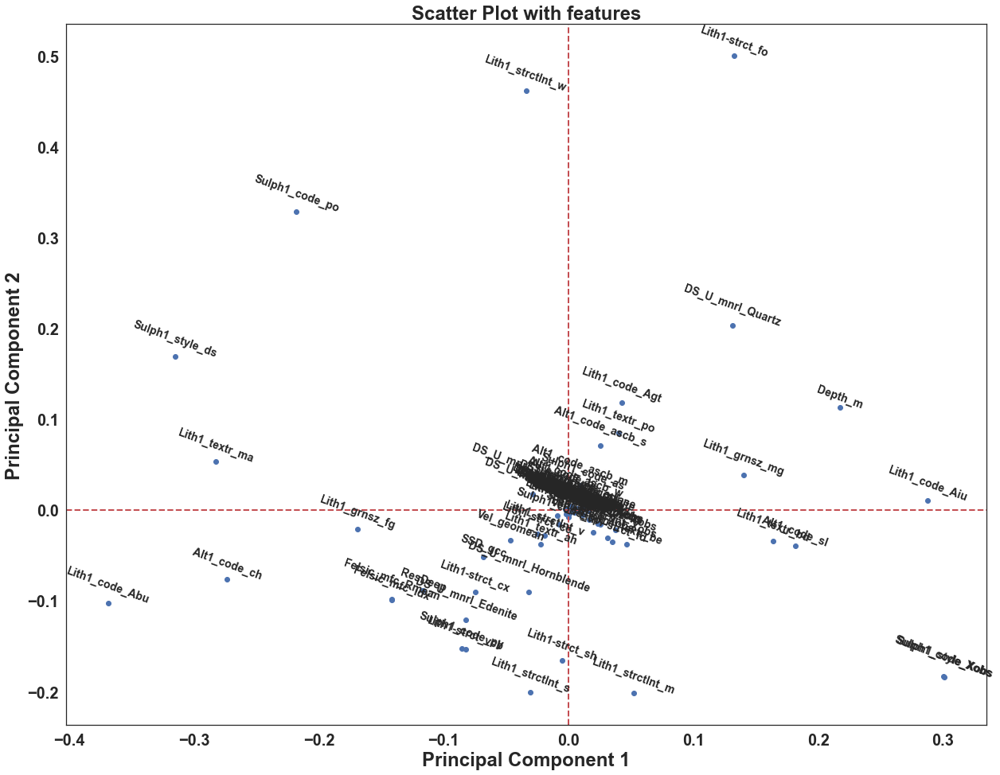

In [228]:
# https://www.kaggle.com/ashydv/country-clustering-hierarchical-clustering-pca

fig = plt.figure(figsize = (18,14))
plt.scatter(pcs_df_15EIS.PC1, pcs_df_15EIS.PC2)
plt.xlabel('Principal Component 1', fontsize=24)
plt.ylabel('Principal Component 2', fontsize=24)
plt.xticks(fontsize=20)
plt.yticks(fontsize=20)
plt.title('Scatter Plot with features', fontsize=24, weight='bold')
plt.axvline(x=0, linestyle='--', linewidth=2, color='r')
plt.axhline(y=0, linestyle='--', linewidth=2, color='r')
for i, txt in enumerate(pcs_df_15EIS.feature):
    plt.annotate(txt, (pcs_df_15EIS.PC1[i],pcs_df_15EIS.PC2[i]),ha='center', rotation=-20,fontsize=14,weight='bold')
plt.tight_layout()
plt.show()

In [229]:
#test_df1.variables

In [230]:
pca_15EIS_out.explained_variance_ratio_ *100

array([25.30680154, 11.98204002, 11.23921593,  6.45485803,  5.60906219,
        5.23984812,  4.02765586,  3.30048575,  3.07632342,  2.43012294,
        2.06068003,  1.78386465])

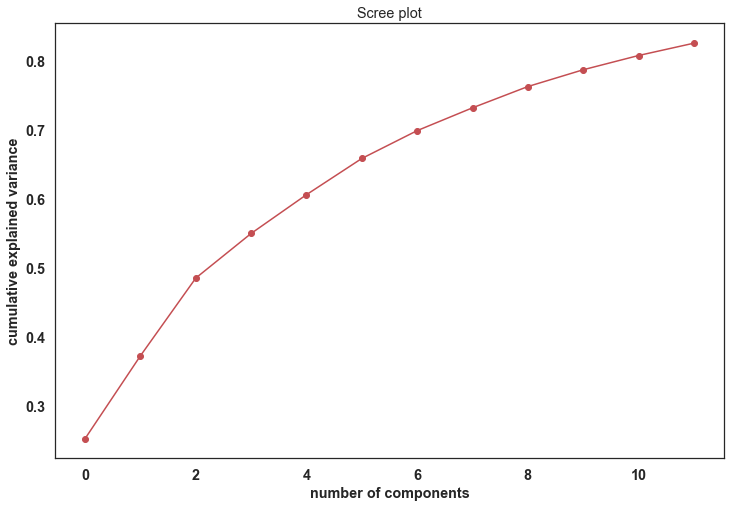

In [231]:
#Making the screeplot - plotting the cumulative variance against the number of components
%matplotlib inline
fig = plt.figure(figsize = (12,8))
plt.plot(np.cumsum(pca_15EIS_out.explained_variance_ratio_),'ro-')
plt.xlabel('number of components')
plt.ylabel('cumulative explained variance')
plt.title('Scree plot')
plt.show()

In [802]:
#Using incremental PCA for efficiency - saves a lot of time on larger datasets
from sklearn.decomposition import IncrementalPCA
INCpca_final_15EIS = IncrementalPCA(n_components=12)

In [803]:
df_INCpca_final_15EIS = INCpca_final_15EIS.fit_transform(X1_pc)
df_INCpca_final_15EIS.shape

(2409, 12)

In [804]:
df_INCpca_final_15EIS = pd.DataFrame(df_INCpca_final_15EIS)
df_INCpca_final_15EIS.columns = ["PC1","PC2","PC3","PC4","PC5","PC6","PC7","PC8","PC9","PC10","PC11","PC12"]
df_INCpca_final_15EIS.head()

,PC1,PC2,PC3,PC4,PC5,PC6,PC7,PC8,PC9,PC10,PC11,PC12
0,0.942148,-0.592993,0.250984,-0.204158,1.093843,0.197721,0.431629,0.090671,0.010606,0.419415,-0.311893,-0.167637
1,0.959286,-0.604398,0.246194,-0.196424,1.073626,0.208887,0.431455,0.092004,0.016758,0.410827,-0.318879,-0.156822
2,0.960621,-0.607510,0.238924,-0.190672,1.055452,0.217898,0.433137,0.094410,0.023194,0.401631,-0.326535,-0.142910
3,0.964380,-0.610126,0.238372,-0.189055,1.052069,0.220148,0.433018,0.095087,0.024632,0.398903,-0.327340,-0.139950
4,0.993971,-0.628853,0.236518,-0.178297,1.033499,0.231087,0.433101,0.097885,0.031664,0.379661,-0.336044,-0.126733


In [805]:
#creating correlation matrix for the principal components
corrmat_15EIS = np.corrcoef(df_INCpca_final_15EIS.transpose())

In [807]:
# Covariance Matrix
covmat_15EIS = np.cov(df_INCpca_final_15EIS.transpose())

<AxesSubplot:>

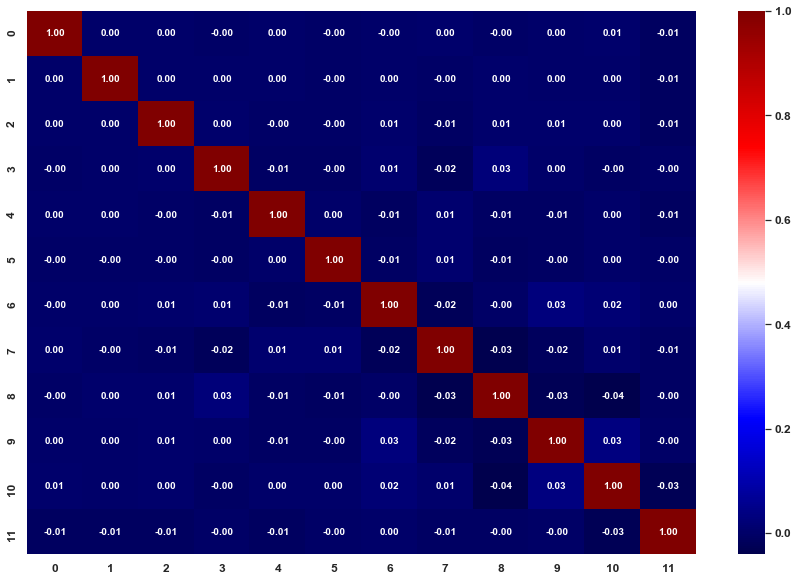

In [806]:
#plotting the correlation matrix
%matplotlib inline
plt.figure(figsize = (15,10))
sns.heatmap(corrmat_15EIS,annot = True,cmap='seismic',fmt=".2f")

<AxesSubplot:>

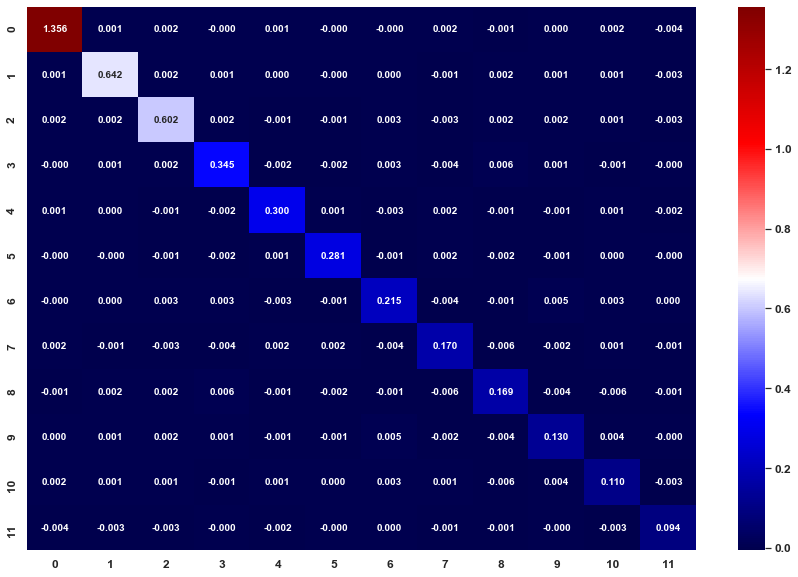

In [810]:
#plotting the covariance matrix
#%matplotlib inline
plt.figure(figsize = (15,10))
sns.heatmap(covmat_15EIS,annot = True,cmap='seismic',fmt=".3f")

In [237]:
# https://online.stat.psu.edu/stat505/book/export/html/670 
loadings_df_15EIS.head()

,PC1,PC2,PC3,PC4,PC5,PC6,PC7,PC8,PC9,PC10,PC11,PC12
variables,,,,,,,,,,,,
Alt1_code_Xobs,0.037259,-0.021981,-0.010059,0.005684,0.078691,0.075651,-0.024927,-0.002453,-0.000830,-0.140268,-0.017216,-0.089469
Alt1_code_ab,0.001030,0.000568,0.007372,0.004914,-0.004232,-0.009121,0.005655,-0.012317,0.016691,0.014442,0.024248,-0.023809
Alt1_code_ascb_m,0.009168,0.026988,0.047803,-0.019218,-0.005320,0.009110,-0.002145,-0.008674,-0.002930,-0.012317,0.021880,-0.038247
Alt1_code_ascb_s,0.025625,0.071185,0.134229,-0.047201,-0.009204,0.024925,-0.022800,-0.033767,-0.015027,-0.029828,0.090861,-0.162634
Alt1_code_ascb_w,0.005085,0.014993,0.028269,-0.008963,-0.006465,0.005039,-0.006136,0.001572,-0.007962,0.000427,0.006058,-0.010387


In [238]:
updated_loadings_df_15EIS = loadings_df_15EIS.drop(["Vel_geomean","Vel_std","Susp_SI","Sulph1_style_su","Sulph1_style_lm","Sulph1_style_bd",
                                                          "Sulph1_style_fg","Sulph1_style_eu","Sulph1_style_an","Sulph1_code_cp","Sulph1_code_as","Lith1_textr_tu",
                                                          "Lith1_textr_sp","Lith1_textr_si","Lith1_textr_fr","Lith1_textr_cz","Lith1_code_Asc",
                                                          "Lith1_textr_cx","Lith1_textr_cc","Lith1_textr_bb","Lith1-strct_bx",
                                                          "Lith1-strct_bd","Lith1_grnsz_cg","Lith1_code_Asb","Lith1_code_Aou","Lith1_code_Ala",
                                                          "Lith1_code_Aivc","Lith1_code_Ait","Lith1_code_Aia","Lith1_code_Agpy",
                                                          "Lith1_code_Agpq","Lith1_code_Agpf","Lith1_code_Agp","Lith1_code_Ado",
                                                          "Lith1_code_Aau","DS_U_mnrl_Siderite","DS_U_mnrl_Prehnite","DS_U_mnrl_Oligoclase",
                                                          "DS_U_mnrl_Labradorite","DS_U_mnrl_Kaolinite","DS_U_mnrl_Dolomite","DS_U_mnrl_Chlorite",
                                                          "DS_U_mnrl_Calcite","DS_U_mnrl_Andesine","DS_U_mnrl_AmphiboleML48","Alt1_code_si",
                                                          "Alt1_code_sacb","Alt1_code_hemag","Alt1_code_he","Alt1_code_ep","Alt1_code_ascb_m",
                                                          "Alt1_code_bi","Alt1_code_ascb_w","Alt1_code_ab"])

In [239]:
updated_loadings_df_15EIS.T.columns

Index(['Alt1_code_Xobs', 'Alt1_code_ascb_s', 'Alt1_code_ch', 'Alt1_code_sl',
       'DS_U_mnrl_Albite', 'DS_U_mnrl_Edenite', 'DS_U_mnrl_Hornblende',
       'DS_U_mnrl_Quartz', 'Lith1_code_Ab', 'Lith1_code_Abu', 'Lith1_code_Agt',
       'Lith1_code_Aiu', 'Lith1_code_Xobs', 'Lith1_grnsz_Xobs',
       'Lith1_grnsz_fg', 'Lith1_grnsz_mg', 'Lith1_strctInt_Xobs',
       'Lith1_strctInt_m', 'Lith1_strctInt_s', 'Lith1_strctInt_v',
       'Lith1_strctInt_w', 'Lith1-strct_Xobs', 'Lith1-strct_cc',
       'Lith1-strct_cx', 'Lith1-strct_fd', 'Lith1-strct_fo', 'Lith1-strct_sh',
       'Lith1-strct_vcb', 'Lith1_textr_Xobs', 'Lith1_textr_ah',
       'Lith1_textr_bd', 'Lith1_textr_be', 'Lith1_textr_ma', 'Lith1_textr_po',
       'Sulph1_code_Xobs', 'Sulph1_code_po', 'Sulph1_code_py',
       'Sulph1_style_Xobs', 'Sulph1_style_ds', 'Felsic_mfc_idx',
       'Felsic_mfc_Rmean', 'ResDeep', 'SSD_gcc', 'Depth_m'],
      dtype='object', name='variables')

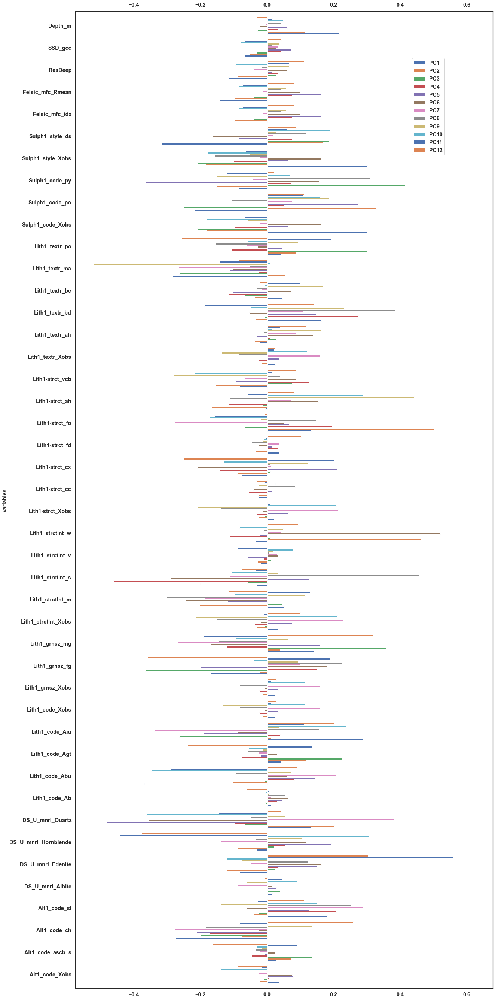

In [240]:
updated_loadings_df_15EIS.plot.barh(figsize=(20,48),width=0.8)
plt.tick_params(axis='x', which='both', labeltop='on', labelbottom='on',)
plt.legend(loc="lower left",bbox_to_anchor=(0.8,0.85))
plt.savefig('updated_loading_df_15EIS.png', bbox_inches='tight')

In [241]:
tt1_sort=updated_loadings_df_15EIS.sort_values(by=["PC1"],ascending=False)
tt2_sort=updated_loadings_df_15EIS.sort_values(by=["PC2"],ascending=False)
tt3_sort=updated_loadings_df_15EIS.sort_values(by=["PC3"],ascending=False)
tt4_sort=updated_loadings_df_15EIS.sort_values(by=["PC4"],ascending=False)
tt5_sort=updated_loadings_df_15EIS.sort_values(by=["PC5"],ascending=False)
tt6_sort=updated_loadings_df_15EIS.sort_values(by=["PC6"],ascending=False)
tt7_sort=updated_loadings_df_15EIS.sort_values(by=["PC7"],ascending=False)
tt8_sort=updated_loadings_df_15EIS.sort_values(by=["PC8"],ascending=False)
tt9_sort=updated_loadings_df_15EIS.sort_values(by=["PC9"],ascending=False)
tt10_sort=updated_loadings_df_15EIS.sort_values(by=["PC10"],ascending=False)
tt11_sort=updated_loadings_df_15EIS.sort_values(by=["PC11"],ascending=False)
tt12_sort=updated_loadings_df_15EIS.sort_values(by=["PC12"],ascending=False)

<function matplotlib.pyplot.show(close=None, block=None)>

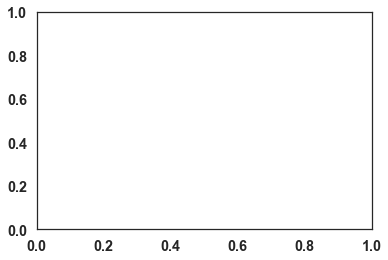

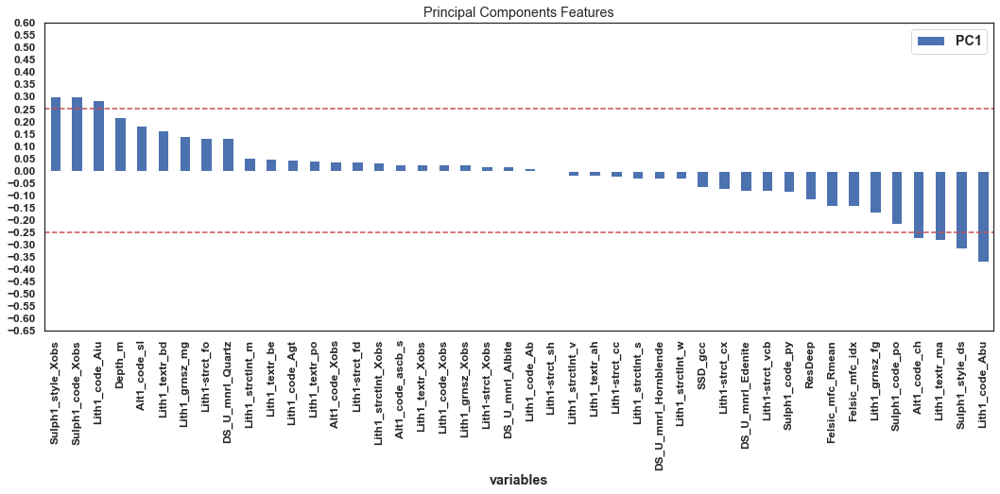

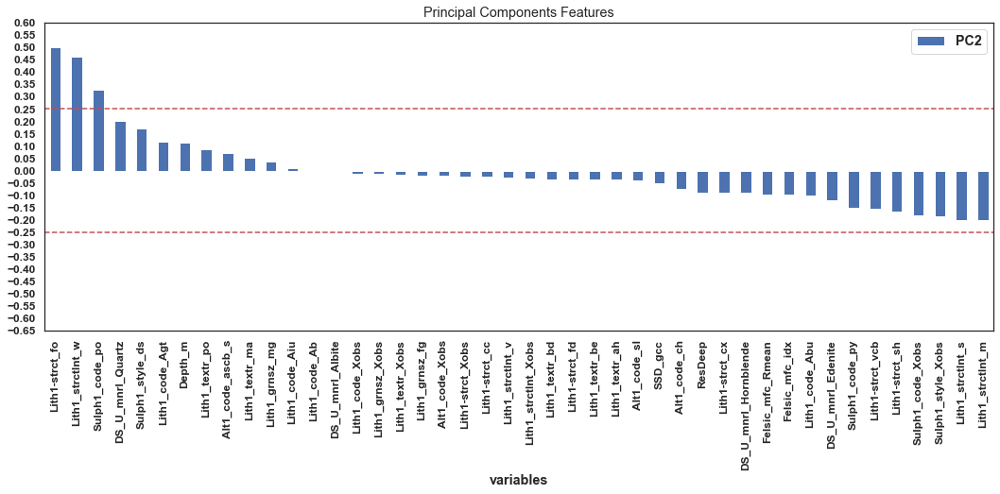

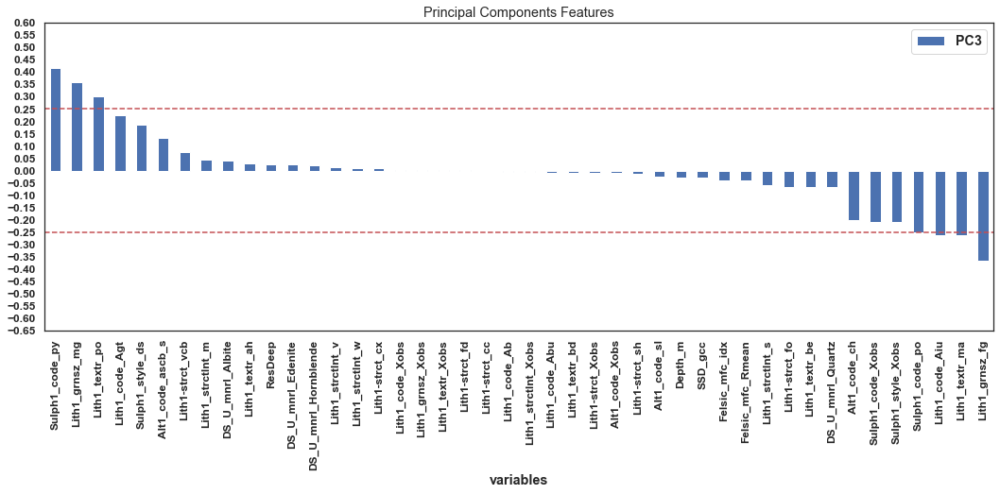

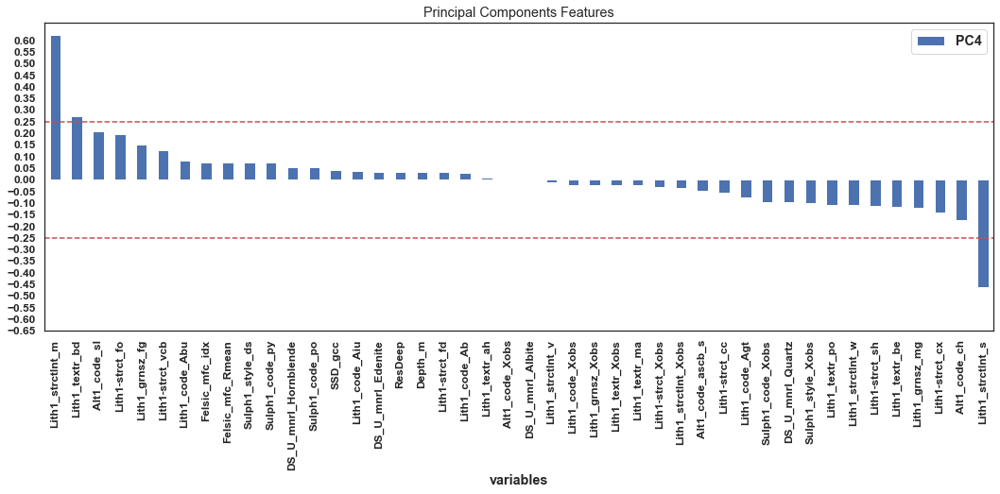

...

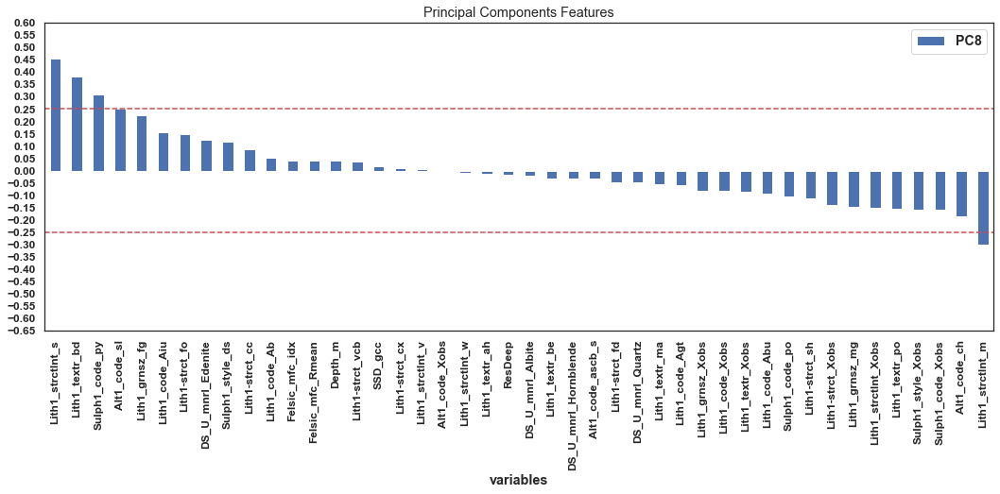

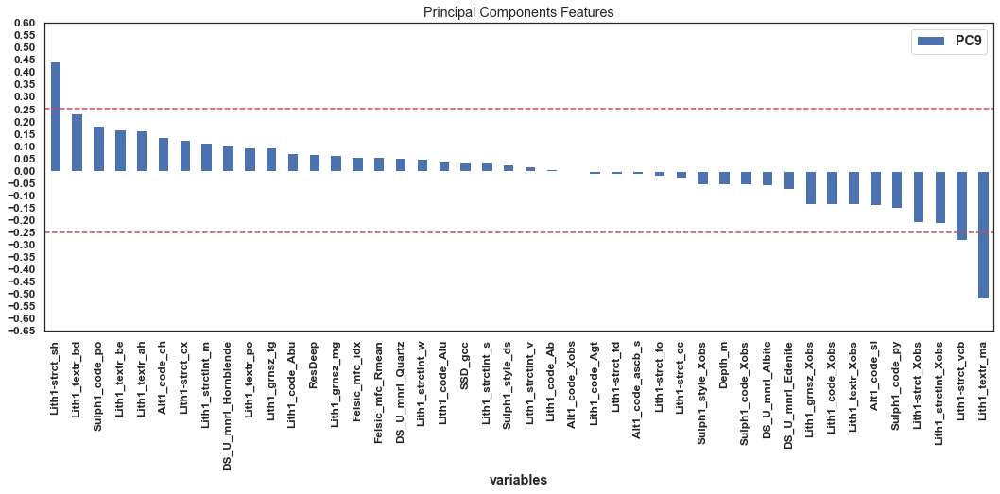

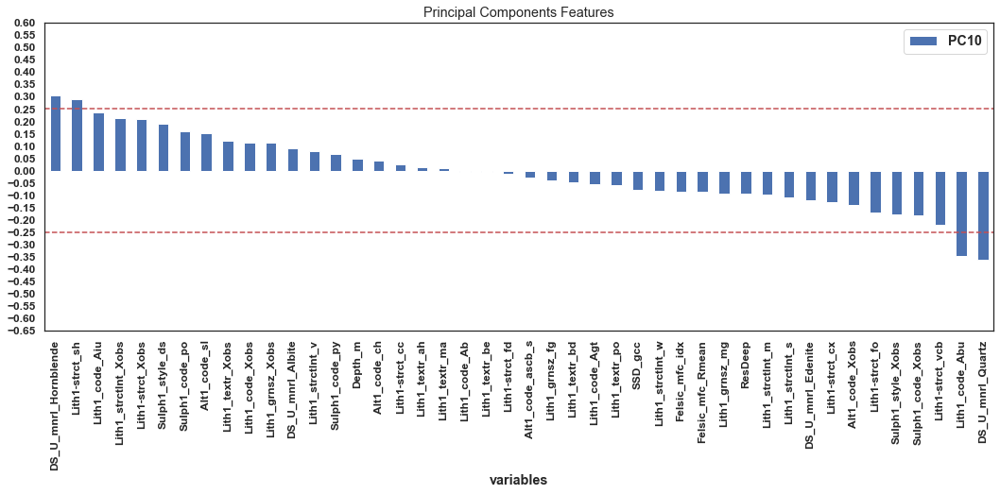

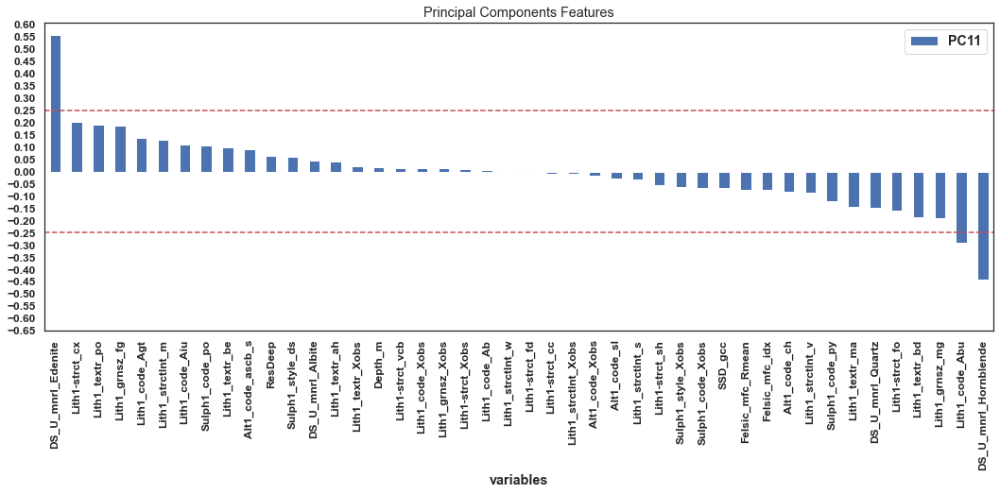

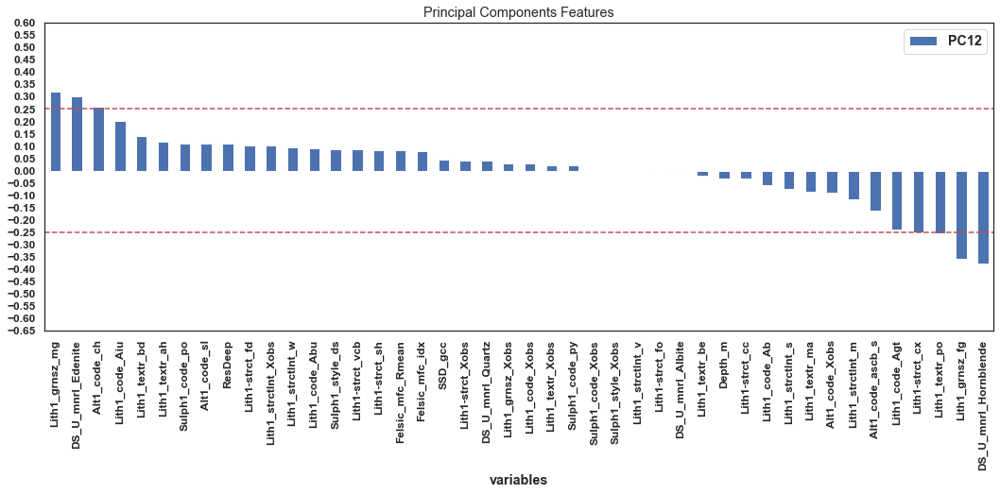

In [242]:
plt.subplot()
plt.rc('grid', linestyle="-", color='black')
plt.rcParams['axes.grid'] = False
tt1_sort[['PC1']].plot(kind='bar', title ="Principal Components Features",figsize=(18,6),legend=True, fontsize=12)
plt.yticks(np.arange(-.65, .65, 0.05))
plt.axhline(y=0.25, c='r', ls='dashed')
plt.axhline(y=-0.25, c='r', ls='dashed')
#plt.subplot()
tt2_sort[['PC2']].plot(kind='bar', title ="Principal Components Features",figsize=(18,6),legend=True, fontsize=12)
plt.yticks(np.arange(-.65, .65, 0.05))
plt.axhline(y=0.25, c='r', ls='dashed')
plt.axhline(y=-0.25, c='r', ls='dashed')
tt3_sort[['PC3']].plot(kind='bar', title ="Principal Components Features",figsize=(18,6),legend=True, fontsize=12)
plt.yticks(np.arange(-.65, .65, 0.05))
plt.axhline(y=0.25, c='r', ls='dashed')
plt.axhline(y=-0.25, c='r', ls='dashed')
tt4_sort[['PC4']].plot(kind='bar', title ="Principal Components Features",figsize=(18,6),legend=True, fontsize=12)
plt.yticks(np.arange(-.65, .65, 0.05))
plt.axhline(y=0.25, c='r', ls='dashed')
plt.axhline(y=-0.25, c='r', ls='dashed')
tt5_sort[['PC5']].plot(kind='bar', title ="Principal Components Features",figsize=(18,6),legend=True, fontsize=12)
plt.yticks(np.arange(-.65, .65, 0.05))
plt.axhline(y=0.25, c='r', ls='dashed')
plt.axhline(y=-0.25, c='r', ls='dashed')
tt6_sort[['PC6']].plot(kind='bar', title ="Principal Components Features",figsize=(18,6),legend=True, fontsize=12)
plt.yticks(np.arange(-.65, .65, 0.05))
plt.axhline(y=0.25, c='r', ls='dashed')
plt.axhline(y=-0.25, c='r', ls='dashed')
tt7_sort[['PC7']].plot(kind='bar', title ="Principal Components Features",figsize=(18,6),legend=True, fontsize=12)
plt.yticks(np.arange(-.65, .65, 0.05))
plt.axhline(y=0.25, c='r', ls='dashed')
plt.axhline(y=-0.25, c='r', ls='dashed')
tt8_sort[['PC8']].plot(kind='bar', title ="Principal Components Features",figsize=(18,6),legend=True, fontsize=12)
plt.yticks(np.arange(-.65, .65, 0.05))
plt.axhline(y=0.25, c='r', ls='dashed')
plt.axhline(y=-0.25, c='r', ls='dashed')
tt9_sort[['PC9']].plot(kind='bar', title ="Principal Components Features",figsize=(18,6),legend=True, fontsize=12)
plt.yticks(np.arange(-.65, .65, 0.05))
plt.axhline(y=0.25, c='r', ls='dashed')
plt.axhline(y=-0.25, c='r', ls='dashed')
tt10_sort[['PC10']].plot(kind='bar', title ="Principal Components Features",figsize=(18,6),legend=True, fontsize=12)
plt.yticks(np.arange(-.65, .65, 0.05))
plt.axhline(y=0.25, c='r', ls='dashed')
plt.axhline(y=-0.25, c='r', ls='dashed')
tt11_sort[['PC11']].plot(kind='bar', title ="Principal Components Features",figsize=(18,6),legend=True, fontsize=12)
plt.yticks(np.arange(-.65, .65, 0.05))
plt.axhline(y=0.25, c='r', ls='dashed')
plt.axhline(y=-0.25, c='r', ls='dashed')
tt12_sort[['PC12']].plot(kind='bar', title ="Principal Components Features",figsize=(18,6),legend=True, fontsize=12)
plt.yticks(np.arange(-.65, .65, 0.05))
plt.axhline(y=0.25, c='r', ls='dashed')
plt.axhline(y=-0.25, c='r', ls='dashed')
plt.show

In [243]:
test_df= updated_loadings_df_15EIS.copy()
test_df1 = test_df.reset_index()

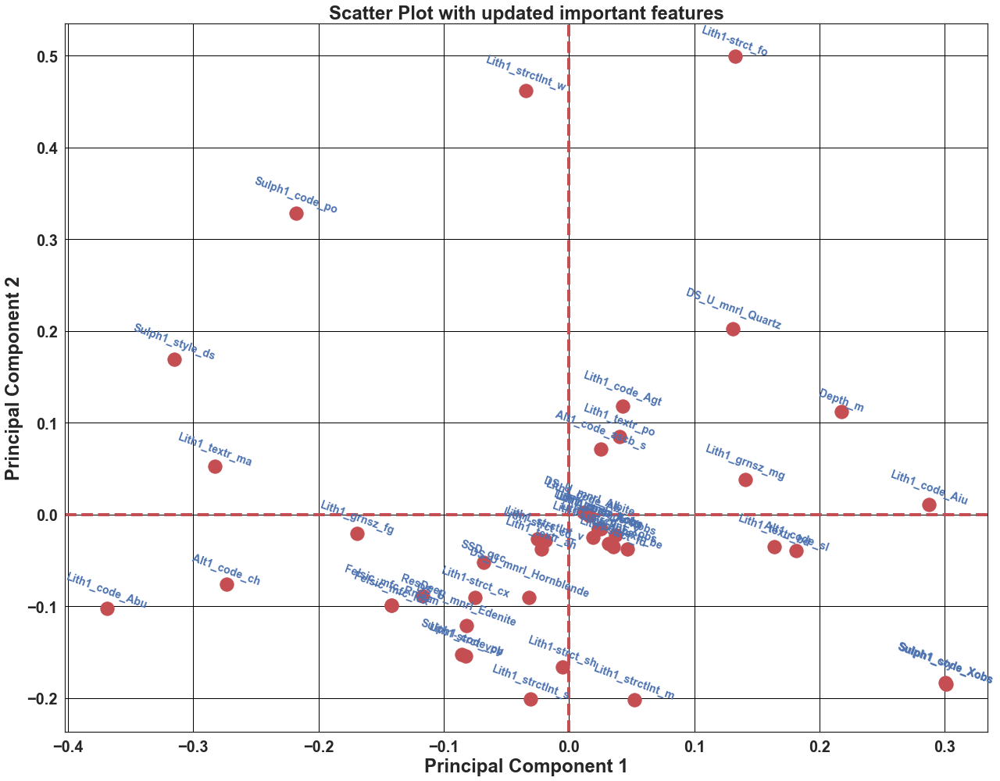

In [244]:
# https://www.kaggle.com/ashydv/country-clustering-hierarchical-clustering-pca

fig = plt.figure(figsize = (18,14))
#s = [20*2**n for n in range(len(test_df1))]
plt.scatter(test_df1.PC1, test_df1.PC2, s=300, color='r')
plt.xlabel('Principal Component 1', fontsize=24)
plt.ylabel('Principal Component 2', fontsize=24)
plt.xticks(fontsize=20)
plt.yticks(fontsize=20)
plt.title('Scatter Plot with updated important features', fontsize=24, weight='bold')
plt.axvline(x=0, linestyle='--', linewidth=4, color='r')
plt.axhline(y=0, linestyle='--', linewidth=4, color='r')
for i, txt in enumerate(test_df1.variables):
    plt.annotate(txt, (test_df1.PC1[i],test_df1.PC2[i]),ha='center', rotation=-20,fontsize=14,weight='bold', color='b')
plt.tight_layout()
plt.grid()
plt.show()

In [245]:
#test_df1.variables
# Replacing text string in the data frame
test_df1['variables'] = test_df1['variables'].str.replace('Lith1_code_Abu','Abu')

## Hopkins Statistics:

In [246]:
from sklearn.neighbors import NearestNeighbors
from random import sample
from numpy.random import uniform
import numpy as np
from math import isnan
 
def hopkins(X1_pc):
    d = X1_pc.shape[1]
    #d = len(vars) # columns
    n = len(X1_pc) # rows
    m = int(0.1 * n) 
    nbrs = NearestNeighbors(n_neighbors=1).fit(X1_pc.values)
 
    rand_X = sample(range(0, n, 1), m)
 
    ujd = []
    wjd = []
    for j in range(0, m):
        u_dist, _ = nbrs.kneighbors(uniform(np.amin(X1_pc,axis=0),np.amax(X1_pc,axis=0),d).reshape(1, -1), 2, return_distance=True)
        ujd.append(u_dist[0][1])
        w_dist, _ = nbrs.kneighbors(X1_pc.iloc[rand_X[j]].values.reshape(1, -1), 2, return_distance=True)
        wjd.append(w_dist[0][1])
 
    H = sum(ujd) / (sum(ujd) + sum(wjd))
    if isnan(H):
        print(ujd, wjd)
        H = 0
 
    return H

In [247]:
hopkins(df_INCpca_final_15EIS)

0.9768920395528355

## Hopkins Statistics method indicates that data has high tendency of clustering.

# Hierarchical clustering

In [248]:
from scipy.cluster.hierarchy import dendrogram
from scipy.cluster.hierarchy import cut_tree

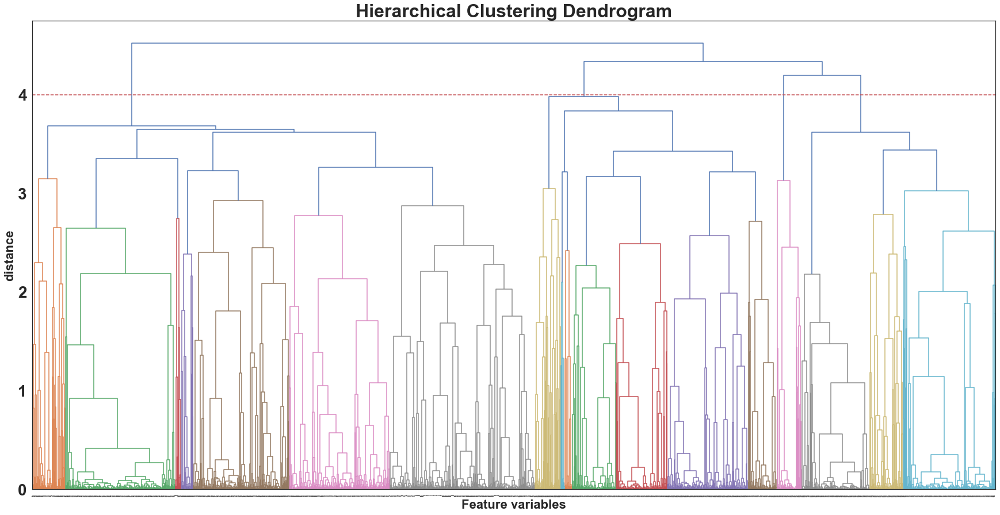

In [821]:
hc_average = linkage(df_INCpca_final_15EIS, "average")
hc_single = linkage(df_INCpca_final_15EIS, "single")
hc_complete = linkage(df_INCpca_final_15EIS, "complete")

# calculate full dendrogram
#plt.figure(figsize=(25, 10))
#fig, ax = plt.subplots(1,1, figsize = (15,8))
plt.rcParams['figure.facecolor'] = 'white'
plt.rcParams["figure.figsize"]=(30,15)
#plt.rcParams['font.size'] = 16
plt.title('Hierarchical Clustering Dendrogram', fontsize=32, weight='bold')
plt.xlabel('Feature variables', fontsize=22)
plt.ylabel('distance', fontsize=22)
dendrogram(
    hc_complete,
    leaf_rotation=45.,  # rotates the x axis labels
    leaf_font_size=3.,  # font size for the x axis labels
)
plt.axhline(y=4, c='r', ls='dashed')
plt.xticks(fontsize=2)
plt.yticks(fontsize=28)
plt.show()

In [250]:
print(list((cut_tree(hc_complete, n_clusters = 4).T)))

[array([0, 0, 0, ..., 1, 1, 1])]


 Looking at the dedrogram it is observed that cutting it at n = 4 is most optimum.

In [251]:
clusterCut = pd.Series(cut_tree(hc_complete, n_clusters = 4).reshape(-1,))
df_pca_hc = pd.concat([df_INCpca_final_15EIS, clusterCut], axis=1)
df_pca_hc.columns = ["PC1","PC2","PC3","PC4","PC5","PC6","PC7","PC8","PC9","PC10","PC11","PC12","ClusterID"]
#df_pca_hc.columns = ["PC1","PC2","PC3","PC4","ClusterID"]
df_pca_hc.sort_values(by=['ClusterID'], inplace=True)
df_pca_hc.head()

,PC1,PC2,PC3,PC4,PC5,PC6,PC7,PC8,PC9,PC10,PC11,PC12,ClusterID
0,0.942148,-0.592993,0.250984,-0.204158,1.093843,0.197721,0.431629,0.090671,0.010606,0.419415,-0.311893,-0.167637,0
861,0.852575,0.396273,-0.397820,0.723299,0.080053,-0.668006,0.095499,0.297107,-0.295079,-0.227751,-0.117702,-0.006327,0
860,0.848432,0.398845,-0.396335,0.721352,0.086334,-0.671444,0.096252,0.297206,-0.296580,-0.227081,-0.116064,-0.008514,0
859,0.884222,0.375662,-0.399020,0.731341,0.063745,-0.655598,0.096645,0.300127,-0.288411,-0.236764,-0.119424,0.005692,0
858,0.879758,0.378730,-0.397623,0.729184,0.068777,-0.658160,0.095976,0.299717,-0.290032,-0.233784,-0.116941,0.002566,0


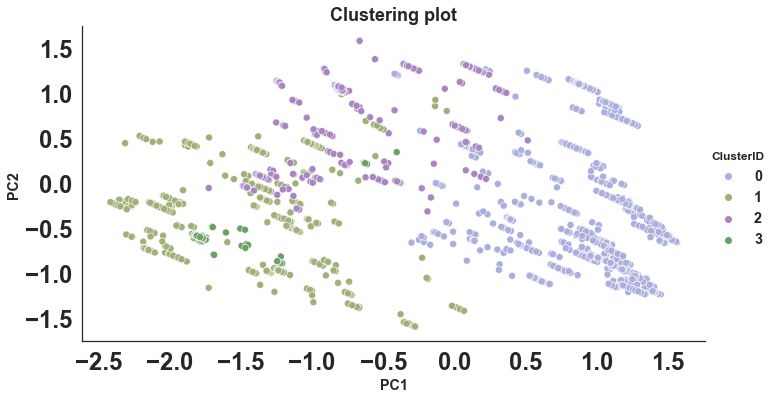

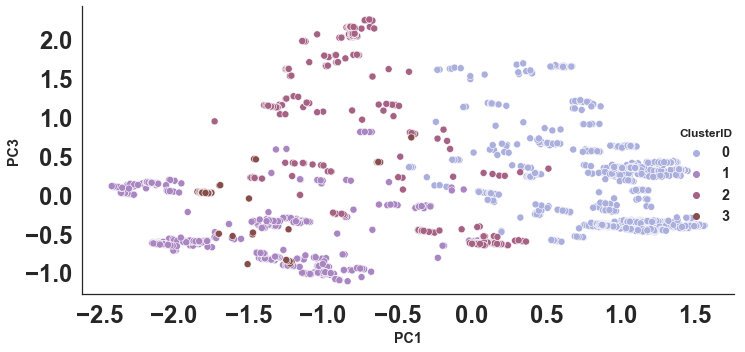

In [252]:
#plt.figure(figsize=(45,10))
sns.relplot(df_pca_hc['PC1'],df_pca_hc['PC2'], hue = df_pca_hc['ClusterID'], sizes=(50, 500),
            hue_norm=(0, 10), legend="full", palette="ch:r=-10,l=0.7", kind = "scatter", s=50, aspect=1.9, alpha=1 )
plt.title("Clustering plot", fontsize=18, weight='bold')
plt.xticks(fontsize=24)
plt.yticks(fontsize=24)
sns.relplot(df_pca_hc['PC1'],df_pca_hc['PC3'], hue = df_pca_hc['ClusterID'], sizes=(50, 500),
            hue_norm=(0, 5),  palette="ch:r=-10,l=0.7", kind = "scatter", s=50, aspect=1.9, alpha=1 )
plt.xticks(fontsize=24)
plt.yticks(fontsize=24)
plt.tight_layout()
plt.show()

In [253]:
pca_cluster_hc = pd.concat([cat_df2_15EIS['DS_U_grp'],df_pca_hc], axis=1, join='outer', 
                           ignore_index=False, keys=None, levels=None, names=None, verify_integrity=False, sort=None, copy=True)
#pca_cluster_hc.sort_values(by=['ClusterID'], inplace=True)
pca_cluster_hc.shape

(2409, 14)

In [254]:
#cat_df2_15EIS[['DS_U_grp']]
#df1_15EIS[['DS_U_grp']].info()
df1_15EIS['DS_U_grp'] = df1_15EIS['DS_U_grp'].astype(object)

In [255]:
#pca_cluster_hc.sort_values(by=['ClusterID'], inplace=True)
#pca_cluster_hc
pca_cluster_hc['DS_U_grp'] = pca_cluster_hc['DS_U_grp'].astype(object)

In [256]:
#df1_15EIS.head()

In [257]:
#clustered_data_hc = pca_cluster_hc[['DS_U_grp','ClusterID']].merge(df1_15EIS, on = 'DS_U_grp')
clustered_data_hc = pd.merge(pca_cluster_hc, df1_15EIS, right_index=True, left_index=True)
clustered_data_hc.sort_values(by=['ClusterID'], inplace=True)
clustered_data_hc.head()

,DS_U_grp_x,PC1,PC2,PC3,PC4,PC5,PC6,PC7,PC8,PC9,PC10,PC11,PC12,ClusterID,As_ppm,Cu_ppm,Pb_ppm,Sb_ppm,W_ppm,Zn_ppm,Alt1_code,DS_U_grp_y,DS_U_mnrl,Felsic_mfc_idx,Felsic_mfc_Rmean,Lith1_code,Lith1_grnsz,Lith1_strctInt,Lith1-strct,Lith1_textr,ResDeep,SSD_gcc,Sulph1_code,Sulph1_style,Susp_SI,Depth_m,Vel_geomean,Vel_std,Au_ppm
0,AMPHIBOLE,0.942148,-0.592993,0.250984,-0.204158,1.093843,0.197721,0.431629,0.090671,0.010606,0.419415,-0.311893,-0.167637,0,NaN,NaN,NaN,NaN,NaN,NaN,ch,AMPHIBOLE,Quartz,9555.8535,9556.0693,Abu,fg,v,sh,ma,0.437919,3.134581,py,ds,-0.002080,495.81237,7316.6562,12.472190,NaN
861,PLAGIOCLASE,0.852575,0.396273,-0.397820,0.723299,0.080053,-0.668006,0.095499,0.297107,-0.295079,-0.227751,-0.117702,-0.006327,0,NaN,NaN,NaN,NaN,NaN,NaN,ch,PLAGIOCLASE,Quartz,9685.0800,9685.7929,Abu,fg,m,fo,ma,8176.244100,3.091149,po,ds,0.004392,926.25030,4233.2363,28.674417,NaN
860,PLAGIOCLASE,0.848432,0.398845,-0.396335,0.721352,0.086334,-0.671444,0.096252,0.297206,-0.296580,-0.227081,-0.116064,-0.008514,0,NaN,NaN,NaN,NaN,NaN,NaN,ch,PLAGIOCLASE,Quartz,9648.0390,9639.8642,Abu,fg,m,fo,ma,8295.673800,3.124021,po,ds,0.004000,925.74969,4233.2363,28.674417,NaN
859,PLAGIOCLASE,0.884222,0.375662,-0.399020,0.731341,0.063745,-0.655598,0.096645,0.300127,-0.288411,-0.236764,-0.119424,0.005692,0,NaN,NaN,NaN,NaN,NaN,NaN,ch,PLAGIOCLASE,Quartz,9741.0429,9743.3955,Abu,fg,m,fo,ma,8297.030200,3.132973,po,ds,0.004000,925.24896,NaN,NaN,NaN
858,PLAGIOCLASE,0.879758,0.378730,-0.397623,0.729184,0.068777,-0.658160,0.095976,0.299717,-0.290032,-0.233784,-0.116941,0.002566,0,NaN,NaN,NaN,NaN,NaN,NaN,ch,PLAGIOCLASE,Quartz,9719.5127,9726.4150,Abu,fg,m,fo,ma,8273.823200,3.119933,po,ds,0.004000,924.73278,NaN,NaN,NaN


In [258]:
clustered_data_hc_num = clustered_data_hc.copy()
clustered_data_hc_num = clustered_data_hc_num.drop(['DS_U_grp_x', 'PC1', 'PC2', 'PC3', 'PC4', 'PC5', 'PC6', 'PC7', 'PC8',
                                                    'PC9', 'PC10', 'PC11', 'PC12','Alt1_code', 'DS_U_grp_y','Sulph1_code','Sulph1_style',
                                                    'DS_U_mnrl', 'Felsic_mfc_idx', 'Felsic_mfc_Rmean', 'Lith1_code',
                                                    'Lith1_grnsz', 'Lith1_strctInt', 'Lith1-strct', 'Lith1_textr'], axis=1)

In [259]:
#clustered_data_hc_num.dtypes
clustered_data_hc_num1=clustered_data_hc_num.apply(lambda x: x.fillna(x.mean()),axis=0)

In [260]:
#clustered_data_hc_edit = clustered_data_hc.drop(["DS_U_grp_x"])
clustered_data_hc.columns

Index(['DS_U_grp_x', 'PC1', 'PC2', 'PC3', 'PC4', 'PC5', 'PC6', 'PC7', 'PC8',
       'PC9', 'PC10', 'PC11', 'PC12', 'ClusterID', 'As_ppm', 'Cu_ppm',
       'Pb_ppm', 'Sb_ppm', 'W_ppm', 'Zn_ppm', 'Alt1_code', 'DS_U_grp_y',
       'DS_U_mnrl', 'Felsic_mfc_idx', 'Felsic_mfc_Rmean', 'Lith1_code',
       'Lith1_grnsz', 'Lith1_strctInt', 'Lith1-strct', 'Lith1_textr',
       'ResDeep', 'SSD_gcc', 'Sulph1_code', 'Sulph1_style', 'Susp_SI',
       'Depth_m', 'Vel_geomean', 'Vel_std', 'Au_ppm'],
      dtype='object')

<AxesSubplot:xlabel='DS_U_grp_x', ylabel='Au_ppm'>

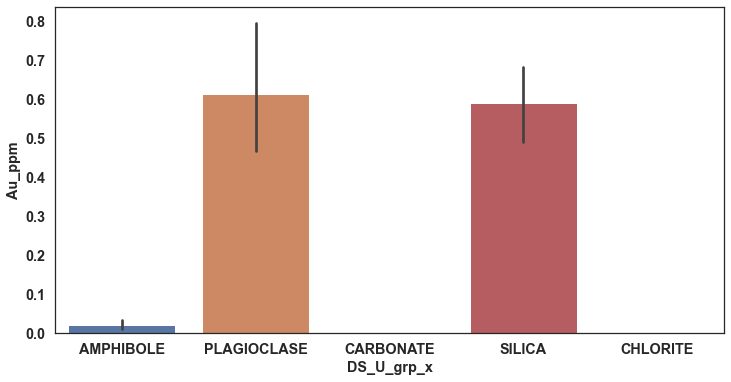

In [261]:
plt.figure(figsize=(12,6))
sns.barplot(x=clustered_data_hc.DS_U_grp_x, y=clustered_data_hc.Au_ppm)

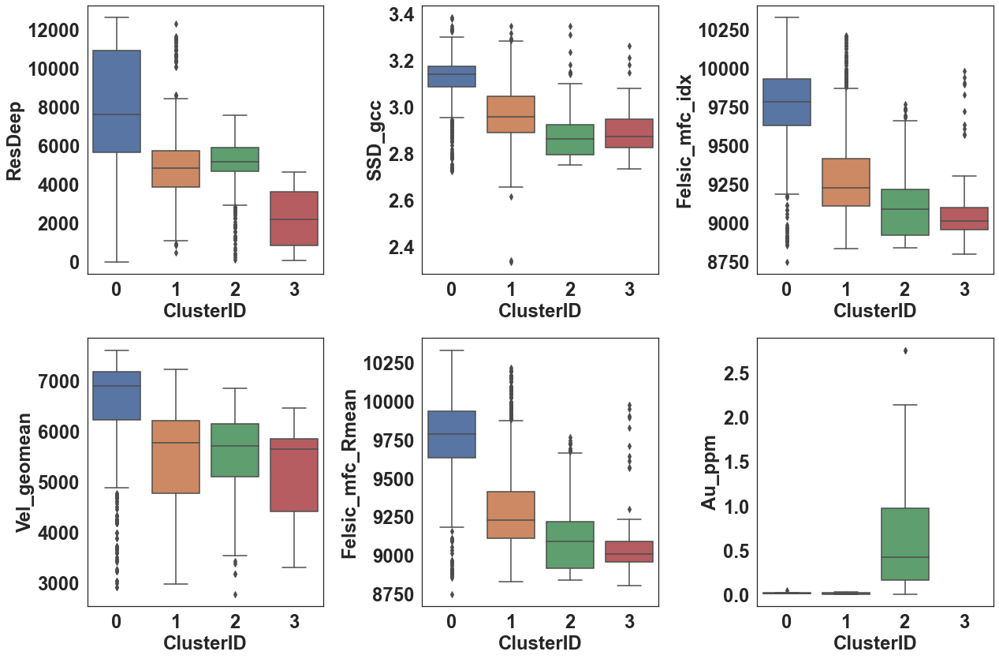

In [823]:
plt.rcParams['font.size'] = 20
fig, axs = plt.subplots(2,3,figsize = (18,12))
sns.boxplot(x=clustered_data_hc.ClusterID, y=clustered_data_hc.ResDeep, ax = axs[0,0])
sns.boxplot(x=clustered_data_hc.ClusterID, y=clustered_data_hc.SSD_gcc, ax = axs[0,1])
sns.boxplot(x=clustered_data_hc.ClusterID, y=clustered_data_hc.Felsic_mfc_idx, ax = axs[0,2])
sns.boxplot(x=clustered_data_hc.ClusterID, y=clustered_data_hc.Vel_geomean, ax = axs[1,0])
sns.boxplot(x=clustered_data_hc.ClusterID, y=clustered_data_hc.Felsic_mfc_Rmean, ax = axs[1,1])
sns.boxplot(x=clustered_data_hc.ClusterID, y=clustered_data_hc.Au_ppm, ax = axs[1,2])
plt.tight_layout()
plt.show()

In [263]:
# Clusters containing rock group
clust0= list(clustered_data_hc[clustered_data_hc.ClusterID == 0].DS_U_grp_x.values)
clust1= list(clustered_data_hc[clustered_data_hc.ClusterID == 1].DS_U_grp_x.values)
clust2= list(clustered_data_hc[clustered_data_hc.ClusterID == 2].DS_U_grp_x.values)
clust3= list(clustered_data_hc[clustered_data_hc.ClusterID == 3].DS_U_grp_x.values)
#clust4= list(clustered_data_hc[clustered_data_hc.ClusterID == 4].DS_U_grp_x.values)
print("clust0 :",list(set(clust0)))
print("clust1 :",list(set(clust1)))
print("clust2 :",list(set(clust2)))
print("clust3 :",list(set(clust3)))
#print("clust4 :",list(set(clust4)))
len(clustered_data_hc)

clust0 : ['AMPHIBOLE', 'CARBONATE', 'CHLORITE', 'PLAGIOCLASE', 'SILICA']
clust1 : ['AMPHIBOLE', 'PLAGIOCLASE', 'SILICA']
clust2 : ['AMPHIBOLE', 'PLAGIOCLASE', 'SILICA']
clust3 : ['AMPHIBOLE', 'PLAGIOCLASE', 'SILICA']


2409

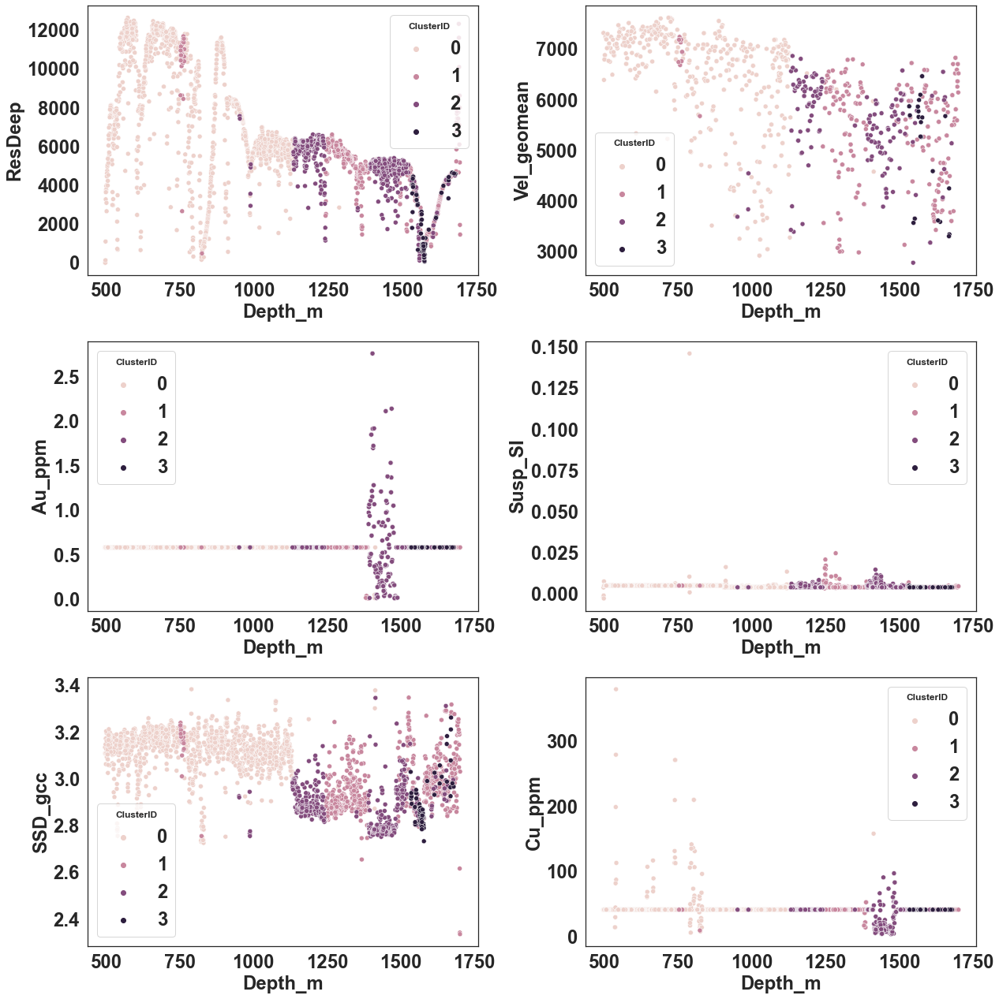

In [824]:
plt.figure(figsize = (18, 18))
ax = plt.subplot(3,2,1)
sns.scatterplot(x=clustered_data_hc.Depth_m, y=clustered_data_hc.ResDeep, hue=clustered_data_hc.ClusterID, ax=ax);
ax = plt.subplot(3,2,2)
sns.scatterplot(x=clustered_data_hc.Depth_m, y=clustered_data_hc.Vel_geomean, hue=clustered_data_hc.ClusterID, ax=ax);
ax = plt.subplot(3,2,3)
sns.scatterplot(x=clustered_data_hc_num1.Depth_m, y=clustered_data_hc_num1.Au_ppm, hue=clustered_data_hc_num1.ClusterID, ax=ax);
ax = plt.subplot(3,2,4)
sns.scatterplot(x=clustered_data_hc_num1.Depth_m, y=clustered_data_hc_num1.Susp_SI, hue=clustered_data_hc_num1.ClusterID, ax=ax);
ax = plt.subplot(3,2,5)
sns.scatterplot(x=clustered_data_hc_num1.Depth_m, y=clustered_data_hc_num1.SSD_gcc, hue=clustered_data_hc_num1.ClusterID, ax=ax);
ax = plt.subplot(3,2,6)
sns.scatterplot(x=clustered_data_hc_num1.Depth_m, y=clustered_data_hc_num1.Cu_ppm, hue=clustered_data_hc_num1.ClusterID, ax=ax);
plt.tight_layout()
plt.show()

In [265]:
# https://www.azom.com/properties.aspx?ArticleID=1114
# 
# Clusters containing rock group
Res_clust0= list(clustered_data_hc_num1[clustered_data_hc_num1.ClusterID == 0].ResDeep.values)
Res_clust1= list(clustered_data_hc_num1[clustered_data_hc_num1.ClusterID == 1].ResDeep.values)
Res_clust2= list(clustered_data_hc_num1[clustered_data_hc_num1.ClusterID == 2].ResDeep.values)
Res_clust3= list(clustered_data_hc_num1[clustered_data_hc_num1.ClusterID == 3].ResDeep.values)
#clust4= list(clustered_data_hc[clustered_data_hc.ClusterID == 4].DS_U_grp_x.values)
print("clust0 :",min(Res_clust0),max(Res_clust0))
print("clust1 :",min(Res_clust1),max(Res_clust1))
print("clust2 :",min(Res_clust2),max(Res_clust2))
print("clust3 :",min(Res_clust3),max(Res_clust3))

clust0 : 0.4379193 12626.246
clust1 : 479.49542 12313.735
clust2 : 114.15031 7561.2768
clust3 : 57.421436 4645.5351


<AxesSubplot:xlabel='Depth_m', ylabel='Vel_geomean'>

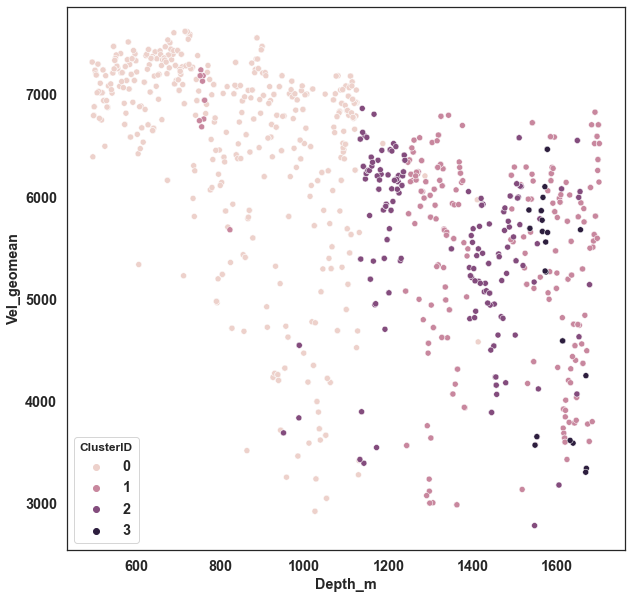

In [266]:
fig, axs = plt.subplots(1,1,figsize = (10,10))
sns.scatterplot(x=clustered_data_hc.Depth_m, y=clustered_data_hc.Vel_geomean, hue=clustered_data_hc.ClusterID)

In [267]:
# Clusters containing rock group
Vel_clust0= list(clustered_data_hc_num1[clustered_data_hc_num1.ClusterID == 0].Vel_geomean.values)
Vel_clust1= list(clustered_data_hc_num1[clustered_data_hc_num1.ClusterID == 1].Vel_geomean.values)
Vel_clust2= list(clustered_data_hc_num1[clustered_data_hc_num1.ClusterID == 2].Vel_geomean.values)
Vel_clust3= list(clustered_data_hc_num1[clustered_data_hc_num1.ClusterID == 3].Vel_geomean.values)
#clust4= list(clustered_data_hc[clustered_data_hc.ClusterID == 4].DS_U_grp_x.values)
print("clust0 :",min(Vel_clust0),max(Vel_clust0))
print("clust1 :",min(Vel_clust1),max(Vel_clust1))
print("clust2 :",min(Vel_clust2),max(Vel_clust2))
print("clust3 :",min(Vel_clust3),max(Vel_clust3))

clust0 : 2923.1928 7616.5952
clust1 : 2986.6184 7239.9399
clust2 : 2783.1857 6863.2832
clust3 : 3305.2255 6463.311


<AxesSubplot:xlabel='Depth_m', ylabel='Au_ppm'>

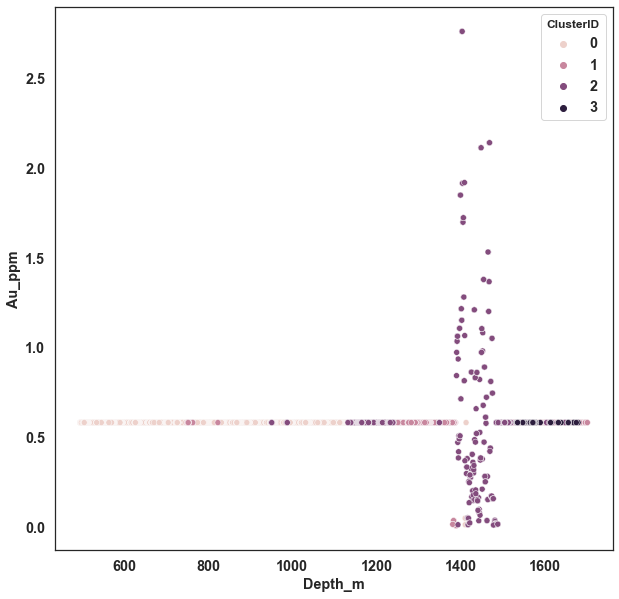

In [268]:
fig, axs = plt.subplots(1,1,figsize = (10,10))
sns.scatterplot(x=clustered_data_hc_num1.Depth_m, y=clustered_data_hc_num1.Au_ppm, hue=clustered_data_hc_num1.ClusterID)

In [269]:
# Clusters containing rock group
Au_clust0= list(clustered_data_hc_num1[clustered_data_hc_num1.ClusterID == 0].Au_ppm.values)
Au_clust1= list(clustered_data_hc_num1[clustered_data_hc_num1.ClusterID == 1].Au_ppm.values)
Au_clust2= list(clustered_data_hc_num1[clustered_data_hc_num1.ClusterID == 2].Au_ppm.values)
Au_clust3= list(clustered_data_hc_num1[clustered_data_hc_num1.ClusterID == 3].Au_ppm.values)
#clust4= list(clustered_data_hc[clustered_data_hc.ClusterID == 4].DS_U_grp_x.values)
print("clust0 :",min(Au_clust0),max(Au_clust0))
print("clust1 :",min(Au_clust1),max(Au_clust1))
print("clust2 :",min(Au_clust2),max(Au_clust2))
print("clust3 :",min(Au_clust3),max(Au_clust3))

clust0 : 0.012 0.5809841224489792
clust1 : 0.006999999999999999 0.5809841224489792
clust2 : 0.0099999 2.7599999
clust3 : 0.5809841224489792 0.5809841224489792


<AxesSubplot:xlabel='Depth_m', ylabel='Susp_SI'>

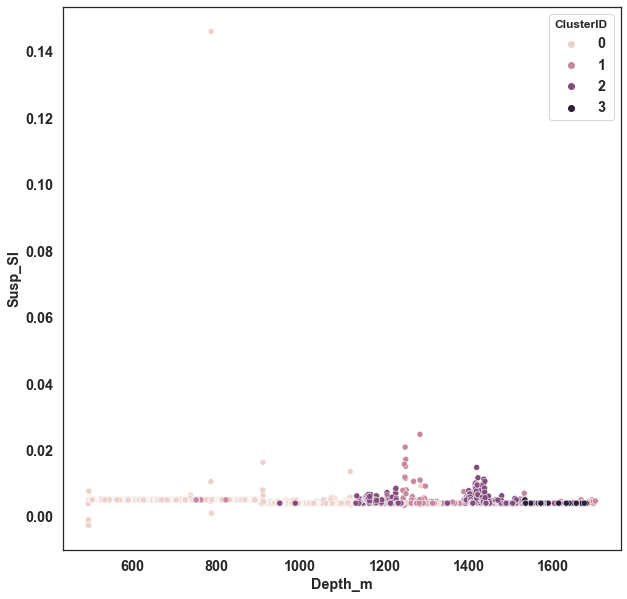

In [270]:
fig, axs = plt.subplots(1,1,figsize = (10,10))
sns.scatterplot(x=clustered_data_hc_num1.Depth_m, y=clustered_data_hc_num1.Susp_SI, hue=clustered_data_hc_num1.ClusterID)

In [271]:
# Clusters containing rock group
SuspSI_clust0= list(clustered_data_hc_num1[clustered_data_hc_num1.ClusterID == 0].Susp_SI.values)
SuspSI_clust1= list(clustered_data_hc_num1[clustered_data_hc_num1.ClusterID == 1].Susp_SI.values)
SuspSI_clust2= list(clustered_data_hc_num1[clustered_data_hc_num1.ClusterID == 2].Susp_SI.values)
SuspSI_clust3= list(clustered_data_hc_num1[clustered_data_hc_num1.ClusterID == 3].Susp_SI.values)
#clust4= list(clustered_data_hc[clustered_data_hc.ClusterID == 4].DS_U_grp_x.values)
print("clust0 :",min(SuspSI_clust0),max(SuspSI_clust0))
print("clust1 :",min(SuspSI_clust1),max(SuspSI_clust1))
print("clust2 :",min(SuspSI_clust2),max(SuspSI_clust2))
print("clust3 :",min(SuspSI_clust3),max(SuspSI_clust3))

clust0 : -0.00275 0.146
clust1 : 0.0033684 0.0247166
clust2 : 0.004 0.0147619
clust3 : 0.004 0.0049999


<AxesSubplot:xlabel='Depth_m', ylabel='SSD_gcc'>

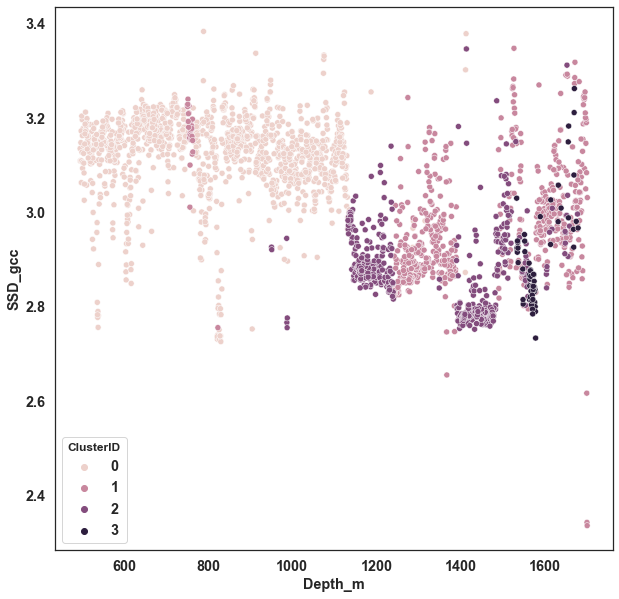

In [272]:
fig, axs = plt.subplots(1,1,figsize = (10,10))
sns.scatterplot(x=clustered_data_hc_num1.Depth_m, y=clustered_data_hc_num1.SSD_gcc, hue=clustered_data_hc_num1.ClusterID)

In [273]:
#https://www.geeksforgeeks.org/stacked-percentage-bar-plot-in-matplotlib/
#pd.crosstab(clustered_data_hc['ClusterID'], clustered_data_hc['DS_U_grp_x']).apply(lambda r: r/len(clustered_data_hc), axis=1).plot(kind='barh', stacked=True)

In [274]:
clustered_data_hc.columns

Index(['DS_U_grp_x', 'PC1', 'PC2', 'PC3', 'PC4', 'PC5', 'PC6', 'PC7', 'PC8',
       'PC9', 'PC10', 'PC11', 'PC12', 'ClusterID', 'As_ppm', 'Cu_ppm',
       'Pb_ppm', 'Sb_ppm', 'W_ppm', 'Zn_ppm', 'Alt1_code', 'DS_U_grp_y',
       'DS_U_mnrl', 'Felsic_mfc_idx', 'Felsic_mfc_Rmean', 'Lith1_code',
       'Lith1_grnsz', 'Lith1_strctInt', 'Lith1-strct', 'Lith1_textr',
       'ResDeep', 'SSD_gcc', 'Sulph1_code', 'Sulph1_style', 'Susp_SI',
       'Depth_m', 'Vel_geomean', 'Vel_std', 'Au_ppm'],
      dtype='object')

In [275]:
drop_hc_cols = ['PC1', 'PC2', 'PC3', 'PC4', 'PC5', 'PC6', 'PC7', 'PC8',
       'PC9', 'PC10', 'PC11', 'PC12','DS_U_grp_y']
clustered_data_hc.drop(drop_hc_cols, inplace=True, axis=1)

In [276]:
clustered_data_hc.head()

,DS_U_grp_x,ClusterID,As_ppm,Cu_ppm,Pb_ppm,Sb_ppm,W_ppm,Zn_ppm,Alt1_code,DS_U_mnrl,Felsic_mfc_idx,Felsic_mfc_Rmean,Lith1_code,Lith1_grnsz,Lith1_strctInt,Lith1-strct,Lith1_textr,ResDeep,SSD_gcc,Sulph1_code,Sulph1_style,Susp_SI,Depth_m,Vel_geomean,Vel_std,Au_ppm
0,AMPHIBOLE,0,NaN,NaN,NaN,NaN,NaN,NaN,ch,Quartz,9555.8535,9556.0693,Abu,fg,v,sh,ma,0.437919,3.134581,py,ds,-0.002080,495.81237,7316.6562,12.472190,NaN
861,PLAGIOCLASE,0,NaN,NaN,NaN,NaN,NaN,NaN,ch,Quartz,9685.0800,9685.7929,Abu,fg,m,fo,ma,8176.244100,3.091149,po,ds,0.004392,926.25030,4233.2363,28.674417,NaN
860,PLAGIOCLASE,0,NaN,NaN,NaN,NaN,NaN,NaN,ch,Quartz,9648.0390,9639.8642,Abu,fg,m,fo,ma,8295.673800,3.124021,po,ds,0.004000,925.74969,4233.2363,28.674417,NaN
859,PLAGIOCLASE,0,NaN,NaN,NaN,NaN,NaN,NaN,ch,Quartz,9741.0429,9743.3955,Abu,fg,m,fo,ma,8297.030200,3.132973,po,ds,0.004000,925.24896,NaN,NaN,NaN
858,PLAGIOCLASE,0,NaN,NaN,NaN,NaN,NaN,NaN,ch,Quartz,9719.5127,9726.4150,Abu,fg,m,fo,ma,8273.823200,3.119933,po,ds,0.004000,924.73278,NaN,NaN,NaN


In [277]:
clustered_data_hc.columns

Index(['DS_U_grp_x', 'ClusterID', 'As_ppm', 'Cu_ppm', 'Pb_ppm', 'Sb_ppm',
       'W_ppm', 'Zn_ppm', 'Alt1_code', 'DS_U_mnrl', 'Felsic_mfc_idx',
       'Felsic_mfc_Rmean', 'Lith1_code', 'Lith1_grnsz', 'Lith1_strctInt',
       'Lith1-strct', 'Lith1_textr', 'ResDeep', 'SSD_gcc', 'Sulph1_code',
       'Sulph1_style', 'Susp_SI', 'Depth_m', 'Vel_geomean', 'Vel_std',
       'Au_ppm'],
      dtype='object')

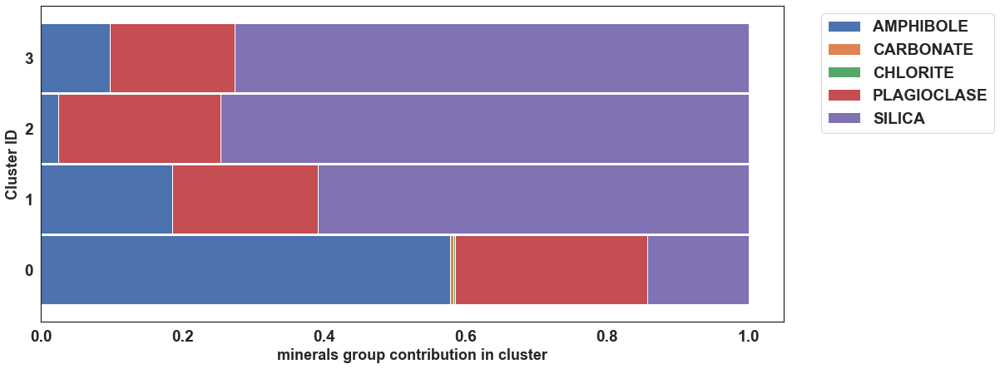

In [832]:
#plt.figure(figsize=(12,12))
plt.rcParams["font.weight"] = "bold"
plt.rcParams["axes.labelweight"] = "bold"
pd.crosstab(clustered_data_hc.ClusterID, clustered_data_hc.DS_U_grp_x, normalize='index').plot(kind='barh', width=0.97, stacked=True, figsize=(16,7))
plt.xlabel('minerals group contribution in cluster', size=18)
plt.ylabel('Cluster ID', size=18)
plt.legend(bbox_to_anchor=(1.04,1), loc="upper left")
plt.savefig('Minerals_clusters_1.png')

In [279]:
pd.crosstab(clustered_data_hc.ClusterID, clustered_data_hc.DS_U_grp_x, normalize='index')

DS_U_grp_x,AMPHIBOLE,CARBONATE,CHLORITE,PLAGIOCLASE,SILICA
ClusterID,,,,,
0,0.578361,0.004773,0.001591,0.272076,0.143198
1,0.185124,0.000000,0.000000,0.206612,0.608264
2,0.024742,0.000000,0.000000,0.228866,0.746392
3,0.096774,0.000000,0.000000,0.177419,0.725806


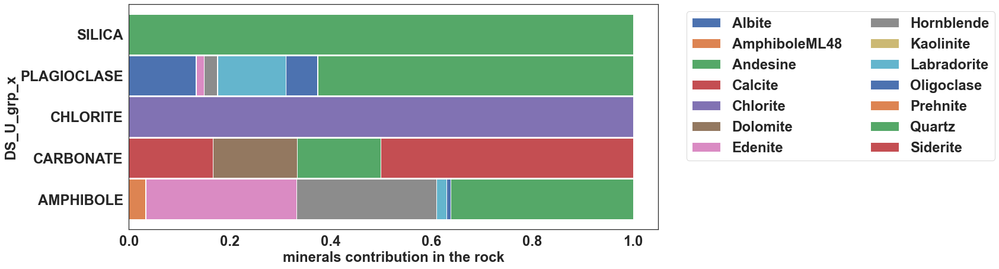

In [826]:
pd.crosstab(clustered_data_hc.DS_U_grp_x, clustered_data_hc.DS_U_mnrl, normalize='index').plot(kind='barh', width=0.97,stacked=True, figsize=(16,7))
plt.xlabel('minerals contribution in the rock')
plt.legend(ncol=2,bbox_to_anchor=(1.04,1), loc="upper left")
plt.savefig('Minerals_clusters_2.png')

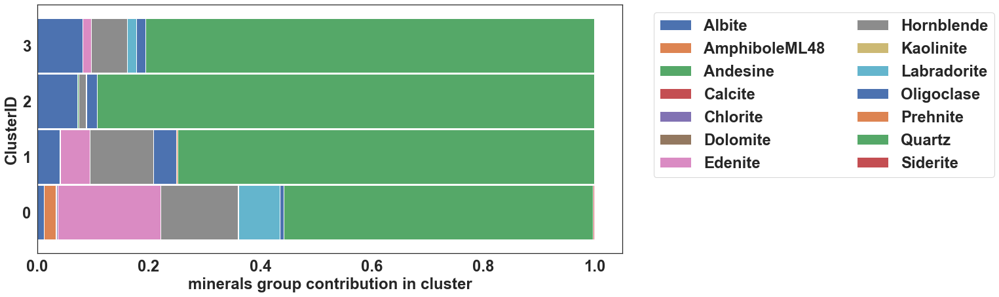

In [827]:
pd.crosstab(clustered_data_hc.ClusterID, clustered_data_hc.DS_U_mnrl, normalize='index').plot(kind='barh', width=0.97,stacked=True, figsize=(16,7))
plt.xlabel('minerals group contribution in cluster')
plt.legend(ncol=2,bbox_to_anchor=(1.04,1), loc="upper left")
plt.savefig('Minerals_clusters_3.png', dpi=600)

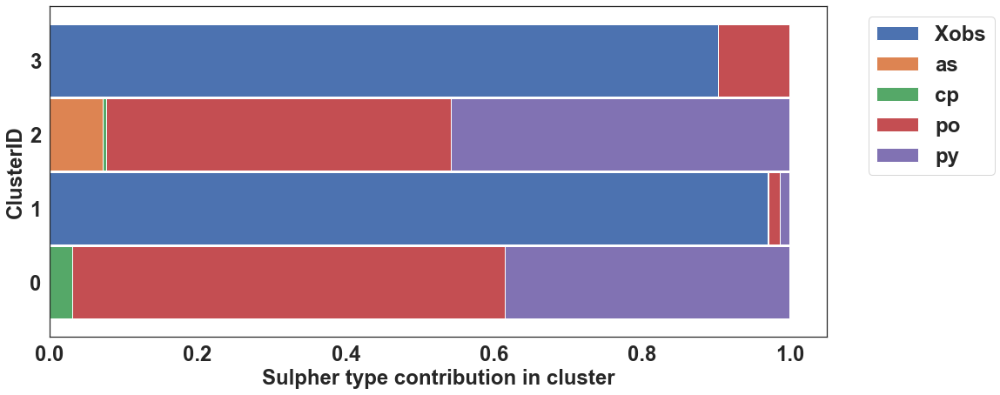

In [828]:
pd.crosstab(clustered_data_hc.ClusterID, clustered_data_hc.Sulph1_code, normalize='index').plot(kind='barh', width=0.97,stacked=True, figsize=(16,7))
plt.xlabel('Sulpher type contribution in cluster')
plt.legend(bbox_to_anchor=(1.04,1), loc="upper left")
plt.savefig('Minerals_clusters_4.png',dpi=600)

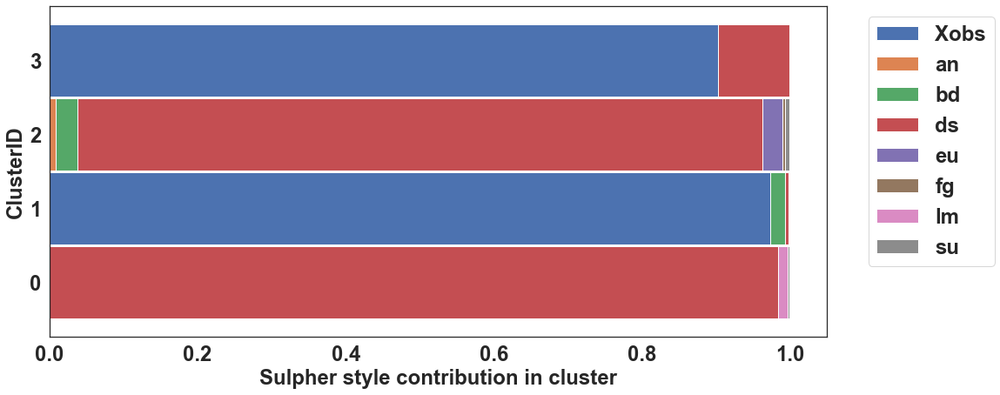

In [829]:
pd.crosstab(clustered_data_hc.ClusterID, clustered_data_hc.Sulph1_style, normalize='index').plot(kind='barh', width=0.97,stacked=True, figsize=(16,7))
plt.xlabel('Sulpher style contribution in cluster')
plt.legend(bbox_to_anchor=(1.04,1), loc="upper left")
plt.savefig('Sulpher_style_contribution.png',dpi=300)

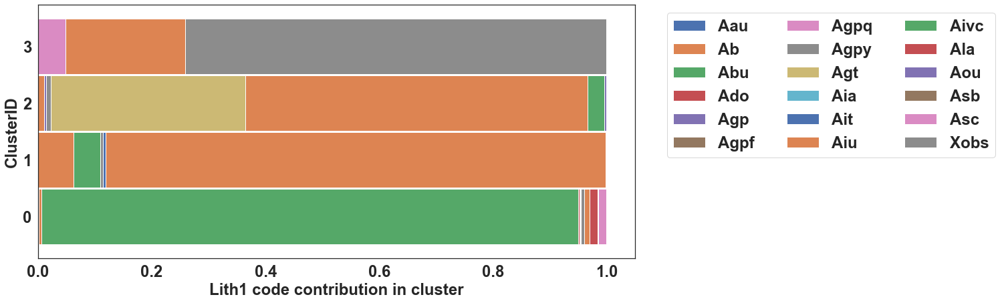

In [833]:
plt.rcParams['font.size'] = 20
pd.crosstab(clustered_data_hc.ClusterID, clustered_data_hc.Lith1_code, normalize='index').plot(kind='barh', width=0.97, stacked=True, figsize=(16,7))
plt.xlabel('Lith1 code contribution in cluster')
plt.legend(ncol=3,bbox_to_anchor=(1.04,1), loc="upper left")
plt.savefig('Lith1_code_contribution.png',dpi=300)

## plotting all images together for paper
from matplotlib.image import imread
plt.figure(figsize=(50,50))
#plt.rcParams["figure.figsize"]=(15,15)
folder = '/UNSW/PhD/Paper_drafts/Figures/'     #folder where your photos are store
# plot first few images
for i in range(6):
    # define subplot
#    pyplot.subplot(333 + 1 + i)
    plt.subplot(430 + 1 + i)
#    x= folder + 'cat.' + str(i) + '.jpg'
    x= folder+ 'Minerals_clusters_' +str(i+1) + '.png'
    # load image pixels
    image = imread(x)
    # plot raw pixel data
    plt.imshow(image)

## The important features are the ones that influence more the components and thus, have a large absolute value/coefficient/loading on the component.¶
### Get the most important feature name on the PCs

In [745]:
import pandas as pd
import numpy as np
np.random.seed(0)
scaled_df_comb_15EIS.shape

(2409, 98)

In [746]:
# 2409 samples with 98 features
train_features_15EIS = np.random.rand(2409, 98)

In [760]:
pca_15EIS_out = PCA(n_components=0.2).fit(train_features_15EIS)  # Actually Working for features selection
pca_15EIS_new = pca_15EIS_out.transform(train_features_15EIS)

In [761]:
# number of components
n_pca_15EIS= pca_15EIS_out.components_.shape[0]
n_pca_15EIS

15

In [749]:
#pca_15EIS_out_explained_variance_
pca_15EIS_out.explained_variance_

array([0.1146077 , 0.11271851, 0.11144899, 0.10906202, 0.10872577,
       0.10725019, 0.10646002, 0.10551036, 0.10311019, 0.10154986,
       0.10065192, 0.09980639])

In [750]:
# get the index of the most important feature on EACH component i.e. largest absolute value
# using LIST COMPREHENSION HERE
most_important_15EIS = [np.abs(pca_15EIS_out.components_[i]).argmax() for i in range(n_pca_15EIS)]

initial_features_names_15EIS =['Alt1_code_Xobs', 'Alt1_code_ab', 'Alt1_code_ascb_m',
       'Alt1_code_ascb_s', 'Alt1_code_ascb_w', 'Alt1_code_bi', 'Alt1_code_ch',
       'Alt1_code_ep', 'Alt1_code_he', 'Alt1_code_hemag', 'Alt1_code_sacb',
       'Alt1_code_si', 'Alt1_code_sl','DS_U_mnrl_Albite', 'DS_U_mnrl_AmphiboleML48',
       'DS_U_mnrl_Andesine', 'DS_U_mnrl_Calcite', 'DS_U_mnrl_Chlorite',
       'DS_U_mnrl_Dolomite', 'DS_U_mnrl_Edenite', 'DS_U_mnrl_Hornblende',
       'DS_U_mnrl_Kaolinite', 'DS_U_mnrl_Labradorite', 'DS_U_mnrl_Oligoclase',
       'DS_U_mnrl_Prehnite', 'DS_U_mnrl_Quartz', 'DS_U_mnrl_Siderite',
       'Lith1_code_Aau', 'Lith1_code_Ab', 'Lith1_code_Abu', 'Lith1_code_Ado',
       'Lith1_code_Agp', 'Lith1_code_Agpf', 'Lith1_code_Agpq',
       'Lith1_code_Agpy', 'Lith1_code_Agt', 'Lith1_code_Aia', 'Lith1_code_Ait',
       'Lith1_code_Aiu', 'Lith1_code_Aivc', 'Lith1_code_Ala', 'Lith1_code_Aou',
       'Lith1_code_Asb', 'Lith1_code_Asc', 'Lith1_code_Xobs',
       'Lith1_grnsz_Xobs', 'Lith1_grnsz_cg', 'Lith1_grnsz_fg',
       'Lith1_grnsz_mg', 'Lith1_strctInt_Xobs', 'Lith1_strctInt_m',
       'Lith1_strctInt_s', 'Lith1_strctInt_v', 'Lith1_strctInt_w',
       'Lith1-strct_Xobs', 'Lith1-strct_bd', 'Lith1-strct_bx',
       'Lith1-strct_cc', 'Lith1-strct_cx', 'Lith1-strct_fd', 'Lith1-strct_fo',
       'Lith1-strct_sh', 'Lith1-strct_vcb', 'Lith1_textr_Xobs',
       'Lith1_textr_ah', 'Lith1_textr_bb', 'Lith1_textr_bd', 'Lith1_textr_be',
       'Lith1_textr_cc', 'Lith1_textr_cx', 'Lith1_textr_cz', 'Lith1_textr_fr',
       'Lith1_textr_ma', 'Lith1_textr_po', 'Lith1_textr_si', 'Lith1_textr_sp',
       'Lith1_textr_tu', 'Sulph1_code_Xobs', 'Sulph1_code_as',
       'Sulph1_code_cp', 'Sulph1_code_po', 'Sulph1_code_py',
       'Sulph1_style_Xobs', 'Sulph1_style_an', 'Sulph1_style_bd',
       'Sulph1_style_ds', 'Sulph1_style_eu', 'Sulph1_style_fg',
       'Sulph1_style_lm', 'Sulph1_style_su','Felsic_mfc_idx', 'Felsic_mfc_Rmean', 'ResDeep',
       'SSD_gcc', 'Susp_SI', 'Depth_m', 'Vel_geomean', 'Vel_std']

# get the names
#most_important_names_15EIS = [initial_features_names_15EIS[most_important_15EIS[i]] for i in range(n_pcs_15EIS)]

# using LIST COMPREHENSION HERE AGAIN
#dic_15EIS = {'15EIS_PC{}'.format(i+1): most_important_names_15EIS[i] for i in range(n_pcs_15EIS)}

# build the dataframe
#df_imp_features_15EIS = pd.DataFrame(sorted(dic_15EIS.items()))

# print important features

#df_imp_features_15EIS

In [751]:
# get the names
most_important_names_15EIS = [initial_features_names_15EIS[most_important_15EIS[i]] for i in range(n_pca_15EIS)]
most_important_names_15EIS
#most_important_15EIS

['Vel_geomean',
 'DS_U_mnrl_Kaolinite',
 'DS_U_mnrl_Kaolinite',
 'Lith1_code_Agpy',
 'Sulph1_style_bd',
 'DS_U_mnrl_Calcite',
 'Sulph1_code_as',
 'DS_U_mnrl_Albite',
 'Sulph1_style_Xobs',
 'Lith1_textr_bb',
 'Alt1_code_sacb',
 'Lith1-strct_Xobs']

In [742]:
# using LIST COMPREHENSION HERE AGAIN
dic_15EIS = {'15EIS_PC{}'.format(i+1): most_important_names_15EIS[i] for i in range(n_pca_15EIS)}
dic_15EIS

{'15EIS_PC1': 'Lith1_code_Abu',
 '15EIS_PC2': 'Lith1-strct_fo',
 '15EIS_PC3': 'Sulph1_code_py',
 '15EIS_PC4': 'Lith1_strctInt_m',
 '15EIS_PC5': 'DS_U_mnrl_Quartz',
 '15EIS_PC6': 'Lith1_strctInt_w',
 '15EIS_PC7': 'DS_U_mnrl_Quartz',
 '15EIS_PC8': 'Lith1_strctInt_s',
 '15EIS_PC9': 'Lith1_textr_ma',
 '15EIS_PC10': 'DS_U_mnrl_Quartz',
 '15EIS_PC11': 'DS_U_mnrl_Edenite',
 '15EIS_PC12': 'DS_U_mnrl_Hornblende'}

In [743]:
# build the dataframe
df_imp_features_15EIS = pd.DataFrame((dic_15EIS.items()))

In [744]:
# print important features

list(df_imp_features_15EIS[1])

['Lith1_code_Abu',
 'Lith1-strct_fo',
 'Sulph1_code_py',
 'Lith1_strctInt_m',
 'DS_U_mnrl_Quartz',
 'Lith1_strctInt_w',
 'DS_U_mnrl_Quartz',
 'Lith1_strctInt_s',
 'Lith1_textr_ma',
 'DS_U_mnrl_Quartz',
 'DS_U_mnrl_Edenite',
 'DS_U_mnrl_Hornblende']

### Reduced data with principal components and important features only

In [295]:
df_components_15EIS_reduced=loadings_df_15EIS.T[['Vel_geomean',
 'DS_U_mnrl_Kaolinite',
 'Lith1_code_Agpy',
 'Sulph1_style_bd',
 'DS_U_mnrl_Calcite',
 'Sulph1_code_as',
 'DS_U_mnrl_Albite',
 'Sulph1_style_Xobs',
 'Lith1_textr_bb',
 'Alt1_code_sacb',
 'Lith1-strct_Xobs']]
df_components_15EIS_reduced.T

,PC1,PC2,PC3,PC4,PC5,PC6,PC7,PC8,PC9,PC10,PC11,PC12
variables,,,,,,,,,,,,
Vel_geomean,-0.046817,-0.033143,0.006661,0.003020,0.007569,0.020753,-0.001170,-0.005896,0.007153,0.004493,0.015129,0.030917
DS_U_mnrl_Kaolinite,-0.000348,-0.000542,0.000244,-0.000144,-0.000783,0.000783,0.000148,0.000131,0.000209,0.001905,-0.001129,-0.000007
Lith1_code_Agpy,0.002222,-0.000391,0.008400,0.003216,-0.003942,-0.008420,0.003914,-0.020712,0.020190,0.012522,0.023529,-0.020745
Sulph1_style_bd,0.009193,0.001054,0.002702,0.028831,0.004153,0.002117,0.011477,0.072030,0.010068,0.032674,-0.004459,-0.034266
DS_U_mnrl_Calcite,-0.000265,-0.000626,0.000816,0.000613,-0.000044,-0.000192,-0.001267,-0.001073,-0.001410,-0.000517,-0.001557,0.002579
Sulph1_code_as,0.011130,0.022579,0.038626,-0.009795,0.009245,-0.009199,-0.008883,-0.042589,0.009234,-0.028702,0.048477,-0.070871
DS_U_mnrl_Albite,0.015845,-0.000971,0.038928,0.001093,0.028303,0.015812,-0.088101,-0.019629,-0.060496,0.090381,0.044856,-0.006382
Sulph1_style_Xobs,0.300928,-0.184383,-0.210025,-0.099437,0.061725,0.162623,-0.020703,-0.158271,-0.053466,-0.179425,-0.065119,-0.000894
Lith1_textr_bb,0.007738,-0.001065,0.001135,-0.012887,0.007142,-0.006559,-0.011000,0.005099,-0.003088,-0.021773,-0.015370,0.010541


In [296]:
df_components_15EIS_reduced.T.style.background_gradient()

,PC1,PC2,PC3,PC4,PC5,PC6,PC7,PC8,PC9,PC10,PC11,PC12
variables,,,,,,,,,,,,
Vel_geomean,-0.046817,-0.033143,0.006661,0.003020,0.007569,0.020753,-0.001170,-0.005896,0.007153,0.004493,0.015129,0.030917
DS_U_mnrl_Kaolinite,-0.000348,-0.000542,0.000244,-0.000144,-0.000783,0.000783,0.000148,0.000131,0.000209,0.001905,-0.001129,-0.000007
Lith1_code_Agpy,0.002222,-0.000391,0.008400,0.003216,-0.003942,-0.008420,0.003914,-0.020712,0.020190,0.012522,0.023529,-0.020745
Sulph1_style_bd,0.009193,0.001054,0.002702,0.028831,0.004153,0.002117,0.011477,0.072030,0.010068,0.032674,-0.004459,-0.034266
DS_U_mnrl_Calcite,-0.000265,-0.000626,0.000816,0.000613,-0.000044,-0.000192,-0.001267,-0.001073,-0.001410,-0.000517,-0.001557,0.002579
Sulph1_code_as,0.011130,0.022579,0.038626,-0.009795,0.009245,-0.009199,-0.008883,-0.042589,0.009234,-0.028702,0.048477,-0.070871
DS_U_mnrl_Albite,0.015845,-0.000971,0.038928,0.001093,0.028303,0.015812,-0.088101,-0.019629,-0.060496,0.090381,0.044856,-0.006382
Sulph1_style_Xobs,0.300928,-0.184383,-0.210025,-0.099437,0.061725,0.162623,-0.020703,-0.158271,-0.053466,-0.179425,-0.065119,-0.000894
Lith1_textr_bb,0.007738,-0.001065,0.001135,-0.012887,0.007142,-0.006559,-0.011000,0.005099,-0.003088,-0.021773,-0.015370,0.010541


Text(0.5, 1.0, 'Principal Components vs Important features')

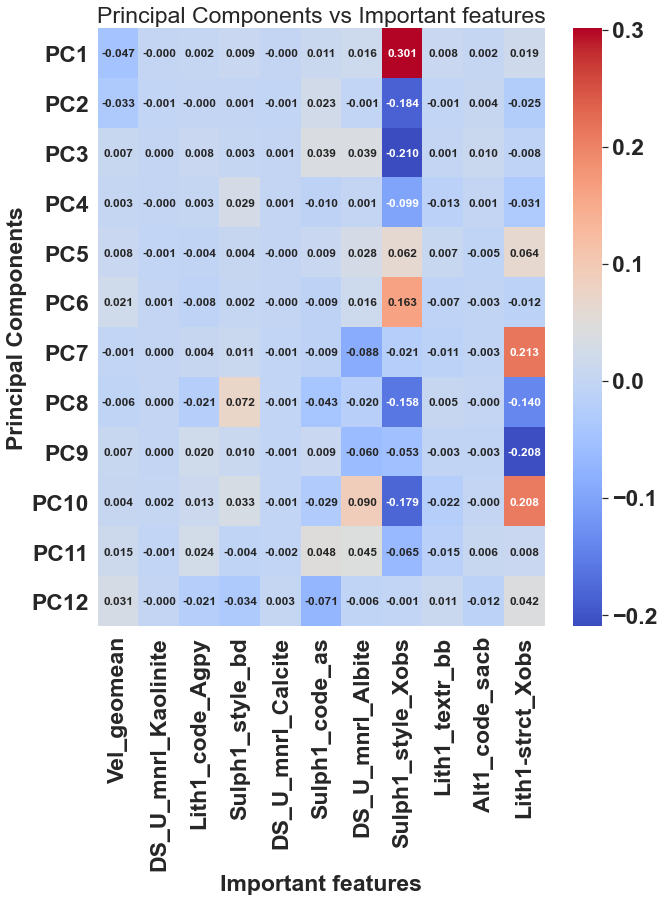

In [297]:
plt.rcParams["figure.figsize"]=(10,11)
plt.rcParams['font.size'] = 16
#bg_color = (0.88,0.85,0.95)
#plt.rcParams['figure.facecolor'] = bg_color
#plt.rcParams['axes.facecolor'] = bg_color
fig, ax = plt.subplots(1)
p = sns.heatmap(df_components_15EIS_reduced,
                cmap='coolwarm',
                annot=True,
                fmt=".3f",
                annot_kws={'size':12},
                ax=ax)
plt.xlabel('Important features')
plt.ylabel('Principal Components')
plt.title('Principal Components vs Important features')
#ax.set_ylim((0,15))
#plt.text(5,12.3,'title' fontsize = 24, color='Black', fontstyle='italic')

In [298]:
#creating correlation matrix for the principal components
corrmat_15EIS_reduced = np.corrcoef(df_components_15EIS_reduced.transpose())

Text(0.5, 1.0, 'Correlation Matrix')

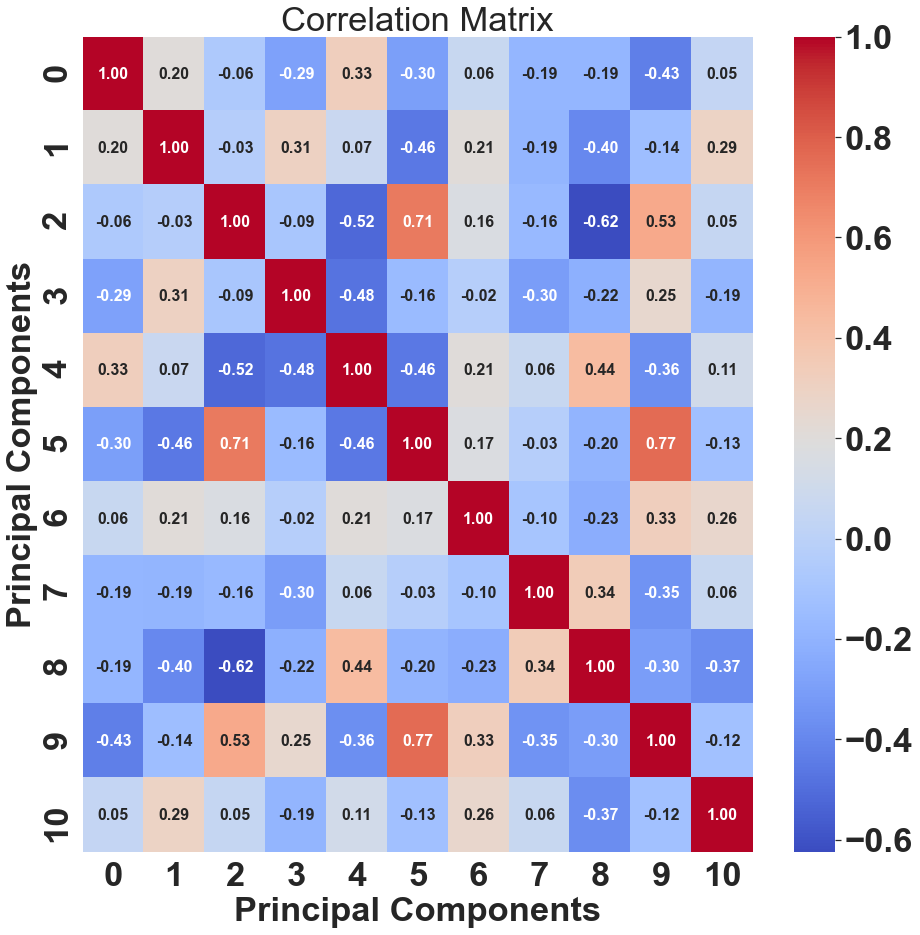

In [299]:
#plotting the correlation matrix
plt.rcParams["figure.figsize"]=(15,15)
plt.rcParams['font.size'] = 24
#bg_color = (0.88,0.85,0.95)
#plt.rcParams['figure.facecolor'] = bg_color
#plt.rcParams['axes.facecolor'] = bg_color
fig, ax = plt.subplots(1)
p = sns.heatmap(corrmat_15EIS_reduced,
                cmap='coolwarm',
                annot=True,
                fmt=".2f",
                annot_kws={'size':16},
                ax=ax)
plt.xlabel('Principal Components')
plt.ylabel('Principal Components')
plt.title('Correlation Matrix')
#ax.set_ylim((0,15))
#plt.text(5,12.3, "Correlation matrix", fontsize = 24, color='Black', fontstyle='italic')

In [300]:
# Covariance Matrix
covmat_15EIS_reduced = np.cov(df_components_15EIS_reduced.transpose())
#print('Covariance Matix',cov_mat_15EIS_reduced)

Text(0.5, 1.0, 'Covariance Matrix')

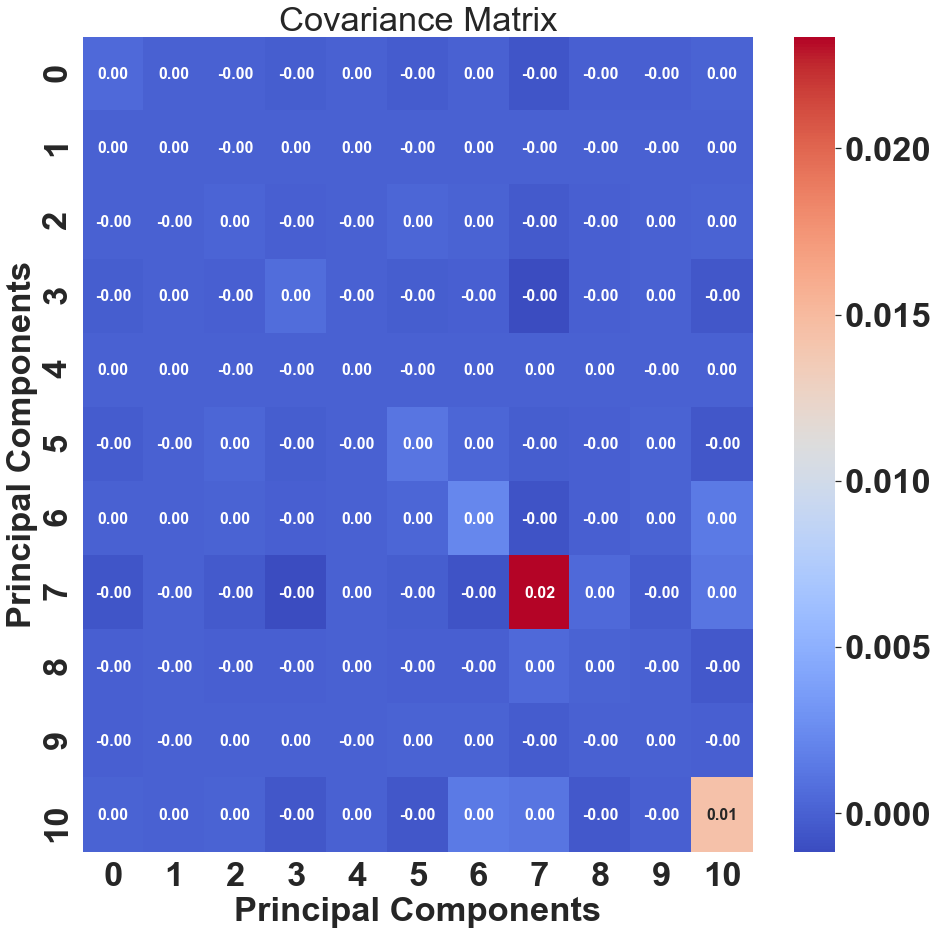

In [301]:
plt.rcParams["figure.figsize"]=(15,15)
plt.rcParams['font.size'] = 24
#bg_color = (0.88,0.85,0.95)
#plt.rcParams['figure.facecolor'] = bg_color
#plt.rcParams['axes.facecolor'] = bg_color
fig, ax = plt.subplots(1)
p = sns.heatmap(covmat_15EIS_reduced,
                cmap='coolwarm',
                annot=True,
                fmt=".2f",
                annot_kws={'size':16},
                ax=ax)
plt.xlabel('Principal Components')
plt.ylabel('Principal Components')
plt.title('Covariance Matrix')
#ax.set_ylim((0,15))
#plt.text(5,12.3, "Covariance matrix", fontsize = 24, color='Black', fontstyle='italic')

# Combine PCA and K-means Clustering

In [302]:
# fitting scaled data to compute principal components
pca_15EIS = PCA(n_components=0.95)
pca_15EIS_out=pca_15EIS.fit(scaled_df_comb_15EIS)

pca_15EIS_new = pca_15EIS.fit_transform(scaled_df_comb_15EIS)          # X_train = pca.fit_transform(data)
print(scaled_df_comb_15EIS.shape)
print(pca_15EIS_new.shape)

(2409, 98)
(2409, 29)


### Kmeans Clustering with PCA

In [303]:
# https://365datascience.com/tutorials/python-tutorials/pca-k-means/
from sklearn.cluster import KMeans

In [304]:
# Fitting K means using the transform data from PCA and assuming 12 clusters 
wcss = []
for i in range(1,12):
    kmeans_pca = KMeans(n_clusters=i, init='k-means++', random_state = 42)
    kmeans_pca.fit(pca_15EIS_new)
    wcss.append(kmeans_pca.inertia_)

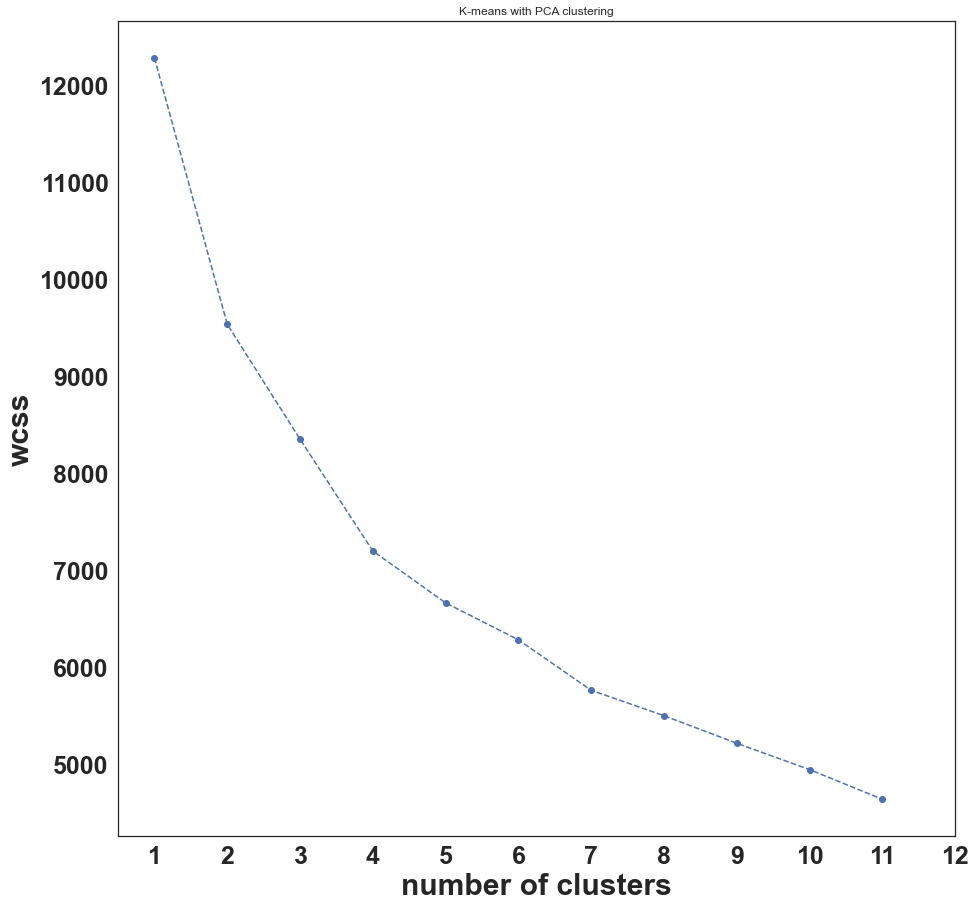

In [703]:
plt.rcParams["figure.figsize"]=(15,15)
#plt.rcParams['figure.facecolor'] = 'none'
plt.rcParams['font.size'] = 24
plt.plot(range(1,12,1),wcss,marker = 'o', linestyle='--',)
plt.xlabel("number of clusters", fontsize=30)
plt.ylabel("wcss", fontsize=30)
plt.xticks(fontsize=25)
plt.yticks(fontsize=25)
plt.xticks(np.arange(1, 13, 1.0))
plt.title("K-means with PCA clustering")
plt.show()

In [306]:
# we choose 4 clusters using the above graph
kmeans_pca = KMeans(n_clusters=4, init='k-means++', random_state = 42)

In [307]:
# fitting data with K-means pca model
kmeans_pca.fit(pca_15EIS_new)

KMeans(n_clusters=4, random_state=42)

In [308]:
# Visualising the results of K-means and PCA clustering
kmeans_cluster_cut = pd.Series((kmeans_pca.labels_).reshape(-1,))
#kmeans_cluster_cut = pd.DataFrame((kmeans_pca.labels_).reshape(-1,))
kmeans_cluster_cut.head()

0    0
1    0
2    0
3    0
4    0
dtype: int32

In [309]:
#display(df_INCpca_15EIS)
#display(kmeans_cluster_cut)

In [310]:
kmeans_cluster_cut = pd.DataFrame(kmeans_cluster_cut)
kmeans_cluster_cut.head()

,0
0,0
1,0
2,0
3,0
4,0


In [311]:
#df_kmeans-pca_cluster = pd.concat([df_INCpca_final_15EIS, kmeans_cluster_cut], axis=1)
#df_kmeans-pca_cluster.columns = ["PC1","PC2","PC3","PC4","PC5","PC6","PC7","PC8","PC9","PC10","PC11","PC12","ClusterID"]
#df_kmeans-pca_cluster.columns = ["PC1","PC2","PC3","PC4","ClusterID"]
#df_kmeans-pca_cluster.sort_values(by=['ClusterID'], inplace=True)
#df_kmeans-pca_cluster.head()
#df_INCpca_15EIS.head()

# Splitting Dataframe according to depth interval (~125m)

In [312]:
print(scaled_df_comb_15EIS.shape)
print(scaled_df_comb_001.shape)
print(scaled_df_comb_002.shape)
print(scaled_df_comb_003.shape)
print(scaled_df_comb_004.shape)

(2409, 98)
(669, 52)
(703, 70)
(905, 69)
(1401, 102)


In [313]:
#df_check_15EIS['Depth_diff']=df_check_15EIS['Depth_m'].diff().fillna(0)
#df_check_15EIS['Depth_diff']

In [314]:
# splitting dataframe every 125m depth interval (~250 rows in dataframe) for Drill Hole 15EIS (Starting depth from surface 495m and end depth 620m)
df_check_15EIS = num_df2_15EIS_fillna.iloc[:250,:]
df_check_15EIS['Depth_diff']=df_check_15EIS['Depth_m'].diff().fillna(0)
df_check_15EIS['Depth_diff'].sum()

124.43482000000006

In [315]:
# splitting dataframe every 125m depth interval (~250 rows in dataframe) for Drill Hole dd001 (Starting depth 57.4m from surface and end depth 182.45m)
df_check_001 = num_df2_001_fillna.iloc[:250,:]
df_check_001['Depth_diff']=df_check_001['Depth_m'].diff().fillna(0)
df_check_001['Depth_diff'].sum()

124.49260199999999

In [316]:
# splitting dataframe every 125m depth interval (~250 rows in dataframe) for Drill Hole dd002 (Starting depth 51.5m from surface and end depth 176.62m)
df_check_002 = num_df2_002_fillna.iloc[:250,:]
df_check_002['Depth_diff']=df_check_002['Depth_m'].diff().fillna(0)
df_check_002['Depth_diff'].sum()

124.495992

In [317]:
# splitting dataframe every 125m depth interval (~250 rows in dataframe) for Drill Hole dd003B (Starting depth 49.34m and end depth 184.37m)
df_check_003 = num_df2_003_fillna.iloc[:250,:]
df_check_003['Depth_diff']=df_check_003['Depth_m'].diff().fillna(0)
df_check_003['Depth_diff'].sum()

124.50984100000005

In [318]:
# splitting dataframe every 125m depth interval (~250 rows in dataframe) for Drill Hole dd004 (Starting depth 0.25m and end depth 125.74m)
df_check_004 = num_df2_004_fillna.iloc[:250,:]
df_check_004['Depth_diff']=df_check_004['Depth_m'].diff().fillna(0)
df_check_004['Depth_diff'].sum()

125.0030964

In [319]:
df_comb_temp1 = scaled_df_comb_15EIS.iloc[:250,:]
df_comb_temp1.head()

,Alt1_code_Xobs,Alt1_code_ab,Alt1_code_ascb_m,Alt1_code_ascb_s,Alt1_code_ascb_w,Alt1_code_bi,Alt1_code_ch,Alt1_code_ep,Alt1_code_he,Alt1_code_hemag,Alt1_code_sacb,Alt1_code_si,Alt1_code_sl,DS_U_mnrl_Albite,DS_U_mnrl_AmphiboleML48,DS_U_mnrl_Andesine,DS_U_mnrl_Calcite,DS_U_mnrl_Chlorite,DS_U_mnrl_Dolomite,DS_U_mnrl_Edenite,DS_U_mnrl_Hornblende,DS_U_mnrl_Kaolinite,DS_U_mnrl_Labradorite,DS_U_mnrl_Oligoclase,DS_U_mnrl_Prehnite,DS_U_mnrl_Quartz,DS_U_mnrl_Siderite,Lith1_code_Aau,Lith1_code_Ab,Lith1_code_Abu,Lith1_code_Ado,Lith1_code_Agp,Lith1_code_Agpf,Lith1_code_Agpq,Lith1_code_Agpy,Lith1_code_Agt,Lith1_code_Aia,Lith1_code_Ait,Lith1_code_Aiu,Lith1_code_Aivc,Lith1_code_Ala,Lith1_code_Aou,Lith1_code_Asb,Lith1_code_Asc,Lith1_code_Xobs,Lith1_grnsz_Xobs,Lith1_grnsz_cg,Lith1_grnsz_fg,Lith1_grnsz_mg,Lith1_strctInt_Xobs,Lith1_strctInt_m,Lith1_strctInt_s,Lith1_strctInt_v,Lith1_strctInt_w,Lith1-strct_Xobs,Lith1-strct_bd,Lith1-strct_bx,Lith1-strct_cc,Lith1-strct_cx,Lith1-strct_fd,Lith1-strct_fo,Lith1-strct_sh,Lith1-strct_vcb,Lith1_textr_Xobs,Lith1_textr_ah,Lith1_textr_bb,Lith1_textr_bd,Lith1_textr_be,Lith1_textr_cc,Lith1_textr_cx,Lith1_textr_cz,Lith1_textr_fr,Lith1_textr_ma,Lith1_textr_po,Lith1_textr_si,Lith1_textr_sp,Lith1_textr_tu,Sulph1_code_Xobs,Sulph1_code_as,Sulph1_code_cp,Sulph1_code_po,Sulph1_code_py,Sulph1_style_Xobs,Sulph1_style_an,Sulph1_style_bd,Sulph1_style_ds,Sulph1_style_eu,Sulph1_style_fg,Sulph1_style_lm,Sulph1_style_su,Felsic_mfc_idx,Felsic_mfc_Rmean,ResDeep,SSD_gcc,Susp_SI,Depth_m,Vel_geomean,Vel_std
0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,1,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,1,0,0,0,1,0,0,0,0,0.510125,0.509152,0.000000,0.763027,0.004504,0.000000,0.937945,0.214843
1,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,1,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,1,0,0,0,1,0,0,0,0,0.569692,0.581917,0.000019,0.737739,0.044752,0.000382,0.937945,0.214843
2,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,1,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,1,0,0,0,1,0,0,0,0,0.629132,0.622406,0.000054,0.738673,0.012007,0.000778,0.665967,0.523274
3,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,1,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,1,0,0,0,1,0,0,0,0,0.633445,0.637410,0.010180,0.737552,0.000000,0.001220,0.665967,0.523274
4,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,1,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,1,0,0,0,1,0,0,0,0,0.686793,0.683484,0.086563,0.775085,0.069683,0.001585,0.746222,0.261088


In [320]:
scaled_df_comb_001.shape

(669, 52)

In [321]:
scaled_df_comb_15EIS_1 = scaled_df_comb_15EIS.iloc[:250,:]
scaled_df_comb_15EIS_2 = scaled_df_comb_15EIS.iloc[251:500,:]
scaled_df_comb_15EIS_3 = scaled_df_comb_15EIS.iloc[501:750,:]
scaled_df_comb_15EIS_4 = scaled_df_comb_15EIS.iloc[751:1000,:]
scaled_df_comb_15EIS_5 = scaled_df_comb_15EIS.iloc[1001:1250,:]
scaled_df_comb_15EIS_6 = scaled_df_comb_15EIS.iloc[1251:1500,:]
scaled_df_comb_15EIS_7 = scaled_df_comb_15EIS.iloc[1501:1750,:]
scaled_df_comb_15EIS_8 = scaled_df_comb_15EIS.iloc[1751:2000,:]
scaled_df_comb_15EIS_9 = scaled_df_comb_15EIS.iloc[2001:2250,:]
scaled_df_comb_15EIS_10 = scaled_df_comb_15EIS.iloc[2251:,:]

In [322]:
# Splitted every ~125m for Drill Hole dd001
scaled_df_comb_001_1 = scaled_df_comb_001.iloc[:250,:]
scaled_df_comb_001_2 = scaled_df_comb_001.iloc[251:500,:]
scaled_df_comb_001_3 = scaled_df_comb_001.iloc[501:750,:]

In [323]:
# Splitted every ~125m for Drill Hole dd002
scaled_df_comb_002_1 = scaled_df_comb_002.iloc[:250,:]
scaled_df_comb_002_2 = scaled_df_comb_002.iloc[251:500,:]
scaled_df_comb_002_3 = scaled_df_comb_002.iloc[501:750,:]

In [324]:
# Splitted every ~125m for Drill Hole dd003B
scaled_df_comb_003_1 = scaled_df_comb_003.iloc[:250,:]
scaled_df_comb_003_2 = scaled_df_comb_003.iloc[251:500,:]
scaled_df_comb_003_3 = scaled_df_comb_003.iloc[501:750,:]
scaled_df_comb_003_4 = scaled_df_comb_003.iloc[751:1000,:]

In [325]:
# Splitted every ~125m for Drill Hole dd004
scaled_df_comb_004_1 = scaled_df_comb_004.iloc[:250,:]
scaled_df_comb_004_2 = scaled_df_comb_004.iloc[251:500,:]
scaled_df_comb_004_3 = scaled_df_comb_004.iloc[501:750,:]
scaled_df_comb_004_4 = scaled_df_comb_004.iloc[751:1000,:]
scaled_df_comb_004_5 = scaled_df_comb_004.iloc[1001:1250,:]
scaled_df_comb_004_6 = scaled_df_comb_004.iloc[1251:1500,:]

In [326]:
#print(scaled_df_comb_15EIS_1.shape)
print(scaled_df_comb_001_1.shape)
print(scaled_df_comb_002_1.shape)
print(scaled_df_comb_003_1.shape)
print(scaled_df_comb_004_1.shape)

(250, 52)
(250, 70)
(250, 69)
(250, 102)


In [327]:
from pca import pca
# Initialize to reduce the data up to the number of componentes that explains 95% of the variance.
model_1 = pca(n_components=10)
# Fit transform
results_1 = model_1.fit_transform(scaled_df_comb_15EIS_1)

[pca] >Processing dataframe..
[pca] >The PCA reduction is performed on the [98] columns of the input dataframe.
[pca] >Fitting using PCA..
[pca] >Computing loadings and PCs..
[pca] >Computing explained variance..
[pca] >Outlier detection using Hotelling T2 test with alpha=[0.05] and n_components=[5]
[pca] >Outlier detection using SPE/DmodX with n_std=[2]


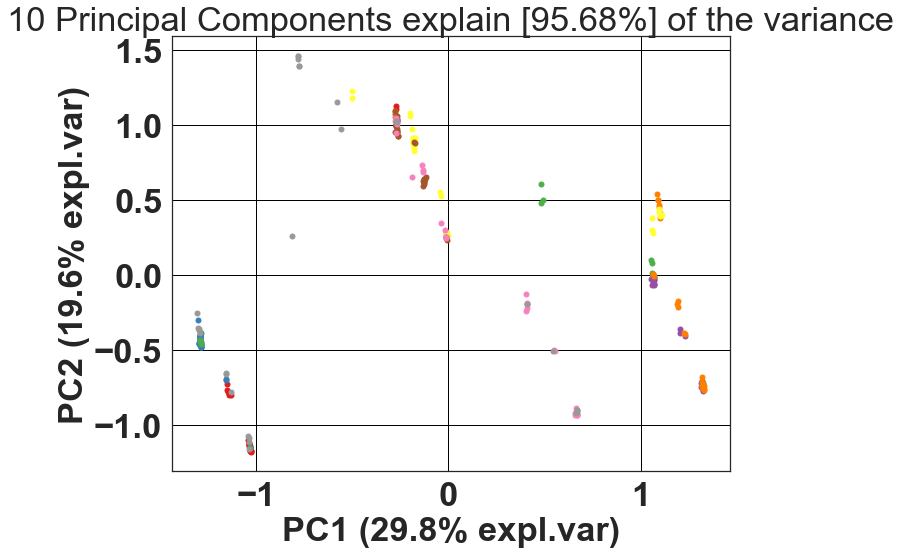

In [328]:
# Make biplot with the number of features
fig, ax = model_1.scatter(legend=False, label=False)

## The important features are the ones that influence more the components and thus, have a large absolute ## value/coefficient/loading on the component.
#### Get the most important feature name on the PCs

In [329]:
pca1_15EIS=PCA(n_components=10)
pca2_15EIS=PCA(n_components=10)
pca3_15EIS=PCA(n_components=10)
pca4_15EIS=PCA(n_components=10)
pca5_15EIS=PCA(n_components=10)
pca6_15EIS=PCA(n_components=10)
pca7_15EIS=PCA(n_components=10)
pca8_15EIS=PCA(n_components=10)
pca9_15EIS=PCA(n_components=10)
pca10_15EIS=PCA(n_components=10)

In [330]:
X_pc1_15EIS = pca1_15EIS.fit_transform(scaled_df_comb_15EIS_1)
X_pc2_15EIS = pca2_15EIS.fit_transform(scaled_df_comb_15EIS_2)
X_pc3_15EIS = pca3_15EIS.fit_transform(scaled_df_comb_15EIS_3)
X_pc4_15EIS = pca4_15EIS.fit_transform(scaled_df_comb_15EIS_4)
X_pc5_15EIS = pca5_15EIS.fit_transform(scaled_df_comb_15EIS_5)
X_pc6_15EIS = pca6_15EIS.fit_transform(scaled_df_comb_15EIS_6)
X_pc7_15EIS = pca7_15EIS.fit_transform(scaled_df_comb_15EIS_7)
X_pc8_15EIS = pca8_15EIS.fit_transform(scaled_df_comb_15EIS_8)
X_pc9_15EIS = pca9_15EIS.fit_transform(scaled_df_comb_15EIS_9)
X_pc10_15EIS = pca10_15EIS.fit_transform(scaled_df_comb_15EIS_10)

In [331]:
# https://www.geeksforgeeks.org/implementing-agglomerative-clustering-using-sklearn/
# Dimension reduction
X_pc1_15EIS = pca1_15EIS.fit_transform(scaled_df_comb_15EIS_1) 
X_pc1_15EIS = pd.DataFrame(X_pc1_15EIS) 
X_pc1_15EIS.columns = ['P1', 'P2','P3', 'P4','P5','P6', 'P7','P8', 'P9','P10'] 

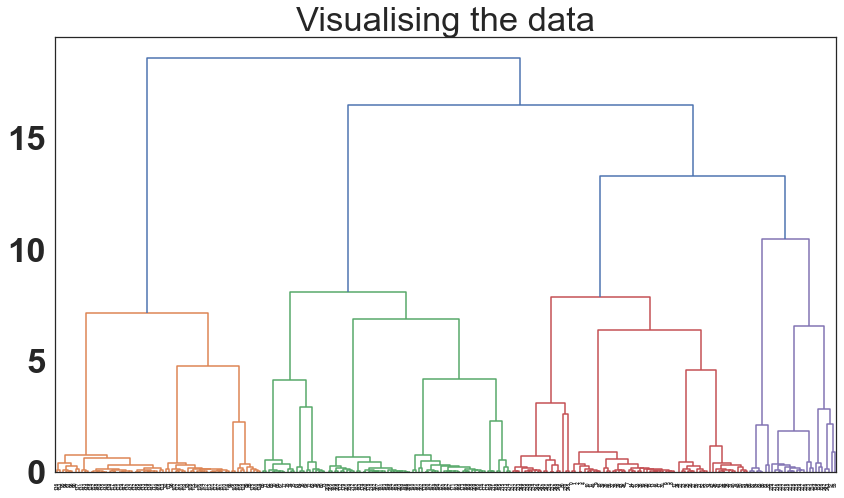

In [332]:
plt.figure(figsize =(14, 8)) 
plt.title('Visualising the data') 
Dendrogram = sch.dendrogram((sch.linkage(X_pc1_15EIS, method ='ward'))) 

No handles with labels found to put in legend.


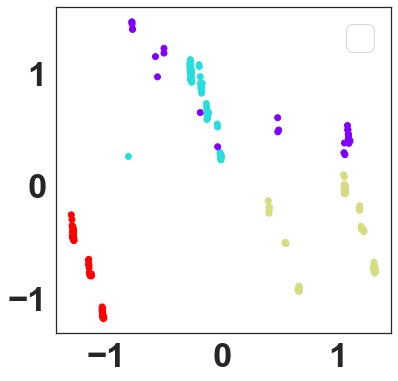

In [333]:
ac5 = AgglomerativeClustering(n_clusters = 4) 

# Visualizing the clustering 
plt.figure(figsize =(6, 6)) 
plt.scatter(X_pc1_15EIS['P1'], X_pc1_15EIS['P2'], 
		c = ac5.fit_predict(X_pc1_15EIS), cmap ='rainbow') 
plt.legend()
plt.show() 

In [334]:
print("pca1.components\n",pca1_15EIS.components_) # principal components for depth interval 0-125m (starting depth 495m)
print("pca1.components\n",pca2_15EIS.components_) # principal components for depth 126-250m
print("pca3.components\n",pca3_15EIS.components_) # principal components for depth 251-300m
print("pca4.components\n",pca4_15EIS.components_) # principal components for depth 301-350m
print("pca5.components\n",pca5_15EIS.components_) # principal components for depth 351-400m
print("pca6.components\n",pca6_15EIS.components_) # principal components for depth 401-450m
print("pca7.components\n",pca7_15EIS.components_) # principal components for depth 451-500m
print("pca8.components\n",pca8_15EIS.components_) # principal components for depth 501-750m
print("pca9.components\n",pca9_15EIS.components_) # principal components for depth 751-1000m
print("pca10.components\n",pca10_15EIS.components_) # principal components for depth 1001-1250m

pca1.components
 [[-1.34101175e-18 -2.36947607e-02  5.55111512e-17  1.11022302e-16
  -0.00000000e+00  1.38777878e-17  2.36947607e-02 -0.00000000e+00
  -0.00000000e+00 -0.00000000e+00 -0.00000000e+00 -0.00000000e+00
   1.03397577e-25  4.76293613e-02 -0.00000000e+00 -0.00000000e+00
   5.01471391e-03  9.97525321e-03 -0.00000000e+00  9.98703949e-02
  -1.50870203e-02 -5.41592403e-04  6.69595025e-03 -1.77001876e-04
  -0.00000000e+00 -1.53380059e-01 -0.00000000e+00 -1.06802273e-03
  -0.00000000e+00  2.95033293e-02 -0.00000000e+00 -4.74054586e-03
  -0.00000000e+00 -0.00000000e+00 -2.36947607e-02 -0.00000000e+00
  -0.00000000e+00 -0.00000000e+00 -0.00000000e+00 -0.00000000e+00
  -0.00000000e+00 -0.00000000e+00 -0.00000000e+00 -0.00000000e+00
  -0.00000000e+00 -0.00000000e+00 -0.00000000e+00 -7.28467967e-02
   7.28467967e-02 -0.00000000e+00  3.22701045e-02  3.32954302e-01
  -5.17902383e-02 -3.13434168e-01 -0.00000000e+00 -0.00000000e+00
  -0.00000000e+00 -0.00000000e+00 -0.00000000e+00 -0.000000

In [335]:
df_15EIS_pca1_components=pd.DataFrame(data = pca1_15EIS.components_.T, columns = ['15EISPC1','15EISPC2','15EISPC3','15EISPC4','15EISPC5','15EISPC6','15EISPC7','15EISPC8','15EISPC9','15EISPC10'])
df_15EIS_pca1_components

,15EISPC1,15EISPC2,15EISPC3,15EISPC4,15EISPC5,15EISPC6,15EISPC7,15EISPC8,15EISPC9,15EISPC10
0,-1.341012e-18,8.364038e-18,-7.401549e-18,-2.083371e-18,-9.678117e-19,-6.228517e-18,-4.723764e-18,1.267186e-17,5.951257e-19,-4.587166e-17
1,-2.369476e-02,6.646114e-02,1.153378e-01,6.254712e-02,2.491688e-01,7.741916e-02,-1.562407e-01,3.477651e-02,1.118800e-01,1.960102e-02
2,5.551115e-17,-5.551115e-17,-5.551115e-17,8.326673e-17,1.526557e-16,-1.387779e-16,-3.885781e-16,0.000000e+00,-1.162265e-16,2.220446e-16
3,1.110223e-16,4.163336e-17,5.551115e-17,-2.636780e-16,1.491862e-16,1.214306e-16,2.983724e-16,-1.249001e-16,1.396452e-16,-2.220446e-16
4,-0.000000e+00,5.551115e-17,1.110223e-16,5.551115e-17,-1.249001e-16,-0.000000e+00,1.387779e-16,-5.551115e-17,2.605880e-16,-3.330669e-16
5,1.387779e-17,0.000000e+00,0.000000e+00,-1.387779e-17,-1.387779e-17,-0.000000e+00,5.551115e-17,1.110223e-16,2.454634e-16,-6.938894e-17
6,2.369476e-02,-6.646114e-02,-1.153378e-01,-6.254712e-02,-2.491688e-01,-7.741916e-02,1.562407e-01,-3.477651e-02,-1.118800e-01,-1.960102e-02
7,-0.000000e+00,-1.734723e-18,-1.387779e-17,1.110223e-16,-1.387779e-17,-1.665335e-16,-5.551115e-17,-3.053113e-16,-9.194034e-17,-1.665335e-16
8,-0.000000e+00,0.000000e+00,0.000000e+00,2.775558e-17,-1.110223e-16,-5.551115e-17,1.387779e-16,0.000000e+00,3.339343e-17,-1.665335e-16
9,-0.000000e+00,-2.710505e-20,0.000000e+00,0.000000e+00,-2.220446e-16,5.551115e-17,-5.551115e-17,1.665335e-16,-1.075529e-16,2.810252e-16


In [336]:
x_pca1_15EIS = pca1_15EIS.transform(scaled_df_comb_15EIS_1)
x_pca2_15EIS = pca2_15EIS.transform(scaled_df_comb_15EIS_2)
x_pca3_15EIS = pca3_15EIS.transform(scaled_df_comb_15EIS_3)
x_pca4_15EIS = pca4_15EIS.transform(scaled_df_comb_15EIS_4)
x_pca5_15EIS = pca5_15EIS.transform(scaled_df_comb_15EIS_5)
x_pca6_15EIS = pca6_15EIS.transform(scaled_df_comb_15EIS_6)
x_pca7_15EIS = pca7_15EIS.transform(scaled_df_comb_15EIS_7)
x_pca8_15EIS = pca8_15EIS.transform(scaled_df_comb_15EIS_8)
x_pca9_15EIS = pca9_15EIS.transform(scaled_df_comb_15EIS_9)
x_pca10_15EIS = pca10_15EIS.transform(scaled_df_comb_15EIS_10)

In [337]:
x_pca1_15EIS.shape

(250, 10)

In [338]:
print("first_component\n",x_pca1_15EIS[:,1])
print("second_component\n",x_pca1_15EIS[:,2])

first_component
 [ 1.12461600e+00  1.10911393e+00  1.09629893e+00  1.09147345e+00
  1.06202792e+00  1.03326140e+00  1.04945686e+00  1.02469207e+00
  1.02512605e+00  1.01788495e+00  1.02524561e+00  1.04085195e+00
  1.02299610e+00  1.02325433e+00  9.91378827e-01  1.02056231e+00
  1.02056912e+00  1.01074041e+00  1.03437274e+00  1.07686884e+00
  1.05347803e+00  2.64124324e-01  2.86361575e-01  2.85393575e-01
  2.64014361e-01  2.33122755e-01  2.49090610e-01  2.51096737e-01
  6.32588935e-01  9.51070882e-01  1.00271788e+00  6.40367023e-01
  6.18628720e-01  9.95867911e-01  6.52181726e-01  9.55721705e-01
  1.00073830e+00  9.55465934e-01  9.62553159e-01  9.54301523e-01
  6.42148662e-01  6.07284496e-01  5.92577607e-01  9.27132969e-01
  6.17595828e-01  6.26119043e-01  9.24248240e-01  9.74754769e-01
  6.38445213e-01  1.00600922e+00  7.33857555e-01  7.03843838e-01
  2.53698423e-01  2.46969541e-01  6.85169977e-01  2.98311824e-01
  9.50054940e-01  6.54173309e-01  3.50160432e-01 -1.90068652e-01
 -1.9075

In [339]:
df_x_pca1_15EIS = pd.DataFrame(x_pca1_15EIS)
#sns.pairplot(df_x_pca1_15EIS)
#plt.tight_layout()
#plt.show()

In [340]:
#scaled_df_comb_15EIS_1.head()

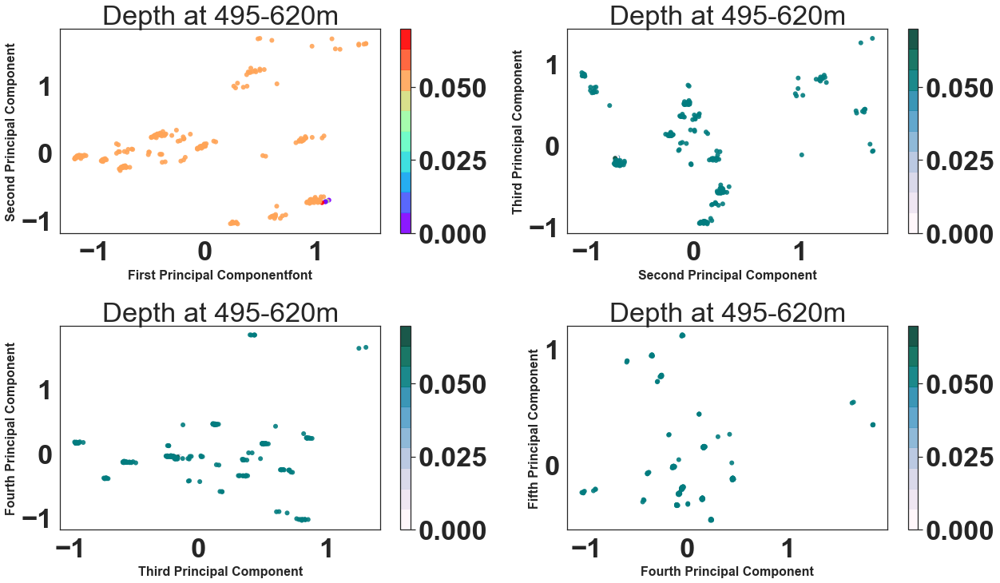

In [341]:
plt.figure(figsize=(18,15))
plt.subplot(3,2,1)
plt.scatter(x_pca1_15EIS[:, 1], x_pca1_15EIS[:, 2],
            c=(scaled_df_comb_15EIS_1['Susp_SI']), edgecolor='none', alpha=0.9,
            cmap=plt.cm.get_cmap('rainbow', 10))
plt.xlabel('First Principal Componentfont',size=16)
plt.ylabel('Second Principal Component',size=16)
plt.title('Depth at 495-620m')
plt.colorbar();

plt.subplot(3,2,2)
plt.scatter(x_pca1_15EIS[:, 2], x_pca1_15EIS[:, 3],
            c=scaled_df_comb_15EIS_1['Susp_SI'], edgecolor='none', alpha=0.9,
            cmap=plt.cm.get_cmap('PuBuGn', 10))
plt.xlabel('Second Principal Component',size=16)
plt.ylabel('Third Principal Component',size=16)
plt.title('Depth at 495-620m')
plt.colorbar();


plt.subplot(3,2,3)
plt.scatter(x_pca1_15EIS[:, 3], x_pca1_15EIS[:, 4],
            c=scaled_df_comb_15EIS_1['Susp_SI'], edgecolor='none', alpha=0.9,
            cmap=plt.cm.get_cmap('PuBuGn', 10))
plt.xlabel('Third Principal Component',size=16)
plt.ylabel('Fourth Principal Component',size=16)
plt.title('Depth at 495-620m')
plt.colorbar();

plt.subplot(3,2,4)
plt.scatter(x_pca1_15EIS[:, 4], x_pca1_15EIS[:, 5],
            c=scaled_df_comb_15EIS_1['Susp_SI'], edgecolor='none', alpha=0.9,
            cmap=plt.cm.get_cmap('PuBuGn', 10))
plt.xlabel('Fourth Principal Component',size=16)
plt.ylabel('Fifth Principal Component',size=16)
plt.title('Depth at 495-620m')
plt.colorbar();
plt.tight_layout()
plt.show()

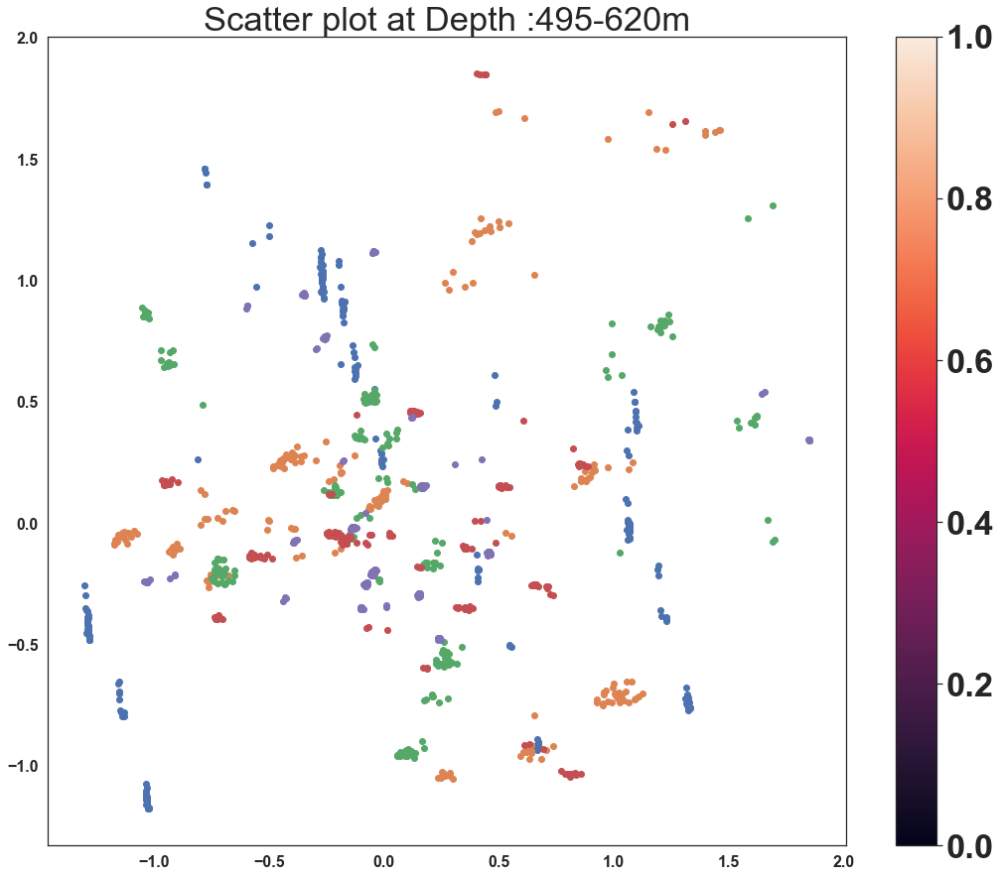

In [342]:
plt.figure(figsize=(18,15))
plt.scatter(x_pca1_15EIS[:, 0], x_pca1_15EIS[:, 1]),
plt.scatter(x_pca1_15EIS[:, 1], x_pca1_15EIS[:, 2]),
plt.scatter(x_pca1_15EIS[:, 2], x_pca1_15EIS[:, 3]),
plt.scatter(x_pca1_15EIS[:, 3], x_pca1_15EIS[:, 4]),
plt.scatter(x_pca1_15EIS[:, 4], x_pca1_15EIS[:, 5]),
#            c= (scaled_df_comb_1['Au_ppm']*1e17 ), edgecolor='none', alpha=0.9,
#            cmap=plt.cm.get_cmap('rainbow', 10)),
#plt.xlabel('First Principal Component')
#plt.ylabel('Second Principal Component')
#plt.colorbar()
plt.title('Scatter plot at Depth :495-620m')
plt.xticks(fontsize=16)
plt.yticks(fontsize=16)
plt.colorbar()
plt.show()

###### scatter plot colorbar <https://www.w3schools.com/python/matplotlib_scatter.asp>

In [343]:
# Dump components relations with features:
pca1_features_dump_15EIS=pd.DataFrame(pca1_15EIS.components_,columns=scaled_df_comb_15EIS_1.columns,index = ['PC1-1','PC1-2','PC1-3','PC1-4','PC1-5','PC1-6','PC1-7','PC1-8','PC1-9','PC1-10'])

In [344]:
pca1_features_dump_15EIS.head()

,Alt1_code_Xobs,Alt1_code_ab,Alt1_code_ascb_m,Alt1_code_ascb_s,Alt1_code_ascb_w,Alt1_code_bi,Alt1_code_ch,Alt1_code_ep,Alt1_code_he,Alt1_code_hemag,Alt1_code_sacb,Alt1_code_si,Alt1_code_sl,DS_U_mnrl_Albite,DS_U_mnrl_AmphiboleML48,DS_U_mnrl_Andesine,DS_U_mnrl_Calcite,DS_U_mnrl_Chlorite,DS_U_mnrl_Dolomite,DS_U_mnrl_Edenite,DS_U_mnrl_Hornblende,DS_U_mnrl_Kaolinite,DS_U_mnrl_Labradorite,DS_U_mnrl_Oligoclase,DS_U_mnrl_Prehnite,DS_U_mnrl_Quartz,DS_U_mnrl_Siderite,Lith1_code_Aau,Lith1_code_Ab,Lith1_code_Abu,Lith1_code_Ado,Lith1_code_Agp,Lith1_code_Agpf,Lith1_code_Agpq,Lith1_code_Agpy,Lith1_code_Agt,Lith1_code_Aia,Lith1_code_Ait,Lith1_code_Aiu,Lith1_code_Aivc,Lith1_code_Ala,Lith1_code_Aou,Lith1_code_Asb,Lith1_code_Asc,Lith1_code_Xobs,Lith1_grnsz_Xobs,Lith1_grnsz_cg,Lith1_grnsz_fg,Lith1_grnsz_mg,Lith1_strctInt_Xobs,Lith1_strctInt_m,Lith1_strctInt_s,Lith1_strctInt_v,Lith1_strctInt_w,Lith1-strct_Xobs,Lith1-strct_bd,Lith1-strct_bx,Lith1-strct_cc,Lith1-strct_cx,Lith1-strct_fd,Lith1-strct_fo,Lith1-strct_sh,Lith1-strct_vcb,Lith1_textr_Xobs,Lith1_textr_ah,Lith1_textr_bb,Lith1_textr_bd,Lith1_textr_be,Lith1_textr_cc,Lith1_textr_cx,Lith1_textr_cz,Lith1_textr_fr,Lith1_textr_ma,Lith1_textr_po,Lith1_textr_si,Lith1_textr_sp,Lith1_textr_tu,Sulph1_code_Xobs,Sulph1_code_as,Sulph1_code_cp,Sulph1_code_po,Sulph1_code_py,Sulph1_style_Xobs,Sulph1_style_an,Sulph1_style_bd,Sulph1_style_ds,Sulph1_style_eu,Sulph1_style_fg,Sulph1_style_lm,Sulph1_style_su,Felsic_mfc_idx,Felsic_mfc_Rmean,ResDeep,SSD_gcc,Susp_SI,Depth_m,Vel_geomean,Vel_std
PC1-1,-1.341012e-18,-0.023695,5.551115e-17,1.110223e-16,-0.000000e+00,1.387779e-17,0.023695,-0.000000e+00,-0.000000e+00,-0.000000e+00,-0.000000e+00,-0.000000e+00,1.033976e-25,0.047629,-0.000000e+00,-0.000000e+00,0.005015,0.009975,-0.000000e+00,0.099870,-0.015087,-0.000542,0.006696,-0.000177,-0.000000e+00,-0.153380,-0.000000e+00,-0.001068,-0.0,0.029503,-0.0,-0.004741,-0.0,-0.0,-0.023695,-0.0,-0.0,-0.0,-0.0,-0.0,-0.0,-0.0,-0.0,-0.0,-0.0,-0.0,-0.0,-0.072847,0.072847,-0.0,0.032270,0.332954,-0.051790,-0.313434,-0.0,-0.0,-0.0,-0.0,-0.0,-0.0,-0.0,-0.468405,0.468405,-0.0,-0.372985,-0.0,-0.0,-0.0,-0.0,-0.0,-0.0,-0.0,0.395627,-0.022643,-0.0,-0.0,-0.0,-0.0,-0.0,-0.0,-0.027517,0.027517,-0.0,-0.0,-0.0,-0.0,-0.0,-0.0,-0.0,-0.0,0.014159,0.014169,0.020074,-0.000166,0.000164,0.012562,0.003489,-0.019302
PC1-2,8.364038e-18,0.066461,-5.551115e-17,4.163336e-17,5.551115e-17,0.000000e+00,-0.066461,-1.734723e-18,0.000000e+00,-2.710505e-20,3.388132e-21,2.117582e-22,6.617445e-24,0.052279,0.000000e+00,0.000000e+00,0.002006,0.004878,0.000000e+00,-0.367606,0.001428,0.004674,-0.019834,0.002509,0.000000e+00,0.319665,0.000000e+00,0.007197,0.0,-0.090916,0.0,0.017258,0.0,0.0,0.066461,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,-0.077909,0.077909,0.0,0.251581,-0.155583,0.326332,-0.422331,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.202116,-0.202116,0.0,-0.327653,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.225340,0.102313,0.0,0.0,0.0,0.0,0.0,0.0,0.068349,-0.068349,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,-0.125403,-0.125502,-0.243055,-0.045413,-0.001011,-0.008098,-0.020871,-0.019242
PC1-3,-7.401549e-18,0.115338,-5.551115e-17,5.551115e-17,1.110223e-16,0.000000e+00,-0.115338,-1.387779e-17,0.000000e+00,0.000000e+00,1.084202e-19,-1.355253e-20,0.000000e+00,0.178946,0.000000e+00,0.000000e+00,0.009799,0.020575,0.000000e+00,-0.189465,-0.119725,-0.008052,0.001904,0.009902,0.000000e+00,0.096117,0.000000e+00,0.020314,0.0,-0.166967,0.0,0.031315,0.0,0.0,0.115338,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,-0.269040,0.269040,0.0,0.406303,-0.020377,-0.474611,0.088685,0.0,0.0,0.0,0.0,0.0,0.0,0.0,-0.179865,0.179865,0.0,0.095609,0.0,0.0,0.0,0.0,0.0,0.0,0.0,-0.314033,0.218424,0.0,0.0,0.0,0.0,0.0,0.0,0.125407,-0.125407,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,-0.128911,-0.128905,0.021961,-0.088349,0.000995,0.025349,-0.035046,-0.015571
PC1-4,-2.083371e-18,0.062547,8.326673e-17,-2.636780e-16,5.551115e-17,-1.387779e-17,-0.062547,1.110223e-16,2.775558e-17,0.000000e+00,-3.469447e-18,0.000000e+00,0.000000e+00,0.164397,0.000000e+

In [345]:
pca1_features_transp_15EIS=pca1_features_dump_15EIS.T
pca1_features_transp_15EIS.head()

,PC1-1,PC1-2,PC1-3,PC1-4,PC1-5,PC1-6,PC1-7,PC1-8,PC1-9,PC1-10
Alt1_code_Xobs,-1.341012e-18,8.364038e-18,-7.401549e-18,-2.083371e-18,-9.678117e-19,-6.228517e-18,-4.723764e-18,1.267186e-17,5.951257e-19,-4.587166e-17
Alt1_code_ab,-2.369476e-02,6.646114e-02,1.153378e-01,6.254712e-02,2.491688e-01,7.741916e-02,-1.562407e-01,3.477651e-02,1.118800e-01,1.960102e-02
Alt1_code_ascb_m,5.551115e-17,-5.551115e-17,-5.551115e-17,8.326673e-17,1.526557e-16,-1.387779e-16,-3.885781e-16,0.000000e+00,-1.162265e-16,2.220446e-16
Alt1_code_ascb_s,1.110223e-16,4.163336e-17,5.551115e-17,-2.636780e-16,1.491862e-16,1.214306e-16,2.983724e-16,-1.249001e-16,1.396452e-16,-2.220446e-16
Alt1_code_ascb_w,-0.000000e+00,5.551115e-17,1.110223e-16,5.551115e-17,-1.249001e-16,-0.000000e+00,1.387779e-16,-5.551115e-17,2.605880e-16,-3.330669e-16


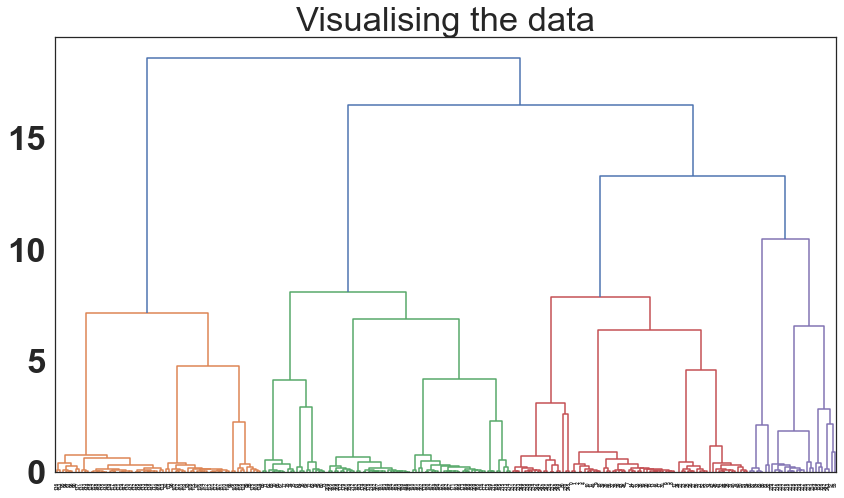

In [346]:
import scipy
plt.figure(figsize =(14, 8)) 
plt.title('Visualising the data') 
Dendrogram = scipy.cluster.hierarchy.dendrogram((scipy.cluster.hierarchy.linkage(x_pca1_15EIS, method ='ward')))

#### The important features are the ones that influence more the components and thus, have a large absolute value/coefficient/loading on the component.
##### Get the most important feature name on the PCs:

In [732]:
import pandas as pd
import numpy as np
np.random.seed(0)
# 2409 samples with 104 features
train_features_15EIS = np.random.rand(2409, 103)

model_15EIS = PCA(n_components=10).fit(train_features_15EIS)
X_pc_15EIS = model_15EIS.transform(train_features_15EIS)

# number of components
n_pcs_15EIS= model_15EIS.components_.shape[0]

# get the index of the most important feature on EACH component i.e. largest absolute value
# using LIST COMPREHENSION HERE
most_important_15EIS = [np.abs(model_15EIS.components_[i]).argmax() for i in range(n_pcs_15EIS)]

initial_feature_names_15EIS = ['Alt1_code_Xobs', 'Alt1_code_ab', 'Alt1_code_ascb_m',
       'Alt1_code_ascb_s', 'Alt1_code_ascb_w', 'Alt1_code_bi', 'Alt1_code_ch',
       'Alt1_code_ep', 'Alt1_code_he', 'Alt1_code_hemag', 'Alt1_code_sacb',
       'Alt1_code_si', 'Alt1_code_sl', 'DS_U_grp_AMPHIBOLE',
       'DS_U_grp_CARBONATE', 'DS_U_grp_CHLORITE', 'DS_U_grp_PLAGIOCLASE',
       'DS_U_grp_SILICA', 'DS_U_mnrl_Albite', 'DS_U_mnrl_AmphiboleML48',
       'DS_U_mnrl_Andesine', 'DS_U_mnrl_Calcite', 'DS_U_mnrl_Chlorite',
       'DS_U_mnrl_Dolomite', 'DS_U_mnrl_Edenite', 'DS_U_mnrl_Hornblende',
       'DS_U_mnrl_Kaolinite', 'DS_U_mnrl_Labradorite', 'DS_U_mnrl_Oligoclase',
       'DS_U_mnrl_Prehnite', 'DS_U_mnrl_Quartz', 'DS_U_mnrl_Siderite',
       'Lith1_code_Aau', 'Lith1_code_Ab', 'Lith1_code_Abu', 'Lith1_code_Ado',
       'Lith1_code_Agp', 'Lith1_code_Agpf', 'Lith1_code_Agpq',
       'Lith1_code_Agpy', 'Lith1_code_Agt', 'Lith1_code_Aia', 'Lith1_code_Ait',
       'Lith1_code_Aiu', 'Lith1_code_Aivc', 'Lith1_code_Ala', 'Lith1_code_Aou',
       'Lith1_code_Asb', 'Lith1_code_Asc', 'Lith1_code_Xobs',
       'Lith1_grnsz_Xobs', 'Lith1_grnsz_cg', 'Lith1_grnsz_fg',
       'Lith1_grnsz_mg', 'Lith1_strctInt_Xobs', 'Lith1_strctInt_m',
       'Lith1_strctInt_s', 'Lith1_strctInt_v', 'Lith1_strctInt_w',
       'Lith1-strct_Xobs', 'Lith1-strct_bd', 'Lith1-strct_bx',
       'Lith1-strct_cc', 'Lith1-strct_cx', 'Lith1-strct_fd', 'Lith1-strct_fo',
       'Lith1-strct_sh', 'Lith1-strct_vcb', 'Lith1_textr_Xobs',
       'Lith1_textr_ah', 'Lith1_textr_bb', 'Lith1_textr_bd', 'Lith1_textr_be',
       'Lith1_textr_cc', 'Lith1_textr_cx', 'Lith1_textr_cz', 'Lith1_textr_fr',
       'Lith1_textr_ma', 'Lith1_textr_po', 'Lith1_textr_si', 'Lith1_textr_sp',
       'Lith1_textr_tu', 'Sulph1_code_Xobs', 'Sulph1_code_as',
       'Sulph1_code_cp', 'Sulph1_code_po', 'Sulph1_code_py',
       'Sulph1_style_Xobs', 'Sulph1_style_an', 'Sulph1_style_bd',
       'Sulph1_style_ds', 'Sulph1_style_eu', 'Sulph1_style_fg',
       'Sulph1_style_lm', 'Sulph1_style_su','Felsic_mfc_idx', 'Felsic_mfc_Rmean', 'ResDeep',
       'SSD_gcc', 'Susp_SI', 'Depth_m', 'Vel_geomean', 'Vel_std']

# get the names
most_important_names_15EIS = [initial_feature_names_15EIS[most_important_15EIS[i]] for i in range(n_pcs_15EIS)]

# using LIST COMPREHENSION HERE AGAIN
dic_15EIS = {'PC{}'.format(i+1): most_important_names_15EIS[i] for i in range(n_pcs_15EIS)}

# build the dataframe
df_imp_features_15EIS = pd.DataFrame((dic_15EIS.items()))

df_imp_features_15EIS

,0,1
0,PC1,Lith1-strct_fd
1,PC2,DS_U_mnrl_Albite
2,PC3,Lith1_code_Asc
3,PC4,Lith1_strctInt_Xobs
4,PC5,Lith1_code_Abu
5,PC6,Vel_geomean
6,PC7,Lith1_code_Aiu
7,PC8,Lith1_code_Aou
8,PC9,Lith1_code_Asb
9,PC10,Sulph1_style_an


In [731]:
len(initial_feature_names_15EIS)

103

In [348]:
#most_important_names

In [710]:
# Dump components relations with features:
df_components_features1_15EIS=pd.DataFrame(pca1_15EIS.components_,columns=scaled_df_comb_15EIS_1.columns,index = ['PC-1','PC-2','PC-3','PC-4','PC-5','PC-6','PC-7','PC-8','PC-9','PC-10'])

In [711]:
# Writing Principal compenents as columns
df_components1_15EIS = df_components_features1_15EIS.T

In [712]:
# Sorting Principal components in descending order 
df_components1_15EIS = df_components1_15EIS.apply(lambda x: x.sort_values().values)
df_components1_15EIS.head()

,PC-1,PC-2,PC-3,PC-4,PC-5,PC-6,PC-7,PC-8,PC-9,PC-10
Alt1_code_Xobs,-0.468405,-0.422331,-0.474611,-0.724536,-0.288755,-0.504335,-0.486402,-0.573583,-0.304480,-0.254035
Alt1_code_ab,-0.372985,-0.367606,-0.314033,-0.259839,-0.266747,-0.233643,-0.243243,-0.282119,-0.292131,-0.169380
Alt1_code_ascb_m,-0.313434,-0.327653,-0.269040,-0.160548,-0.255281,-0.129182,-0.242999,-0.241797,-0.229855,-0.166682
Alt1_code_ascb_s,-0.153380,-0.243055,-0.189465,-0.158718,-0.249169,-0.124828,-0.223237,-0.209956,-0.201419,-0.165079
Alt1_code_ascb_w,-0.072847,-0.202116,-0.179865,-0.131208,-0.206947,-0.084100,-0.156241,-0.184807,-0.159680,-0.136858


In [713]:
# plot the dendogram 
# Calculate distance
#nts1_15EIS = pdist(df_components1_15EIS.values) # computing the distance

In [714]:
# Calculate linkage
data_link_components1_15EIS = linkage(df_components1_15EIS.values, 'ward') # computing the linkage (Can try complete or Average)
data_link1_components1_15EIS = linkage(df_components1_15EIS.values, 'complete') # computing the linkage (Can try complete or Average)
data_link2_components1_15EIS = linkage(df_components1_15EIS.values, 'average') # computing the linkage (Can try complete or Average)

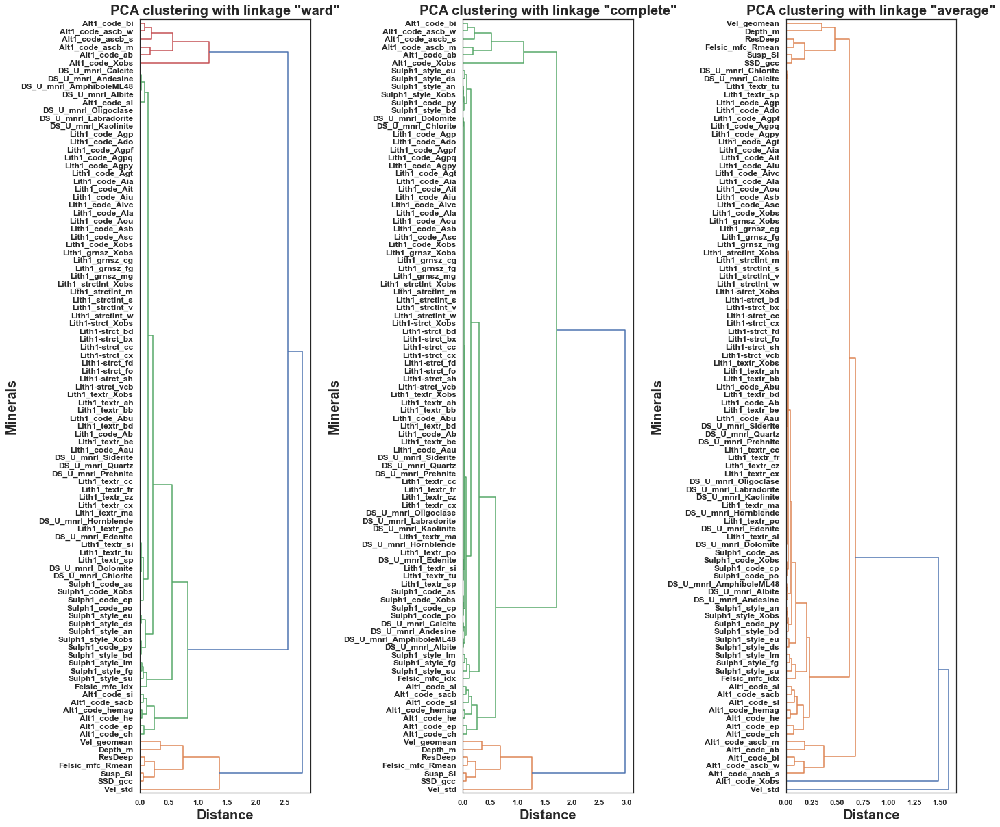

In [729]:
plt.rcParams['figure.figsize'] = (20,50)
plt.subplot(3,3,1)
dendrogram(data_link_components1_15EIS, labels=df_components1_15EIS.index, orientation = 'right',  leaf_rotation=0, leaf_font_size=12) 
plt.grid(False)
plt.xlabel('Distance',fontsize=20)
plt.ylabel('Minerals',fontsize=20)
plt.title('PCA clustering with linkage "ward"', fontweight='bold', fontsize=20);

plt.subplot(3,3,2)
dendrogram(data_link1_components1_15EIS, labels=df_components1_15EIS.index, orientation = 'right',  leaf_rotation=0, leaf_font_size=12) 
plt.grid(False)
plt.xlabel('Distance',fontsize=20)
plt.ylabel('Minerals', fontsize=20)
plt.title('PCA clustering with linkage "complete"', fontweight='bold', fontsize=20);

plt.subplot(3,3,3)
dendrogram(data_link2_components1_15EIS, labels=df_components1_15EIS.index, orientation = 'right',  leaf_rotation=0, leaf_font_size=12) 
plt.grid(False)
plt.xlabel('Distance',fontsize=20)
plt.ylabel('Minerals',fontsize=20)
plt.title('PCA clustering with linkage "average"', fontweight='bold', fontsize=20);

plt.tight_layout()
plt.show()

In [355]:
# Scatter plot using K- mean clustering 
ac2 = AgglomerativeClustering(n_clusters = 2) 
ac3 = AgglomerativeClustering(n_clusters = 3) 
ac4 = AgglomerativeClustering(n_clusters = 4) 
ac5 = AgglomerativeClustering(n_clusters = 5) 
ac6 = AgglomerativeClustering(n_clusters = 6) 

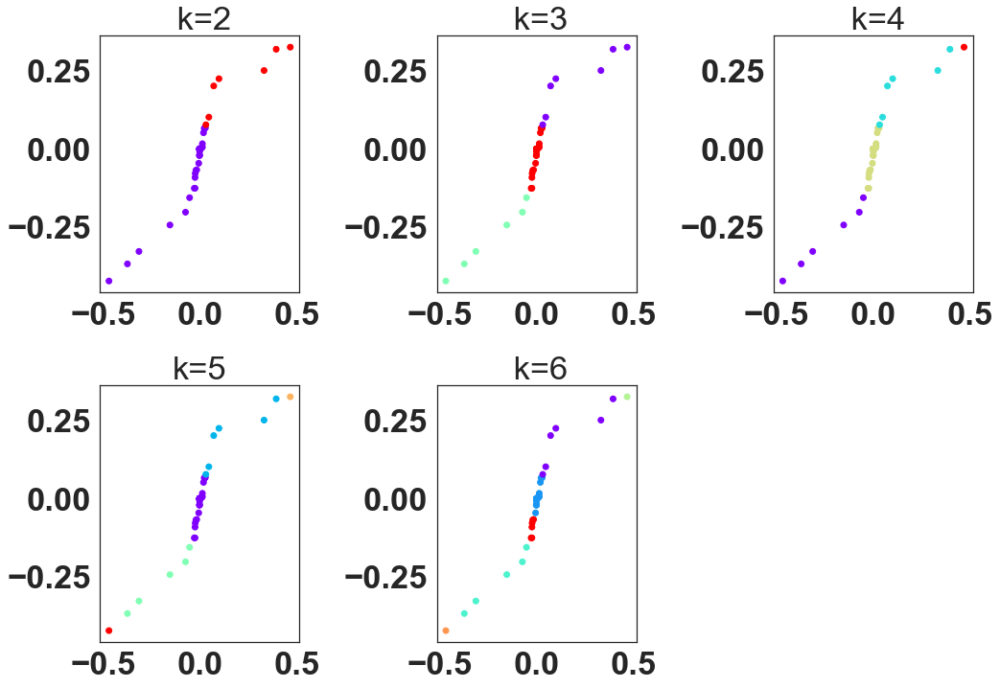

In [356]:
# Visualizing the clustering 
plt.figure(figsize =(15,15)) 
plt.subplot(3,3,1)
plt.scatter(df_components1_15EIS['PC-1'], df_components1_15EIS['PC-2'], 
		c = ac2.fit_predict(df_components1_15EIS), cmap ='rainbow') 
plt.title(' k=2')

plt.subplot(3,3,2)
plt.scatter(df_components1_15EIS['PC-1'], df_components1_15EIS['PC-2'], 
		c = ac3.fit_predict(df_components1_15EIS), cmap ='rainbow')
plt.title(' k=3')

plt.subplot(3,3,3)
plt.scatter(df_components1_15EIS['PC-1'], df_components1_15EIS['PC-2'], 
		c = ac4.fit_predict(df_components1_15EIS), cmap ='rainbow')
plt.title(' k=4')

plt.subplot(3,3,4)
plt.scatter(df_components1_15EIS['PC-1'], df_components1_15EIS['PC-2'], 
		c = ac5.fit_predict(df_components1_15EIS), cmap ='rainbow')
plt.title('k=5')

plt.subplot(3,3,5)
plt.scatter(df_components1_15EIS['PC-1'], df_components1_15EIS['PC-2'], 
		c = ac6.fit_predict(df_components1_15EIS), cmap ='rainbow')
plt.title(' k=6')

plt.tight_layout()
plt.show() 

In [357]:
#sns.pairplot(df_components1)
#plt.tight_layout()
#plt.show()

In [358]:
import pandas as pd
import numpy as np
np.random.seed(0)

In [359]:
# 250 samples with 104 features
x_pca1_15EIS = pca1_15EIS.transform(scaled_df_comb_15EIS_1)
x_pca2_15EIS = pca2_15EIS.transform(scaled_df_comb_15EIS_2)
x_pca3_15EIS = pca3_15EIS.transform(scaled_df_comb_15EIS_3)
x_pca4_15EIS = pca4_15EIS.transform(scaled_df_comb_15EIS_4)
x_pca5_15EIS = pca5_15EIS.transform(scaled_df_comb_15EIS_5)
x_pca6_15EIS = pca6_15EIS.transform(scaled_df_comb_15EIS_6)
x_pca7_15EIS = pca7_15EIS.transform(scaled_df_comb_15EIS_7)
x_pca8_15EIS = pca8_15EIS.transform(scaled_df_comb_15EIS_8)
x_pca9_15EIS = pca9_15EIS.transform(scaled_df_comb_15EIS_9)
x_pca10_15EIS = pca10_15EIS.transform(scaled_df_comb_15EIS_10)

In [360]:
# number of components
n_pcs1_15EIS= pca1_15EIS.components_.shape[0]
n_pcs2_15EIS= pca2_15EIS.components_.shape[0]
n_pcs3_15EIS= pca3_15EIS.components_.shape[0]
n_pcs4_15EIS= pca4_15EIS.components_.shape[0]
n_pcs5_15EIS= pca5_15EIS.components_.shape[0]
n_pcs6_15EIS= pca6_15EIS.components_.shape[0]
n_pcs7_15EIS= pca7_15EIS.components_.shape[0]
n_pcs8_15EIS= pca8_15EIS.components_.shape[0]
n_pcs9_15EIS= pca9_15EIS.components_.shape[0]
n_pcs10_15EIS= pca10_15EIS.components_.shape[0]

In [361]:
# get the index of the most important feature on EACH component i.e. largest absolute value
# using LIST COMPREHENSION HERE
most_important1_15EIS = [np.abs(pca1_15EIS.components_[i]).argmax() for i in range(n_pcs1_15EIS)]
most_important2_15EIS = [np.abs(pca2_15EIS.components_[i]).argmax() for i in range(n_pcs2_15EIS)]
most_important3_15EIS = [np.abs(pca3_15EIS.components_[i]).argmax() for i in range(n_pcs3_15EIS)]
most_important4_15EIS = [np.abs(pca4_15EIS.components_[i]).argmax() for i in range(n_pcs4_15EIS)]
most_important5_15EIS = [np.abs(pca5_15EIS.components_[i]).argmax() for i in range(n_pcs5_15EIS)]
most_important6_15EIS = [np.abs(pca6_15EIS.components_[i]).argmax() for i in range(n_pcs6_15EIS)]
most_important7_15EIS = [np.abs(pca7_15EIS.components_[i]).argmax() for i in range(n_pcs7_15EIS)]
most_important8_15EIS = [np.abs(pca8_15EIS.components_[i]).argmax() for i in range(n_pcs8_15EIS)]
most_important9_15EIS = [np.abs(pca9_15EIS.components_[i]).argmax() for i in range(n_pcs9_15EIS)]
most_important10_15EIS = [np.abs(pca10_15EIS.components_[i]).argmax() for i in range(n_pcs10_15EIS)]
print(most_important1_15EIS)
print(most_important2_15EIS)

[62, 53, 52, 25, 51, 20, 53, 50, 13, 97]
[51, 48, 19, 20, 58, 62, 14, 80, 61, 57]


In [362]:
initial_feature_names_15EIS = ['Alt1_code_Xobs', 'Alt1_code_ab', 'Alt1_code_ascb_m',
       'Alt1_code_ascb_s', 'Alt1_code_ascb_w', 'Alt1_code_bi', 'Alt1_code_ch',
       'Alt1_code_ep', 'Alt1_code_he', 'Alt1_code_hemag', 'Alt1_code_sacb',
       'Alt1_code_si', 'Alt1_code_sl', 'DS_U_grp_AMPHIBOLE',
       'DS_U_grp_CARBONATE', 'DS_U_grp_CHLORITE', 'DS_U_grp_PLAGIOCLASE',
       'DS_U_grp_SILICA', 'DS_U_mnrl_Albite', 'DS_U_mnrl_AmphiboleML48',
       'DS_U_mnrl_Andesine', 'DS_U_mnrl_Calcite', 'DS_U_mnrl_Chlorite',
       'DS_U_mnrl_Dolomite', 'DS_U_mnrl_Edenite', 'DS_U_mnrl_Hornblende',
       'DS_U_mnrl_Kaolinite', 'DS_U_mnrl_Labradorite', 'DS_U_mnrl_Oligoclase',
       'DS_U_mnrl_Prehnite', 'DS_U_mnrl_Quartz', 'DS_U_mnrl_Siderite',
       'Lith1_code_Aau', 'Lith1_code_Ab', 'Lith1_code_Abu', 'Lith1_code_Ado',
       'Lith1_code_Agp', 'Lith1_code_Agpf', 'Lith1_code_Agpq',
       'Lith1_code_Agpy', 'Lith1_code_Agt', 'Lith1_code_Aia', 'Lith1_code_Ait',
       'Lith1_code_Aiu', 'Lith1_code_Aivc', 'Lith1_code_Ala', 'Lith1_code_Aou',
       'Lith1_code_Asb', 'Lith1_code_Asc', 'Lith1_code_Xobs',
       'Lith1_grnsz_Xobs', 'Lith1_grnsz_cg', 'Lith1_grnsz_fg',
       'Lith1_grnsz_mg', 'Lith1_strctInt_Xobs', 'Lith1_strctInt_m',
       'Lith1_strctInt_s', 'Lith1_strctInt_v', 'Lith1_strctInt_w',
       'Lith1-strct_Xobs', 'Lith1-strct_bd', 'Lith1-strct_bx',
       'Lith1-strct_cc', 'Lith1-strct_cx', 'Lith1-strct_fd', 'Lith1-strct_fo',
       'Lith1-strct_sh', 'Lith1-strct_vcb', 'Lith1_textr_Xobs',
       'Lith1_textr_ah', 'Lith1_textr_bb', 'Lith1_textr_bd', 'Lith1_textr_be',
       'Lith1_textr_cc', 'Lith1_textr_cx', 'Lith1_textr_cz', 'Lith1_textr_fr',
       'Lith1_textr_ma', 'Lith1_textr_po', 'Lith1_textr_si', 'Lith1_textr_sp',
       'Lith1_textr_tu', 'Sulph1_code_Xobs', 'Sulph1_code_as',
       'Sulph1_code_cp', 'Sulph1_code_po', 'Sulph1_code_py',
       'Sulph1_style_Xobs', 'Sulph1_style_an', 'Sulph1_style_bd',
       'Sulph1_style_ds', 'Sulph1_style_eu', 'Sulph1_style_fg',
       'Sulph1_style_lm', 'Sulph1_style_su','Felsic_mfc_idx', 'Felsic_mfc_Rmean', 'ResDeep',
       'SSD_gcc', 'Susp_SI', 'Depth_m', 'Vel_geomean', 'Vel_std']

In [363]:
#initial_feature_names_15EIS
most_important_names8_15EIS = [initial_feature_names_15EIS[most_important_15EIS[i]] for i in range(10)]

PCA visualisation : https://plotly.com/python/pca-visualization/

In [364]:
print('PCA Covariance1\n',pca1_15EIS.get_covariance())
print('PCA Covariance2\n',pca2_15EIS.get_covariance())

PCA Covariance1
 [[ 1.39698269e-03 -6.09467754e-20 -2.05291632e-34 ... -2.00867452e-19
   6.25438607e-20 -7.95957911e-19]
 [-6.09467754e-20  2.74297782e-02  7.94072169e-18 ... -5.44888012e-04
  -2.70825285e-03  4.69380636e-04]
 [-2.05291632e-34  7.94072169e-18  1.39698269e-03 ... -1.23092040e-18
   8.29267273e-19  3.89093478e-18]
 ...
 [-2.00867452e-19 -5.44888012e-04 -1.23092040e-18 ...  2.21898393e-03
  -1.56439376e-04 -6.41524721e-04]
 [ 6.25438607e-20 -2.70825285e-03  8.29267273e-19 ... -1.56439376e-04
   2.52908797e-03 -2.54856450e-04]
 [-7.95957911e-19  4.69380636e-04  3.89093478e-18 ... -6.41524721e-04
  -2.54856450e-04  1.60474560e-02]]
PCA Covariance2
 [[ 2.30899848e-03  1.08705576e-33 -1.85796082e-33 ... -1.92985332e-19
  -3.75762217e-19 -3.42317625e-19]
 [ 1.08705576e-33  2.30899848e-03 -1.15318484e-32 ... -2.10630747e-19
  -1.44882654e-18 -5.91393686e-18]
 [-1.85796082e-33 -1.15318484e-32  2.30899848e-03 ...  6.46759784e-21
   3.38971151e-18  3.23229769e-18]
 ...
 [-1.92985

In [365]:
print('PCA Components1\n',pca1_15EIS.components_)
print('PCA Components1\n',pca2_15EIS.components_)

PCA Components1
 [[-1.34101175e-18 -2.36947607e-02  5.55111512e-17  1.11022302e-16
  -0.00000000e+00  1.38777878e-17  2.36947607e-02 -0.00000000e+00
  -0.00000000e+00 -0.00000000e+00 -0.00000000e+00 -0.00000000e+00
   1.03397577e-25  4.76293613e-02 -0.00000000e+00 -0.00000000e+00
   5.01471391e-03  9.97525321e-03 -0.00000000e+00  9.98703949e-02
  -1.50870203e-02 -5.41592403e-04  6.69595025e-03 -1.77001876e-04
  -0.00000000e+00 -1.53380059e-01 -0.00000000e+00 -1.06802273e-03
  -0.00000000e+00  2.95033293e-02 -0.00000000e+00 -4.74054586e-03
  -0.00000000e+00 -0.00000000e+00 -2.36947607e-02 -0.00000000e+00
  -0.00000000e+00 -0.00000000e+00 -0.00000000e+00 -0.00000000e+00
  -0.00000000e+00 -0.00000000e+00 -0.00000000e+00 -0.00000000e+00
  -0.00000000e+00 -0.00000000e+00 -0.00000000e+00 -7.28467967e-02
   7.28467967e-02 -0.00000000e+00  3.22701045e-02  3.32954302e-01
  -5.17902383e-02 -3.13434168e-01 -0.00000000e+00 -0.00000000e+00
  -0.00000000e+00 -0.00000000e+00 -0.00000000e+00 -0.000000

In [366]:
#Covariance Matrix , Eigen Values , Eigen Vectors
# https://stats.stackexchange.com/questions/2691/making-sense-of-principal-component-analysis-eigenvectors-eigenvalues

cov_matrix1_15EIS = np.cov(scaled_df_comb_15EIS_1.T)
eig_values1_15EIS, eig_vectors1_15EIS = np.linalg.eigh(cov_matrix1_15EIS)  # use numpy.linalg.eigh instead of numpy.linalg.eig for real value

print('\nEigenvalues1 \n%s' %eig_values1_15EIS)
print('Eigenvectors1 \n%s' %eig_vectors1_15EIS)
print('Covariance Matrix1 \n%s' %cov_matrix1_15EIS)


Eigenvalues1 
[-1.07189953e-15 -3.02399062e-16 -2.18072090e-16 -5.88567112e-17
 -4.82166918e-17 -3.47905059e-17 -1.57573790e-17 -1.10216015e-17
 -1.05817564e-17 -8.92005092e-18 -2.69870267e-18 -1.13831926e-18
 -9.57305463e-19 -2.20497919e-19 -1.45510474e-19 -5.64736920e-33
 -3.58769870e-33 -2.58662214e-33 -4.16426339e-34 -1.92689572e-34
 -4.59110186e-36 -4.07911750e-49 -1.32792597e-49 -1.05727553e-49
 -5.14629251e-50 -4.13085902e-50 -3.37721084e-50 -3.74323761e-52
 -1.10687574e-64 -1.00363174e-64 -2.48250796e-65 -4.28291906e-66
 -4.13357599e-66 -2.47965297e-66 -1.50279874e-66 -1.78303739e-80
 -2.28893709e-81 -4.82716392e-82 -2.48159621e-82  0.00000000e+00
  7.31370746e-83  1.41235963e-82  3.99454405e-82  2.45700180e-81
  8.40715063e-67  2.02907896e-66  1.88290553e-53  1.19453726e-50
  7.12011410e-50  9.66259898e-50  1.65211528e-48  1.00828998e-35
  1.43534900e-34  2.40543413e-34  5.79224719e-34  6.58859379e-34
  1.47657418e-33  2.07367678e-33  3.74777179e-33  1.11238502e-32
  2.369985

In [367]:
print('pca1.explained_variance\n',pca1_15EIS.explained_variance_)
print('pca2.explained_variance\n',pca2_15EIS.explained_variance_)

pca1.explained_variance
 [0.85211364 0.5604205  0.39476494 0.30157834 0.20223788 0.14451937
 0.10857462 0.08277488 0.05143369 0.02881494]
pca2.explained_variance
 [1.11382794 0.6211804  0.36880857 0.22362533 0.19489591 0.1266121
 0.08916238 0.0863888  0.05272055 0.04296158]


In [368]:
# Calculate Explained Variance
explained_variance1_15EIS=pca1_15EIS.explained_variance_ratio_
explained_variance2_15EIS=pca2_15EIS.explained_variance_ratio_
explained_variance3_15EIS=pca3_15EIS.explained_variance_ratio_
explained_variance4_15EIS=pca4_15EIS.explained_variance_ratio_
explained_variance5_15EIS=pca5_15EIS.explained_variance_ratio_
explained_variance6_15EIS=pca6_15EIS.explained_variance_ratio_
explained_variance7_15EIS=pca7_15EIS.explained_variance_ratio_
explained_variance8_15EIS=pca8_15EIS.explained_variance_ratio_
explained_variance9_15EIS=pca9_15EIS.explained_variance_ratio_
explained_variance10_15EIS=pca10_15EIS.explained_variance_ratio_

In [369]:
print('explained_variance1\n',explained_variance1_15EIS)
print('explained_variance2\n',explained_variance2_15EIS)
print('explained_variance3\n',explained_variance3_15EIS)
print('explained_variance4\n',explained_variance4_15EIS)
print('explained_variance5\n',explained_variance5_15EIS)
print('explained_variance6\n',explained_variance6_15EIS)
print('explained_variance7\n',explained_variance7_15EIS)
print('explained_variance8\n',explained_variance8_15EIS)
print('explained_variance9\n',explained_variance9_15EIS)
print('explained_variance10\n',explained_variance10_15EIS)

explained_variance1
 [0.2989697  0.19662723 0.13850589 0.10581075 0.0709565  0.05070558
 0.03809412 0.02904211 0.01804585 0.01010991]
explained_variance2
 [0.35661033 0.19888112 0.11808013 0.07159733 0.06239913 0.04053695
 0.0285468  0.02765879 0.01687935 0.01375486]
explained_variance3
 [0.26337474 0.18757701 0.12964304 0.100002   0.06783387 0.05105203
 0.04722465 0.03318297 0.028837   0.02378318]
explained_variance4
 [0.28489874 0.1660303  0.13438196 0.09997065 0.06596279 0.05898628
 0.04592878 0.03646029 0.02787403 0.01237893]
explained_variance5
 [0.37916596 0.19837355 0.14812024 0.06771194 0.04943212 0.03534443
 0.02711969 0.02222253 0.01769185 0.01331401]
explained_variance6
 [0.32545177 0.17980023 0.14320303 0.11035986 0.06174509 0.03978116
 0.02534811 0.02370151 0.01829899 0.01596392]
explained_variance7
 [0.35237718 0.19431593 0.11879371 0.07411825 0.06252676 0.05142116
 0.03381517 0.02586747 0.01630237 0.01494214]
explained_variance8
 [0.4031932  0.14054693 0.07845445 0.06809

In [370]:
#PCA Explained variance Ratio
print('PCA ratio1\n',pca1_15EIS.explained_variance_ratio_.sum())
print('PCA ratio2\n',pca2_15EIS.explained_variance_ratio_.sum())
print('PCA ratio3\n',pca3_15EIS.explained_variance_ratio_.sum())
print('PCA ratio4\n',pca4_15EIS.explained_variance_ratio_.sum())
print('PCA ratio5\n',pca5_15EIS.explained_variance_ratio_.sum())
print('PCA ratio6\n',pca6_15EIS.explained_variance_ratio_.sum())
print('PCA ratio7\n',pca7_15EIS.explained_variance_ratio_.sum())
print('PCA ratio8\n',pca8_15EIS.explained_variance_ratio_.sum())
print('PCA ratio9\n',pca9_15EIS.explained_variance_ratio_.sum())
print('PCA ratio10\n',pca10_15EIS.explained_variance_ratio_.sum())

PCA ratio1
 0.9568676274119241
PCA ratio2
 0.9349447828034937
PCA ratio3
 0.9325104772158935
PCA ratio4
 0.9328727397013568
PCA ratio5
 0.9584963199981894
PCA ratio6
 0.9436536625440811
PCA ratio7
 0.9444801203908687
PCA ratio8
 0.9116623968520576
PCA ratio9
 0.9172933807172002
PCA ratio10
 0.9308995916690025


In [371]:
# Elbow plot for feature selection 
#PC_values1 = np.arange(pca1.n_components_) + 1
#plt.plot(PC_values1, pca1.explained_variance_ratio_, 'go-',  linewidth=2)
#plt.title('Elbow Plot')
#plt.xlabel('Principal Component')
#plt.ylabel('Proportion of Variance Explained (ratio)')
#plt.show()

In [372]:
# https://www.machinelearningplus.com/machine-learning/principal-components-analysis-pca-better-explained/

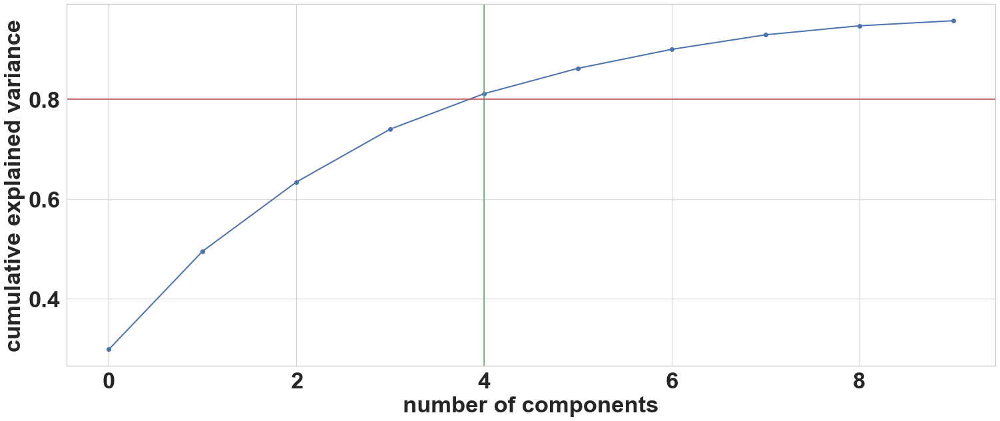

In [629]:
from matplotlib.pyplot import figure, show
from matplotlib.ticker import MaxNLocator
plt.plot(np.cumsum(pca1_15EIS.explained_variance_ratio_),'bo-', linewidth=2)
plt.xlabel('number of components')
plt.ylabel('cumulative explained variance');
plt.axvline(4, c='g')
plt.axhline(0.8, c='r')
plt.show()

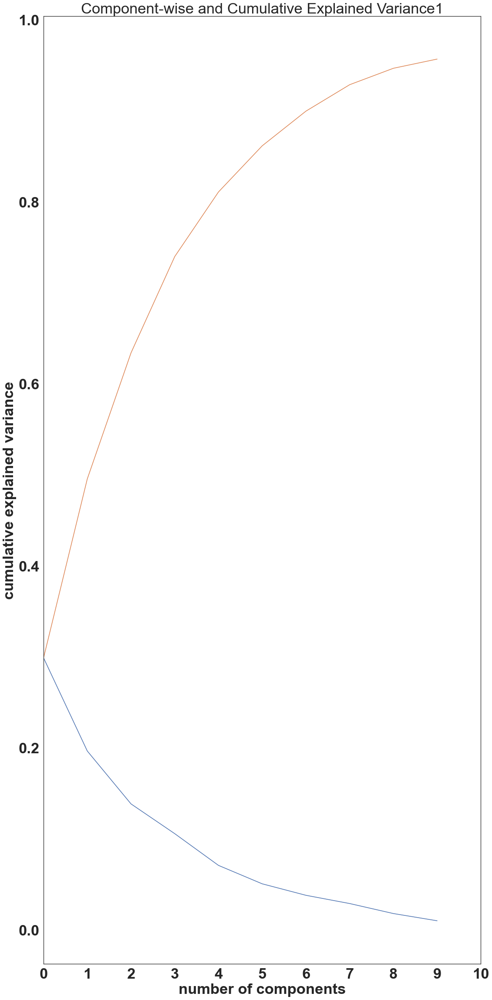

In [374]:
#len(pca1_15EIS.components_)
plt.plot(range(len(pca1_15EIS.components_)),(pca1_15EIS.explained_variance_ratio_))
plt.plot(range(len(pca1_15EIS.components_)), np.cumsum(pca1_15EIS.explained_variance_ratio_))
plt.title("Component-wise and Cumulative Explained Variance1")
plt.locator_params(axis="x", integer=True, tight=True, nbins=10)
plt.xlim(xmin =0, xmax = 10)
plt.xlabel('number of components')
plt.ylabel('cumulative explained variance');

# PCA combined with K-means clustering 
#### <https://365datascience.com/pca-k-means/>

In [375]:
from sklearn.cluster import KMeans # Our clustering algorithm
import numpy as np

In [376]:
# Calculate PCA scores
#x_pca1 = pca1.transform(scaled_df_comb_1)
scores_pca1_15EIS = pca1_15EIS.transform(scaled_df_comb_15EIS_1)
#scores_pca1 = pca1.transform(df_components_features1)

In [377]:
scores_pca1_15EIS

array([[-0.27416016,  1.124616  , -0.70102809, ...,  0.25165932,
         0.0075146 , -0.3129749 ],
       [-0.27226974,  1.10911393, -0.71580245, ...,  0.24783576,
         0.00824659, -0.29515848],
       [-0.27775643,  1.09629893, -0.7240591 , ...,  0.25863765,
         0.06078369, -0.06652273],
       ...,
       [-0.18089245,  0.87793665,  0.17674914, ..., -0.84735455,
        -0.24506274,  0.1503358 ],
       [-0.17517903,  0.87793683,  0.17106671, ..., -0.85939597,
        -0.28955584, -0.03243348],
       [-0.17627265,  0.88697601,  0.18297904, ..., -0.85839219,
        -0.28912564, -0.04365463]])

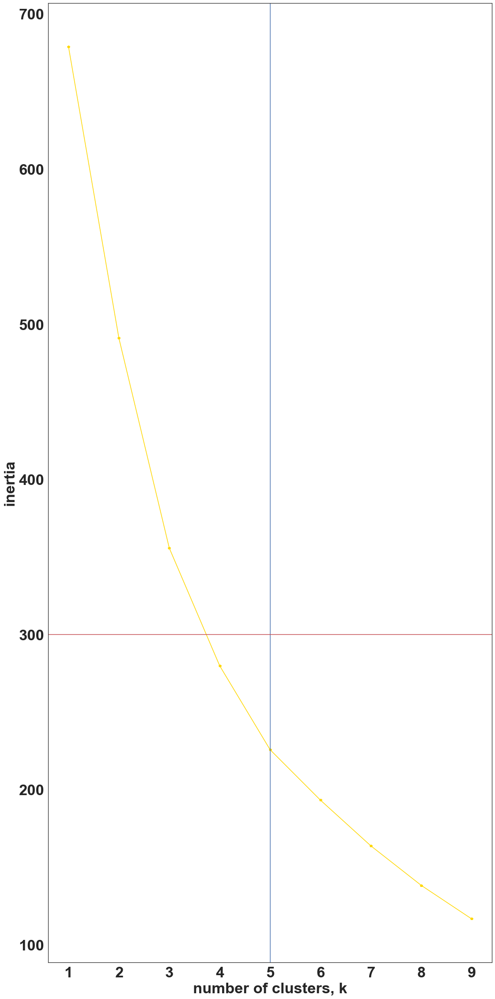

In [378]:
# K-means clustering with PCA
inertias = []

# Creating 10 K-Mean models while varying the number of clusters (k)
for k in range(1,10):
    model_pca1_15EIS = KMeans(n_clusters=k, init = 'k-means++', random_state = 20)
    
    # Fit model to samples
    model_pca1_15EIS.fit(scores_pca1_15EIS)
    
    # Append the inertia to the list of inertias
    inertias.append(model_pca1_15EIS.inertia_)
    
plt.plot(range(1,10), inertias, '-p', color='gold')
plt.xlabel('number of clusters, k')
plt.ylabel('inertia')
plt.axvline(5, c='b')
plt.axhline(300, c='r')
plt.show()

In [379]:
model_pca1_15EIS = KMeans(n_clusters = 5, init = 'k-means++', random_state = 20)

In [380]:
model_pca1_15EIS.fit(scores_pca1_15EIS)

KMeans(n_clusters=5, random_state=20)

In [381]:
df_pca1_kmeans_15EIS = pd.concat([scaled_df_comb_15EIS_1.reset_index(drop= True), pd.DataFrame(scores_pca1_15EIS)], axis=1)

In [382]:
df_pca1_kmeans_15EIS.columns.values[-5:] = ['pc1','pc2','pc3','pc4','pc5']
#df_pca1_kmeans.columns.values[-4:]

In [383]:
df_pca1_kmeans_15EIS['K-means PCA1'] = model_pca1_15EIS.labels_

In [384]:
df_pca1_kmeans_15EIS.head()

,Alt1_code_Xobs,Alt1_code_ab,Alt1_code_ascb_m,Alt1_code_ascb_s,Alt1_code_ascb_w,Alt1_code_bi,Alt1_code_ch,Alt1_code_ep,Alt1_code_he,Alt1_code_hemag,Alt1_code_sacb,Alt1_code_si,Alt1_code_sl,DS_U_mnrl_Albite,DS_U_mnrl_AmphiboleML48,DS_U_mnrl_Andesine,DS_U_mnrl_Calcite,DS_U_mnrl_Chlorite,DS_U_mnrl_Dolomite,DS_U_mnrl_Edenite,DS_U_mnrl_Hornblende,DS_U_mnrl_Kaolinite,DS_U_mnrl_Labradorite,DS_U_mnrl_Oligoclase,DS_U_mnrl_Prehnite,DS_U_mnrl_Quartz,DS_U_mnrl_Siderite,Lith1_code_Aau,Lith1_code_Ab,Lith1_code_Abu,Lith1_code_Ado,Lith1_code_Agp,Lith1_code_Agpf,Lith1_code_Agpq,Lith1_code_Agpy,Lith1_code_Agt,Lith1_code_Aia,Lith1_code_Ait,Lith1_code_Aiu,Lith1_code_Aivc,Lith1_code_Ala,Lith1_code_Aou,Lith1_code_Asb,Lith1_code_Asc,Lith1_code_Xobs,Lith1_grnsz_Xobs,Lith1_grnsz_cg,Lith1_grnsz_fg,Lith1_grnsz_mg,Lith1_strctInt_Xobs,Lith1_strctInt_m,Lith1_strctInt_s,Lith1_strctInt_v,Lith1_strctInt_w,Lith1-strct_Xobs,Lith1-strct_bd,Lith1-strct_bx,Lith1-strct_cc,Lith1-strct_cx,Lith1-strct_fd,Lith1-strct_fo,Lith1-strct_sh,Lith1-strct_vcb,Lith1_textr_Xobs,Lith1_textr_ah,Lith1_textr_bb,Lith1_textr_bd,Lith1_textr_be,Lith1_textr_cc,Lith1_textr_cx,Lith1_textr_cz,Lith1_textr_fr,Lith1_textr_ma,Lith1_textr_po,Lith1_textr_si,Lith1_textr_sp,Lith1_textr_tu,Sulph1_code_Xobs,Sulph1_code_as,Sulph1_code_cp,Sulph1_code_po,Sulph1_code_py,Sulph1_style_Xobs,Sulph1_style_an,Sulph1_style_bd,Sulph1_style_ds,Sulph1_style_eu,Sulph1_style_fg,Sulph1_style_lm,Sulph1_style_su,Felsic_mfc_idx,Felsic_mfc_Rmean,ResDeep,SSD_gcc,Susp_SI,Depth_m,Vel_geomean,Vel_std,0,1,2,3,4,pc1,pc2,pc3,pc4,pc5,K-means PCA1
0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,1,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,1,0,0,0,1,0,0,0,0,0.510125,0.509152,0.000000,0.763027,0.004504,0.000000,0.937945,0.214843,-0.274160,1.124616,-0.701028,-0.150744,-0.046960,-0.215966,-0.123053,0.251659,0.007515,-0.312975,2
1,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,1,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,1,0,0,0,1,0,0,0,0,0.569692,0.581917,0.000019,0.737739,0.044752,0.000382,0.937945,0.214843,-0.272270,1.109114,-0.715802,-0.149705,-0.049848,-0.217362,-0.117474,0.247836,0.008247,-0.295158,2
2,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,1,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,1,0,0,0,1,0,0,0,0,0.629132,0.622406,0.000054,0.738673,0.012007,0.000778,0.665967,0.523274,-0.277756,1.096299,-0.724059,-0.144813,-0.059632,-0.210120,-0.128497,0.258638,0.060784,-0.066523,2
3,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,1,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,1,0,0,0,1,0,0,0,0,0.633445,0.637410,0.010180,0.737552,0.000000,0.001220,0.665967,0.523274,-0.277276,1.091473,-0.726228,-0.146380,-0.059888,-0.210151,-0.124892,0.256184,0.061782,-0.062243,2
4,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,1,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,1,0,0,0,1,0,0,0,0,0.686793,0.683484,0.086563,0.775085,0.069683,0.001585,0.746222,0.261088,-0.268984,1.062028,-0.739335,-0.161251,-0.057729,-0.214008,-0.089005,0.224716,0.025925,-0.212838,2


In [385]:
df_pca1_kmeans_15EIS['Au_ppm'] = df_pca1_kmeans_15EIS['K-means PCA1'].map({0:'first',1:'second',2:'third', 3:'fourth',4:'fifth'})

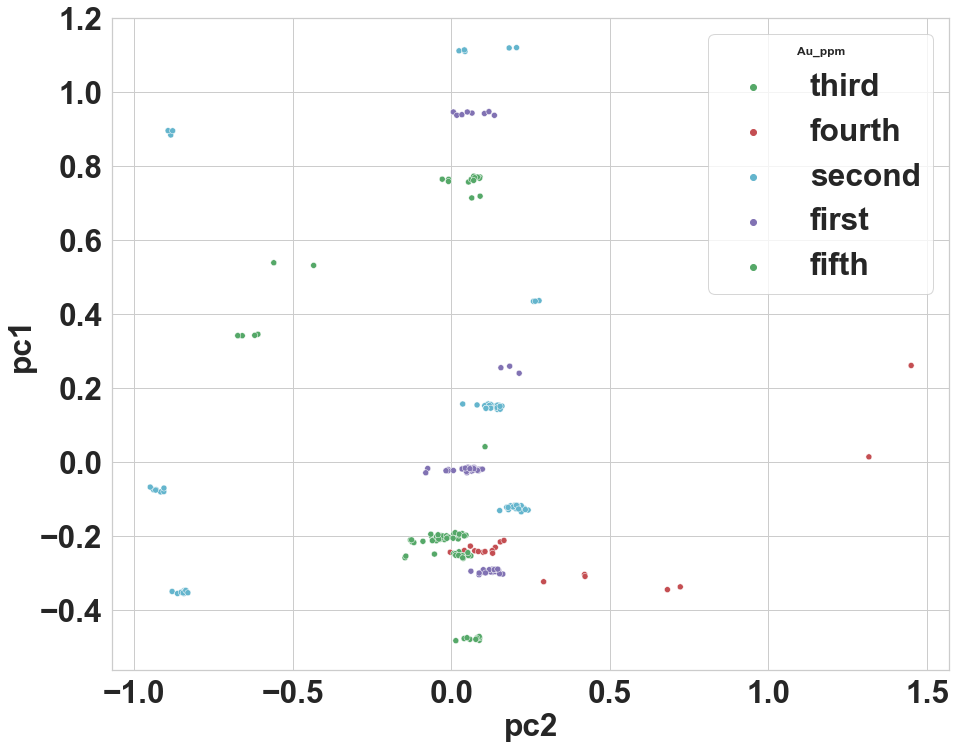

In [645]:
x_axis = df_pca1_kmeans_15EIS['pc2']
y_axis = df_pca1_kmeans_15EIS['pc1']
plt.figure(figsize = (15,12))
sns.scatterplot(x_axis,y_axis, hue = df_pca1_kmeans_15EIS['Au_ppm'], palette = ('g','r','c','m'))
plt.show()

## Heirerical Clustering (Agglomerative Clustering)

https://www.askpython.com/python/examples/hierarchical-clustering
https://colab.research.google.com/github/Gurubux/CognitiveClass-ML/blob/master/Course_MachineLearningWithPython/5-Clustering/ML0101EN-Clus-Hierarchical-Cars-py-v1.ipynb#scrollTo=VoeEZ7pZABdH

https://github.com/avangelatos/hcluster (Used)

https://joernhees.de/blog/2015/08/26/scipy-hierarchical-clustering-and-dendrogram-tutorial/

https://medium.com/@sametgirgin/hierarchical-clustering-model-in-5-steps-with-python-6c45087d4318

https://python-graph-gallery.com/401-customised-dendrogram/

https://hdbscan.readthedocs.io/en/latest/comparing_clustering_algorithms.html

https://statsandr.com/blog/clustering-analysis-k-means-and-hierarchical-clustering-by-hand-and-in-r/

https://www.sciencedirect.com/topics/engineering/hierarchical-clustering

https://www.geeksforgeeks.org/implementing-agglomerative-clustering-using-sklearn/

In [387]:
#scaled_df_comb_1
from scipy.cluster.hierarchy import cophenet
from scipy.spatial.distance import pdist, squareform
from scipy.cluster.hierarchy import linkage, dendrogram
from sklearn.metrics.cluster import silhouette_score

In [388]:
df_pca1_kmeans_15EIS.head()

,Alt1_code_Xobs,Alt1_code_ab,Alt1_code_ascb_m,Alt1_code_ascb_s,Alt1_code_ascb_w,Alt1_code_bi,Alt1_code_ch,Alt1_code_ep,Alt1_code_he,Alt1_code_hemag,Alt1_code_sacb,Alt1_code_si,Alt1_code_sl,DS_U_mnrl_Albite,DS_U_mnrl_AmphiboleML48,DS_U_mnrl_Andesine,DS_U_mnrl_Calcite,DS_U_mnrl_Chlorite,DS_U_mnrl_Dolomite,DS_U_mnrl_Edenite,DS_U_mnrl_Hornblende,DS_U_mnrl_Kaolinite,DS_U_mnrl_Labradorite,DS_U_mnrl_Oligoclase,DS_U_mnrl_Prehnite,DS_U_mnrl_Quartz,DS_U_mnrl_Siderite,Lith1_code_Aau,Lith1_code_Ab,Lith1_code_Abu,Lith1_code_Ado,Lith1_code_Agp,Lith1_code_Agpf,Lith1_code_Agpq,Lith1_code_Agpy,Lith1_code_Agt,Lith1_code_Aia,Lith1_code_Ait,Lith1_code_Aiu,Lith1_code_Aivc,Lith1_code_Ala,Lith1_code_Aou,Lith1_code_Asb,Lith1_code_Asc,Lith1_code_Xobs,Lith1_grnsz_Xobs,Lith1_grnsz_cg,Lith1_grnsz_fg,Lith1_grnsz_mg,Lith1_strctInt_Xobs,Lith1_strctInt_m,Lith1_strctInt_s,Lith1_strctInt_v,Lith1_strctInt_w,Lith1-strct_Xobs,Lith1-strct_bd,Lith1-strct_bx,Lith1-strct_cc,Lith1-strct_cx,Lith1-strct_fd,Lith1-strct_fo,Lith1-strct_sh,Lith1-strct_vcb,Lith1_textr_Xobs,Lith1_textr_ah,Lith1_textr_bb,Lith1_textr_bd,Lith1_textr_be,Lith1_textr_cc,Lith1_textr_cx,Lith1_textr_cz,Lith1_textr_fr,Lith1_textr_ma,Lith1_textr_po,Lith1_textr_si,Lith1_textr_sp,Lith1_textr_tu,Sulph1_code_Xobs,Sulph1_code_as,Sulph1_code_cp,Sulph1_code_po,Sulph1_code_py,Sulph1_style_Xobs,Sulph1_style_an,Sulph1_style_bd,Sulph1_style_ds,Sulph1_style_eu,Sulph1_style_fg,Sulph1_style_lm,Sulph1_style_su,Felsic_mfc_idx,Felsic_mfc_Rmean,ResDeep,SSD_gcc,Susp_SI,Depth_m,Vel_geomean,Vel_std,0,1,2,3,4,pc1,pc2,pc3,pc4,pc5,K-means PCA1,Au_ppm
0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,1,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,1,0,0,0,1,0,0,0,0,0.510125,0.509152,0.000000,0.763027,0.004504,0.000000,0.937945,0.214843,-0.274160,1.124616,-0.701028,-0.150744,-0.046960,-0.215966,-0.123053,0.251659,0.007515,-0.312975,2,third
1,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,1,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,1,0,0,0,1,0,0,0,0,0.569692,0.581917,0.000019,0.737739,0.044752,0.000382,0.937945,0.214843,-0.272270,1.109114,-0.715802,-0.149705,-0.049848,-0.217362,-0.117474,0.247836,0.008247,-0.295158,2,third
2,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,1,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,1,0,0,0,1,0,0,0,0,0.629132,0.622406,0.000054,0.738673,0.012007,0.000778,0.665967,0.523274,-0.277756,1.096299,-0.724059,-0.144813,-0.059632,-0.210120,-0.128497,0.258638,0.060784,-0.066523,2,third
3,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,1,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,1,0,0,0,1,0,0,0,0,0.633445,0.637410,0.010180,0.737552,0.000000,0.001220,0.665967,0.523274,-0.277276,1.091473,-0.726228,-0.146380,-0.059888,-0.210151,-0.124892,0.256184,0.061782,-0.062243,2,third
4,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,1,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,1,0,0,0,1,0,0,0,0,0.686793,0.683484,0.086563,0.775085,0.069683,0.001585,0.746222,0.261088,-0.268984,1.062028,-0.739335,-0.161251,-0.057729,-0.214008,-0.089005,0.224716,0.025925,-0.212838,2,third


In [389]:
temp1_15EIS=df_pca1_kmeans_15EIS.iloc[:,103:108]
temp1_15EIS.head()

,pc1,pc2,pc3,pc4,pc5
0,-0.215966,-0.123053,0.251659,0.007515,-0.312975
1,-0.217362,-0.117474,0.247836,0.008247,-0.295158
2,-0.210120,-0.128497,0.258638,0.060784,-0.066523
3,-0.210151,-0.124892,0.256184,0.061782,-0.062243
4,-0.214008,-0.089005,0.224716,0.025925,-0.212838


In [390]:
#temp1=scaled_df_comb_1.values
#temp1=df_pca1_kmeans.values
temp2_15EIS=temp1_15EIS.values
temp2_15EIS.shape

(250, 5)

In [391]:
# Calculate distance
data_dist_15EIS = pdist(temp2_15EIS) # computing the distance
data_link_15EIS = linkage(temp2_15EIS, 'ward') # computing the linkage (Can try complete or Average)
data_link1_15EIS = linkage(temp2_15EIS, 'complete') # computing the linkage (Can try complete or Average)
data_link2_15EIS = linkage(temp2_15EIS, 'average') # computing the linkage (Can try complete or Average)

In [392]:
# The closer the value is to 1, the better the clustering preserves the original distances:
# For Ward
c, coph_dists_15EIS = cophenet(data_link_15EIS, data_dist_15EIS)
c

0.8088192745364091

In [622]:
# The closer the value is to 1, the better the clustering preserves the original distances:
# For Complete
c1, coph1_dists_15EIS = cophenet(data_link1_15EIS, data_dist_15EIS)
c1

0.757532855508373

In [623]:
# The closer the value is to 1, the better the clustering preserves the original distances:
# For Average
c2, coph2_dists_15EIS = cophenet(data_link2_15EIS, data_dist_15EIS)
c2

0.9052323446223938

### Calculate Silhoutte Score 

In [393]:
# Lets calculate the best Silhouette Score for ward
for k in range(2,7):
    model = AgglomerativeClustering(n_clusters = k, affinity = 'euclidean', linkage ='ward')
    q=model.fit_predict(temp2_15EIS)
    s = silhouette_score(temp2_15EIS , q, metric='euclidean')
#    print(s)
    print ("{0:.0f} number of clusters has silhoutte score of {1:.4f}".format(k,s))

2 number of clusters has silhoutte score of 0.4461
3 number of clusters has silhoutte score of 0.4923
4 number of clusters has silhoutte score of 0.5457
5 number of clusters has silhoutte score of 0.5765
6 number of clusters has silhoutte score of 0.5900


 ### Evaluating the different models and Visualizing the results

In [394]:
ac2 = AgglomerativeClustering(n_clusters = 2, affinity = 'euclidean', linkage ='ward')
ac3 = AgglomerativeClustering(n_clusters = 3, affinity = 'euclidean', linkage ='ward')
ac4 = AgglomerativeClustering(n_clusters = 4, affinity = 'euclidean', linkage ='ward')
ac5 = AgglomerativeClustering(n_clusters = 5, affinity = 'euclidean', linkage ='ward')
ac6 = AgglomerativeClustering(n_clusters = 6, affinity = 'euclidean', linkage ='ward')
ac7 = AgglomerativeClustering(n_clusters = 7, affinity = 'euclidean', linkage ='ward')
ac8 = AgglomerativeClustering(n_clusters = 8, affinity = 'euclidean', linkage ='ward')

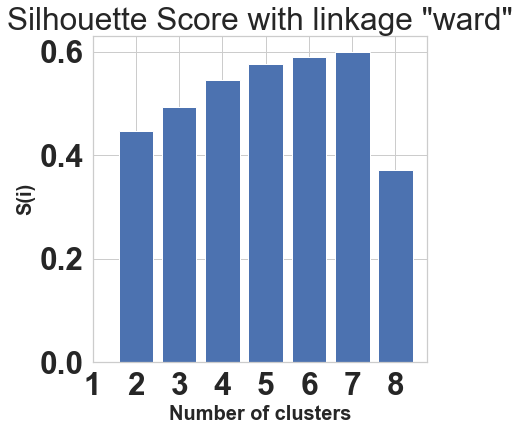

In [644]:
k = [2, 3, 4, 5, 6, 7, 8] 

# Appending the silhouette scores of the different models to the list 
silhouette_scores = [] 
silhouette_scores.append( 
		silhouette_score(temp2_15EIS, ac2.fit_predict(temp2_15EIS))) 
silhouette_scores.append( 
		silhouette_score(temp2_15EIS, ac3.fit_predict(temp2_15EIS))) 
silhouette_scores.append( 
		silhouette_score(temp2_15EIS, ac4.fit_predict(temp2_15EIS))) 
silhouette_scores.append( 
		silhouette_score(temp2_15EIS, ac5.fit_predict(temp2_15EIS))) 
silhouette_scores.append( 
		silhouette_score(temp2_15EIS, ac6.fit_predict(temp2_15EIS))) 
silhouette_scores.append( 
		silhouette_score(temp2_15EIS, ac7.fit_predict(temp2_15EIS))) 
silhouette_scores.append( 
		silhouette_score(temp2_15EIS, ac8.fit_predict(temp2_15EIS))) 

# Plotting a bar graph to compare the results 
plt.figure(figsize=(6,6))
plt.bar(k, silhouette_scores) 
plt.xlabel('Number of clusters', fontsize = 20) 
plt.ylabel('S(i)', fontsize = 20)
plt.xticks(np.arange(1, 9, 1.0))
plt.title('Silhouette Score with linkage "ward"')
plt.show() 


In [396]:
# Lets calculate the best Silhouette Score for complete
for k in range(2,7):
    model = AgglomerativeClustering(n_clusters = k, affinity = 'euclidean', linkage ='complete')
    q=model.fit_predict(temp2_15EIS)
    s = silhouette_score(temp2_15EIS , q, metric='euclidean')
    print ("{0:.0f} number of clusters has silhoutte score of {1:.4f}".format(k,s))

2 number of clusters has silhoutte score of 0.5255
3 number of clusters has silhoutte score of 0.2713
4 number of clusters has silhoutte score of 0.3828
5 number of clusters has silhoutte score of 0.3820
6 number of clusters has silhoutte score of 0.3222


In [397]:
acc2 = AgglomerativeClustering(n_clusters = 2, affinity = 'euclidean', linkage ='complete')
acc3 = AgglomerativeClustering(n_clusters = 3, affinity = 'euclidean', linkage ='complete')
acc4 = AgglomerativeClustering(n_clusters = 4, affinity = 'euclidean', linkage ='complete')
acc5 = AgglomerativeClustering(n_clusters = 5, affinity = 'euclidean', linkage ='complete')
acc6 = AgglomerativeClustering(n_clusters = 6, affinity = 'euclidean', linkage ='complete')
acc7 = AgglomerativeClustering(n_clusters = 7, affinity = 'euclidean', linkage ='complete')
acc8 = AgglomerativeClustering(n_clusters = 8, affinity = 'euclidean', linkage ='complete')

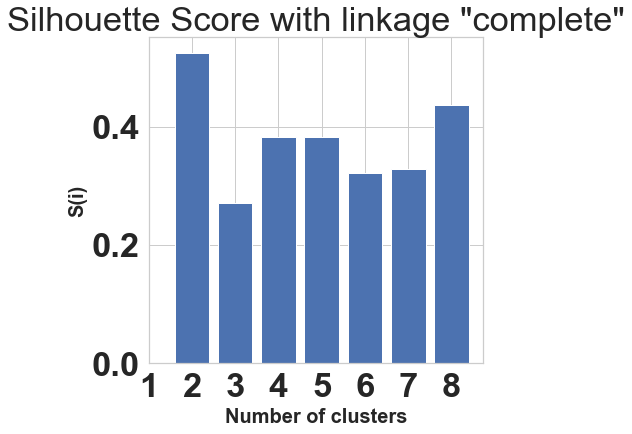

In [618]:
k = [2, 3, 4, 5, 6, 7, 8] 

# Appending the silhouette scores of the different models to the list 
silhouette_scores = [] 
silhouette_scores.append( 
		silhouette_score(temp2_15EIS, acc2.fit_predict(temp2_15EIS))) 
silhouette_scores.append( 
		silhouette_score(temp2_15EIS, acc3.fit_predict(temp2_15EIS))) 
silhouette_scores.append( 
		silhouette_score(temp2_15EIS, acc4.fit_predict(temp2_15EIS))) 
silhouette_scores.append( 
		silhouette_score(temp2_15EIS, acc5.fit_predict(temp2_15EIS))) 
silhouette_scores.append( 
		silhouette_score(temp2_15EIS, acc6.fit_predict(temp2_15EIS))) 
silhouette_scores.append( 
		silhouette_score(temp2_15EIS, acc7.fit_predict(temp2_15EIS))) 
silhouette_scores.append( 
		silhouette_score(temp2_15EIS, acc8.fit_predict(temp2_15EIS))) 

# Plotting a bar graph to compare the results 
plt.figure(figsize=(6,6))
plt.bar(k, silhouette_scores) 
plt.xlabel('Number of clusters', fontsize = 20) 
plt.ylabel('S(i)', fontsize = 20) 
plt.xticks(np.arange(1, 9, 1.0))
plt.title('Silhouette Score with linkage "complete"')
plt.show() 


In [399]:
# Lets calculate the best Silhouette Score for average
for k in range(2,7):
    model = AgglomerativeClustering(n_clusters = k, affinity = 'euclidean', linkage ='average')
    q=model.fit_predict(temp2_15EIS)
    s = silhouette_score(temp2_15EIS , q, metric='euclidean')
    print ("{0:.0f} number of clusters has silhoutte score of {1:.4f}".format(k,s))

2 number of clusters has silhoutte score of 0.5255
3 number of clusters has silhoutte score of 0.4930
4 number of clusters has silhoutte score of 0.4382
5 number of clusters has silhoutte score of 0.4704
6 number of clusters has silhoutte score of 0.5139


In [400]:
aca2 = AgglomerativeClustering(n_clusters = 2, affinity = 'euclidean', linkage ='average')
aca3 = AgglomerativeClustering(n_clusters = 3, affinity = 'euclidean', linkage ='average')
aca4 = AgglomerativeClustering(n_clusters = 4, affinity = 'euclidean', linkage ='average')
aca5 = AgglomerativeClustering(n_clusters = 5, affinity = 'euclidean', linkage ='average')
aca6 = AgglomerativeClustering(n_clusters = 6, affinity = 'euclidean', linkage ='average')
aca7 = AgglomerativeClustering(n_clusters = 7, affinity = 'euclidean', linkage ='average')
aca8 = AgglomerativeClustering(n_clusters = 8, affinity = 'euclidean', linkage ='average')

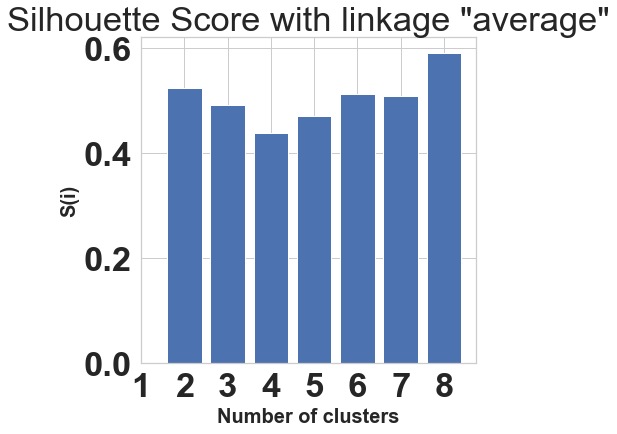

In [617]:
k = [2, 3, 4, 5, 6, 7, 8] 

# Appending the silhouette scores of the different models to the list 
silhouette_scores = [] 
silhouette_scores.append( 
		silhouette_score(temp2_15EIS, aca2.fit_predict(temp2_15EIS))) 
silhouette_scores.append( 
		silhouette_score(temp2_15EIS, aca3.fit_predict(temp2_15EIS))) 
silhouette_scores.append( 
		silhouette_score(temp2_15EIS, aca4.fit_predict(temp2_15EIS))) 
silhouette_scores.append( 
		silhouette_score(temp2_15EIS, aca5.fit_predict(temp2_15EIS))) 
silhouette_scores.append( 
		silhouette_score(temp2_15EIS, aca6.fit_predict(temp2_15EIS))) 
silhouette_scores.append( 
		silhouette_score(temp2_15EIS, aca7.fit_predict(temp2_15EIS))) 
silhouette_scores.append( 
		silhouette_score(temp2_15EIS, aca8.fit_predict(temp2_15EIS))) 

# Plotting a bar graph to compare the results 
plt.figure(figsize=(6,6))
plt.bar(k, silhouette_scores) 
plt.xlabel('Number of clusters', fontsize = 20) 
plt.ylabel('S(i)', fontsize = 20) 
#plt.xticks(np.arange(min(x), max(x)+1, 1.0))
plt.xticks(np.arange(1, 9, 1.0))
plt.title('Silhouette Score with linkage "average"')
plt.show() 

In [402]:
#!conda install -c districtdatalabs yellowbrick
#!pip install yellowbrick
#!conda install scikit-learn
#from yellowbrick.cluster import KElbowVisualizer, SilhouetteVisualizer

In [403]:
# We can see that each row of the resulting array has the format [idx1, idx2, dist, sample_count].
data_link_15EIS[0]

array([8.30000000e+01, 8.60000000e+01, 1.70546146e-03, 2.00000000e+00])

In its first iteration the linkage algorithm decided to merge the two clusters (original samples here) with indices 101 and 127,
as they only had a distance of 0.00137492516. This created a cluster with a total of 2 samples.

In [404]:
data_link_15EIS[1]

array([1.17000000e+02, 1.26000000e+02, 1.87968978e-03, 2.00000000e+00])

In [405]:
# First 10 iteration 
data_link_15EIS[:20]

array([[8.30000000e+01, 8.60000000e+01, 1.70546146e-03, 2.00000000e+00],
       [1.17000000e+02, 1.26000000e+02, 1.87968978e-03, 2.00000000e+00],
       [1.92000000e+02, 2.07000000e+02, 2.34552058e-03, 2.00000000e+00],
       [2.36000000e+02, 2.37000000e+02, 2.36777005e-03, 2.00000000e+00],
       [1.01000000e+02, 1.27000000e+02, 2.73001114e-03, 2.00000000e+00],
       [1.40000000e+02, 1.52000000e+02, 3.42793380e-03, 2.00000000e+00],
       [1.70000000e+02, 1.80000000e+02, 4.80117190e-03, 2.00000000e+00],
       [8.00000000e+00, 1.20000000e+01, 4.94907677e-03, 2.00000000e+00],
       [1.29000000e+02, 1.47000000e+02, 5.04868052e-03, 2.00000000e+00],
       [6.70000000e+01, 7.70000000e+01, 5.11041652e-03, 2.00000000e+00],
       [1.13000000e+02, 2.54000000e+02, 5.51953486e-03, 3.00000000e+00],
       [3.20000000e+01, 4.40000000e+01, 5.53151975e-03, 2.00000000e+00],
       [1.32000000e+02, 1.45000000e+02, 5.60324189e-03, 2.00000000e+00],
       [1.35000000e+02, 2.55000000e+02, 5.70254482e

## Dendrogram

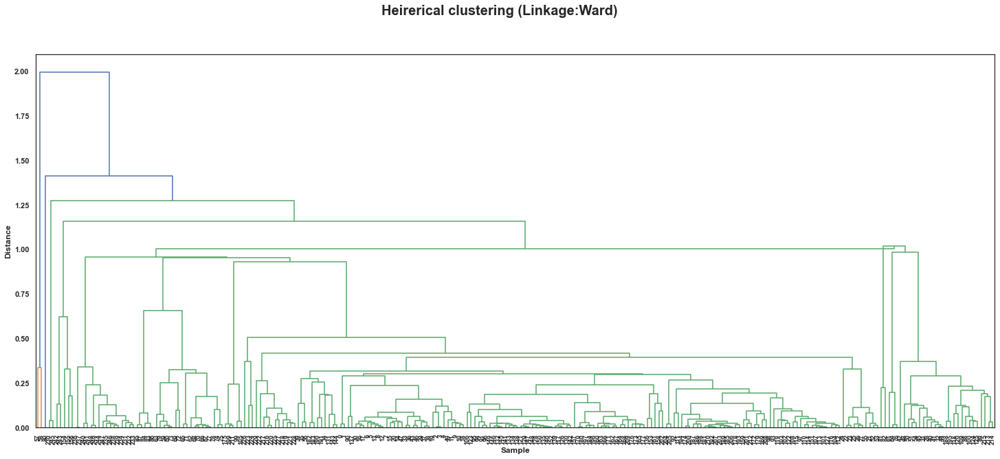

In [737]:
#plt.rcParams['figure.figsize'] = (25, 10)
plt.figure(figsize=(25,10))
dendrogram(data_link_15EIS, labels=scaled_df_comb_15EIS_1.index, leaf_rotation=90.0, leaf_font_size=9.)
plt.xlabel('Sample')
plt.ylabel('Distance')
plt.suptitle('Heirerical clustering (Linkage:Ward)', fontweight='bold', fontsize=20);

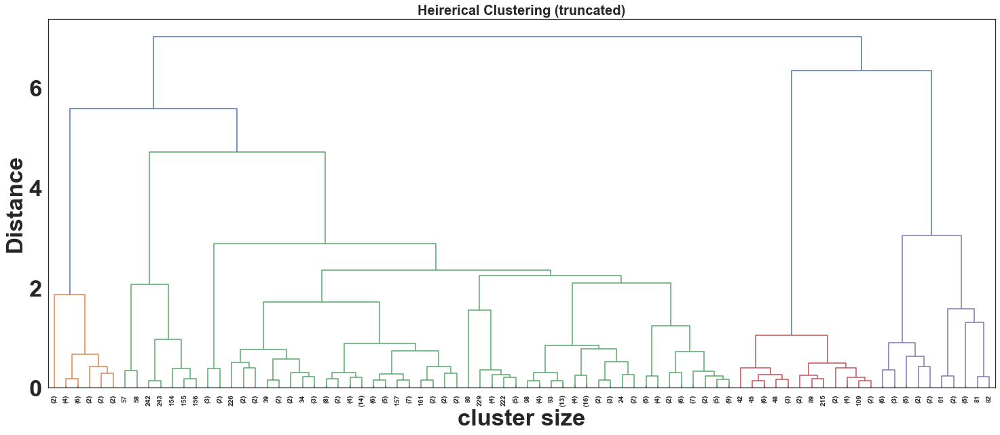

In [407]:
plt.title('Heirerical Clustering (truncated)',fontweight='bold', fontsize=20)
plt.xlabel('cluster size')
plt.ylabel('Distance')
dendrogram(
    data_link_15EIS,
    truncate_mode='lastp',  # show only the last p merged clusters
    p=80,  # show only the last p merged clusters
#    orientation='right',
    leaf_rotation=90.,
    leaf_font_size=10.,
    show_contracted=True,  # to get a distribution impression in truncated branches
)
plt.show()

#### HeatMap

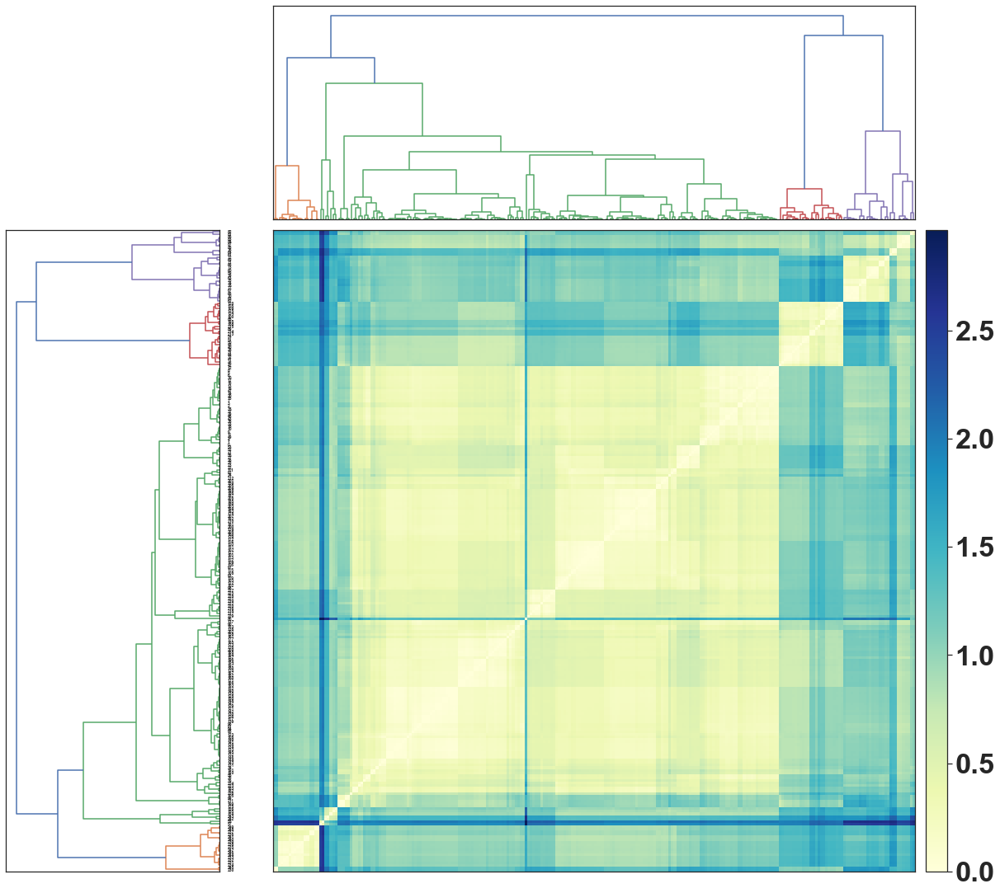

In [408]:

# Compute and plot first dendrogram.
fig = plt.figure(figsize=(18,18))
# x ywidth height
ax1 = fig.add_axes([0.05,0.1,0.2,0.6])
Y1_15EIS = linkage(data_dist_15EIS, method='ward')
Z1_15EIS = dendrogram(Y1_15EIS, orientation='left',labels=scaled_df_comb_15EIS_1.index) # adding/removing the axes
ax1.set_xticks([])

# Compute and plot second dendrogram.
ax2 = fig.add_axes([0.3,0.71,0.6,0.2])
Z2_15EIS = dendrogram(Y1_15EIS)
ax2.set_xticks([])
ax2.set_yticks([])

#Compute and plot the heatmap
axmatrix = fig.add_axes([0.3,0.1,0.6,0.6])
idx1 = Z1_15EIS['leaves']
idx2 = Z2_15EIS['leaves']
D = squareform(data_dist_15EIS)
D = D[idx1,:]
D = D[:,idx2]
im = axmatrix.matshow(D, aspect='auto', origin='lower', cmap=plt.cm.YlGnBu)
axmatrix.set_xticks([])
axmatrix.set_yticks([])

# Plot colorbar.
axcolor = fig.add_axes([0.91,0.1,0.02,0.6])
plt.colorbar(im, cax=axcolor)
plt.show()

## Using the centroid method resembles k-means results...

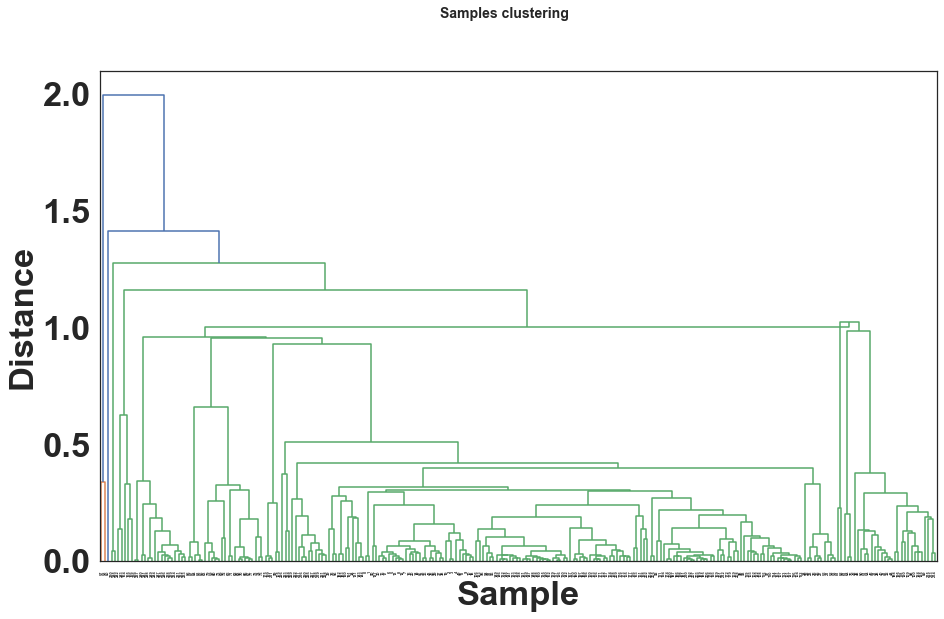

In [409]:
data_dist_15EIS = pdist(temp2_15EIS) # computing the distance
data_link_15EIS = linkage(temp2_15EIS, 'centroid') # computing the linkage

plt.rcParams['figure.figsize'] = (15, 9)
dendrogram(data_link_15EIS, labels=scaled_df_comb_15EIS_1.index, leaf_rotation=90.0, leaf_font_size=4.)
plt.xlabel('Sample')
plt.ylabel('Distance')
plt.suptitle('Samples clustering', fontweight='bold', fontsize=14);

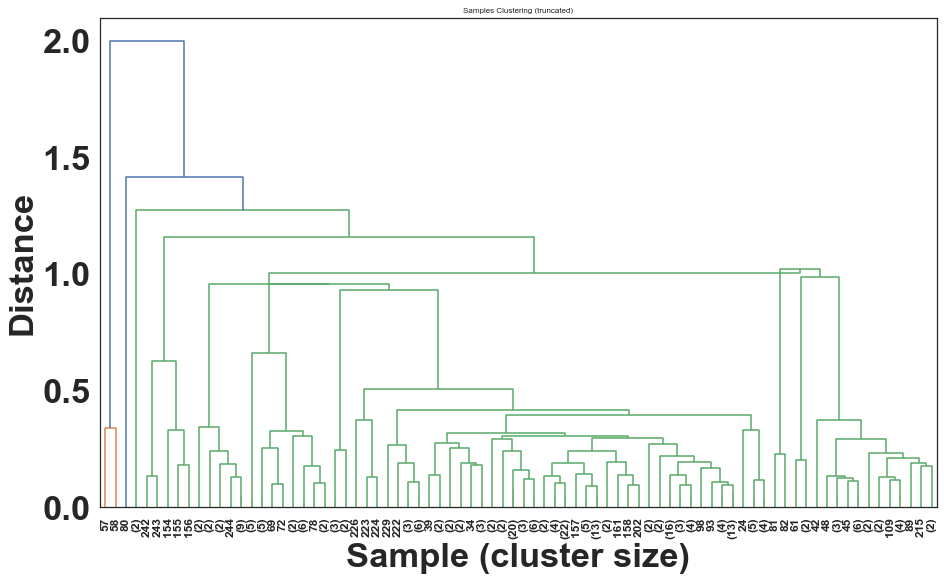

In [410]:
plt.title('Samples Clustering (truncated)', fontsize=8)
plt.xlabel('Sample (cluster size)')
plt.ylabel('Distance')
dendrogram(
    data_link_15EIS,
    truncate_mode='lastp',  # show only the last p merged clusters
    p=80,  # show only the last p merged clusters
    leaf_rotation=90.,
    leaf_font_size=12.,
    show_contracted=True,  # to get a distribution impression in truncated branches
)
plt.show()

In [411]:
hc_15EIS = AgglomerativeClustering(n_clusters = 5, affinity = 'euclidean', linkage ='complete')

In [412]:
y_hc_15EIS=hc_15EIS.fit_predict(temp2_15EIS)
y_hc_15EIS

array([2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2,
       2, 2, 2, 2, 2, 2, 3, 2, 2, 3, 3, 2, 0, 0, 2, 2, 2, 0, 3, 3, 3, 2,
       3, 3, 2, 2, 3, 2, 3, 3, 2, 2, 3, 2, 0, 1, 1, 2, 2, 3, 2, 2, 3, 2,
       2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 3, 2, 2, 2, 4, 4, 4, 3, 3, 3, 3, 3,
       3, 3, 2, 2, 2, 2, 2, 2, 2, 2, 2, 0, 3, 2, 2, 2, 2, 0, 0, 2, 2, 3,
       2, 2, 2, 2, 2, 2, 2, 2, 3, 2, 3, 2, 2, 0, 3, 3, 2, 2, 2, 2, 2, 0,
       2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 0, 0, 2, 2, 2, 2, 2, 2, 2, 2, 2,
       1, 1, 1, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 0,
       2, 2, 2, 2, 2, 2, 0, 0, 2, 2, 2, 2, 3, 2, 0, 0, 2, 2, 2, 3, 2, 2,
       2, 0, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 0, 2, 3, 3, 3, 2, 2, 2, 2,
       2, 2, 2, 0, 0, 2, 0, 2, 2, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0,
       1, 1, 0, 0, 0, 0, 0, 0], dtype=int64)

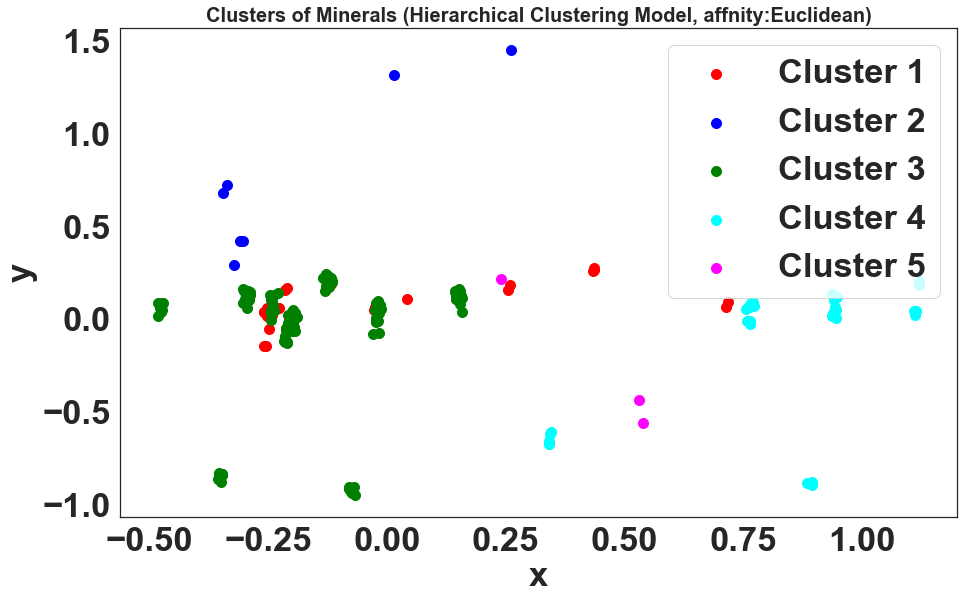

In [413]:
plt.scatter(temp2_15EIS[y_hc_15EIS==0, 0], temp2_15EIS[y_hc_15EIS==0, 1], s=100, c='red', label ='Cluster 1')
plt.scatter(temp2_15EIS[y_hc_15EIS==1, 0], temp2_15EIS[y_hc_15EIS==1, 1], s=100, c='blue', label ='Cluster 2')
plt.scatter(temp2_15EIS[y_hc_15EIS==2, 0], temp2_15EIS[y_hc_15EIS==2, 1], s=100, c='green', label ='Cluster 3')
plt.scatter(temp2_15EIS[y_hc_15EIS==3, 0], temp2_15EIS[y_hc_15EIS==3, 1], s=100, c='cyan', label ='Cluster 4')
plt.scatter(temp2_15EIS[y_hc_15EIS==4, 0], temp2_15EIS[y_hc_15EIS==4, 1], s=100, c='magenta', label ='Cluster 5')
plt.title('Clusters of Minerals (Hierarchical Clustering Model, affnity:Euclidean)', fontsize=20 , fontweight='bold')
plt.xlabel('x')
plt.ylabel('y')
plt.legend()
plt.show()

In [414]:
df_temp_15EIS_1= pd.DataFrame(pca1_15EIS.components_,columns=scaled_df_comb_15EIS_1.columns,index = ['PC_d1_1','PC_d1_2','PC_d1_3','PC_d1_4','PC_d1_5','PC_d1_6','PC_d1_7','PC_d1_8','PC_d1_9','PC_d1_10'])

In [415]:
df_temp_15EIS_1.reset_index(drop=True, inplace=True)

In [416]:
df_temptrans_15EIS_1=df_temp_15EIS_1.T
df_temptrans_15EIS_1.head()

,0,1,2,3,4,5,6,7,8,9
Alt1_code_Xobs,-1.341012e-18,8.364038e-18,-7.401549e-18,-2.083371e-18,-9.678117e-19,-6.228517e-18,-4.723764e-18,1.267186e-17,5.951257e-19,-4.587166e-17
Alt1_code_ab,-2.369476e-02,6.646114e-02,1.153378e-01,6.254712e-02,2.491688e-01,7.741916e-02,-1.562407e-01,3.477651e-02,1.118800e-01,1.960102e-02
Alt1_code_ascb_m,5.551115e-17,-5.551115e-17,-5.551115e-17,8.326673e-17,1.526557e-16,-1.387779e-16,-3.885781e-16,0.000000e+00,-1.162265e-16,2.220446e-16
Alt1_code_ascb_s,1.110223e-16,4.163336e-17,5.551115e-17,-2.636780e-16,1.491862e-16,1.214306e-16,2.983724e-16,-1.249001e-16,1.396452e-16,-2.220446e-16
Alt1_code_ascb_w,-0.000000e+00,5.551115e-17,1.110223e-16,5.551115e-17,-1.249001e-16,-0.000000e+00,1.387779e-16,-5.551115e-17,2.605880e-16,-3.330669e-16


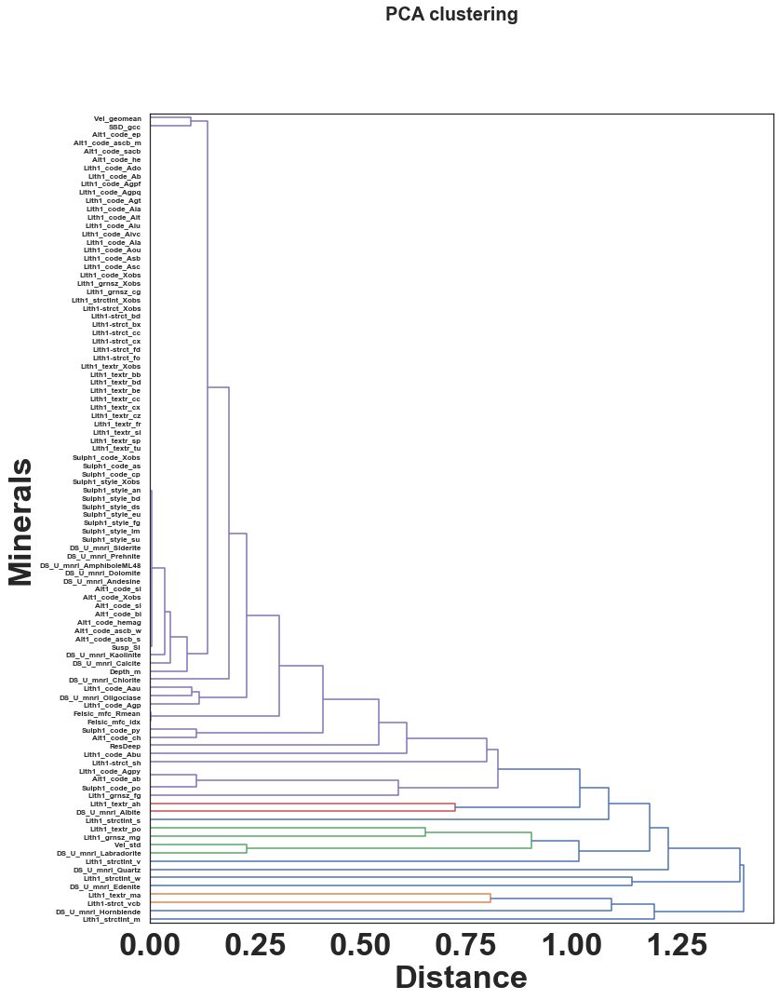

In [417]:
pca1_data_dist_15EIS = pdist(df_temptrans_15EIS_1) # computing the distance
pca1_data_link_15EIS = linkage(df_temptrans_15EIS_1, 'complete') # computing the linkage (ward, centroid,complete or average)

plt.rcParams['figure.figsize'] = (12,16)
dendrogram(pca1_data_link_15EIS, labels=df_temptrans_15EIS_1.index, orientation = 'right',  leaf_rotation=0, leaf_font_size=8)
plt.grid(False)
plt.xlabel('Distance')
plt.ylabel('Minerals')
plt.suptitle('PCA clustering', fontweight='bold', fontsize=20);

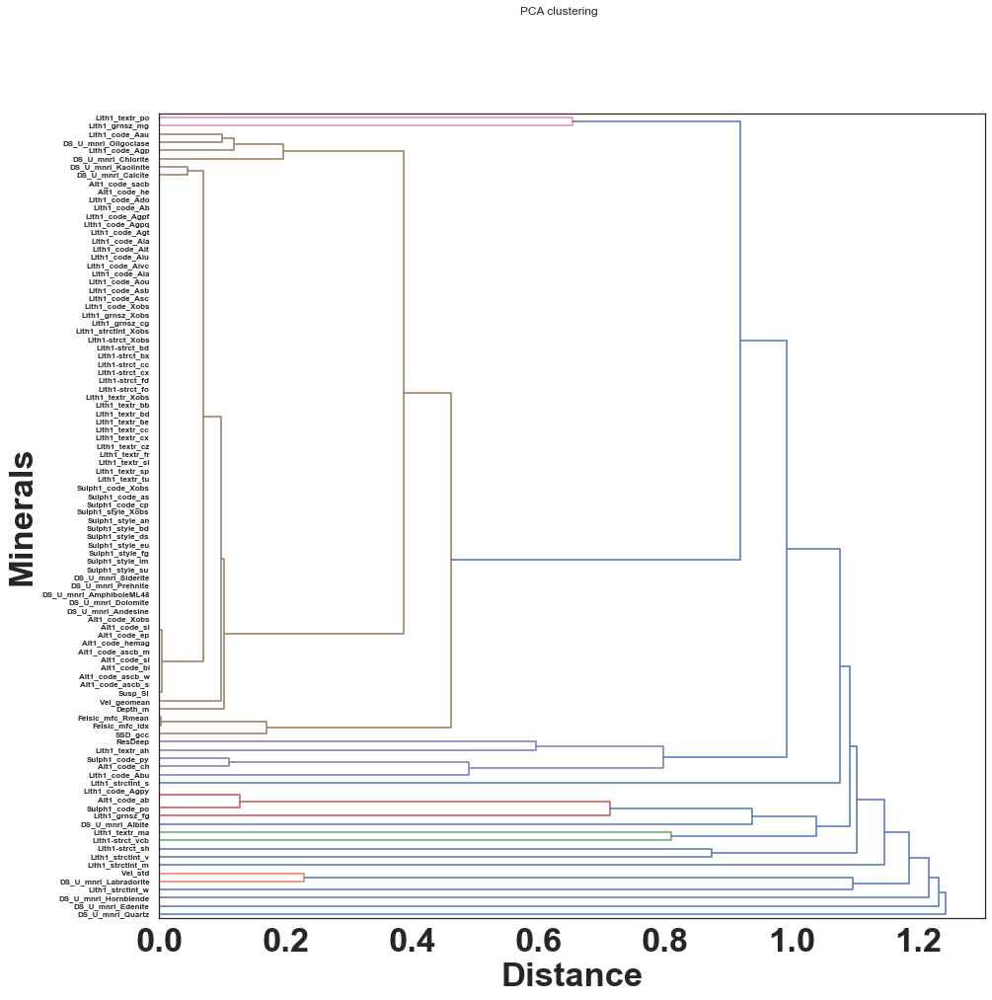

In [418]:
#df_imp_features_1
pca1_data_dist_15EIS = pdist(df_temptrans_15EIS_1) # computing the distance
pca1_data_link_15EIS = linkage(df_temptrans_15EIS_1, 'ward') # computing the linkage (ward, centroid,complete or average)

plt.rcParams['figure.figsize'] = (15,15)
dendrogram(pca1_data_link_15EIS, labels=df_temptrans_15EIS_1.index, orientation = 'right',  leaf_rotation=0, leaf_font_size=8.)
plt.grid(False)
plt.xlabel('Distance')
plt.ylabel('Minerals')
plt.suptitle('PCA clustering', fontweight='regular', fontsize=12);

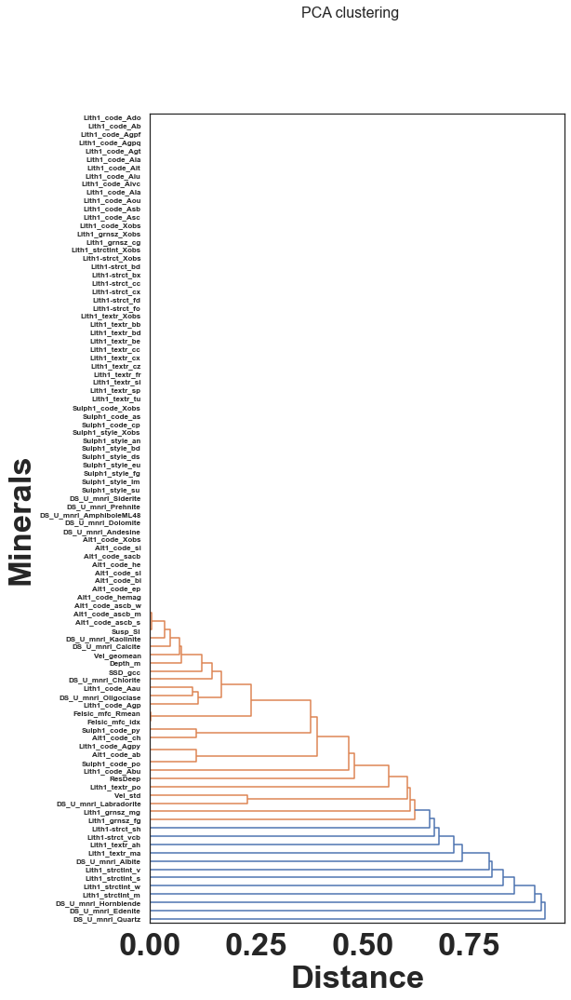

In [419]:
pca1_data_dist_15EIS = pdist(df_temptrans_15EIS_1) # computing the distance
pca1_data_link_15EIS = linkage(df_temptrans_15EIS_1, 'average') # computing the linkage (ward, centroid,complete or average)

plt.rcParams['figure.figsize'] = (8,16)
dendrogram(pca1_data_link_15EIS, labels=df_temptrans_15EIS_1.index, orientation = 'right',  leaf_rotation=0, leaf_font_size=8)
plt.grid(False)
plt.xlabel('Distance')
plt.ylabel('Minerals')
plt.suptitle('PCA clustering', fontweight='regular', fontsize=16);

In [420]:
# https://github.com/renatosc/nnv/blob/master/examples/examples.ipynb
#!pip install nnv
from nnv import NNV

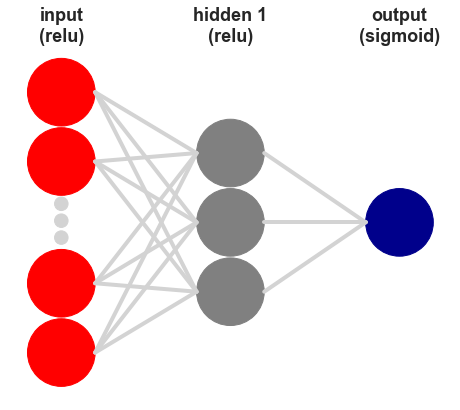

(<Figure size 576x1152 with 1 Axes>, <AxesSubplot:>)

In [421]:
layersList = [
    {"title":"input\n(relu)", "units": 5, "color": "Red"},
    {"title":"hidden 1\n(relu)", "units": 3},
    {"title":"output\n(sigmoid)", "units": 1,"color": "darkBlue"},
]
NNV(layersList).render(save_to_file="my_example_nnv.png")

# Factor Analysis (prince)

In [422]:
#!pip install prince# 
# https://www.datacamp.com/community/tutorials/introduction-factor-analysis
# https://github.com/MaxHalford/prince/blob/master/README.md

#import prince

In [423]:
from sklearn.decomposition import KernelPCA

In [424]:
scaled_df_comb_15EIS_2 = scaled_df_comb_15EIS.copy()

In [425]:
scaled_df_comb_15EIS_2.columns.values

array(['Alt1_code_Xobs', 'Alt1_code_ab', 'Alt1_code_ascb_m',
       'Alt1_code_ascb_s', 'Alt1_code_ascb_w', 'Alt1_code_bi',
       'Alt1_code_ch', 'Alt1_code_ep', 'Alt1_code_he', 'Alt1_code_hemag',
       'Alt1_code_sacb', 'Alt1_code_si', 'Alt1_code_sl',
       'DS_U_mnrl_Albite', 'DS_U_mnrl_AmphiboleML48',
       'DS_U_mnrl_Andesine', 'DS_U_mnrl_Calcite', 'DS_U_mnrl_Chlorite',
       'DS_U_mnrl_Dolomite', 'DS_U_mnrl_Edenite', 'DS_U_mnrl_Hornblende',
       'DS_U_mnrl_Kaolinite', 'DS_U_mnrl_Labradorite',
       'DS_U_mnrl_Oligoclase', 'DS_U_mnrl_Prehnite', 'DS_U_mnrl_Quartz',
       'DS_U_mnrl_Siderite', 'Lith1_code_Aau', 'Lith1_code_Ab',
       'Lith1_code_Abu', 'Lith1_code_Ado', 'Lith1_code_Agp',
       'Lith1_code_Agpf', 'Lith1_code_Agpq', 'Lith1_code_Agpy',
       'Lith1_code_Agt', 'Lith1_code_Aia', 'Lith1_code_Ait',
       'Lith1_code_Aiu', 'Lith1_code_Aivc', 'Lith1_code_Ala',
       'Lith1_code_Aou', 'Lith1_code_Asb', 'Lith1_code_Asc',
       'Lith1_code_Xobs', 'Lith1_grnsz_Xobs'

In [426]:
#scaled_df_comb_15EIS.tolist()
scaled_df_comb_15EIS.columns.values

array(['Alt1_code_Xobs', 'Alt1_code_ab', 'Alt1_code_ascb_m',
       'Alt1_code_ascb_s', 'Alt1_code_ascb_w', 'Alt1_code_bi',
       'Alt1_code_ch', 'Alt1_code_ep', 'Alt1_code_he', 'Alt1_code_hemag',
       'Alt1_code_sacb', 'Alt1_code_si', 'Alt1_code_sl',
       'DS_U_mnrl_Albite', 'DS_U_mnrl_AmphiboleML48',
       'DS_U_mnrl_Andesine', 'DS_U_mnrl_Calcite', 'DS_U_mnrl_Chlorite',
       'DS_U_mnrl_Dolomite', 'DS_U_mnrl_Edenite', 'DS_U_mnrl_Hornblende',
       'DS_U_mnrl_Kaolinite', 'DS_U_mnrl_Labradorite',
       'DS_U_mnrl_Oligoclase', 'DS_U_mnrl_Prehnite', 'DS_U_mnrl_Quartz',
       'DS_U_mnrl_Siderite', 'Lith1_code_Aau', 'Lith1_code_Ab',
       'Lith1_code_Abu', 'Lith1_code_Ado', 'Lith1_code_Agp',
       'Lith1_code_Agpf', 'Lith1_code_Agpq', 'Lith1_code_Agpy',
       'Lith1_code_Agt', 'Lith1_code_Aia', 'Lith1_code_Ait',
       'Lith1_code_Aiu', 'Lith1_code_Aivc', 'Lith1_code_Ala',
       'Lith1_code_Aou', 'Lith1_code_Asb', 'Lith1_code_Asc',
       'Lith1_code_Xobs', 'Lith1_grnsz_Xobs'

In [427]:
featureX = ['Alt1_code_Xobs', 'Alt1_code_ab', 'Alt1_code_ascb_m',
       'Alt1_code_ascb_s', 'Alt1_code_ascb_w', 'Alt1_code_bi',
       'Alt1_code_ch', 'Alt1_code_ep', 'Alt1_code_he', 'Alt1_code_hemag',
       'Alt1_code_sacb', 'Alt1_code_si', 'Alt1_code_sl',
       'DS_U_mnrl_Albite', 'DS_U_mnrl_AmphiboleML48',
       'DS_U_mnrl_Andesine', 'DS_U_mnrl_Calcite', 'DS_U_mnrl_Chlorite',
       'DS_U_mnrl_Dolomite', 'DS_U_mnrl_Edenite', 'DS_U_mnrl_Hornblende',
       'DS_U_mnrl_Kaolinite', 'DS_U_mnrl_Labradorite',
       'DS_U_mnrl_Oligoclase', 'DS_U_mnrl_Prehnite', 'DS_U_mnrl_Quartz',
       'DS_U_mnrl_Siderite', 'Lith1_code_Aau', 'Lith1_code_Ab',
       'Lith1_code_Abu', 'Lith1_code_Ado', 'Lith1_code_Agp',
       'Lith1_code_Agpf', 'Lith1_code_Agpq', 'Lith1_code_Agpy',
       'Lith1_code_Agt', 'Lith1_code_Aia', 'Lith1_code_Ait',
       'Lith1_code_Aiu', 'Lith1_code_Aivc', 'Lith1_code_Ala',
       'Lith1_code_Aou', 'Lith1_code_Asb', 'Lith1_code_Asc',
       'Lith1_code_Xobs', 'Lith1_grnsz_Xobs', 'Lith1_grnsz_cg',
       'Lith1_grnsz_fg', 'Lith1_grnsz_mg', 'Lith1_strctInt_Xobs',
       'Lith1_strctInt_m', 'Lith1_strctInt_s', 'Lith1_strctInt_v',
       'Lith1_strctInt_w', 'Lith1-strct_Xobs', 'Lith1-strct_bd',
       'Lith1-strct_bx', 'Lith1-strct_cc', 'Lith1-strct_cx',
       'Lith1-strct_fd', 'Lith1-strct_fo', 'Lith1-strct_sh',
       'Lith1-strct_vcb', 'Lith1_textr_Xobs', 'Lith1_textr_ah',
       'Lith1_textr_bb', 'Lith1_textr_bd', 'Lith1_textr_be',
       'Lith1_textr_cc', 'Lith1_textr_cx', 'Lith1_textr_cz',
       'Lith1_textr_fr', 'Lith1_textr_ma', 'Lith1_textr_po',
       'Lith1_textr_si', 'Lith1_textr_sp', 'Lith1_textr_tu',
       'Sulph1_code_Xobs', 'Sulph1_code_as', 'Sulph1_code_cp',
       'Sulph1_code_po', 'Sulph1_code_py', 'Sulph1_style_Xobs',
       'Sulph1_style_an', 'Sulph1_style_bd', 'Sulph1_style_ds',
       'Sulph1_style_eu', 'Sulph1_style_fg', 'Sulph1_style_lm',
       'Sulph1_style_su', 'Felsic_mfc_idx', 'Felsic_mfc_Rmean', 'ResDeep',
       'SSD_gcc', 'Susp_SI', 'Depth_m', 'Vel_geomean', 'Vel_std']

In [428]:
target = cat_df2_15EIS['DS_U_grp'].values
target.shape

(2409,)

In [429]:
X_15EIS = scaled_df_comb_15EIS.loc[:,featureX].values

In [430]:
#y_15EIS = scaled_df_comb_15EIS.loc[:, target]
#y_15EIS

In [431]:
df_comb15EIS_X = X_15EIS.copy()
#df_comb15ES_y = y_15EIS.copy()

In [432]:
df_comb15EIS_X

array([[0.00000000e+00, 0.00000000e+00, 0.00000000e+00, ...,
        0.00000000e+00, 9.37944633e-01, 2.14842885e-01],
       [0.00000000e+00, 0.00000000e+00, 0.00000000e+00, ...,
        3.82221727e-04, 9.37944633e-01, 2.14842885e-01],
       [0.00000000e+00, 0.00000000e+00, 0.00000000e+00, ...,
        7.77527101e-04, 6.65966658e-01, 5.23273755e-01],
       ...,
       [0.00000000e+00, 0.00000000e+00, 0.00000000e+00, ...,
        9.99283925e-01, 6.95181528e-01, 5.60229764e-01],
       [0.00000000e+00, 0.00000000e+00, 0.00000000e+00, ...,
        9.99647314e-01, 7.73095327e-01, 1.00000000e+00],
       [0.00000000e+00, 0.00000000e+00, 0.00000000e+00, ...,
        1.00000000e+00, 7.73095327e-01, 1.00000000e+00]])

In [433]:
kpca_15EIS = KernelPCA(n_components=5, kernel='rbf', degree=5, alpha=0.1)
kpca_15EIS_out=kpca_15EIS.fit(df_comb15EIS_X)

In [434]:
kpca_15EIS_new=kpca_15EIS.fit_transform(df_comb15EIS_X)

In [435]:
print(df_comb15EIS_X.shape)
print(kpca_15EIS_new.shape)

(2409, 98)
(2409, 5)


In [436]:
# Covariance Matrix
kpca_cov_mat_15EIS = np.cov(kpca_15EIS_new.T)
print('Covariance Matix',kpca_cov_mat_15EIS)

Covariance Matix [[ 2.48000154e-02  7.37689717e-19  1.84422429e-19  1.19874579e-18
   1.47537943e-18]
 [ 7.37689717e-19  1.21058680e-02 -5.65946330e-18  2.00559392e-18
   1.08924497e-18]
 [ 1.84422429e-19 -5.65946330e-18  1.11372747e-02  5.76320092e-19
   6.91584110e-20]
 [ 1.19874579e-18  2.00559392e-18  5.76320092e-19  6.41477816e-03
  -1.24485140e-18]
 [ 1.47537943e-18  1.08924497e-18  6.91584110e-20 -1.24485140e-18
   5.62271871e-03]]


In [437]:
#sns.heatmap(kpca_cov_mat_15EIS)
kpca_15EIS_new = kpca_15EIS.fit_transform(df_comb15EIS_X)
explained_variance_15EIS = np.var(kpca_15EIS_new, axis=0)
explained_variance_ratio_15EIS = explained_variance_15EIS/np.sum(explained_variance_15EIS)
Cumulative_sum_exp_var_15EIS = np.cumsum(explained_variance_ratio_15EIS)
print('explained_variance_15EIS\n',explained_variance_15EIS)
print('explained_variance_ratio_15EIS\n',explained_variance_ratio_15EIS)
print('Cumulative_sum_exp_var_15EIS\n',Cumulative_sum_exp_var_15EIS)

explained_variance_15EIS
 [0.02478972 0.01210084 0.01113265 0.00641212 0.00562038]
explained_variance_ratio_15EIS
 [0.41277871 0.20149361 0.18537206 0.10676944 0.09358618]
Cumulative_sum_exp_var_15EIS
 [0.41277871 0.61427232 0.79964438 0.90641382 1.        ]


In [438]:
# get component loadings (correlation coefficient between original variables and the component) 
# the squared loadings within the PCs always sums to 1
loadings_kpca_15EIS = explained_variance_ratio_15EIS
#num_pc_15EIS = pca_515EIS_out.n_features_
num_kpc_15EIS = 5
kpc_list_15EIS = ["KPC"+str(i) for i in list(range(1, num_kpc_15EIS+1))]
#loadings_df_kpca_15EIS = pd.DataFrame.from_dict(dict(zip(kpc_list_15EIS, loadings_kpca_15EIS)))
#loadings_df_kpca_15EIS = pd.DataFrame(kpc_list_15EIS, loadings_kpca_15EIS)
#loadings_df_kpca_15EIS
#loadings_df_kpca_15EIS['variables'] = df_comb_15EIS.columns.values
#loadings_df_kpca_15EIS = loadings_df_15EIS.set_index('variables')
#loadings_df_kpca_15EIS

In [439]:
# Eigen Decomposition on covariance matrix

kpc_eig_vals_15EIS, kpc_eig_vecs_15EIS = np.linalg.eig(kpca_cov_mat_15EIS)
print('Eigenvectors for covariance matrix\n%s' %kpc_eig_vecs_15EIS)
print('\nEigenvalues of covariance matrix \n%s' %kpc_eig_vals_15EIS)

Eigenvectors for covariance matrix
[[ 1.00000000e+00  7.69336502e-17  6.52015405e-17 -5.81125849e-17
  -1.34982017e-17]
 [ 0.00000000e+00  1.14159213e-16  4.77947364e-16  1.00000000e+00
   9.51349756e-15]
 [ 0.00000000e+00  2.17536276e-16  2.55787717e-16 -9.55177345e-15
   1.00000000e+00]
 [ 0.00000000e+00  3.15835278e-15 -1.00000000e+00  2.55675940e-16
   1.67482277e-16]
 [ 0.00000000e+00 -1.00000000e+00 -4.19095079e-15  2.44162153e-16
   3.86253994e-16]]

Eigenvalues of covariance matrix 
[0.02480002 0.00562272 0.00641478 0.01210587 0.01113727]


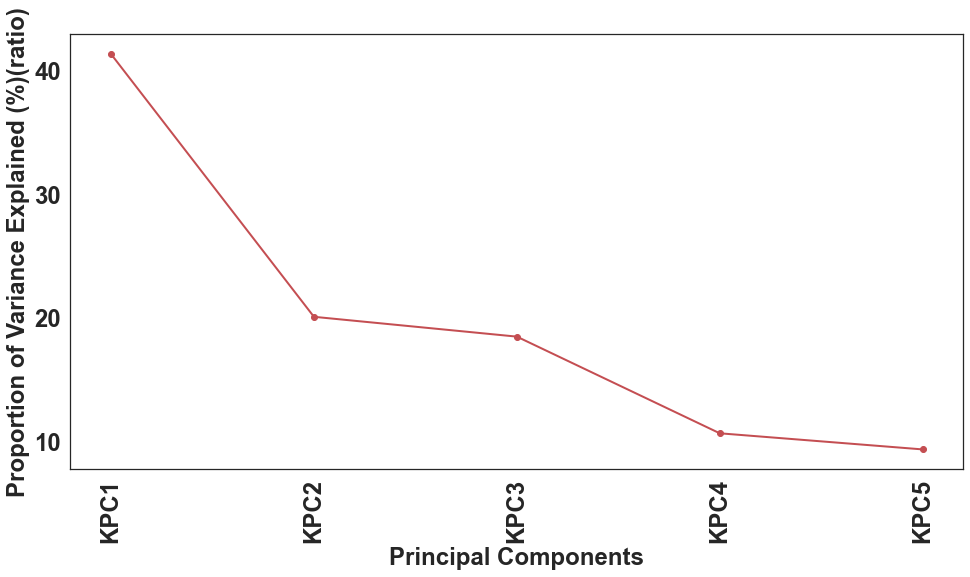

In [440]:
# get scree plot (for scree or elbow test)
#Scree plot will be saved in the same directory with name screeplot.png
plt.figure(figsize=(16,8))
plt.plot(kpc_list_15EIS, np.round(explained_variance_ratio_15EIS*100, decimals=1), 'ro-', linewidth=2)
plt.xticks(fontsize=24, rotation=90)
plt.yticks(fontsize=24)
#plt.title('Elbow Plot' , fontsize=18)
plt.xlabel('Principal Components' , fontsize=24)
plt.ylabel('Proportion of Variance Explained (%)(ratio)' , fontsize=24)
plt.show()

In [441]:
kpca_15EIS_new[1]

array([-0.12782482,  0.09071764,  0.01890932, -0.02907977, -0.14243868])

In [442]:
df_kpca_15EIS_new = pd.DataFrame({'kpc1':kpca_15EIS_new[:,0], 'kpc2': kpca_15EIS_new[:,1],
                                'kpc3':kpca_15EIS_new[:,2],'kpc4':kpca_15EIS_new[:,3],
                                'kpc5':kpca_15EIS_new[:,4],
                                 'target':target})

In [443]:
df_kpca_15EIS_new

,kpc1,kpc2,kpc3,kpc4,kpc5,target
0,-0.125566,0.089232,0.019756,-0.030208,-0.144936,AMPHIBOLE
1,-0.127825,0.090718,0.018909,-0.029080,-0.142439,SILICA
2,-0.128306,0.090943,0.017910,-0.028199,-0.140412,AMPHIBOLE
3,-0.128812,0.091298,0.017779,-0.027971,-0.140022,AMPHIBOLE
4,-0.132645,0.093915,0.017113,-0.026478,-0.137791,AMPHIBOLE
5,-0.132810,0.094459,0.017947,-0.026937,-0.140428,AMPHIBOLE
6,-0.129586,0.092349,0.019584,-0.028812,-0.144537,SILICA
7,-0.133324,0.095155,0.018359,-0.027218,-0.141013,AMPHIBOLE
8,-0.133261,0.094864,0.017997,-0.026811,-0.140598,SILICA
9,-0.134804,0.095915,0.018095,-0.026549,-0.140158,AMPHIBOLE


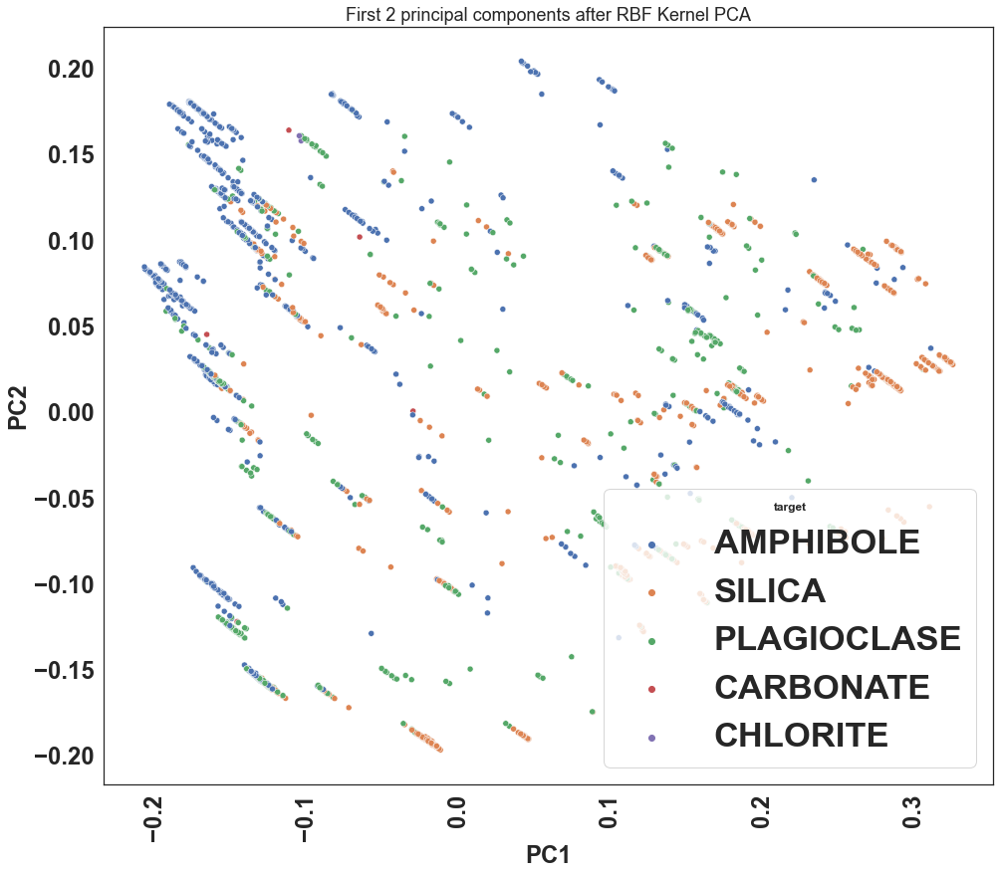

In [444]:
plt.figure(figsize=(16,14))
#plt.scatter(df_kpca_15EIS_new['kpc1'],df_kpca_15EIS_new['kpc2'], color='red', alpha=0.5)
#plt.scatter(kpca_15EIS_new[:,1], kpca_15EIS_new[:,2], color='blue', alpha=0.5)
#plt.scatter(kpca_15EIS_new[:,2], kpca_15EIS_new[:,0], color='g', alpha=0.5)
#plt.scatter(kpca_15EIS_new[3], kpca_15EIS_new[4], color='k', alpha=0.5)
#plt.scatter(kpca_15EIS_new[4], kpca_15EIS_new[5], color='k', alpha=0.5)
#plt.scatter(kpca_15EIS_new[5], kpca_15EIS_new[0], color='y', alpha=0.5)
sns.scatterplot(x="kpc1",y="kpc2",
                hue="target",
#                palette=['purple','red','orange','brown','blue',
#                       'dodgerblue','green','lightgreen','darkcyan', 'black','yellow','pink','rasberry','gray'],
                data=df_kpca_15EIS_new)
plt.title('First 2 principal components after RBF Kernel PCA', fontsize=18)
#plt.text(-0.18, 0.18, 'gamma = 15', fontsize=12)
plt.xticks(fontsize=24, rotation=90)
plt.yticks(fontsize=24)
plt.xlabel('PC1', fontsize=24)
plt.ylabel('PC2', fontsize=24)
plt.show()

# t-SNE for dimensional reduction

In [445]:
from sklearn.manifold import TSNE
#tsne = TSNE(n_components=2, random_state=0, perplexity=50, n_iter=4000, learning_rate=500)
tsne = TSNE(n_components=2, verbose=1, perplexity=50, n_iter=5000, learning_rate=200)

In [446]:

tsne_15EIS= tsne.fit_transform(df_comb15EIS_X)

[t-SNE] Computing 151 nearest neighbors...
[t-SNE] Indexed 2409 samples in 0.107s...
[t-SNE] Computed neighbors for 2409 samples in 1.094s...
[t-SNE] Computed conditional probabilities for sample 1000 / 2409
[t-SNE] Computed conditional probabilities for sample 2000 / 2409
[t-SNE] Computed conditional probabilities for sample 2409 / 2409
[t-SNE] Mean sigma: 0.284984
[t-SNE] KL divergence after 250 iterations with early exaggeration: 55.460896
[t-SNE] KL divergence after 5000 iterations: 0.281520


In [447]:

tsne_15EIS

array([[ 23.327341,  29.500841],
       [ 23.440708,  29.600672],
       [ 22.9037  ,  29.506977],
       ...,
       [ 40.620438, -28.32048 ],
       [ 42.05987 , -28.60537 ],
       [ 42.020382, -28.578417]], dtype=float32)

In [448]:
df_tsne_15EIS = pd.DataFrame({'X':tsne_15EIS[:,0], 'Y':tsne_15EIS[:,1],
                                 'target':target})

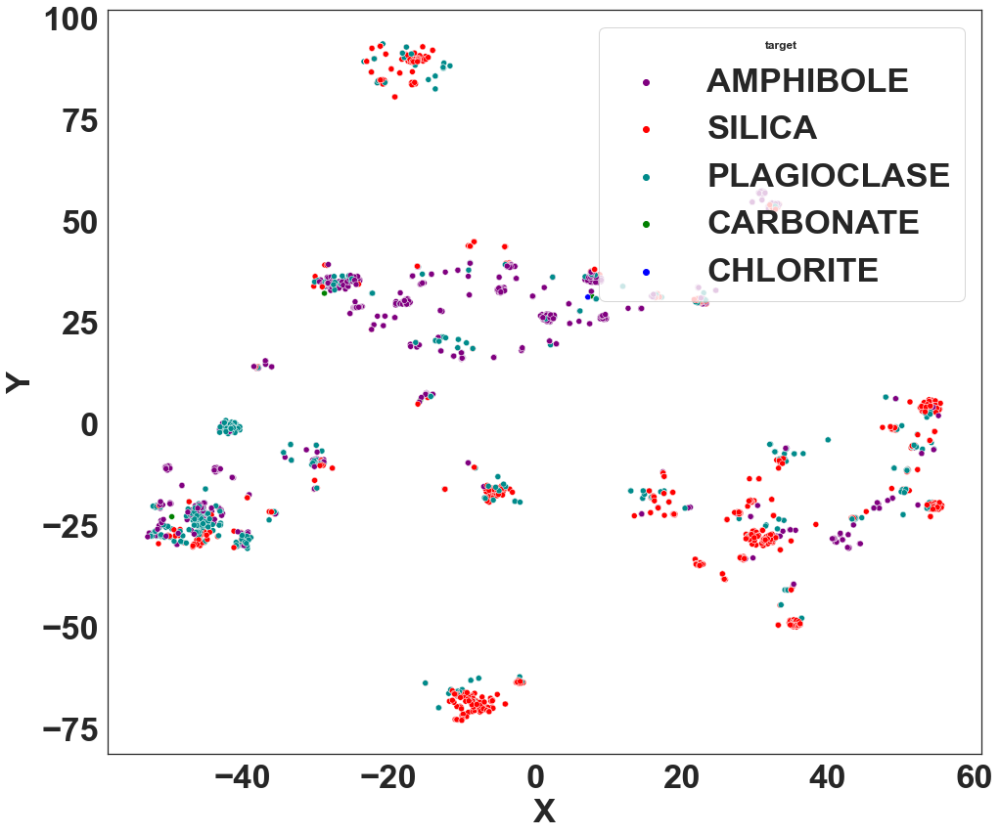

In [449]:
plt.figure(figsize=(16,14))
sns.scatterplot(x="X", y="Y",
              hue="target",
#                palette=['purple','red','orange','brown','blue',
#                         'dodgerblue','green','lightgreen','darkcyan', 'black','yellow','pink','rasberry'],
                palette=['purple','red','darkcyan','green','blue'],
              legend=('full'),
              data=df_tsne_15EIS);

# Multi-Correspondence Analysis (MCA) for Categorical data

In [450]:
# https://datascienceplus.com/selecting-categorical-features-in-customer-attrition-prediction-using-python/
# https://nextjournal.com/pc-methods/calculate-pc-mixed-data
# https://www.ritchieng.com/machine-learning-project-customer-segments/

In [451]:
import prince # for multiple correspondence analysis
from sklearn.feature_selection import SelectKBest, chi2 # for chi-squared feature selection
from sklearn.preprocessing import LabelEncoder, OrdinalEncoder

In [452]:
print("The original data set contains: {} rows and {} columns".format(cat_df2_15EIS.shape[0], cat_df2_15EIS.shape[1]))
print("Features of the original data set:\n", list(cat_df2_15EIS.columns))

The original data set contains: 2409 rows and 10 columns
Features of the original data set:
 ['Alt1_code', 'DS_U_grp', 'DS_U_mnrl', 'Lith1_code', 'Lith1_grnsz', 'Lith1_strctInt', 'Lith1-strct', 'Lith1_textr', 'Sulph1_code', 'Sulph1_style']


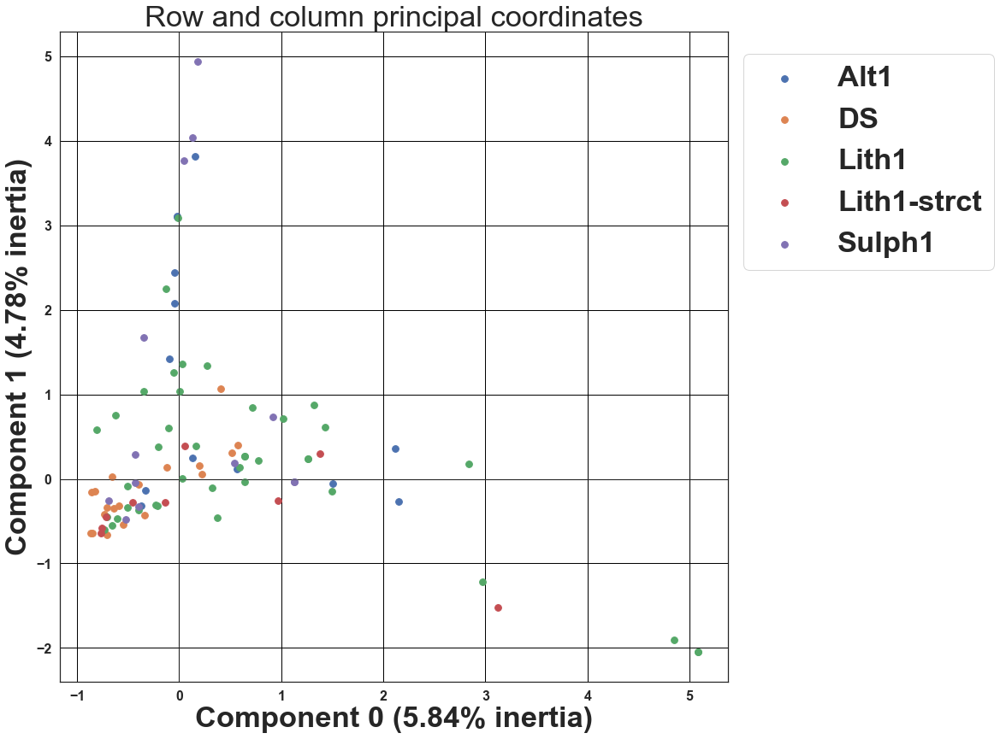

In [453]:
mca = prince.MCA(
        n_components=2,
        n_iter=50,
        copy=True,
        check_input=True,
        engine='auto',
        random_state=42
        )
mca_15EIS = mca.fit(cat_df2_15EIS)

ax = mca_15EIS.plot_coordinates(
        X=cat_df2_15EIS,
        ax=None,
        figsize=(14, 14),
        show_row_points=False,
        row_points_size=0,
        show_row_labels=False,
        show_column_points=True,
        column_points_size=60,
        show_column_labels=False,
        legend_n_cols=1
               ).legend(loc='center left', bbox_to_anchor=(1, 0.8))
plt.xticks(fontsize=16,weight='bold')
plt.yticks(fontsize=16,weight='bold')
plt.show()

In [454]:
cat_df2_15EIS_dummies = pd.get_dummies(cat_df2_15EIS, drop_first=True)

In [455]:
print(cat_df2_15EIS_dummies.shape)
print("The data set contains: {} rows and {} columns".format(cat_df2_15EIS_dummies.shape[0], cat_df2_15EIS_dummies.shape[1]))
print("Features after get_dummies:\n", list(cat_df2_15EIS_dummies.columns))

(2409, 85)
The data set contains: 2409 rows and 85 columns
Features after get_dummies:
 ['Alt1_code_ab', 'Alt1_code_ascb_m', 'Alt1_code_ascb_s', 'Alt1_code_ascb_w', 'Alt1_code_bi', 'Alt1_code_ch', 'Alt1_code_ep', 'Alt1_code_he', 'Alt1_code_hemag', 'Alt1_code_sacb', 'Alt1_code_si', 'Alt1_code_sl', 'DS_U_grp_CARBONATE', 'DS_U_grp_CHLORITE', 'DS_U_grp_PLAGIOCLASE', 'DS_U_grp_SILICA', 'DS_U_mnrl_AmphiboleML48', 'DS_U_mnrl_Andesine', 'DS_U_mnrl_Calcite', 'DS_U_mnrl_Chlorite', 'DS_U_mnrl_Dolomite', 'DS_U_mnrl_Edenite', 'DS_U_mnrl_Hornblende', 'DS_U_mnrl_Kaolinite', 'DS_U_mnrl_Labradorite', 'DS_U_mnrl_Oligoclase', 'DS_U_mnrl_Prehnite', 'DS_U_mnrl_Quartz', 'DS_U_mnrl_Siderite', 'Lith1_code_Ab', 'Lith1_code_Abu', 'Lith1_code_Ado', 'Lith1_code_Agp', 'Lith1_code_Agpf', 'Lith1_code_Agpq', 'Lith1_code_Agpy', 'Lith1_code_Agt', 'Lith1_code_Aia', 'Lith1_code_Ait', 'Lith1_code_Aiu', 'Lith1_code_Aivc', 'Lith1_code_Ala', 'Lith1_code_Aou', 'Lith1_code_Asb', 'Lith1_code_Asc', 'Lith1_code_Xobs', 'Lith1_grns

In [456]:
#X_mca = cat_df2_15EIS_dummies.drop('DS_U_mnrl_Quartz', axis=1) # input categorical features
#y_mca = cat_df2_15EIS_dummies['DS_U_mnrl_Quartz'] # target variable

In [457]:
cat_df2_15EIS_dummies.columns

Index(['Alt1_code_ab', 'Alt1_code_ascb_m', 'Alt1_code_ascb_s',
       'Alt1_code_ascb_w', 'Alt1_code_bi', 'Alt1_code_ch', 'Alt1_code_ep',
       'Alt1_code_he', 'Alt1_code_hemag', 'Alt1_code_sacb', 'Alt1_code_si',
       'Alt1_code_sl', 'DS_U_grp_CARBONATE', 'DS_U_grp_CHLORITE',
       'DS_U_grp_PLAGIOCLASE', 'DS_U_grp_SILICA', 'DS_U_mnrl_AmphiboleML48',
       'DS_U_mnrl_Andesine', 'DS_U_mnrl_Calcite', 'DS_U_mnrl_Chlorite',
       'DS_U_mnrl_Dolomite', 'DS_U_mnrl_Edenite', 'DS_U_mnrl_Hornblende',
       'DS_U_mnrl_Kaolinite', 'DS_U_mnrl_Labradorite', 'DS_U_mnrl_Oligoclase',
       'DS_U_mnrl_Prehnite', 'DS_U_mnrl_Quartz', 'DS_U_mnrl_Siderite',
       'Lith1_code_Ab', 'Lith1_code_Abu', 'Lith1_code_Ado', 'Lith1_code_Agp',
       'Lith1_code_Agpf', 'Lith1_code_Agpq', 'Lith1_code_Agpy',
       'Lith1_code_Agt', 'Lith1_code_Aia', 'Lith1_code_Ait', 'Lith1_code_Aiu',
       'Lith1_code_Aivc', 'Lith1_code_Ala', 'Lith1_code_Aou', 'Lith1_code_Asb',
       'Lith1_code_Asc', 'Lith1_code_Xobs', 'L

In [458]:
X_mca = cat_df2_15EIS_dummies.drop('DS_U_grp_SILICA', axis=1) # input categorical features
y_mca = cat_df2_15EIS_dummies['DS_U_grp_SILICA'] # target variable

In [459]:
# categorical feature selection
sf = SelectKBest(chi2, k='all')
sf_fit = sf.fit(X_mca, y_mca)
# print feature scores
for i in range(len(sf_fit.scores_)):
    print(' %s: %f' % (X_mca.columns[i], sf_fit.scores_[i]))

 Alt1_code_ab: 5.032011
 Alt1_code_ascb_m: 21.880167
 Alt1_code_ascb_s: 39.926165
 Alt1_code_ascb_w: 13.019386
 Alt1_code_bi: 0.748742
 Alt1_code_ch: 80.732465
 Alt1_code_ep: 2.627235
 Alt1_code_he: 1.970426
 Alt1_code_hemag: 7.657494
 Alt1_code_sacb: 5.470042
 Alt1_code_si: 17.195878
 Alt1_code_sl: 166.750146
 DS_U_grp_CARBONATE: 3.940853
 DS_U_grp_CHLORITE: 1.313618
 DS_U_grp_PLAGIOCLASE: 386.860385
 DS_U_mnrl_AmphiboleML48: 18.390646
 DS_U_mnrl_Andesine: 0.656809
 DS_U_mnrl_Calcite: 0.656809
 DS_U_mnrl_Chlorite: 1.970426
 DS_U_mnrl_Dolomite: 0.656809
 DS_U_mnrl_Edenite: 174.054333
 DS_U_mnrl_Hornblende: 166.172627
 DS_U_mnrl_Kaolinite: 0.656809
 DS_U_mnrl_Labradorite: 63.053645
 DS_U_mnrl_Oligoclase: 28.899587
 DS_U_mnrl_Prehnite: 0.656809
 DS_U_mnrl_Quartz: 241.429491
 DS_U_mnrl_Siderite: 1.970426
 Lith1_code_Ab: 17.135465
 Lith1_code_Abu: 373.825291
 Lith1_code_Ado: 1.970426
 Lith1_code_Agp: 0.179322
 Lith1_code_Agpf: 1.522513
 Lith1_code_Agpq: 0.049916
 Lith1_code_Agpy: 3.553127


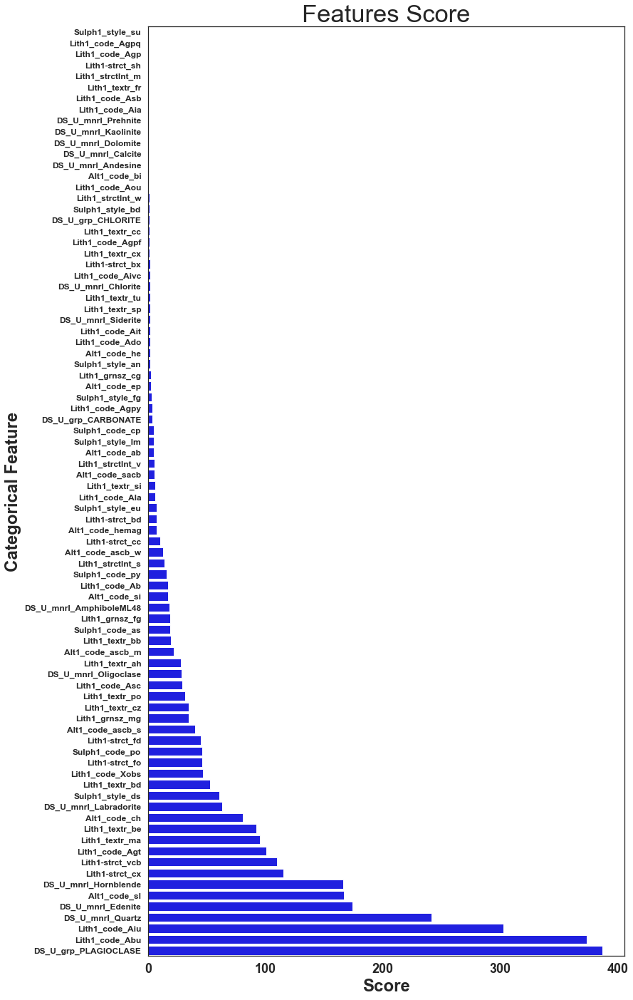

In [460]:
# plot the scores
plt.figure(figsize=(12,24))
datset_mca = pd.DataFrame()
datset_mca['feature'] = X_mca.columns[ range(len(sf_fit.scores_))]
datset_mca['scores'] = sf_fit.scores_
datset_mca = datset_mca.sort_values(by='scores', ascending=True)
sns.barplot(datset_mca['scores'], datset_mca['feature'], color='blue')
sns.set_style('whitegrid')
plt.xticks(fontsize=18,weight='bold')
plt.yticks(fontsize=12,weight='bold')
plt.ylabel('Categorical Feature', fontsize=24,weight='bold')
plt.xlabel('Score', fontsize=24, weight='bold')
plt.title('Features Score')
plt.show()

### scikit-learn OrdinalEncoder() / LabelEncoder()
The OrdinalEncoder() and LabelEnocder() from the scikit-learn library can be used to encode each categorical feature to 
integers. First separate input features from target variable column using the code below.

In [461]:
#X1_mca = cat_df2_15EIS.drop('DS_U_mnrl', axis=1) # input features
#y1_mca = cat_df2_15EIS['DS_U_mnrl'] # target variable

In [462]:
X1_mca = cat_df2_15EIS.drop('DS_U_grp', axis=1) # input features
y1_mca = cat_df2_15EIS['DS_U_grp'] # target variable

In [463]:
# prepare input features
oe_mca = OrdinalEncoder()
oe_mca.fit(X1_mca)
X_enc_mca = oe_mca.transform(X1_mca)

# prepare target variable
le_mca = LabelEncoder()
le_mca.fit(y1_mca)
y_enc_mca = le_mca.transform(y1_mca)

In [464]:
# feature selection
sf_mca = SelectKBest(chi2, k='all')
sf_fit1_mca = sf_mca.fit(X_enc_mca, y_enc_mca)
# print feature scores
for i in range(len(sf_fit1_mca.scores_)):
    print(' %s: %f' % (X1_mca.columns[i], sf_fit1_mca.scores_[i]))

 Alt1_code: 110.157689
 DS_U_mnrl: 612.429677
 Lith1_code: 3308.882606
 Lith1_grnsz: 4.280677
 Lith1_strctInt: 30.054231
 Lith1-strct: 5.117237
 Lith1_textr: 130.812921
 Sulph1_code: 231.689398
 Sulph1_style: 184.231056


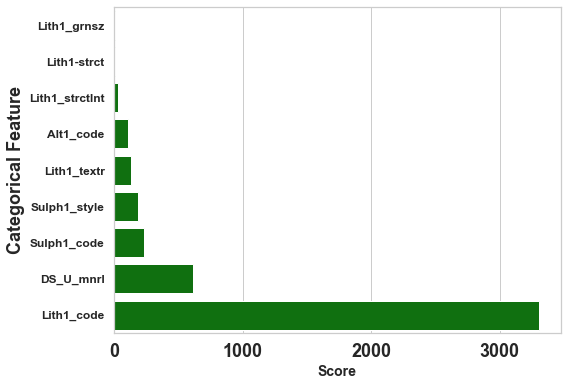

In [465]:
# plot the scores of features
plt.figure(figsize=(8,6))
datset1_mca = pd.DataFrame()
datset1_mca['feature'] = X1_mca.columns[ range(len(sf_fit1_mca.scores_))]
datset1_mca['scores'] = sf_fit1_mca.scores_
datset1_mca = datset1_mca.sort_values(by='scores', ascending=True)
sns.barplot(datset1_mca['scores'], datset1_mca['feature'], color='green')
sns.set_style('whitegrid')
plt.xticks(fontsize=18,weight='bold')
plt.yticks(fontsize=12,weight='bold')
plt.ylabel('Categorical Feature', fontsize=18,weight='bold')
plt.xlabel('Score', fontsize=14, weight='bold')
plt.show()

## Factor Analysis of Mixed Data (FAMD)

In [466]:
# https://github.com/MaxHalford/Prince#factor-analysis-of-mixed-data-famd

In [467]:
num_df2_15EIS_fillna.head()

,Felsic_mfc_idx,Felsic_mfc_Rmean,ResDeep,SSD_gcc,Susp_SI,Depth_m,Vel_geomean,Vel_std
0,9555.8535,9556.0693,0.437919,3.134581,-0.002080,495.81237,7316.656200,12.472190
1,9649.8671,9671.0957,0.675465,3.108093,0.003907,496.27307,7316.656200,12.472190
2,9743.6796,9735.1005,1.123893,3.109071,-0.000964,496.74954,6002.075272,23.609871
3,9750.4863,9758.8183,128.968990,3.107897,-0.002750,497.28299,6002.075272,23.609871
4,9834.6845,9831.6513,1093.363500,3.147212,0.007615,497.72323,6389.984300,14.142135


In [468]:
cat_df2_15EIS.head()

,Alt1_code,DS_U_grp,DS_U_mnrl,Lith1_code,Lith1_grnsz,Lith1_strctInt,Lith1-strct,Lith1_textr,Sulph1_code,Sulph1_style
0,ch,AMPHIBOLE,Quartz,Abu,fg,v,sh,ma,py,ds
1,ch,SILICA,Quartz,Abu,fg,v,sh,ma,py,ds
2,ch,AMPHIBOLE,Quartz,Abu,fg,v,sh,ma,py,ds
3,ch,AMPHIBOLE,Quartz,Abu,fg,v,sh,ma,py,ds
4,ch,AMPHIBOLE,Quartz,Abu,fg,v,sh,ma,py,ds


In [469]:
df_mixdata_15EIS = pd.concat([cat_df2_15EIS,scaled_num_df2_15EIS_fillna],axis=1)

In [470]:
df_mixdata_15EIS.head()

,Alt1_code,DS_U_grp,DS_U_mnrl,Lith1_code,Lith1_grnsz,Lith1_strctInt,Lith1-strct,Lith1_textr,Sulph1_code,Sulph1_style,Felsic_mfc_idx,Felsic_mfc_Rmean,ResDeep,SSD_gcc,Susp_SI,Depth_m,Vel_geomean,Vel_std
0,ch,AMPHIBOLE,Quartz,Abu,fg,v,sh,ma,py,ds,0.510125,0.509152,0.000000,0.763027,0.004504,0.000000,0.937945,0.214843
1,ch,SILICA,Quartz,Abu,fg,v,sh,ma,py,ds,0.569692,0.581917,0.000019,0.737739,0.044752,0.000382,0.937945,0.214843
2,ch,AMPHIBOLE,Quartz,Abu,fg,v,sh,ma,py,ds,0.629132,0.622406,0.000054,0.738673,0.012007,0.000778,0.665967,0.523274
3,ch,AMPHIBOLE,Quartz,Abu,fg,v,sh,ma,py,ds,0.633445,0.637410,0.010180,0.737552,0.000000,0.001220,0.665967,0.523274
4,ch,AMPHIBOLE,Quartz,Abu,fg,v,sh,ma,py,ds,0.686793,0.683484,0.086563,0.775085,0.069683,0.001585,0.746222,0.261088


In [471]:
df_mixdata_15EIS.columns.values

array(['Alt1_code', 'DS_U_grp', 'DS_U_mnrl', 'Lith1_code', 'Lith1_grnsz',
       'Lith1_strctInt', 'Lith1-strct', 'Lith1_textr', 'Sulph1_code',
       'Sulph1_style', 'Felsic_mfc_idx', 'Felsic_mfc_Rmean', 'ResDeep',
       'SSD_gcc', 'Susp_SI', 'Depth_m', 'Vel_geomean', 'Vel_std'],
      dtype=object)

In [472]:
X1_famd = df_mixdata_15EIS.drop('DS_U_mnrl', axis=1) # input features
y1_famd = df_mixdata_15EIS['DS_U_mnrl'] # target variable

In [473]:
#X1_famd = df_mixdata_15EIS.drop('DS_U_grp', axis=1) # input features
#y1_famd = df_mixdata_15EIS['DS_U_grp'] # target variable

In [474]:
X1_famd.head()

,Alt1_code,DS_U_grp,Lith1_code,Lith1_grnsz,Lith1_strctInt,Lith1-strct,Lith1_textr,Sulph1_code,Sulph1_style,Felsic_mfc_idx,Felsic_mfc_Rmean,ResDeep,SSD_gcc,Susp_SI,Depth_m,Vel_geomean,Vel_std
0,ch,AMPHIBOLE,Abu,fg,v,sh,ma,py,ds,0.510125,0.509152,0.000000,0.763027,0.004504,0.000000,0.937945,0.214843
1,ch,SILICA,Abu,fg,v,sh,ma,py,ds,0.569692,0.581917,0.000019,0.737739,0.044752,0.000382,0.937945,0.214843
2,ch,AMPHIBOLE,Abu,fg,v,sh,ma,py,ds,0.629132,0.622406,0.000054,0.738673,0.012007,0.000778,0.665967,0.523274
3,ch,AMPHIBOLE,Abu,fg,v,sh,ma,py,ds,0.633445,0.637410,0.010180,0.737552,0.000000,0.001220,0.665967,0.523274
4,ch,AMPHIBOLE,Abu,fg,v,sh,ma,py,ds,0.686793,0.683484,0.086563,0.775085,0.069683,0.001585,0.746222,0.261088


In [475]:
#X1_15EIS.head()

In [476]:
## Fit FAMD object to data
famd_15EIS = prince.FAMD(n_components=2,n_iter=3,copy=True,check_input=True,engine='auto',random_state=42)
famd_15EIS = famd_15EIS.fit(X1_famd)

In [477]:
# The FAMD inherits from the MFA class, which entails that you have access to all it's methods and properties. 
# The row_coordinates method will return the global coordinates.
famd_15EIS.row_coordinates(X1_famd).head()

,0,1
0,-0.963899,-0.015948
1,-0.804238,-0.095958
2,-0.968837,0.041718
3,-0.978388,0.059382
4,-1.227165,-0.012280


In [478]:
#import pprint

In [479]:
## Inspect principal dimensions
print(famd_15EIS.explained_inertia_) 

[0.12370949 0.05429926]


In [480]:
print(famd_15EIS.eigenvalues_)

[0.00069255 0.00030398]


In [481]:
print(famd_15EIS.total_inertia_)

0.005598192190589648


In [482]:
#print(famd_15EIS.row_contributions(X1_famd))

In [483]:
for name, fa in sorted(famd_15EIS.partial_factor_analysis_.items()):
                       print('{} eigenvalues: {}'.format(name, fa.eigenvalues_))

Categorical eigenvalues: [0.5412796668213129, 0.437829700540831]
Numerical eigenvalues: [0.00162837 0.00043051]


In [484]:
y1_famd.values

array(['Quartz', 'Quartz', 'Quartz', ..., 'Edenite', 'Hornblende',
       'Hornblende'], dtype=object)

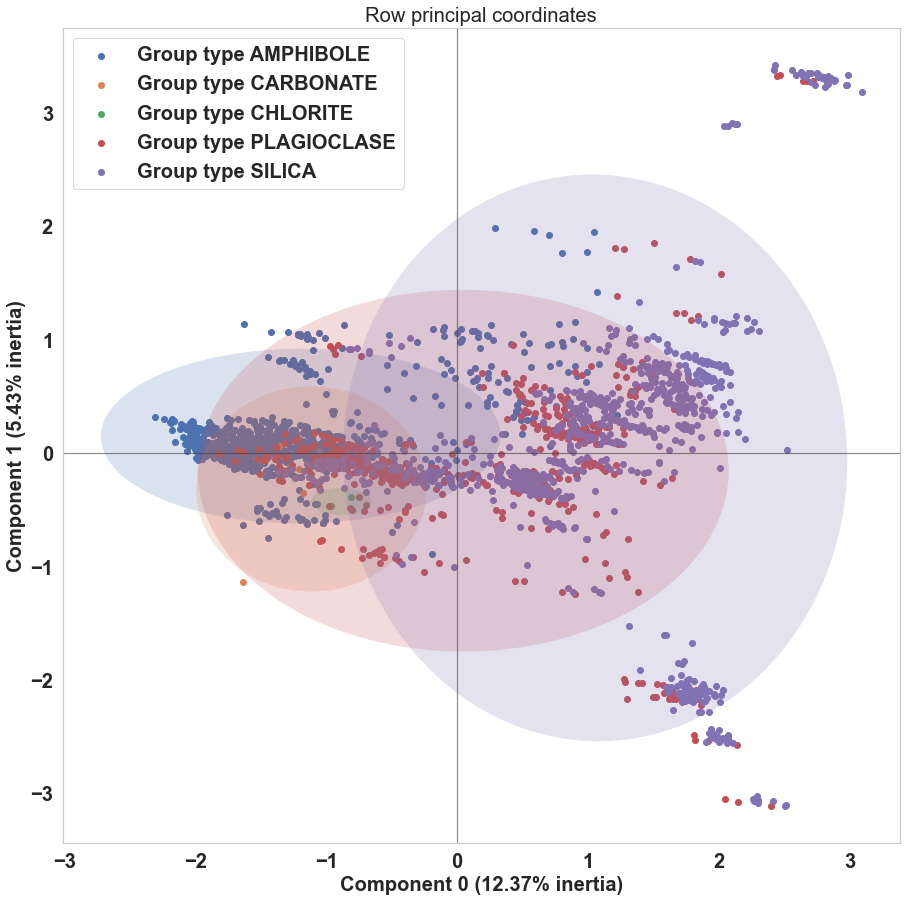

In [485]:
plt.rcParams["font.size"] = "14"
ax = famd_15EIS.plot_row_coordinates(
    X1_famd,
    ax=None,
    figsize=(15, 15),
    x_component=0,
    y_component=1,
#    labels=y1_famd.values,
    color_labels=['Group type {}'.format(t) for t in X1_famd['DS_U_grp']],
    ellipse_outline=False,
    ellipse_fill=True,
    show_points=True
)

In [486]:
# Compute correlations
print('correlations : {}'.format(famd_15EIS.column_correlations(df_mixdata_15EIS)))

correlations :                              0         1
Alt1_code_Xobs        0.044553  0.171589
Alt1_code_ab          0.053386 -0.154803
Alt1_code_ascb_m      0.178200 -0.300082
Alt1_code_ascb_s      0.281502 -0.488557
Alt1_code_ascb_w      0.129237 -0.206468
Alt1_code_bi         -0.024884  0.039937
Alt1_code_ch         -0.586434  0.146715
Alt1_code_ep          0.045403 -0.006981
Alt1_code_he          0.007222  0.029392
Alt1_code_hemag       0.080377 -0.149814
Alt1_code_sacb        0.085983 -0.124944
Alt1_code_si          0.116293  0.032055
Alt1_code_sl          0.411248  0.195857
DS_U_grp_AMPHIBOLE   -0.712925  0.534468
DS_U_grp_CARBONATE   -0.039425  0.012896
DS_U_grp_CHLORITE    -0.019301 -0.010521
DS_U_grp_PLAGIOCLASE  0.047963 -0.056625
DS_U_grp_SILICA       0.660756 -0.474029
Depth_m               0.847256 -0.149685
Felsic_mfc_Rmean     -0.927843  0.742938
Felsic_mfc_idx       -0.927450  0.743052
Lith1-strct_Xobs      0.128102  0.231197
Lith1-strct_bd        0.048585 -0.084148
L

In [487]:
#(famd_15EIS.column_correlations(df_mixdata_15EIS))

<span style="font-family: Bold; font-size:3.5em;color:red;"> Splitting drill core data every 125m depth interval </p>

<span style="font-family: Bold; font-size:3.5em;color:blue;"> dd001 </p>

In [488]:
# Categorical data
cat_df2_dd001=df2_001.select_dtypes(include=['object'].copy())

In [489]:
# Numerical data
num_df2_dd001=df2_001.select_dtypes(include=['float64'].copy())

In [490]:
# Filling null values in numerical data
num_df2_dd001_fillna=num_df2_dd001.apply(lambda x: x.fillna(x.mean()),axis=0)

In [491]:
print(num_df2_dd001_fillna.shape)
print(cat_df2_dd001.isnull().sum())

(669, 4)
Alt1_code         0
DS_U_grp          0
DS_U_mnrl         0
Lith1_code        0
Lith1_grnsz       0
Lith1_strctInt    0
Lith1-strct       0
Lith1_textr       0
Sulph1_code       0
dtype: int64


In [492]:
cat_df2_dd001.columns

Index(['Alt1_code', 'DS_U_grp', 'DS_U_mnrl', 'Lith1_code', 'Lith1_grnsz',
       'Lith1_strctInt', 'Lith1-strct', 'Lith1_textr', 'Sulph1_code'],
      dtype='object')

In [493]:
# dropping target from the dataframe
cat_df3_dd001=cat_df2_dd001.drop(['DS_U_grp'], axis=1)

In [494]:
# splitting dataframe every 125m depth interval (~250 rows in dataframe) for Drill Hole 15EIS (Starting depth from surface 495m and end depth 620m)
df2_dd001_1 = df2_001.iloc[:250,:]
df2_dd001_2 = df2_001.iloc[251:500,:]
df2_dd001_3 = df2_001.iloc[501:750,:]

In [495]:
# Split Categorical data
cat_df2_dd001_1 = df2_dd001_1.select_dtypes(include=['object'].copy())
cat_df2_dd001_2 = df2_dd001_2.select_dtypes(include=['object'].copy())
cat_df2_dd001_3 = df2_dd001_3.select_dtypes(include=['object'].copy())

In [496]:
# Split Numerical data
num_df2_dd001_1 = num_df2_dd001_fillna.iloc[:250,:]
num_df2_dd001_2 = num_df2_dd001_fillna.iloc[251:500,:]
num_df2_dd001_3 = num_df2_dd001_fillna.iloc[501:750,:]

In [497]:
# Imputing zeroes with mean 
num_df2_dd001_1_fillna= num_df2_dd001_1.apply(lambda x: x.fillna(x.mean()),axis=0)
num_df2_dd001_2_fillna= num_df2_dd001_2.apply(lambda x: x.fillna(x.mean()),axis=0)
num_df2_dd001_3_fillna= num_df2_dd001_3.apply(lambda x: x.fillna(x.mean()),axis=0)

In [498]:
# Applying scalar to the numerical data
scaled_num_df2_dd001_1_fillna = pd.DataFrame(scaler.fit_transform(num_df2_dd001_1_fillna), columns=num_df2_dd001_1_fillna.columns)
scaled_num_df2_dd001_2_fillna = pd.DataFrame(scaler.fit_transform(num_df2_dd001_2_fillna), columns=num_df2_dd001_2_fillna.columns)
scaled_num_df2_dd001_3_fillna = pd.DataFrame(scaler.fit_transform(num_df2_dd001_3_fillna), columns=num_df2_dd001_3_fillna.columns)

In [499]:
# make a copy of the categorized data 
cat_df2_dd001_1_ce_onehot = cat_df2_dd001_1.copy()
cat_df2_dd001_2_ce_onehot = cat_df2_dd001_2.copy()
cat_df2_dd001_3_ce_onehot = cat_df2_dd001_3.copy()

In [500]:
cat_df2_dd001_1_ce_onehot = pd.get_dummies(cat_df2_dd001_1_ce_onehot, columns=['Alt1_code', 'DS_U_mnrl', 'Lith1_code', 'Lith1_grnsz','Lith1_strctInt', 'Lith1-strct', 'Lith1_textr', 'Sulph1_code'], 
                                                 prefix = ['Alt1_code',  'DS_U_mnrl', 'Lith1_code', 'Lith1_grnsz','Lith1_strctInt', 'Lith1-strct', 'Lith1_textr', 'Sulph1_code']);

cat_df2_dd001_2_ce_onehot = pd.get_dummies(cat_df2_dd001_2_ce_onehot, columns=['Alt1_code', 'DS_U_mnrl', 'Lith1_code', 'Lith1_grnsz','Lith1_strctInt', 'Lith1-strct', 'Lith1_textr', 'Sulph1_code'], 
                                                 prefix = ['Alt1_code',  'DS_U_mnrl', 'Lith1_code', 'Lith1_grnsz','Lith1_strctInt', 'Lith1-strct', 'Lith1_textr', 'Sulph1_code']);

cat_df2_dd001_3_ce_onehot = pd.get_dummies(cat_df2_dd001_3_ce_onehot, columns=['Alt1_code', 'DS_U_mnrl', 'Lith1_code', 'Lith1_grnsz','Lith1_strctInt', 'Lith1-strct', 'Lith1_textr', 'Sulph1_code'], 
                                                 prefix = ['Alt1_code',  'DS_U_mnrl', 'Lith1_code', 'Lith1_grnsz','Lith1_strctInt', 'Lith1-strct', 'Lith1_textr', 'Sulph1_code']);

In [501]:
cat_df2_dd001_1_ce_onehot.reset_index(drop=True, inplace=True)
cat_df2_dd001_2_ce_onehot.reset_index(drop=True, inplace=True)
cat_df2_dd001_3_ce_onehot.reset_index(drop=True, inplace=True)

In [502]:
#cat_df2_001_1_ce_onehot.head()

In [503]:
# dropping DS_U_grp to make it target 
cat_df3_dd001_1_ce_onehot=cat_df2_dd001_1_ce_onehot.drop(['DS_U_grp'], axis=1)
cat_df3_dd001_2_ce_onehot=cat_df2_dd001_2_ce_onehot.drop(['DS_U_grp'], axis=1)
cat_df3_dd001_3_ce_onehot=cat_df2_dd001_3_ce_onehot.drop(['DS_U_grp'], axis=1)

In [504]:
# conconating caregorical and numerical variables
scaled_df_comb_dd001_1 = pd.concat([cat_df3_dd001_1_ce_onehot,scaled_num_df2_dd001_1_fillna],axis=1)
scaled_df_comb_dd001_2 = pd.concat([cat_df3_dd001_2_ce_onehot,scaled_num_df2_dd001_2_fillna],axis=1)
scaled_df_comb_dd001_3 = pd.concat([cat_df3_dd001_3_ce_onehot,scaled_num_df2_dd001_3_fillna],axis=1)

In [505]:
# Defining PCA 
df_PC_dd001_1 = PCA(n_components=10)
df_PC_dd001_2 = PCA(n_components=10)
df_PC_dd001_3 = PCA(n_components=10)

In [506]:
pca_dd001_1_out= df_PC_dd001_1.fit(scaled_df_comb_dd001_1)
pca_dd001_2_out= df_PC_dd001_2.fit(scaled_df_comb_dd001_2)
pca_dd001_3_out= df_PC_dd001_3.fit(scaled_df_comb_dd001_3)

In [507]:
pca_dd001_new_1 = df_PC_dd001_1.fit_transform(scaled_df_comb_dd001_1)
pca_dd001_new_2 = df_PC_dd001_2.fit_transform(scaled_df_comb_dd001_2)
pca_dd001_new_3 = df_PC_dd001_3.fit_transform(scaled_df_comb_dd001_3)

In [508]:
# get component loadings (correlation coefficient between original variables and the component) 
# the squared loadings within the PCs always sums to 1
loadings_dd001_1 = pca_dd001_1_out.components_
#num_pc_15EIS = pca_15EIS_out.n_features_
num_pc_dd001_1 = len(pca_dd001_1_out.explained_variance_ratio_)
pc_list_dd001_1 = ["PC"+str(i) for i in list(range(1, num_pc_dd001_1+1))]
loadings_df_dd001_1 = pd.DataFrame.from_dict(dict(zip(pc_list_dd001_1, loadings_dd001_1)))
loadings_df_dd001_1['variables'] = scaled_df_comb_dd001_1.columns.values
loadings_df_dd001_1 = loadings_df_dd001_1.set_index('variables')
#loadings_df_15EIS_1

loadings_dd001_2 = pca_dd001_2_out.components_
#num_pc_15EIS = pca_15EIS_out.n_features_
num_pc_dd001_2 = len(pca_dd001_2_out.explained_variance_ratio_)
pc_list_dd001_2 = ["PC"+str(i) for i in list(range(1, num_pc_dd001_2+1))]
loadings_df_dd001_2 = pd.DataFrame.from_dict(dict(zip(pc_list_dd001_2, loadings_dd001_2)))
loadings_df_dd001_2['variables'] = scaled_df_comb_dd001_2.columns.values
loadings_df_dd001_2 = loadings_df_dd001_2.set_index('variables')
#loadings_df_15EIS_1

loadings_dd001_3 = pca_dd001_3_out.components_
#num_pc_15EIS = pca_15EIS_out.n_features_
num_pc_dd001_3 = len(pca_dd001_3_out.explained_variance_ratio_)
pc_list_dd001_3 = ["PC"+str(i) for i in list(range(1, num_pc_dd001_3+1))]
loadings_df_dd001_3 = pd.DataFrame.from_dict(dict(zip(pc_list_dd001_3, loadings_dd001_3)))
loadings_df_dd001_3['variables'] = scaled_df_comb_dd001_3.columns.values
loadings_df_dd001_3 = loadings_df_dd001_3.set_index('variables')
#loadings_df_15EIS_1

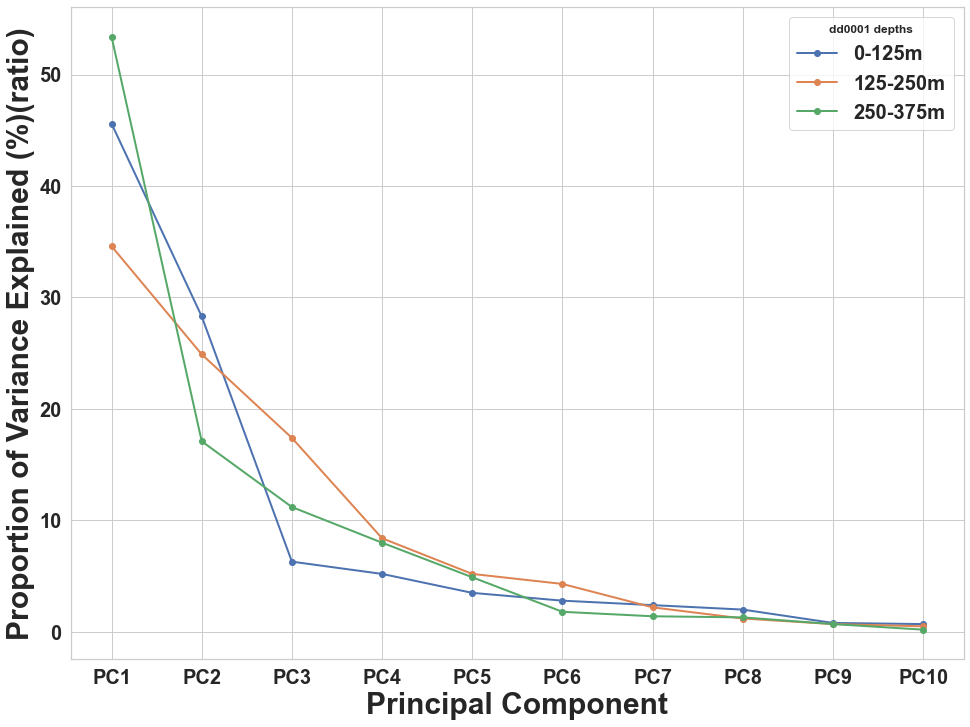

In [509]:
# get scree plot (for scree or elbow test)
#Scree plot will be saved in the same directory with name screeplot.png
plt.figure(figsize=(16,12))
plt.plot(pc_list_dd001_1, np.round(pca_dd001_1_out.explained_variance_ratio_*100, decimals=1), 'o-', linewidth=2)
plt.plot(pc_list_dd001_2, np.round(pca_dd001_2_out.explained_variance_ratio_*100, decimals=1), 'o-', linewidth=2)
plt.plot(pc_list_dd001_3, np.round(pca_dd001_3_out.explained_variance_ratio_*100, decimals=1), 'o-', linewidth=2)
plt.xticks(fontsize=20)
plt.yticks(fontsize=20)
plt.xlabel('Principal Component',fontsize=30)
plt.ylabel('Proportion of Variance Explained (%)(ratio)',fontsize=30)
plt.gca().legend(['0-125m','125-250m','250-375m'],title="dd0001 depths")
#plt.show()
plt.savefig('/UNSW/PhD/Paper_drafts/Figures/dd001_Elbowplot.png', dpi=600)

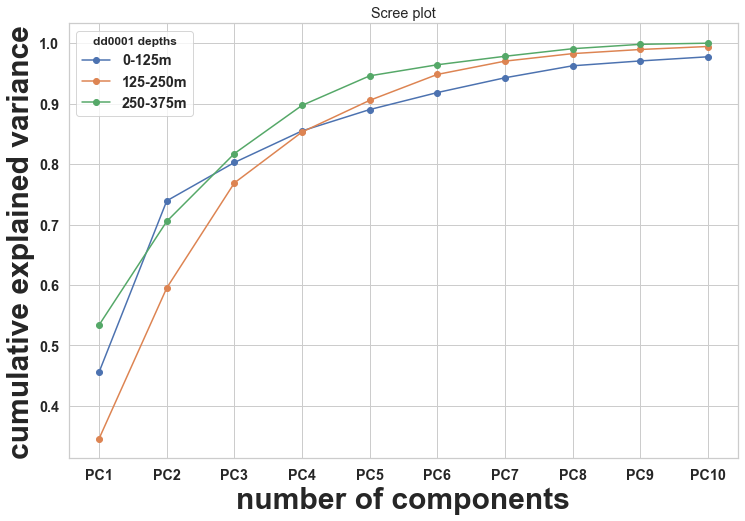

In [510]:
#Making the screeplot - plotting the cumulative variance against the number of components
%matplotlib inline
fig = plt.figure(figsize = (12,8))
#num_pc_dd001_1 = len(pca_dd001_1_out.explained_variance_ratio_)
#pc_list_dd001_1 = ["PC"+str(i) for i in list(range(1, num_pc_dd001_1+1))]
plt.plot(pc_list_dd001_1, np.cumsum(pca_dd001_1_out.explained_variance_ratio_),'o-')
plt.plot(pc_list_dd001_2, np.cumsum(pca_dd001_2_out.explained_variance_ratio_),'o-')
plt.plot(pc_list_dd001_3, np.cumsum(pca_dd001_3_out.explained_variance_ratio_),'o-')
plt.gca().legend(['0-125m','125-250m','250-375m'],title="dd0001 depths")
plt.xlabel('number of components',fontsize=30)
plt.ylabel('cumulative explained variance',fontsize=30)
plt.title('Scree plot')
#plt.show()
plt.savefig('/UNSW/PhD/Paper_drafts/Figures/dd001_Screeplot.png', dpi=600)

In [511]:
scaled_df_comb_dd001_1.columns

Index(['Alt1_code_Xobs', 'Alt1_code_ch', 'Alt1_code_he', 'DS_U_mnrl_Albite',
       'DS_U_mnrl_Chlorite', 'DS_U_mnrl_Edenite', 'DS_U_mnrl_Ferrohornblende',
       'DS_U_mnrl_Hornblende', 'DS_U_mnrl_Labradorite', 'DS_U_mnrl_Oligoclase',
       'DS_U_mnrl_Paragonite', 'DS_U_mnrl_Quartz', 'Lith1_code_Abu',
       'Lith1_code_Agm', 'Lith1_code_Vq', 'Lith1_code_Xobs',
       'Lith1_grnsz_Xobs', 'Lith1_grnsz_cg', 'Lith1_grnsz_fg',
       'Lith1_grnsz_vcg', 'Lith1_strctInt_Xobs', 'Lith1_strctInt_m',
       'Lith1_strctInt_w', 'Lith1-strct_Xobs', 'Lith1-strct_bx',
       'Lith1-strct_fo', 'Lith1_textr_Xobs', 'Lith1_textr_fr',
       'Lith1_textr_ma', 'Lith1_textr_pi', 'Lith1_textr_po',
       'Sulph1_code_Xobs', 'Sulph1_code_cp', 'Sulph1_code_py',
       'Felsic_mfc_Rmean', 'Depth_m', 'Vel_geomean', 'Au_ppm'],
      dtype='object')

In [512]:
# number of components
n_pcs_dd001_1= pca_dd001_1_out.components_.shape[0]
#n_pcs_15EIS_1


# get the index of the most important feature on EACH component i.e. largest absolute value
# using LIST COMPREHENSION HERE
most_important_dd001_1 = [np.abs(pca_dd001_1_out.components_[i]).argmax() for i in range(n_pcs_dd001_1)]

initial_features_names_dd001_1 =['Alt1_code_Xobs', 'Alt1_code_ch', 'Alt1_code_he', 'DS_U_mnrl_Albite',
       'DS_U_mnrl_Chlorite', 'DS_U_mnrl_Edenite', 'DS_U_mnrl_Ferrohornblende',
       'DS_U_mnrl_Hornblende', 'DS_U_mnrl_Labradorite', 'DS_U_mnrl_Oligoclase',
       'DS_U_mnrl_Paragonite', 'DS_U_mnrl_Quartz', 'Lith1_code_Abu',
       'Lith1_code_Agm', 'Lith1_code_Vq', 'Lith1_code_Xobs',
       'Lith1_grnsz_Xobs', 'Lith1_grnsz_cg', 'Lith1_grnsz_fg',
       'Lith1_grnsz_vcg', 'Lith1_strctInt_Xobs', 'Lith1_strctInt_m',
       'Lith1_strctInt_w', 'Lith1-strct_Xobs', 'Lith1-strct_bx',
       'Lith1-strct_fo', 'Lith1_textr_Xobs', 'Lith1_textr_fr',
       'Lith1_textr_ma', 'Lith1_textr_pi', 'Lith1_textr_po',
       'Sulph1_code_Xobs', 'Sulph1_code_cp', 'Sulph1_code_py',
       'Felsic_mfc_Rmean', 'Depth_m', 'Vel_geomean', 'Au_ppm']

# get the names
most_important_names_dd001_1 = [initial_features_names_dd001_1[most_important_dd001_1[i]] for i in range(n_pcs_dd001_1)]

# using LIST COMPREHENSION HERE AGAIN
dic_dd001_1 = {'dd001_1_PC{}'.format(i+1): most_important_names_15EIS_1[i] for i in range(n_pcs_dd001_1)}

# build the dataframe
df_imp_features_dd001_1 = pd.DataFrame((dic_dd001_1.items()))

# print important features

df_imp_features_dd001_1

,0,1
0,dd001_1_PC1,Lith1-strct_sh
1,dd001_1_PC2,Lith1_strctInt_w
2,dd001_1_PC3,Lith1_strctInt_v
3,dd001_1_PC4,DS_U_mnrl_Quartz
4,dd001_1_PC5,Lith1_strctInt_s
5,dd001_1_PC6,DS_U_mnrl_Hornblende
6,dd001_1_PC7,Lith1_strctInt_w
7,dd001_1_PC8,Lith1_strctInt_m
8,dd001_1_PC9,Vel_geomean
9,dd001_1_PC10,DS_U_mnrl_Albite


In [513]:
scaled_df_comb_dd001_2.columns

Index(['Alt1_code_Xobs', 'Alt1_code_he', 'DS_U_mnrl_Albite',
       'DS_U_mnrl_Ferrohornblende', 'DS_U_mnrl_Hornblende', 'DS_U_mnrl_Quartz',
       'Lith1_code_Agm', 'Lith1_code_SHZ', 'Lith1_grnsz_cg', 'Lith1_grnsz_mg',
       'Lith1_grnsz_vcg', 'Lith1_strctInt_Xobs', 'Lith1_strctInt_m',
       'Lith1_strctInt_s', 'Lith1-strct_Xobs', 'Lith1-strct_fo',
       'Lith1_textr_pb', 'Lith1_textr_po', 'Sulph1_code_Xobs',
       'Sulph1_code_py', 'Felsic_mfc_Rmean', 'Depth_m', 'Vel_geomean',
       'Au_ppm'],
      dtype='object')

In [514]:
# number of components
n_pcs_dd001_2= pca_dd001_2_out.components_.shape[0]
#n_pcs_15EIS_1


# get the index of the most important feature on EACH component i.e. largest absolute value
# using LIST COMPREHENSION HERE
most_important_dd001_2 = [np.abs(pca_dd001_2_out.components_[i]).argmax() for i in range(n_pcs_dd001_2)]

initial_features_names_dd001_2 =['Alt1_code_Xobs', 'Alt1_code_he', 'DS_U_mnrl_Albite',
       'DS_U_mnrl_Ferrohornblende', 'DS_U_mnrl_Hornblende', 'DS_U_mnrl_Quartz',
       'Lith1_code_Agm', 'Lith1_code_SHZ', 'Lith1_grnsz_cg', 'Lith1_grnsz_mg',
       'Lith1_grnsz_vcg', 'Lith1_strctInt_Xobs', 'Lith1_strctInt_m',
       'Lith1_strctInt_s', 'Lith1-strct_Xobs', 'Lith1-strct_fo',
       'Lith1_textr_pb', 'Lith1_textr_po', 'Sulph1_code_Xobs',
       'Sulph1_code_py', 'Felsic_mfc_Rmean', 'Depth_m', 'Vel_geomean',
       'Au_ppm']

# get the names
most_important_names_dd001_2 = [initial_features_names_dd001_2[most_important_dd001_2[i]] for i in range(n_pcs_dd001_2)]

# using LIST COMPREHENSION HERE AGAIN
dic_dd001_2 = {'dd001_2_PC{}'.format(i+1): most_important_names_15EIS_2[i] for i in range(n_pcs_dd001_2)}

# build the dataframe
df_imp_features_dd001_2 = pd.DataFrame((dic_dd001_2.items()))

# print important features

df_imp_features_dd001_2

,0,1
0,dd001_2_PC1,Sulph1_code_py
1,dd001_2_PC2,Lith1_grnsz_fg
2,dd001_2_PC3,DS_U_mnrl_Edenite
3,dd001_2_PC4,DS_U_mnrl_Quartz
4,dd001_2_PC5,Lith1-strct_cx
5,dd001_2_PC6,Lith1-strct_vcb
6,dd001_2_PC7,Lith1_strctInt_s
7,dd001_2_PC8,DS_U_mnrl_AmphiboleML48
8,dd001_2_PC9,Vel_geomean
9,dd001_2_PC10,Lith1-strct_fd


In [515]:
scaled_df_comb_dd001_3.columns

Index(['Alt1_code_Xobs', 'Alt1_code_he', 'DS_U_mnrl_Albite',
       'DS_U_mnrl_Hornblende', 'DS_U_mnrl_Paragonite', 'DS_U_mnrl_Quartz',
       'Lith1_code_Agm', 'Lith1_code_Auu', 'Lith1_code_SHZ', 'Lith1_grnsz_cg',
       'Lith1_grnsz_fg', 'Lith1_strctInt_Xobs', 'Lith1_strctInt_m',
       'Lith1_strctInt_s', 'Lith1-strct_Xobs', 'Lith1-strct_fo',
       'Lith1-strct_sc', 'Lith1_textr_bd', 'Lith1_textr_po',
       'Sulph1_code_Xobs', 'Sulph1_code_py', 'Felsic_mfc_Rmean', 'Depth_m',
       'Vel_geomean', 'Au_ppm'],
      dtype='object')

In [516]:
# number of components
n_pcs_dd001_3= pca_dd001_3_out.components_.shape[0]
#n_pcs_15EIS_1


# get the index of the most important feature on EACH component i.e. largest absolute value
# using LIST COMPREHENSION HERE
most_important_dd001_3 = [np.abs(pca_dd001_3_out.components_[i]).argmax() for i in range(n_pcs_dd001_3)]

initial_features_names_dd001_3 =['Alt1_code_Xobs', 'Alt1_code_he', 'DS_U_mnrl_Albite',
       'DS_U_mnrl_Hornblende', 'DS_U_mnrl_Paragonite', 'DS_U_mnrl_Quartz',
       'Lith1_code_Agm', 'Lith1_code_Auu', 'Lith1_code_SHZ', 'Lith1_grnsz_cg',
       'Lith1_grnsz_fg', 'Lith1_strctInt_Xobs', 'Lith1_strctInt_m',
       'Lith1_strctInt_s', 'Lith1-strct_Xobs', 'Lith1-strct_fo',
       'Lith1-strct_sc', 'Lith1_textr_bd', 'Lith1_textr_po',
       'Sulph1_code_Xobs', 'Sulph1_code_py', 'Felsic_mfc_Rmean', 'Depth_m',
       'Vel_geomean', 'Au_ppm']

# get the names
most_important_names_dd001_3 = [initial_features_names_dd001_3[most_important_dd001_3[i]] for i in range(n_pcs_dd001_3)]

# using LIST COMPREHENSION HERE AGAIN
dic_dd001_3 = {'dd001_3_PC{}'.format(i+1): most_important_names_15EIS_3[i] for i in range(n_pcs_dd001_3)}

# build the dataframe
df_imp_features_dd001_3 = pd.DataFrame((dic_dd001_3.items()))

# print important features

df_imp_features_dd001_3

,0,1
0,dd001_3_PC1,Lith1_strctInt_m
1,dd001_3_PC2,Sulph1_code_py
2,dd001_3_PC3,Lith1_grnsz_fg
3,dd001_3_PC4,Alt1_code_ch
4,dd001_3_PC5,DS_U_mnrl_Quartz
5,dd001_3_PC6,Sulph1_code_cp
6,dd001_3_PC7,DS_U_mnrl_Edenite
7,dd001_3_PC8,ResDeep
8,dd001_3_PC9,DS_U_mnrl_Edenite
9,dd001_3_PC10,Alt1_code_sl


In [517]:

keys = ['Principal Components','0-125(m)', '125-250(m)','250-375(m)']
comb_impfeature_dd001 = pd.concat([d.reset_index(drop=True) for d in [df_imp_features_dd001_1[0],df_imp_features_dd001_1[1],df_imp_features_dd001_2[1],
                                                                      df_imp_features_dd001_3[1]]], axis=1, keys=keys)

comb_impfeature_dd001.head()

,Principal Components,0-125(m),125-250(m),250-375(m)
0,dd001_1_PC1,Lith1-strct_sh,Sulph1_code_py,Lith1_strctInt_m
1,dd001_1_PC2,Lith1_strctInt_w,Lith1_grnsz_fg,Sulph1_code_py
2,dd001_1_PC3,Lith1_strctInt_v,DS_U_mnrl_Edenite,Lith1_grnsz_fg
3,dd001_1_PC4,DS_U_mnrl_Quartz,DS_U_mnrl_Quartz,Alt1_code_ch
4,dd001_1_PC5,Lith1_strctInt_s,Lith1-strct_cx,DS_U_mnrl_Quartz


In [518]:
comb_impfeature_dd001.to_csv(r'dd001_impPCA_features.csv', index=False)

<span style="font-family: Bold; font-size:3.5em;color:red;"> Splitting drill core data every 125m depth interval </p>
<span style="font-family: Bold; font-size:1.0em;color:blue;"> ---  </p>


<span style="font-family: Bold; font-size:3.5em;color:blue;"> dd0002 </p>

In [519]:
# Categorical data
cat_df2_dd002=df2_002.select_dtypes(include=['object'].copy())

In [520]:
# Numerical data
num_df2_dd002=df2_002.select_dtypes(include=['float64'].copy())

In [521]:
# Filling null values in numerical data
num_df2_dd002_fillna=num_df2_dd002.apply(lambda x: x.fillna(x.mean()),axis=0)

In [522]:
print(num_df2_dd002_fillna.shape)
print(cat_df2_dd002.isnull().sum())

(703, 3)
Alt1_code         0
DS_U_grp          1
DS_U_mnrl         1
Lith1_code        0
Lith1_grnsz       0
Lith1_strctInt    0
Lith1-strct       0
Lith1_textr       0
Sulph1_code       0
dtype: int64


In [523]:
# dropping target from the dataframe
cat_df3_dd002=cat_df2_dd002.drop(['DS_U_grp'], axis=1)

In [524]:
# splitting dataframe every 125m depth interval (~250 rows in dataframe) for Drill Hole 15EIS (Starting depth from surface 495m and end depth 620m)
df2_dd002_1 = df2_002.iloc[:250,:]
df2_dd002_2 = df2_002.iloc[251:500,:]
df2_dd002_3 = df2_002.iloc[501:750,:]

In [525]:
# Split Categorical data
cat_df2_dd002_1 = df2_dd002_1.select_dtypes(include=['object'].copy())
cat_df2_dd002_2 = df2_dd002_2.select_dtypes(include=['object'].copy())
cat_df2_dd002_3 = df2_dd002_3.select_dtypes(include=['object'].copy())

In [526]:
# Split Numerical data
num_df2_dd002_1 = num_df2_dd002_fillna.iloc[:250,:]
num_df2_dd002_2 = num_df2_dd002_fillna.iloc[251:500,:]
num_df2_dd002_3 = num_df2_dd002_fillna.iloc[501:750,:]

In [527]:
# Imputing zeroes with mean 
num_df2_dd002_1_fillna= num_df2_dd002_1.apply(lambda x: x.fillna(x.mean()),axis=0)
num_df2_dd002_2_fillna= num_df2_dd002_2.apply(lambda x: x.fillna(x.mean()),axis=0)
num_df2_dd002_3_fillna= num_df2_dd002_3.apply(lambda x: x.fillna(x.mean()),axis=0)

In [528]:
# Applying scalar to the numerical data
scaled_num_df2_dd002_1_fillna = pd.DataFrame(scaler.fit_transform(num_df2_dd002_1_fillna), columns=num_df2_dd002_1_fillna.columns)
scaled_num_df2_dd002_2_fillna = pd.DataFrame(scaler.fit_transform(num_df2_dd002_2_fillna), columns=num_df2_dd002_2_fillna.columns)
scaled_num_df2_dd002_3_fillna = pd.DataFrame(scaler.fit_transform(num_df2_dd002_3_fillna), columns=num_df2_dd002_3_fillna.columns)

In [529]:
# make a copy of the categorized data 
cat_df2_dd002_1_ce_onehot = cat_df2_dd002_1.copy()
cat_df2_dd002_2_ce_onehot = cat_df2_dd002_2.copy()
cat_df2_dd002_3_ce_onehot = cat_df2_dd002_3.copy()

In [530]:
cat_df2_dd002_1_ce_onehot.columns

Index(['Alt1_code', 'DS_U_grp', 'DS_U_mnrl', 'Lith1_code', 'Lith1_grnsz',
       'Lith1_strctInt', 'Lith1-strct', 'Lith1_textr', 'Sulph1_code'],
      dtype='object')

In [531]:
cat_df2_dd002_1_ce_onehot = pd.get_dummies(cat_df2_dd002_1_ce_onehot, columns= ['Alt1_code', 'DS_U_mnrl', 'Lith1_code', 'Lith1_grnsz','Lith1_strctInt', 'Lith1-strct', 'Lith1_textr', 'Sulph1_code'],
                                                 prefix = ['Alt1_code', 'DS_U_mnrl', 'Lith1_code', 'Lith1_grnsz','Lith1_strctInt', 'Lith1-strct', 'Lith1_textr', 'Sulph1_code']);

cat_df2_dd002_2_ce_onehot = pd.get_dummies(cat_df2_dd002_2_ce_onehot, columns= ['Alt1_code', 'DS_U_mnrl', 'Lith1_code', 'Lith1_grnsz','Lith1_strctInt', 'Lith1-strct', 'Lith1_textr', 'Sulph1_code'],
                                                 prefix = ['Alt1_code',  'DS_U_mnrl', 'Lith1_code', 'Lith1_grnsz','Lith1_strctInt', 'Lith1-strct', 'Lith1_textr', 'Sulph1_code']);

cat_df2_dd002_3_ce_onehot = pd.get_dummies(cat_df2_dd002_3_ce_onehot, columns= ['Alt1_code',  'DS_U_mnrl', 'Lith1_code', 'Lith1_grnsz','Lith1_strctInt', 'Lith1-strct', 'Lith1_textr', 'Sulph1_code'],
                                                 prefix = ['Alt1_code',  'DS_U_mnrl', 'Lith1_code', 'Lith1_grnsz','Lith1_strctInt', 'Lith1-strct', 'Lith1_textr', 'Sulph1_code']);

In [532]:
cat_df2_dd002_1_ce_onehot.reset_index(drop=True, inplace=True)
cat_df2_dd002_2_ce_onehot.reset_index(drop=True, inplace=True)
cat_df2_dd002_3_ce_onehot.reset_index(drop=True, inplace=True)

In [533]:
#cat_df2_dd002_1_ce_onehot.columns

In [534]:
# dropping DS_U_grp to make it target 
cat_df3_dd002_1_ce_onehot=cat_df2_dd002_1_ce_onehot.drop(['DS_U_grp'], axis=1)
cat_df3_dd002_2_ce_onehot=cat_df2_dd002_2_ce_onehot.drop(['DS_U_grp'], axis=1)
cat_df3_dd002_3_ce_onehot=cat_df2_dd002_3_ce_onehot.drop(['DS_U_grp'], axis=1)

In [535]:
# conconating caregorical and numerical variables
scaled_df_comb_dd002_1 = pd.concat([cat_df3_dd002_1_ce_onehot,scaled_num_df2_dd002_1_fillna],axis=1)
scaled_df_comb_dd002_2 = pd.concat([cat_df3_dd002_2_ce_onehot,scaled_num_df2_dd002_2_fillna],axis=1)
scaled_df_comb_dd002_3 = pd.concat([cat_df3_dd002_3_ce_onehot,scaled_num_df2_dd002_3_fillna],axis=1)

In [536]:
# Defining PCA 
df_PC_dd002_1 = PCA(n_components=10)
df_PC_dd002_2 = PCA(n_components=10)
df_PC_dd002_3 = PCA(n_components=10)

In [537]:
pca_dd002_1_out= df_PC_dd002_1.fit(scaled_df_comb_dd002_1)
pca_dd002_2_out= df_PC_dd002_2.fit(scaled_df_comb_dd002_2)
pca_dd002_3_out= df_PC_dd002_3.fit(scaled_df_comb_dd002_3)

In [538]:
pca_dd002_new_1 = df_PC_dd002_1.fit_transform(scaled_df_comb_dd002_1)
pca_dd002_new_2 = df_PC_dd002_2.fit_transform(scaled_df_comb_dd002_2)
pca_dd002_new_3 = df_PC_dd002_3.fit_transform(scaled_df_comb_dd002_3)

In [539]:
# get component loadings (correlation coefficient between original variables and the component) 
# the squared loadings within the PCs always sums to 1
loadings_dd002_1 = pca_dd002_1_out.components_
#num_pc_15EIS = pca_15EIS_out.n_features_
num_pc_dd002_1 = len(pca_dd002_1_out.explained_variance_ratio_)
pc_list_dd002_1 = ["PC"+str(i) for i in list(range(1, num_pc_dd002_1+1))]
loadings_df_dd002_1 = pd.DataFrame.from_dict(dict(zip(pc_list_dd002_1, loadings_dd002_1)))
loadings_df_dd002_1['variables'] = scaled_df_comb_dd002_1.columns.values
loadings_df_dd002_1 = loadings_df_dd002_1.set_index('variables')
#loadings_df_15EIS_1

loadings_dd002_2 = pca_dd002_2_out.components_
#num_pc_15EIS = pca_15EIS_out.n_features_
num_pc_dd002_2 = len(pca_dd002_2_out.explained_variance_ratio_)
pc_list_dd002_2 = ["PC"+str(i) for i in list(range(1, num_pc_dd002_2+1))]
loadings_df_dd002_2 = pd.DataFrame.from_dict(dict(zip(pc_list_dd002_2, loadings_dd002_2)))
loadings_df_dd002_2['variables'] = scaled_df_comb_dd002_2.columns.values
loadings_df_dd002_2 = loadings_df_dd002_2.set_index('variables')
#loadings_df_15EIS_1

loadings_dd002_3 = pca_dd002_3_out.components_
#num_pc_15EIS = pca_15EIS_out.n_features_
num_pc_dd002_3 = len(pca_dd002_3_out.explained_variance_ratio_)
pc_list_dd002_3 = ["PC"+str(i) for i in list(range(1, num_pc_dd002_3+1))]
loadings_df_dd002_3 = pd.DataFrame.from_dict(dict(zip(pc_list_dd002_3, loadings_dd002_3)))
loadings_df_dd002_3['variables'] = scaled_df_comb_dd002_3.columns.values
loadings_df_dd002_3 = loadings_df_dd002_3.set_index('variables')
#loadings_df_15EIS_1

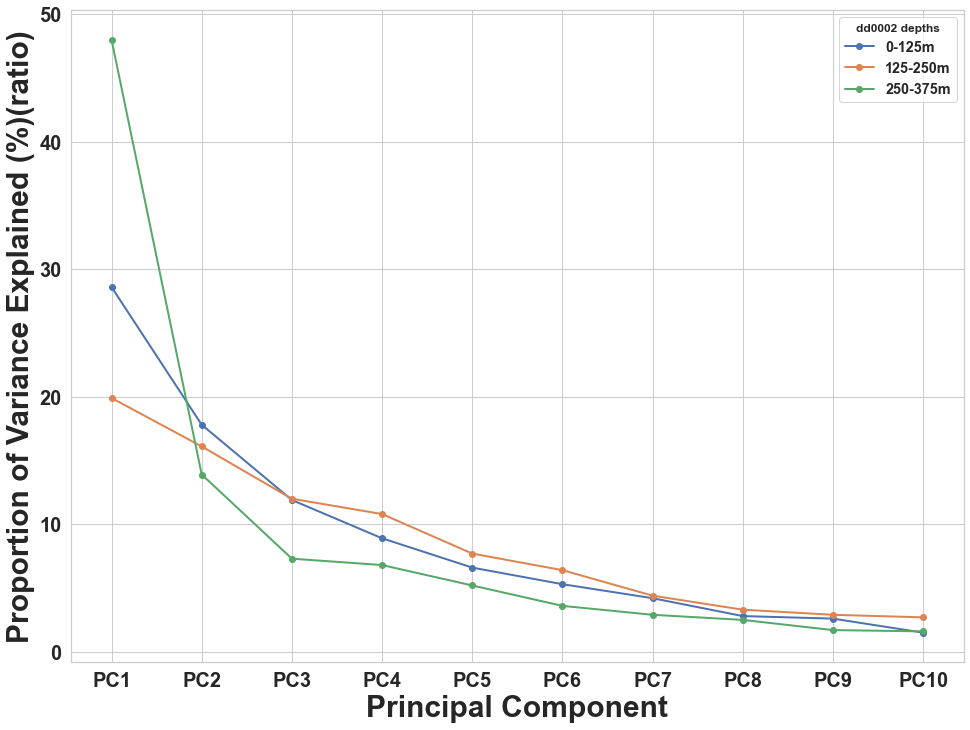

In [540]:
# get scree plot (for scree or elbow test)
#Scree plot will be saved in the same directory with name screeplot.png
plt.figure(figsize=(16,12))
plt.plot(pc_list_dd002_1, np.round(pca_dd002_1_out.explained_variance_ratio_*100, decimals=1), 'o-', linewidth=2)
plt.plot(pc_list_dd002_2, np.round(pca_dd002_2_out.explained_variance_ratio_*100, decimals=1), 'o-', linewidth=2)
plt.plot(pc_list_dd002_3, np.round(pca_dd002_3_out.explained_variance_ratio_*100, decimals=1), 'o-', linewidth=2)
plt.xticks(fontsize=20)
plt.yticks(fontsize=20)
plt.xlabel('Principal Component',fontsize=30)
plt.ylabel('Proportion of Variance Explained (%)(ratio)',fontsize=30)
plt.gca().legend(['0-125m','125-250m','250-375m'],title="dd0002 depths")
#plt.show()
plt.savefig('/UNSW/PhD/Paper_drafts/Figures/dd002_Elbowplot.png', dpi=600)

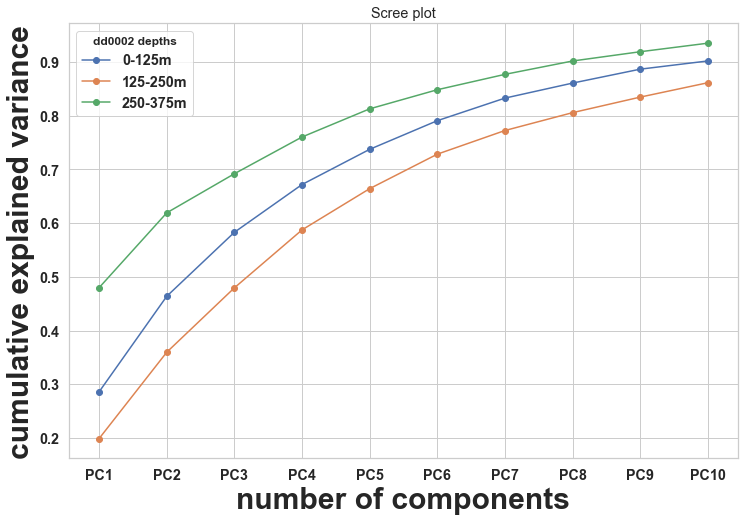

In [541]:

#Making the screeplot - plotting the cumulative variance against the number of components
%matplotlib inline
fig = plt.figure(figsize = (12,8))
#num_pc_dd001_1 = len(pca_dd001_1_out.explained_variance_ratio_)
#pc_list_dd001_1 = ["PC"+str(i) for i in list(range(1, num_pc_dd001_1+1))]
plt.plot(pc_list_dd002_1, np.cumsum(pca_dd002_1_out.explained_variance_ratio_),'o-')
plt.plot(pc_list_dd002_2, np.cumsum(pca_dd002_2_out.explained_variance_ratio_),'o-')
plt.plot(pc_list_dd002_3, np.cumsum(pca_dd002_3_out.explained_variance_ratio_),'o-')
plt.gca().legend(['0-125m','125-250m','250-375m'],title="dd0002 depths")
plt.xlabel('number of components',fontsize=30)
plt.ylabel('cumulative explained variance',fontsize=30)
plt.title('Scree plot')
#plt.show()
plt.savefig('/UNSW/PhD/Paper_drafts/Figures/dd002_Screeplot.png', dpi=600)

In [542]:
scaled_df_comb_dd002_3.columns

Index(['Alt1_code_Xobs', 'Alt1_code_ep', 'DS_U_mnrl_Anorthite',
       'DS_U_mnrl_Bytownite', 'DS_U_mnrl_Edenite', 'DS_U_mnrl_Epidote',
       'DS_U_mnrl_Ferrohornblende', 'DS_U_mnrl_Hornblende',
       'DS_U_mnrl_Labradorite', 'DS_U_mnrl_Oligoclase', 'DS_U_mnrl_Quartz',
       'Lith1_code_Abu', 'Lith1_code_Age', 'Lith1_code_Agmq', 'Lith1_grnsz_cg',
       'Lith1_grnsz_fg', 'Lith1_grnsz_mg', 'Lith1_grnsz_vcg',
       'Lith1_strctInt_m', 'Lith1_strctInt_s', 'Lith1-strct_fo',
       'Lith1_textr_bd', 'Lith1_textr_eg', 'Lith1_textr_gb', 'Lith1_textr_gn',
       'Sulph1_code_Xobs', 'Sulph1_code_cp', 'Sulph1_code_mo',
       'Sulph1_code_po', 'Sulph1_code_py', 'Felsic_mfc_idx', 'Depth_m',
       'Au_ppm'],
      dtype='object')

In [543]:
# number of components
n_pcs_dd002_1= pca_dd002_1_out.components_.shape[0]
#n_pcs_15EIS_1


# get the index of the most important feature on EACH component i.e. largest absolute value
# using LIST COMPREHENSION HERE
most_important_dd002_1 = [np.abs(pca_dd002_1_out.components_[i]).argmax() for i in range(n_pcs_dd002_1)]

initial_features_names_dd002_1 =['Alt1_code_Xobs', 'Alt1_code_ep', 'Alt1_code_he', 'DS_U_mnrl_Albite',
       'DS_U_mnrl_Chlorite', 'DS_U_mnrl_Edenite', 'DS_U_mnrl_Epidote',
       'DS_U_mnrl_Ferrohornblende', 'DS_U_mnrl_Hornblende',
       'DS_U_mnrl_Kaolinite', 'DS_U_mnrl_Labradorite', 'DS_U_mnrl_Oligoclase',
       'DS_U_mnrl_Paragonite', 'DS_U_mnrl_Quartz', 'Lith1_code_Abu',
       'Lith1_code_Ado', 'Lith1_code_Agmq', 'Lith1_code_Aitr',
       'Lith1_code_Xobs', 'Lith1_grnsz_Xobs', 'Lith1_grnsz_cg',
       'Lith1_grnsz_fg', 'Lith1_grnsz_mg', 'Lith1_grnsz_vcg',
       'Lith1_grnsz_vfg', 'Lith1_strctInt_Xobs', 'Lith1_strctInt_d',
       'Lith1_strctInt_i', 'Lith1_strctInt_m', 'Lith1_strctInt_s',
       'Lith1_strctInt_w', 'Lith1-strct_Xobs', 'Lith1-strct_fo',
       'Lith1-strct_sc', 'Lith1_textr_Xobs', 'Lith1_textr_eg',
       'Lith1_textr_gb', 'Lith1_textr_gd', 'Lith1_textr_gn', 'Lith1_textr_lm',
       'Lith1_textr_po', 'Sulph1_code_Xobs', 'Sulph1_code_py',
       'Felsic_mfc_idx', 'Depth_m', 'Au_ppm']

# get the names
most_important_names_dd002_1 = [initial_features_names_dd002_1[most_important_dd002_1[i]] for i in range(n_pcs_dd002_1)]

# using LIST COMPREHENSION HERE AGAIN
dic_dd002_1 = {'dd002_1_PC{}'.format(i+1): most_important_names_15EIS_1[i] for i in range(n_pcs_dd002_1)}

# build the dataframe
df_imp_features_dd002_1 = pd.DataFrame((dic_dd002_1.items()))

# print important features

df_imp_features_dd002_1

,0,1
0,dd002_1_PC1,Lith1-strct_sh
1,dd002_1_PC2,Lith1_strctInt_w
2,dd002_1_PC3,Lith1_strctInt_v
3,dd002_1_PC4,DS_U_mnrl_Quartz
4,dd002_1_PC5,Lith1_strctInt_s
5,dd002_1_PC6,DS_U_mnrl_Hornblende
6,dd002_1_PC7,Lith1_strctInt_w
7,dd002_1_PC8,Lith1_strctInt_m
8,dd002_1_PC9,Vel_geomean
9,dd002_1_PC10,DS_U_mnrl_Albite


In [544]:
# number of components
n_pcs_dd002_2= pca_dd002_2_out.components_.shape[0]
#n_pcs_15EIS_1


# get the index of the most important feature on EACH component i.e. largest absolute value
# using LIST COMPREHENSION HERE
most_important_dd002_2 = [np.abs(pca_dd002_2_out.components_[i]).argmax() for i in range(n_pcs_dd002_2)]

initial_features_names_dd002_2 =['Alt1_code_Xobs', 'Alt1_code_ep', 'Alt1_code_he', 'DS_U_mnrl_Albite',
       'DS_U_mnrl_Chlorite', 'DS_U_mnrl_Edenite', 'DS_U_mnrl_Ferrohornblende',
       'DS_U_mnrl_Hornblende', 'DS_U_mnrl_Labradorite', 'DS_U_mnrl_Oligoclase',
       'DS_U_mnrl_Paragonite', 'DS_U_mnrl_Quartz', 'Lith1_code_Abu',
       'Lith1_code_Age', 'Lith1_code_Agmq', 'Lith1_code_Agt', 'Lith1_code_Ait',
       'Lith1_code_LODE', 'Lith1_code_SHZ', 'Lith1_grnsz_cg', 'Lith1_grnsz_fg',
       'Lith1_grnsz_mg', 'Lith1_grnsz_vcg', 'Lith1_strctInt_m',
       'Lith1_strctInt_s', 'Lith1_strctInt_w', 'Lith1-strct_ag',
       'Lith1-strct_fo', 'Lith1-strct_gn', 'Lith1-strct_sh', 'Lith1_textr_bd',
       'Lith1_textr_eg', 'Lith1_textr_gb', 'Lith1_textr_gn', 'Lith1_textr_lm',
       'Lith1_textr_ma', 'Lith1_textr_po', 'Lith1_textr_sb', 'Lith1_textr_sp',
       'Sulph1_code_Xobs', 'Sulph1_code_cp', 'Sulph1_code_mo',
       'Sulph1_code_py', 'Felsic_mfc_idx', 'Depth_m', 'Au_ppm']

# get the names
most_important_names_dd002_2 = [initial_features_names_dd002_2[most_important_dd002_2[i]] for i in range(n_pcs_dd002_2)]

# using LIST COMPREHENSION HERE AGAIN
dic_dd002_2 = {'dd002_2_PC{}'.format(i+1): most_important_names_15EIS_2[i] for i in range(n_pcs_dd002_2)}

# build the dataframe
df_imp_features_dd002_2 = pd.DataFrame((dic_dd002_2.items()))

# print important features

df_imp_features_dd002_2

,0,1
0,dd002_2_PC1,Sulph1_code_py
1,dd002_2_PC2,Lith1_grnsz_fg
2,dd002_2_PC3,DS_U_mnrl_Edenite
3,dd002_2_PC4,DS_U_mnrl_Quartz
4,dd002_2_PC5,Lith1-strct_cx
5,dd002_2_PC6,Lith1-strct_vcb
6,dd002_2_PC7,Lith1_strctInt_s
7,dd002_2_PC8,DS_U_mnrl_AmphiboleML48
8,dd002_2_PC9,Vel_geomean
9,dd002_2_PC10,Lith1-strct_fd


In [545]:
# number of components
n_pcs_dd002_3= pca_dd002_3_out.components_.shape[0]
#n_pcs_15EIS_1


# get the index of the most important feature on EACH component i.e. largest absolute value
# using LIST COMPREHENSION HERE
most_important_dd002_3 = [np.abs(pca_dd002_3_out.components_[i]).argmax() for i in range(n_pcs_dd002_3)]

initial_features_names_dd002_3 =['Alt1_code_Xobs', 'Alt1_code_ep', 'DS_U_mnrl_Anorthite',
       'DS_U_mnrl_Bytownite', 'DS_U_mnrl_Edenite', 'DS_U_mnrl_Epidote',
       'DS_U_mnrl_Ferrohornblende', 'DS_U_mnrl_Hornblende',
       'DS_U_mnrl_Labradorite', 'DS_U_mnrl_Oligoclase', 'DS_U_mnrl_Quartz',
       'Lith1_code_Abu', 'Lith1_code_Age', 'Lith1_code_Agmq', 'Lith1_grnsz_cg',
       'Lith1_grnsz_fg', 'Lith1_grnsz_mg', 'Lith1_grnsz_vcg',
       'Lith1_strctInt_m', 'Lith1_strctInt_s', 'Lith1-strct_fo',
       'Lith1_textr_bd', 'Lith1_textr_eg', 'Lith1_textr_gb', 'Lith1_textr_gn',
       'Sulph1_code_Xobs', 'Sulph1_code_cp', 'Sulph1_code_mo',
       'Sulph1_code_po', 'Sulph1_code_py', 'Felsic_mfc_idx', 'Depth_m',
       'Au_ppm']

# get the names
most_important_names_dd002_3 = [initial_features_names_dd002_3[most_important_dd002_3[i]] for i in range(n_pcs_dd002_3)]

# using LIST COMPREHENSION HERE AGAIN
dic_dd002_3 = {'dd002_3_PC{}'.format(i+1): most_important_names_15EIS_3[i] for i in range(n_pcs_dd002_3)}

# build the dataframe
df_imp_features_dd002_3 = pd.DataFrame((dic_dd002_3.items()))

# print important features

df_imp_features_dd002_3

,0,1
0,dd002_3_PC1,Lith1_strctInt_m
1,dd002_3_PC2,Sulph1_code_py
2,dd002_3_PC3,Lith1_grnsz_fg
3,dd002_3_PC4,Alt1_code_ch
4,dd002_3_PC5,DS_U_mnrl_Quartz
5,dd002_3_PC6,Sulph1_code_cp
6,dd002_3_PC7,DS_U_mnrl_Edenite
7,dd002_3_PC8,ResDeep
8,dd002_3_PC9,DS_U_mnrl_Edenite
9,dd002_3_PC10,Alt1_code_sl


In [546]:

keys = ['Principal Components','0-125(m)', '125-250(m)','250-375(m)']
comb_impfeature_dd002 = pd.concat([d.reset_index(drop=True) for d in [df_imp_features_dd002_1[0],df_imp_features_dd002_1[1],df_imp_features_dd002_2[1],
                                                                      df_imp_features_dd002_3[1]]], axis=1, keys=keys)

comb_impfeature_dd002.head()

,Principal Components,0-125(m),125-250(m),250-375(m)
0,dd002_1_PC1,Lith1-strct_sh,Sulph1_code_py,Lith1_strctInt_m
1,dd002_1_PC2,Lith1_strctInt_w,Lith1_grnsz_fg,Sulph1_code_py
2,dd002_1_PC3,Lith1_strctInt_v,DS_U_mnrl_Edenite,Lith1_grnsz_fg
3,dd002_1_PC4,DS_U_mnrl_Quartz,DS_U_mnrl_Quartz,Alt1_code_ch
4,dd002_1_PC5,Lith1_strctInt_s,Lith1-strct_cx,DS_U_mnrl_Quartz


In [547]:
comb_impfeature_dd002.to_csv(r'dd002_impPCA_features.csv', index=False)

<span style="font-family: Bold; font-size:3.5em;color:red;"> Splitting drill core data every 125m depth interval </p>
<span style="font-family: Bold; font-size:1.0em;color:blue;"> ---  </p>


<span style="font-family: Bold; font-size:3.5em;color:blue;"> dd0003B </p>

In [548]:
# Categorical data
cat_df2_dd003=df2_003.select_dtypes(include=['object'].copy())

# Numerical data
num_df2_dd003=df2_003.select_dtypes(include=['float64'].copy())

In [549]:
# Filling null values in numerical data
num_df2_dd003_fillna=num_df2_dd003.apply(lambda x: x.fillna(x.mean()),axis=0)

In [550]:
print(num_df2_dd003_fillna.shape)
print(cat_df2_dd003.isnull().sum())

(905, 6)
Alt1_code         0
DS_U_grp          0
DS_U_mnrl         0
Lith1_code        0
Lith1_grnsz       0
Lith1_strctInt    0
Lith1-strct       0
Lith1_textr       0
Sulph1_code       0
dtype: int64


In [551]:
#cat_df2_dd003_4.columns

In [552]:
# dropping target from the dataframe
cat_df3_dd003=cat_df2_dd003.drop(['DS_U_grp'], axis=1)

In [553]:
# splitting dataframe every 125m depth interval (~250 rows in dataframe) for Drill Hole 15EIS (Starting depth from surface 495m and end depth 620m)
df2_dd003_1 = df2_003.iloc[:250,:]
df2_dd003_2 = df2_003.iloc[251:500,:]
df2_dd003_3 = df2_003.iloc[501:750,:]
df2_dd003_4 = df2_003.iloc[751:1000,:]

In [554]:
# Split Categorical data
cat_df2_dd003_1 = df2_dd003_1.select_dtypes(include=['object'].copy())
cat_df2_dd003_2 = df2_dd003_2.select_dtypes(include=['object'].copy())
cat_df2_dd003_3 = df2_dd003_3.select_dtypes(include=['object'].copy())
cat_df2_dd003_4 = df2_dd003_4.select_dtypes(include=['object'].copy())

In [555]:
# Split Numerical data
num_df2_dd003_1 = num_df2_dd003_fillna.iloc[:250,:]
num_df2_dd003_2 = num_df2_dd003_fillna.iloc[251:500,:]
num_df2_dd003_3 = num_df2_dd003_fillna.iloc[501:750,:]
num_df2_dd003_4 = num_df2_dd003_fillna.iloc[751:1000,:]

In [556]:
# Imputing zeroes with mean 
num_df2_dd003_1_fillna= num_df2_dd003_1.apply(lambda x: x.fillna(x.mean()),axis=0)
num_df2_dd003_2_fillna= num_df2_dd003_2.apply(lambda x: x.fillna(x.mean()),axis=0)
num_df2_dd003_3_fillna= num_df2_dd003_3.apply(lambda x: x.fillna(x.mean()),axis=0)
num_df2_dd003_4_fillna= num_df2_dd003_4.apply(lambda x: x.fillna(x.mean()),axis=0)

In [557]:
# Applying scalar to the numerical data
scaled_num_df2_dd003_1_fillna = pd.DataFrame(scaler.fit_transform(num_df2_dd003_1_fillna), columns=num_df2_dd003_1_fillna.columns)
scaled_num_df2_dd003_2_fillna = pd.DataFrame(scaler.fit_transform(num_df2_dd003_2_fillna), columns=num_df2_dd003_2_fillna.columns)
scaled_num_df2_dd003_3_fillna = pd.DataFrame(scaler.fit_transform(num_df2_dd003_3_fillna), columns=num_df2_dd003_3_fillna.columns)
scaled_num_df2_dd003_4_fillna = pd.DataFrame(scaler.fit_transform(num_df2_dd003_4_fillna), columns=num_df2_dd003_4_fillna.columns)

In [558]:
# make a copy of the categorized data 
cat_df2_dd003_1_ce_onehot = cat_df2_dd003_1.copy()
cat_df2_dd003_2_ce_onehot = cat_df2_dd003_2.copy()
cat_df2_dd003_3_ce_onehot = cat_df2_dd003_3.copy()
cat_df2_dd003_4_ce_onehot = cat_df2_dd003_4.copy()

In [559]:
cat_df2_dd003_1_ce_onehot = pd.get_dummies(cat_df2_dd003_1_ce_onehot, columns=['Alt1_code', 'DS_U_mnrl', 'Lith1_code', 'Lith1_grnsz','Lith1_strctInt', 'Lith1-strct', 'Lith1_textr', 'Sulph1_code'], 
                                                 prefix = ['Alt1_code', 'DS_U_mnrl', 'Lith1_code', 'Lith1_grnsz','Lith1_strctInt', 'Lith1-strct', 'Lith1_textr', 'Sulph1_code']);

cat_df2_dd003_2_ce_onehot = pd.get_dummies(cat_df2_dd003_2_ce_onehot, columns=['Alt1_code', 'DS_U_mnrl', 'Lith1_code', 'Lith1_grnsz','Lith1_strctInt', 'Lith1-strct', 'Lith1_textr', 'Sulph1_code'], 
                                                 prefix = ['Alt1_code', 'DS_U_mnrl', 'Lith1_code', 'Lith1_grnsz','Lith1_strctInt', 'Lith1-strct', 'Lith1_textr', 'Sulph1_code']);

cat_df2_dd003_3_ce_onehot = pd.get_dummies(cat_df2_dd003_3_ce_onehot, columns=['Alt1_code', 'DS_U_mnrl', 'Lith1_code', 'Lith1_grnsz','Lith1_strctInt', 'Lith1-strct', 'Lith1_textr', 'Sulph1_code'], 
                                                 prefix = ['Alt1_code', 'DS_U_mnrl', 'Lith1_code', 'Lith1_grnsz','Lith1_strctInt', 'Lith1-strct', 'Lith1_textr', 'Sulph1_code']);

cat_df2_dd003_4_ce_onehot = pd.get_dummies(cat_df2_dd003_4_ce_onehot, columns=['Alt1_code',  'DS_U_mnrl', 'Lith1_code', 'Lith1_grnsz','Lith1_strctInt', 'Lith1-strct', 'Lith1_textr', 'Sulph1_code'], 
                                                 prefix = ['Alt1_code', 'DS_U_mnrl', 'Lith1_code', 'Lith1_grnsz','Lith1_strctInt', 'Lith1-strct', 'Lith1_textr', 'Sulph1_code']);



In [560]:
cat_df2_dd003_1_ce_onehot.reset_index(drop=True, inplace=True)
cat_df2_dd003_2_ce_onehot.reset_index(drop=True, inplace=True)
cat_df2_dd003_3_ce_onehot.reset_index(drop=True, inplace=True)
cat_df2_dd003_4_ce_onehot.reset_index(drop=True, inplace=True)
scaled_num_df2_dd003_3_fillna.reset_index(drop=True, inplace=True)

In [561]:
print(cat_df2_dd003_4_ce_onehot.shape)
print(scaled_num_df2_dd003_4_fillna.shape)

(154, 32)
(154, 6)


In [562]:
# dropping DS_U_grp to make it target 
cat_df3_dd003_1_ce_onehot=cat_df2_dd003_1_ce_onehot.drop(['DS_U_grp'], axis=1)
cat_df3_dd003_2_ce_onehot=cat_df2_dd003_2_ce_onehot.drop(['DS_U_grp'], axis=1)
cat_df3_dd003_3_ce_onehot=cat_df2_dd003_3_ce_onehot.drop(['DS_U_grp'], axis=1)
cat_df3_dd003_4_ce_onehot=cat_df2_dd003_4_ce_onehot.drop(['DS_U_grp'], axis=1)

In [563]:

# conconating caregorical and numerical variables
scaled_df_comb_dd003_1 = pd.concat([cat_df3_dd003_1_ce_onehot,scaled_num_df2_dd003_1_fillna],axis=1)
scaled_df_comb_dd003_2 = pd.concat([cat_df3_dd003_2_ce_onehot,scaled_num_df2_dd003_2_fillna],axis=1)
scaled_df_comb_dd003_3 = pd.concat([cat_df3_dd003_3_ce_onehot,scaled_num_df2_dd003_3_fillna],axis=1)
scaled_df_comb_dd003_4 = pd.concat([cat_df3_dd003_4_ce_onehot,scaled_num_df2_dd003_4_fillna],axis=1)

In [564]:
# Defining PCA 
df_PC_dd003_1 = PCA(n_components=10)
df_PC_dd003_2 = PCA(n_components=10)
df_PC_dd003_3 = PCA(n_components=10)
df_PC_dd003_4 = PCA(n_components=10)

In [565]:
pca_dd003_1_out= df_PC_dd003_1.fit(scaled_df_comb_dd003_1)
pca_dd003_2_out= df_PC_dd003_2.fit(scaled_df_comb_dd003_2)
pca_dd003_3_out= df_PC_dd003_3.fit(scaled_df_comb_dd003_3)
pca_dd003_4_out= df_PC_dd003_4.fit(scaled_df_comb_dd003_4)

In [566]:
pca_dd003_new_1 = df_PC_dd003_1.fit_transform(scaled_df_comb_dd003_1)
pca_dd003_new_2 = df_PC_dd003_2.fit_transform(scaled_df_comb_dd003_2)
pca_dd003_new_3 = df_PC_dd003_3.fit_transform(scaled_df_comb_dd003_3)
pca_dd003_new_4 = df_PC_dd003_4.fit_transform(scaled_df_comb_dd003_4)

In [567]:
print(scaled_df_comb_dd003_1.shape)
print(scaled_df_comb_dd003_2.shape)
print(scaled_df_comb_dd003_3.shape)
print(scaled_df_comb_dd003_4.shape)

(250, 48)
(249, 48)
(249, 43)
(154, 37)


In [568]:
# get component loadings (correlation coefficient between original variables and the component) 
# the squared loadings within the PCs always sums to 1
loadings_dd003_1 = pca_dd003_1_out.components_
#num_pc_15EIS = pca_15EIS_out.n_features_
num_pc_dd003_1 = len(pca_dd003_1_out.explained_variance_ratio_)
pc_list_dd003_1 = ["PC"+str(i) for i in list(range(1, num_pc_dd003_1+1))]
loadings_df_dd003_1 = pd.DataFrame.from_dict(dict(zip(pc_list_dd003_1, loadings_dd003_1)))
loadings_df_dd003_1['variables'] = scaled_df_comb_dd003_1.columns.values
loadings_df_dd003_1 = loadings_df_dd003_1.set_index('variables')
#loadings_df_15EIS_1

loadings_dd003_2 = pca_dd003_2_out.components_
#num_pc_15EIS = pca_15EIS_out.n_features_
num_pc_dd003_2 = len(pca_dd003_2_out.explained_variance_ratio_)
pc_list_dd003_2 = ["PC"+str(i) for i in list(range(1, num_pc_dd003_2+1))]
loadings_df_dd003_2 = pd.DataFrame.from_dict(dict(zip(pc_list_dd003_2, loadings_dd003_2)))
loadings_df_dd003_2['variables'] = scaled_df_comb_dd003_2.columns.values
loadings_df_dd003_2 = loadings_df_dd003_2.set_index('variables')
#loadings_df_15EIS_1

loadings_dd003_3 = pca_dd003_3_out.components_
#num_pc_15EIS = pca_15EIS_out.n_features_
num_pc_dd003_3 = len(pca_dd003_3_out.explained_variance_ratio_)
pc_list_dd003_3 = ["PC"+str(i) for i in list(range(1, num_pc_dd003_3+1))]
loadings_df_dd003_3 = pd.DataFrame.from_dict(dict(zip(pc_list_dd003_3, loadings_dd003_3)))
loadings_df_dd003_3['variables'] = scaled_df_comb_dd003_3.columns.values
loadings_df_dd003_3 = loadings_df_dd003_3.set_index('variables')



loadings_dd003_4 = pca_dd003_4_out.components_
#num_pc_15EIS = pca_15EIS_out.n_features_
num_pc_dd003_4 = len(pca_dd003_4_out.explained_variance_ratio_)
pc_list_dd003_4 = ["PC"+str(i) for i in list(range(1, num_pc_dd003_4+1))]
loadings_df_dd003_4 = pd.DataFrame.from_dict(dict(zip(pc_list_dd003_4, loadings_dd003_4)))
loadings_df_dd003_4['variables'] = scaled_df_comb_dd003_4.columns.values
loadings_df_dd003_4 = loadings_df_dd003_4.set_index('variables')

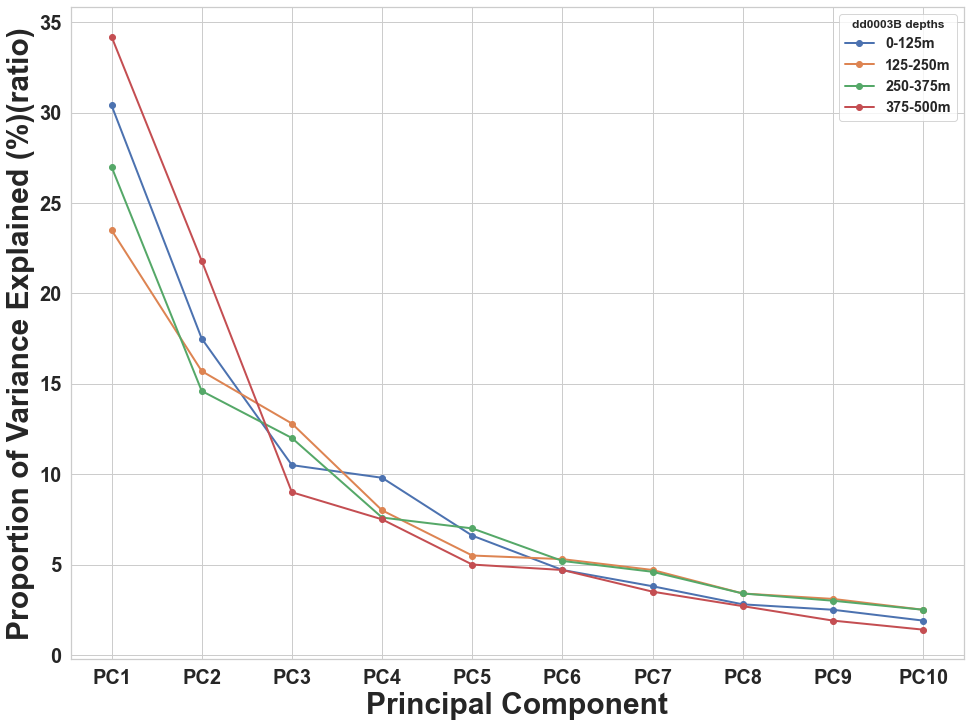

In [569]:
# get scree plot (for scree or elbow test)
#Scree plot will be saved in the same directory with name screeplot.png
plt.figure(figsize=(16,12))
plt.plot(pc_list_dd003_1, np.round(pca_dd003_1_out.explained_variance_ratio_*100, decimals=1), 'o-', linewidth=2)
plt.plot(pc_list_dd003_2, np.round(pca_dd003_2_out.explained_variance_ratio_*100, decimals=1), 'o-', linewidth=2)
plt.plot(pc_list_dd003_3, np.round(pca_dd003_3_out.explained_variance_ratio_*100, decimals=1), 'o-', linewidth=2)
plt.plot(pc_list_dd003_4, np.round(pca_dd003_4_out.explained_variance_ratio_*100, decimals=1), 'o-', linewidth=2)
plt.xticks(fontsize=20)
plt.yticks(fontsize=20)
plt.xlabel('Principal Component',fontsize=30)
plt.ylabel('Proportion of Variance Explained (%)(ratio)',fontsize=30)
plt.gca().legend(['0-125m','125-250m','250-375m','375-500m'],title="dd0003B depths")
#plt.show()
plt.savefig('/UNSW/PhD/Paper_drafts/Figures/dd003B_Elbowplot.png', dpi=600)

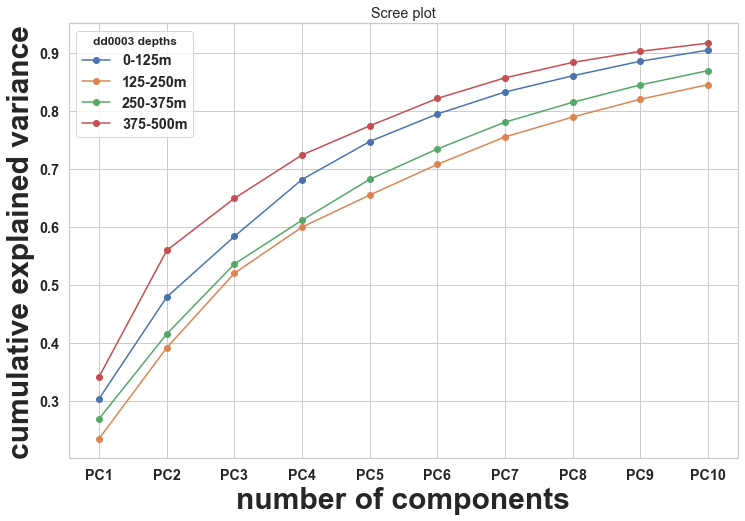

In [570]:
#Making the screeplot - plotting the cumulative variance against the number of components
%matplotlib inline
fig = plt.figure(figsize = (12,8))
#num_pc_dd003_1 = len(pca_dd003_1_out.explained_variance_ratio_)
#pc_list_dd003_1 = ["PC"+str(i) for i in list(range(1, num_pc_dd003_1+1))]
plt.plot(pc_list_dd003_1, np.cumsum(pca_dd003_1_out.explained_variance_ratio_),'o-')
plt.plot(pc_list_dd003_2, np.cumsum(pca_dd003_2_out.explained_variance_ratio_),'o-')
plt.plot(pc_list_dd003_3, np.cumsum(pca_dd003_3_out.explained_variance_ratio_),'o-')
plt.plot(pc_list_dd003_4, np.cumsum(pca_dd003_4_out.explained_variance_ratio_),'o-')
plt.gca().legend(['0-125m','125-250m','250-375m','375-500m'],title="dd0003 depths")
plt.xlabel('number of components', fontsize=30)
plt.ylabel('cumulative explained variance', fontsize=30)
plt.title('Scree plot')
#plt.show()
plt.savefig('/UNSW/PhD/Paper_drafts/Figures/dd003B_Screeplot.png', dpi=600)

In [571]:
scaled_df_comb_dd003_3.columns

Index(['Alt1_code_Xobs', 'Alt1_code_ab', 'Alt1_code_cb', 'Alt1_code_qc',
       'Alt1_code_se', 'DS_U_mnrl_Actinolite', 'DS_U_mnrl_Albite',
       'DS_U_mnrl_AmphiboleML48', 'DS_U_mnrl_Andesine', 'DS_U_mnrl_Chlorite',
       'DS_U_mnrl_Edenite', 'DS_U_mnrl_Hornblende', 'DS_U_mnrl_Labradorite',
       'DS_U_mnrl_Oligoclase', 'DS_U_mnrl_Quartz', 'Lith1_code_Abu',
       'Lith1_code_Ado', 'Lith1_code_Agpy', 'Lith1_code_Vq', 'Lith1_grnsz_cg',
       'Lith1_grnsz_fg', 'Lith1_grnsz_mg', 'Lith1_strctInt_Xobs',
       'Lith1_strctInt_m', 'Lith1_strctInt_s', 'Lith1_strctInt_w',
       'Lith1-strct_Xobs', 'Lith1-strct_bx', 'Lith1-strct_fo',
       'Lith1-strct_sh', 'Lith1_textr_ah', 'Lith1_textr_fr', 'Lith1_textr_ma',
       'Lith1_textr_po', 'Lith1_textr_wf', 'Sulph1_code_Xobs',
       'Sulph1_code_py', 'Felsic_mfc_Rmean', 'Susp_SI', 'Depth_m',
       'Vel_geomean', 'Vel_std', 'Au_ppm'],
      dtype='object')

In [572]:
# number of components
n_pcs_dd003_1= pca_dd003_1_out.components_.shape[0]
#n_pcs_15EIS_1


# get the index of the most important feature on EACH component i.e. largest absolute value
# using LIST COMPREHENSION HERE
most_important_dd003_1 = [np.abs(pca_dd003_1_out.components_[i]).argmax() for i in range(n_pcs_dd003_1)]

initial_features_names_dd003_1 =['Alt1_code_Xobs', 'Alt1_code_ab', 'Alt1_code_bi',
       'DS_U_mnrl_Actinolite', 'DS_U_mnrl_Albite', 'DS_U_mnrl_AmphiboleML48',
       'DS_U_mnrl_Andesine', 'DS_U_mnrl_Anorthite', 'DS_U_mnrl_Biotite',
       'DS_U_mnrl_Bytownite', 'DS_U_mnrl_Edenite', 'DS_U_mnrl_Hornblende',
       'DS_U_mnrl_Labradorite', 'DS_U_mnrl_Montmorillonite',
       'DS_U_mnrl_Oligoclase', 'DS_U_mnrl_Quartz', 'Lith1_code_Ab',
       'Lith1_code_Adl', 'Lith1_code_Adm', 'Lith1_code_Ado', 'Lith1_code_Agpy',
       'Lith1_code_Vq', 'Lith1_grnsz_cg', 'Lith1_grnsz_fg', 'Lith1_grnsz_mg',
       'Lith1_grnsz_vcg', 'Lith1_strctInt_Xobs', 'Lith1_strctInt_m',
       'Lith1_strctInt_s', 'Lith1_strctInt_w', 'Lith1-strct_Xobs',
       'Lith1-strct_bx', 'Lith1-strct_fo', 'Lith1-strct_sh', 'Lith1-strct_vcb',
       'Lith1_textr_ah', 'Lith1_textr_cz', 'Lith1_textr_ma', 'Lith1_textr_po',
       'Sulph1_code_Xobs', 'Sulph1_code_po', 'Sulph1_code_py',
       'Felsic_mfc_Rmean', 'Susp_SI', 'Depth_m', 'Vel_geomean', 'Vel_std',
       'Au_ppm']

# get the names
most_important_names_dd003_1 = [initial_features_names_dd003_1[most_important_dd003_1[i]] for i in range(n_pcs_dd003_1)]

# using LIST COMPREHENSION HERE AGAIN
dic_dd003_1 = {'dd003_1_PC{}'.format(i+1): most_important_names_15EIS_1[i] for i in range(n_pcs_dd003_1)}

# build the dataframe
df_imp_features_dd003_1 = pd.DataFrame((dic_dd003_1.items()))

# print important features

df_imp_features_dd003_1

,0,1
0,dd003_1_PC1,Lith1-strct_sh
1,dd003_1_PC2,Lith1_strctInt_w
2,dd003_1_PC3,Lith1_strctInt_v
3,dd003_1_PC4,DS_U_mnrl_Quartz
4,dd003_1_PC5,Lith1_strctInt_s
5,dd003_1_PC6,DS_U_mnrl_Hornblende
6,dd003_1_PC7,Lith1_strctInt_w
7,dd003_1_PC8,Lith1_strctInt_m
8,dd003_1_PC9,Vel_geomean
9,dd003_1_PC10,DS_U_mnrl_Albite


In [573]:
# number of components
n_pcs_dd003_2= pca_dd003_2_out.components_.shape[0]
#n_pcs_15EIS_1


# get the index of the most important feature on EACH component i.e. largest absolute value
# using LIST COMPREHENSION HERE
most_important_dd003_2 = [np.abs(pca_dd003_2_out.components_[i]).argmax() for i in range(n_pcs_dd003_2)]

initial_features_names_dd003_2 =['Alt1_code_Xobs', 'Alt1_code_ab', 'Alt1_code_bi', 'Alt1_code_cb',
       'Alt1_code_he', 'Alt1_code_se', 'DS_U_mnrl_Albite',
       'DS_U_mnrl_AmphiboleML48', 'DS_U_mnrl_Edenite', 'DS_U_mnrl_Hornblende',
       'DS_U_mnrl_Labradorite', 'DS_U_mnrl_Oligoclase', 'DS_U_mnrl_Quartz',
       'Lith1_code_Abu', 'Lith1_code_Adl', 'Lith1_code_Adm', 'Lith1_code_Ado',
       'Lith1_code_Agpy', 'Lith1_code_Aivc', 'Lith1_code_Asm', 'Lith1_code_Vq',
       'Lith1_grnsz_cg', 'Lith1_grnsz_fg', 'Lith1_grnsz_mg', 'Lith1_grnsz_vcg',
       'Lith1_strctInt_Xobs', 'Lith1_strctInt_m', 'Lith1_strctInt_s',
       'Lith1_strctInt_w', 'Lith1-strct_Xobs', 'Lith1-strct_fo',
       'Lith1-strct_lm', 'Lith1-strct_my', 'Lith1-strct_sh', 'Lith1_textr_ah',
       'Lith1_textr_cz', 'Lith1_textr_lm', 'Lith1_textr_ma', 'Lith1_textr_po',
       'Sulph1_code_Xobs', 'Sulph1_code_po', 'Sulph1_code_py',
       'Felsic_mfc_Rmean', 'Susp_SI', 'Depth_m', 'Vel_geomean', 'Vel_std',
       'Au_ppm']

# get the names
most_important_names_dd003_2 = [initial_features_names_dd003_2[most_important_dd003_2[i]] for i in range(n_pcs_dd003_2)]

# using LIST COMPREHENSION HERE AGAIN
dic_dd003_2 = {'dd003_2_PC{}'.format(i+1): most_important_names_15EIS_2[i] for i in range(n_pcs_dd003_2)}

# build the dataframe
df_imp_features_dd003_2 = pd.DataFrame((dic_dd003_2.items()))

# print important features

df_imp_features_dd003_2

,0,1
0,dd003_2_PC1,Sulph1_code_py
1,dd003_2_PC2,Lith1_grnsz_fg
2,dd003_2_PC3,DS_U_mnrl_Edenite
3,dd003_2_PC4,DS_U_mnrl_Quartz
4,dd003_2_PC5,Lith1-strct_cx
5,dd003_2_PC6,Lith1-strct_vcb
6,dd003_2_PC7,Lith1_strctInt_s
7,dd003_2_PC8,DS_U_mnrl_AmphiboleML48
8,dd003_2_PC9,Vel_geomean
9,dd003_2_PC10,Lith1-strct_fd


In [574]:
# number of components
n_pcs_dd003_3= pca_dd003_3_out.components_.shape[0]
#n_pcs_15EIS_1


# get the index of the most important feature on EACH component i.e. largest absolute value
# using LIST COMPREHENSION HERE
most_important_dd003_3 = [np.abs(pca_dd003_3_out.components_[i]).argmax() for i in range(n_pcs_dd003_3)]

initial_features_names_dd003_3 =['Alt1_code_Xobs', 'Alt1_code_ab', 'Alt1_code_cb', 'Alt1_code_qc',
       'Alt1_code_se', 'DS_U_mnrl_Actinolite', 'DS_U_mnrl_Albite',
       'DS_U_mnrl_AmphiboleML48', 'DS_U_mnrl_Andesine', 'DS_U_mnrl_Chlorite',
       'DS_U_mnrl_Edenite', 'DS_U_mnrl_Hornblende', 'DS_U_mnrl_Labradorite',
       'DS_U_mnrl_Oligoclase', 'DS_U_mnrl_Quartz', 'Lith1_code_Abu',
       'Lith1_code_Ado', 'Lith1_code_Agpy', 'Lith1_code_Vq', 'Lith1_grnsz_cg',
       'Lith1_grnsz_fg', 'Lith1_grnsz_mg', 'Lith1_strctInt_Xobs',
       'Lith1_strctInt_m', 'Lith1_strctInt_s', 'Lith1_strctInt_w',
       'Lith1-strct_Xobs', 'Lith1-strct_bx', 'Lith1-strct_fo',
       'Lith1-strct_sh', 'Lith1_textr_ah', 'Lith1_textr_fr', 'Lith1_textr_ma',
       'Lith1_textr_po', 'Lith1_textr_wf', 'Sulph1_code_Xobs',
       'Sulph1_code_py', 'Felsic_mfc_Rmean', 'Susp_SI', 'Depth_m',
       'Vel_geomean', 'Vel_std', 'Au_ppm']

# get the names
most_important_names_dd003_3 = [initial_features_names_dd003_3[most_important_dd003_3[i]] for i in range(n_pcs_dd003_3)]

# using LIST COMPREHENSION HERE AGAIN
dic_dd003_3 = {'dd003_3_PC{}'.format(i+1): most_important_names_15EIS_3[i] for i in range(n_pcs_dd003_3)}

# build the dataframe
df_imp_features_dd003_3 = pd.DataFrame((dic_dd003_3.items()))

# print important features

df_imp_features_dd003_3

,0,1
0,dd003_3_PC1,Lith1_strctInt_m
1,dd003_3_PC2,Sulph1_code_py
2,dd003_3_PC3,Lith1_grnsz_fg
3,dd003_3_PC4,Alt1_code_ch
4,dd003_3_PC5,DS_U_mnrl_Quartz
5,dd003_3_PC6,Sulph1_code_cp
6,dd003_3_PC7,DS_U_mnrl_Edenite
7,dd003_3_PC8,ResDeep
8,dd003_3_PC9,DS_U_mnrl_Edenite
9,dd003_3_PC10,Alt1_code_sl


In [575]:
scaled_df_comb_dd003_4.columns

Index(['Alt1_code_Xobs', 'Alt1_code_ab', 'Alt1_code_bi', 'Alt1_code_cb',
       'DS_U_mnrl_Actinolite', 'DS_U_mnrl_AmphiboleML48', 'DS_U_mnrl_Andesine',
       'DS_U_mnrl_Edenite', 'DS_U_mnrl_Epidote', 'DS_U_mnrl_Hornblende',
       'DS_U_mnrl_Labradorite', 'DS_U_mnrl_Oligoclase', 'DS_U_mnrl_Quartz',
       'Lith1_code_Abu', 'Lith1_code_Adm', 'Lith1_code_Ado', 'Lith1_code_Agpy',
       'Lith1_grnsz_Xobs', 'Lith1_grnsz_cg', 'Lith1_grnsz_fg',
       'Lith1_grnsz_mg', 'Lith1_strctInt_Xobs', 'Lith1_strctInt_s',
       'Lith1_strctInt_w', 'Lith1-strct_Xobs', 'Lith1-strct_fo',
       'Lith1_textr_ah', 'Lith1_textr_ma', 'Lith1_textr_po',
       'Sulph1_code_Xobs', 'Sulph1_code_po', 'Felsic_mfc_Rmean', 'Susp_SI',
       'Depth_m', 'Vel_geomean', 'Vel_std', 'Au_ppm'],
      dtype='object')

In [576]:
# number of components
n_pcs_dd003_4= pca_dd003_4_out.components_.shape[0]
#n_pcs_15EIS_1


# get the index of the most important feature on EACH component i.e. largest absolute value
# using LIST COMPREHENSION HERE
most_important_dd003_4 = [np.abs(pca_dd003_4_out.components_[i]).argmax() for i in range(n_pcs_dd003_4)]

initial_features_names_dd003_4 =['Alt1_code_Xobs', 'Alt1_code_ab', 'Alt1_code_bi', 'Alt1_code_cb',
       'DS_U_mnrl_Actinolite', 'DS_U_mnrl_AmphiboleML48', 'DS_U_mnrl_Andesine',
       'DS_U_mnrl_Edenite', 'DS_U_mnrl_Epidote', 'DS_U_mnrl_Hornblende',
       'DS_U_mnrl_Labradorite', 'DS_U_mnrl_Oligoclase', 'DS_U_mnrl_Quartz',
       'Lith1_code_Abu', 'Lith1_code_Adm', 'Lith1_code_Ado', 'Lith1_code_Agpy',
       'Lith1_grnsz_Xobs', 'Lith1_grnsz_cg', 'Lith1_grnsz_fg',
       'Lith1_grnsz_mg', 'Lith1_strctInt_Xobs', 'Lith1_strctInt_s',
       'Lith1_strctInt_w', 'Lith1-strct_Xobs', 'Lith1-strct_fo',
       'Lith1_textr_ah', 'Lith1_textr_ma', 'Lith1_textr_po',
       'Sulph1_code_Xobs', 'Sulph1_code_po', 'Felsic_mfc_Rmean', 'Susp_SI',
       'Depth_m', 'Vel_geomean', 'Vel_std', 'Au_ppm']

# get the names
most_important_names_dd003_4 = [initial_features_names_dd003_4[most_important_dd003_4[i]] for i in range(n_pcs_dd003_4)]

# using LIST COMPREHENSION HERE AGAIN
dic_dd003_4 = {'dd003_4_PC{}'.format(i+1): most_important_names_15EIS_4[i] for i in range(n_pcs_dd003_4)}

# build the dataframe
df_imp_features_dd003_4 = pd.DataFrame((dic_dd003_4.items()))

# print important features

df_imp_features_dd003_4

,0,1
0,dd003_4_PC1,Lith1_strctInt_w
1,dd003_4_PC2,Lith1-strct_fo
2,dd003_4_PC3,DS_U_mnrl_Quartz
3,dd003_4_PC4,Lith1_strctInt_m
4,dd003_4_PC5,Lith1_strctInt_Xobs
5,dd003_4_PC6,DS_U_mnrl_Hornblende
6,dd003_4_PC7,DS_U_mnrl_Labradorite
7,dd003_4_PC8,DS_U_mnrl_Hornblende
8,dd003_4_PC9,Sulph1_style_lm
9,dd003_4_PC10,Vel_geomean


In [577]:

keys = ['Principal Components','0-125(m)', '125-250(m)','250-375(m)','375-500(m)']
comb_impfeature_dd003 = pd.concat([d.reset_index(drop=True) for d in [df_imp_features_dd003_1[0],df_imp_features_dd003_1[1],df_imp_features_dd003_2[1],
                                                                      df_imp_features_dd003_3[1],df_imp_features_dd003_4[1]]], axis=1, keys=keys)

comb_impfeature_dd003.head()

,Principal Components,0-125(m),125-250(m),250-375(m),375-500(m)
0,dd003_1_PC1,Lith1-strct_sh,Sulph1_code_py,Lith1_strctInt_m,Lith1_strctInt_w
1,dd003_1_PC2,Lith1_strctInt_w,Lith1_grnsz_fg,Sulph1_code_py,Lith1-strct_fo
2,dd003_1_PC3,Lith1_strctInt_v,DS_U_mnrl_Edenite,Lith1_grnsz_fg,DS_U_mnrl_Quartz
3,dd003_1_PC4,DS_U_mnrl_Quartz,DS_U_mnrl_Quartz,Alt1_code_ch,Lith1_strctInt_m
4,dd003_1_PC5,Lith1_strctInt_s,Lith1-strct_cx,DS_U_mnrl_Quartz,Lith1_strctInt_Xobs


In [578]:
#Export to CSV file
comb_impfeature_dd003.to_csv(r'dd003_impPCA_features.csv', index=False)

<span style="font-family: Bold; font-size:3.5em;color:red;"> Splitting drill core data every 125m depth interval </p>
<span style="font-family: Bold; font-size:1.0em;color:blue;"> ---  </p>


<span style="font-family: Bold; font-size:3.5em;color:blue;"> dd0004 </p>

In [579]:
# Categorical data
cat_df2_dd004=df2_004.select_dtypes(include=['object'].copy())

# Numerical data
num_df2_dd004=df2_004.select_dtypes(include=['float64'].copy())

In [580]:
# Filling null values in numerical data
num_df2_dd004_fillna=num_df2_dd004.apply(lambda x: x.fillna(x.mean()),axis=0)

In [581]:
print(num_df2_dd004_fillna.shape)
print(cat_df2_dd004.isnull().sum())

(1401, 5)
Alt1_code         0
DS_U_grp          0
DS_U_mnrl         0
Lith1_code        0
Lith1_grnsz       0
Lith1_strctInt    0
Lith1-strct       0
Lith1_textr       0
Sulph1_code       0
dtype: int64


In [582]:
cat_df2_dd004.columns

Index(['Alt1_code', 'DS_U_grp', 'DS_U_mnrl', 'Lith1_code', 'Lith1_grnsz',
       'Lith1_strctInt', 'Lith1-strct', 'Lith1_textr', 'Sulph1_code'],
      dtype='object')

In [583]:
# dropping target from the dataframe
cat_df3_dd004=cat_df2_dd004.drop(['DS_U_grp'], axis=1)

In [584]:
# splitting dataframe every 125m depth interval (~250 rows in dataframe) for Drill Hole 15EIS (Starting depth from surface 495m and end depth 620m)
df2_dd004_1 = df2_004.iloc[:250,:]
df2_dd004_2 = df2_004.iloc[251:500,:]
df2_dd004_3 = df2_004.iloc[501:750,:]
df2_dd004_4 = df2_004.iloc[751:1000,:]
df2_dd004_5 = df2_004.iloc[1001:1250,:]
df2_dd004_6 = df2_004.iloc[1251:,:]

In [585]:
# Split Categorical data
cat_df2_dd004_1 = df2_dd004_1.select_dtypes(include=['object'].copy())
cat_df2_dd004_2 = df2_dd004_2.select_dtypes(include=['object'].copy())
cat_df2_dd004_3 = df2_dd004_3.select_dtypes(include=['object'].copy())
cat_df2_dd004_4 = df2_dd004_4.select_dtypes(include=['object'].copy())
cat_df2_dd004_5 = df2_dd004_5.select_dtypes(include=['object'].copy())
cat_df2_dd004_6 = df2_dd004_6.select_dtypes(include=['object'].copy())

In [586]:
# Split Numerical data
num_df2_dd004_1 = num_df2_dd004_fillna.iloc[:250,:]
num_df2_dd004_2 = num_df2_dd004_fillna.iloc[251:500,:]
num_df2_dd004_3 = num_df2_dd004_fillna.iloc[501:750,:]
num_df2_dd004_4 = num_df2_dd004_fillna.iloc[751:1000,:]
num_df2_dd004_5 = num_df2_dd004_fillna.iloc[1001:1250,:]
num_df2_dd004_6 = num_df2_dd004_fillna.iloc[1251:,:]

In [587]:
# Imputing zeroes with mean 
num_df2_dd004_1_fillna= num_df2_dd004_1.apply(lambda x: x.fillna(x.mean()),axis=0)
num_df2_dd004_2_fillna= num_df2_dd004_2.apply(lambda x: x.fillna(x.mean()),axis=0)
num_df2_dd004_3_fillna= num_df2_dd004_3.apply(lambda x: x.fillna(x.mean()),axis=0)
num_df2_dd004_4_fillna= num_df2_dd004_4.apply(lambda x: x.fillna(x.mean()),axis=0)
num_df2_dd004_5_fillna= num_df2_dd004_5.apply(lambda x: x.fillna(x.mean()),axis=0)
num_df2_dd004_6_fillna= num_df2_dd004_6.apply(lambda x: x.fillna(x.mean()),axis=0)

In [588]:
# Applying scalar to the numerical data
scaled_num_df2_dd004_1_fillna = pd.DataFrame(scaler.fit_transform(num_df2_dd004_1_fillna), columns=num_df2_dd004_1_fillna.columns)
scaled_num_df2_dd004_2_fillna = pd.DataFrame(scaler.fit_transform(num_df2_dd004_2_fillna), columns=num_df2_dd004_2_fillna.columns)
scaled_num_df2_dd004_3_fillna = pd.DataFrame(scaler.fit_transform(num_df2_dd004_3_fillna), columns=num_df2_dd004_3_fillna.columns)
scaled_num_df2_dd004_4_fillna = pd.DataFrame(scaler.fit_transform(num_df2_dd004_4_fillna), columns=num_df2_dd004_4_fillna.columns)
scaled_num_df2_dd004_5_fillna = pd.DataFrame(scaler.fit_transform(num_df2_dd004_5_fillna), columns=num_df2_dd004_5_fillna.columns)
scaled_num_df2_dd004_6_fillna = pd.DataFrame(scaler.fit_transform(num_df2_dd004_6_fillna), columns=num_df2_dd004_6_fillna.columns)



In [589]:
# make a copy of the categorized data 
cat_df2_dd004_1_ce_onehot = cat_df2_dd004_1.copy()
cat_df2_dd004_2_ce_onehot = cat_df2_dd004_2.copy()
cat_df2_dd004_3_ce_onehot = cat_df2_dd004_3.copy()
cat_df2_dd004_4_ce_onehot = cat_df2_dd004_4.copy()
cat_df2_dd004_5_ce_onehot = cat_df2_dd004_5.copy()
cat_df2_dd004_6_ce_onehot = cat_df2_dd004_6.copy()

In [590]:
cat_df2_dd004_1_ce_onehot = pd.get_dummies(cat_df2_dd004_1_ce_onehot, columns=['Alt1_code',  'DS_U_mnrl', 'Lith1_code', 'Lith1_grnsz', 'Lith1_strctInt', 'Lith1-strct', 'Lith1_textr', 'Sulph1_code'], 
                                                 prefix = ['Alt1_code', 'DS_U_mnrl', 'Lith1_code', 'Lith1_grnsz', 'Lith1_strctInt', 'Lith1-strct', 'Lith1_textr', 'Sulph1_code']);

cat_df2_dd004_2_ce_onehot = pd.get_dummies(cat_df2_dd004_2_ce_onehot, columns=['Alt1_code',  'DS_U_mnrl', 'Lith1_code', 'Lith1_grnsz', 'Lith1_strctInt', 'Lith1-strct', 'Lith1_textr', 'Sulph1_code'], 
                                                 prefix = ['Alt1_code',  'DS_U_mnrl', 'Lith1_code', 'Lith1_grnsz', 'Lith1_strctInt', 'Lith1-strct', 'Lith1_textr', 'Sulph1_code']);


cat_df2_dd004_3_ce_onehot = pd.get_dummies(cat_df2_dd004_3_ce_onehot, columns=['Alt1_code',  'DS_U_mnrl', 'Lith1_code', 'Lith1_grnsz', 'Lith1_strctInt', 'Lith1-strct', 'Lith1_textr', 'Sulph1_code'], 
                                                 prefix = ['Alt1_code',  'DS_U_mnrl', 'Lith1_code', 'Lith1_grnsz', 'Lith1_strctInt', 'Lith1-strct', 'Lith1_textr', 'Sulph1_code']);


cat_df2_dd004_4_ce_onehot = pd.get_dummies(cat_df2_dd004_4_ce_onehot, columns=['Alt1_code', 'DS_U_mnrl', 'Lith1_code', 'Lith1_grnsz', 'Lith1_strctInt', 'Lith1-strct', 'Lith1_textr', 'Sulph1_code'], 
                                                 prefix = ['Alt1_code', 'DS_U_mnrl', 'Lith1_code', 'Lith1_grnsz', 'Lith1_strctInt', 'Lith1-strct', 'Lith1_textr', 'Sulph1_code']);



cat_df2_dd004_5_ce_onehot = pd.get_dummies(cat_df2_dd004_5_ce_onehot, columns=['Alt1_code',  'DS_U_mnrl', 'Lith1_code', 'Lith1_grnsz', 'Lith1_strctInt', 'Lith1-strct', 'Lith1_textr', 'Sulph1_code'], 
                                                 prefix = ['Alt1_code',  'DS_U_mnrl', 'Lith1_code', 'Lith1_grnsz', 'Lith1_strctInt', 'Lith1-strct', 'Lith1_textr', 'Sulph1_code']);



cat_df2_dd004_6_ce_onehot = pd.get_dummies(cat_df2_dd004_6_ce_onehot, columns=['Alt1_code',  'DS_U_mnrl', 'Lith1_code', 'Lith1_grnsz', 'Lith1_strctInt', 'Lith1-strct', 'Lith1_textr', 'Sulph1_code'], 
                                                 prefix = ['Alt1_code',  'DS_U_mnrl', 'Lith1_code', 'Lith1_grnsz', 'Lith1_strctInt', 'Lith1-strct', 'Lith1_textr', 'Sulph1_code']);



In [591]:
cat_df2_dd004_1_ce_onehot.reset_index(drop=True, inplace=True)
cat_df2_dd004_2_ce_onehot.reset_index(drop=True, inplace=True)
cat_df2_dd004_3_ce_onehot.reset_index(drop=True, inplace=True)
cat_df2_dd004_4_ce_onehot.reset_index(drop=True, inplace=True)
cat_df2_dd004_5_ce_onehot.reset_index(drop=True, inplace=True)
cat_df2_dd004_6_ce_onehot.reset_index(drop=True, inplace=True)

In [592]:
# dropping DS_U_grp to make it target 
cat_df3_dd004_1_ce_onehot=cat_df2_dd004_1_ce_onehot.drop(['DS_U_grp'], axis=1)
cat_df3_dd004_2_ce_onehot=cat_df2_dd004_2_ce_onehot.drop(['DS_U_grp'], axis=1)
cat_df3_dd004_3_ce_onehot=cat_df2_dd004_3_ce_onehot.drop(['DS_U_grp'], axis=1)
cat_df3_dd004_4_ce_onehot=cat_df2_dd004_4_ce_onehot.drop(['DS_U_grp'], axis=1)
cat_df3_dd004_5_ce_onehot=cat_df2_dd004_5_ce_onehot.drop(['DS_U_grp'], axis=1)
cat_df3_dd004_6_ce_onehot=cat_df2_dd004_6_ce_onehot.drop(['DS_U_grp'], axis=1)

In [593]:
# conconating caregorical and numerical variables
scaled_df_comb_dd004_1 = pd.concat([cat_df3_dd004_1_ce_onehot,scaled_num_df2_dd004_1_fillna],axis=1)
scaled_df_comb_dd004_2 = pd.concat([cat_df3_dd004_2_ce_onehot,scaled_num_df2_dd004_2_fillna],axis=1)
scaled_df_comb_dd004_3 = pd.concat([cat_df3_dd004_3_ce_onehot,scaled_num_df2_dd004_3_fillna],axis=1)
scaled_df_comb_dd004_4 = pd.concat([cat_df3_dd004_4_ce_onehot,scaled_num_df2_dd004_4_fillna],axis=1)
scaled_df_comb_dd004_5 = pd.concat([cat_df3_dd004_5_ce_onehot,scaled_num_df2_dd004_5_fillna],axis=1)
scaled_df_comb_dd004_6 = pd.concat([cat_df3_dd004_6_ce_onehot,scaled_num_df2_dd004_6_fillna],axis=1)

In [594]:
# Defining PCA 
df_PC_dd004_1 = PCA(n_components=10)
df_PC_dd004_2 = PCA(n_components=10)
df_PC_dd004_3 = PCA(n_components=10)
df_PC_dd004_4 = PCA(n_components=10)
df_PC_dd004_5 = PCA(n_components=10)
df_PC_dd004_6 = PCA(n_components=10)

In [595]:
pca_dd004_1_out= df_PC_dd004_1.fit(scaled_df_comb_dd004_1)
pca_dd004_2_out= df_PC_dd004_2.fit(scaled_df_comb_dd004_2)
pca_dd004_3_out= df_PC_dd004_3.fit(scaled_df_comb_dd004_3)
pca_dd004_4_out= df_PC_dd004_4.fit(scaled_df_comb_dd004_4)
pca_dd004_5_out= df_PC_dd004_5.fit(scaled_df_comb_dd004_5)
pca_dd004_6_out= df_PC_dd004_6.fit(scaled_df_comb_dd004_6)

In [596]:
pca_dd004_new_1 = df_PC_dd004_1.fit_transform(scaled_df_comb_dd004_1)
pca_dd004_new_2 = df_PC_dd004_2.fit_transform(scaled_df_comb_dd004_2)
pca_dd004_new_3 = df_PC_dd004_3.fit_transform(scaled_df_comb_dd004_3)
pca_dd004_new_4 = df_PC_dd004_4.fit_transform(scaled_df_comb_dd004_4)
pca_dd004_new_5 = df_PC_dd004_5.fit_transform(scaled_df_comb_dd004_5)
pca_dd004_new_6 = df_PC_dd004_6.fit_transform(scaled_df_comb_dd004_6)

In [597]:
# get component loadings (correlation coefficient between original variables and the component) 
# the squared loadings within the PCs always sums to 1
loadings_dd004_1 = pca_dd004_1_out.components_
#num_pc_15EIS = pca_15EIS_out.n_features_
num_pc_dd004_1 = len(pca_dd004_1_out.explained_variance_ratio_)
pc_list_dd004_1 = ["PC"+str(i) for i in list(range(1, num_pc_dd004_1+1))]
loadings_df_dd004_1 = pd.DataFrame.from_dict(dict(zip(pc_list_dd004_1, loadings_dd004_1)))
loadings_df_dd004_1['variables'] = scaled_df_comb_dd004_1.columns.values
loadings_df_dd004_1 = loadings_df_dd004_1.set_index('variables')
#loadings_df_15EIS_1

loadings_dd004_2 = pca_dd004_2_out.components_
#num_pc_15EIS = pca_15EIS_out.n_features_
num_pc_dd004_2 = len(pca_dd004_2_out.explained_variance_ratio_)
pc_list_dd004_2 = ["PC"+str(i) for i in list(range(1, num_pc_dd004_2+1))]
loadings_df_dd004_2 = pd.DataFrame.from_dict(dict(zip(pc_list_dd004_2, loadings_dd004_2)))
loadings_df_dd004_2['variables'] = scaled_df_comb_dd004_2.columns.values
loadings_df_dd004_2 = loadings_df_dd004_2.set_index('variables')
#loadings_df_15EIS_1

loadings_dd004_3 = pca_dd004_3_out.components_
#num_pc_15EIS = pca_15EIS_out.n_features_
num_pc_dd004_3 = len(pca_dd004_3_out.explained_variance_ratio_)
pc_list_dd004_3 = ["PC"+str(i) for i in list(range(1, num_pc_dd004_3+1))]
loadings_df_dd004_3 = pd.DataFrame.from_dict(dict(zip(pc_list_dd004_3, loadings_dd004_3)))
loadings_df_dd004_3['variables'] = scaled_df_comb_dd004_3.columns.values
loadings_df_dd004_3 = loadings_df_dd004_3.set_index('variables')
#loadings_df_15EIS_1


loadings_dd004_4 = pca_dd004_4_out.components_
#num_pc_15EIS = pca_15EIS_out.n_features_
num_pc_dd004_4 = len(pca_dd004_4_out.explained_variance_ratio_)
pc_list_dd004_4 = ["PC"+str(i) for i in list(range(1, num_pc_dd004_4+1))]
loadings_df_dd004_4 = pd.DataFrame.from_dict(dict(zip(pc_list_dd004_4, loadings_dd004_4)))
loadings_df_dd004_4['variables'] = scaled_df_comb_dd004_4.columns.values
loadings_df_dd004_4 = loadings_df_dd004_4.set_index('variables')
#loadings_df_15EIS_1



loadings_dd004_5 = pca_dd004_5_out.components_
#num_pc_15EIS = pca_15EIS_out.n_features_
num_pc_dd004_5 = len(pca_dd004_5_out.explained_variance_ratio_)
pc_list_dd004_5 = ["PC"+str(i) for i in list(range(1, num_pc_dd004_5+1))]
loadings_df_dd004_5 = pd.DataFrame.from_dict(dict(zip(pc_list_dd004_5, loadings_dd004_5)))
loadings_df_dd004_5['variables'] = scaled_df_comb_dd004_5.columns.values
loadings_df_dd004_5 = loadings_df_dd004_5.set_index('variables')
#loadings_df_15EIS_1



loadings_dd004_6 = pca_dd004_6_out.components_
#num_pc_15EIS = pca_15EIS_out.n_features_
num_pc_dd004_6 = len(pca_dd004_6_out.explained_variance_ratio_)
pc_list_dd004_6 = ["PC"+str(i) for i in list(range(1, num_pc_dd004_6+1))]
loadings_df_dd004_6 = pd.DataFrame.from_dict(dict(zip(pc_list_dd004_6, loadings_dd004_6)))
loadings_df_dd004_6['variables'] = scaled_df_comb_dd004_6.columns.values
loadings_df_dd004_6 = loadings_df_dd004_6.set_index('variables')
#loadings_df_15EIS_1

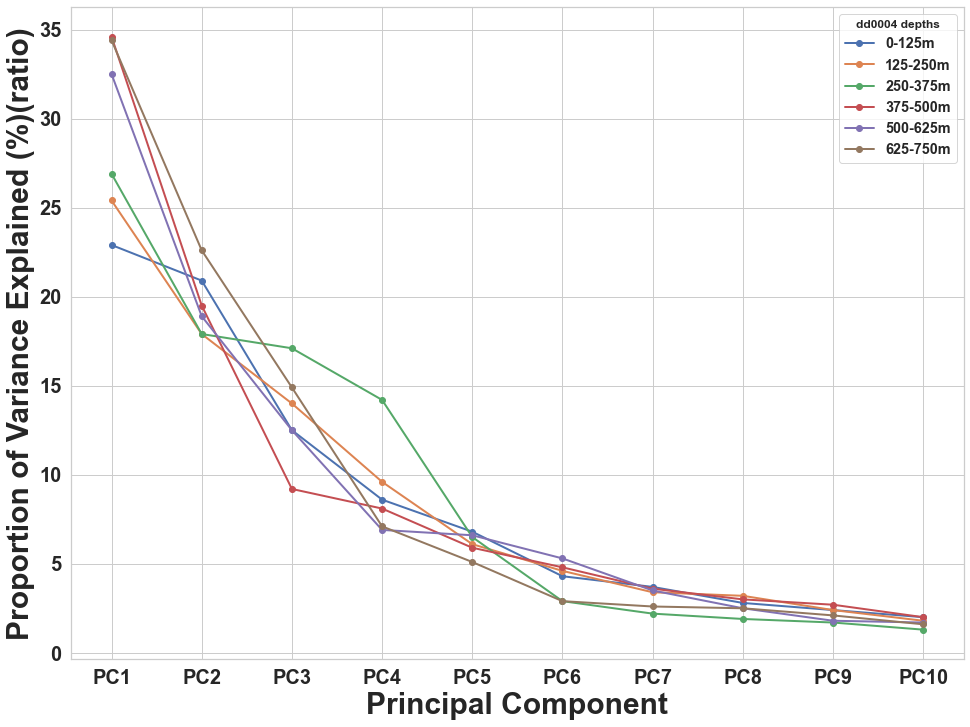

In [598]:
# get scree plot (for scree or elbow test)
#Scree plot will be saved in the same directory with name screeplot.png
plt.figure(figsize=(16,12))
plt.plot(pc_list_dd004_1, np.round(pca_dd004_1_out.explained_variance_ratio_*100, decimals=1), 'o-', linewidth=2)
plt.plot(pc_list_dd004_2, np.round(pca_dd004_2_out.explained_variance_ratio_*100, decimals=1), 'o-', linewidth=2)
plt.plot(pc_list_dd004_3, np.round(pca_dd004_3_out.explained_variance_ratio_*100, decimals=1), 'o-', linewidth=2)
plt.plot(pc_list_dd004_4, np.round(pca_dd004_4_out.explained_variance_ratio_*100, decimals=1), 'o-', linewidth=2)
plt.plot(pc_list_dd004_5, np.round(pca_dd004_5_out.explained_variance_ratio_*100, decimals=1), 'o-', linewidth=2)
plt.plot(pc_list_dd004_6, np.round(pca_dd004_6_out.explained_variance_ratio_*100, decimals=1), 'o-', linewidth=2)
plt.xticks(fontsize=20)
plt.yticks(fontsize=20)
plt.xlabel('Principal Component',fontsize=30)
plt.ylabel('Proportion of Variance Explained (%)(ratio)',fontsize=30)
plt.gca().legend(['0-125m','125-250m','250-375m','375-500m','500-625m','625-750m'],title="dd0004 depths")
#plt.show()
plt.savefig('/UNSW/PhD/Paper_drafts/Figures/dd004_Elbowplot.png', dpi=600)

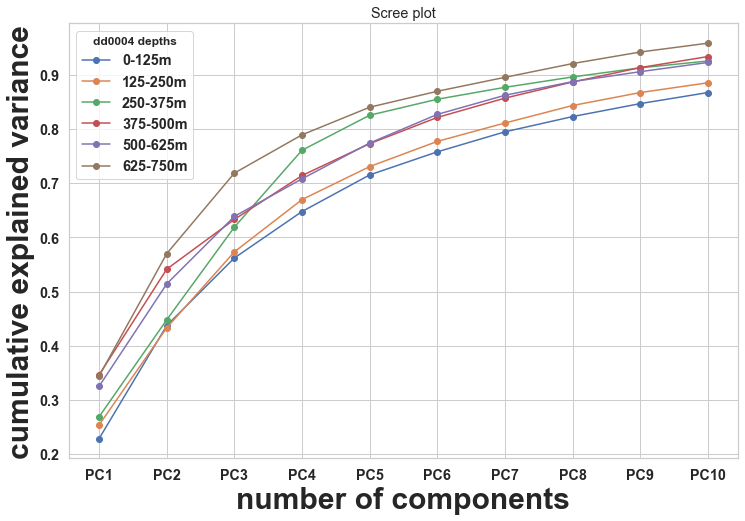

In [599]:
#Making the screeplot - plotting the cumulative variance against the number of components
%matplotlib inline
fig = plt.figure(figsize = (12,8))
#num_pc_dd004_1 = len(pca_dd004_1_out.explained_variance_ratio_)
#pc_list_dd004_1 = ["PC"+str(i) for i in list(range(1, num_pc_dd004_1+1))]
plt.plot(pc_list_dd004_1, np.cumsum(pca_dd004_1_out.explained_variance_ratio_),'o-')
plt.plot(pc_list_dd004_2, np.cumsum(pca_dd004_2_out.explained_variance_ratio_),'o-')
plt.plot(pc_list_dd004_3, np.cumsum(pca_dd004_3_out.explained_variance_ratio_),'o-')
plt.plot(pc_list_dd004_4, np.cumsum(pca_dd004_4_out.explained_variance_ratio_),'o-')
plt.plot(pc_list_dd004_5, np.cumsum(pca_dd004_5_out.explained_variance_ratio_),'o-')
plt.plot(pc_list_dd004_6, np.cumsum(pca_dd004_6_out.explained_variance_ratio_),'o-')
plt.gca().legend(['0-125m','125-250m','250-375m','375-500m','500-625m','625-750m'],title="dd0004 depths")
plt.xlabel('number of components',fontsize=30)
plt.ylabel('cumulative explained variance',fontsize=30)
plt.title('Scree plot')
#plt.show()
plt.savefig('/UNSW/PhD/Paper_drafts/Figures/dd004_Screeplot.png', dpi=600)

In [600]:
scaled_df_comb_dd004_6.columns

Index(['Alt1_code_Xobs', 'Alt1_code_cb', 'Alt1_code_se',
       'DS_U_mnrl_Actinolite', 'DS_U_mnrl_Albite', 'DS_U_mnrl_Edenite',
       'DS_U_mnrl_Hornblende', 'DS_U_mnrl_Oligoclase', 'DS_U_mnrl_Quartz',
       'Lith1_code_Abu', 'Lith1_code_Ado', 'Lith1_code_Agpf', 'Lith1_grnsz_cg',
       'Lith1_grnsz_fg', 'Lith1_grnsz_mg', 'Lith1_grnsz_vcg',
       'Lith1_strctInt_Xobs', 'Lith1_strctInt_m', 'Lith1_strctInt_w',
       'Lith1-strct_Xobs', 'Lith1-strct_fo', 'Lith1_textr_ah',
       'Lith1_textr_ma', 'Lith1_textr_po', 'Lith1_textr_wf',
       'Sulph1_code_Xobs', 'Sulph1_code_po', 'Felsic_mfc_Rmean', 'Depth_m',
       'Vel_geomean', 'Vel_std', 'Au_ppm'],
      dtype='object')

In [601]:
# number of components
n_pcs_dd004_1= pca_dd004_1_out.components_.shape[0]
#n_pcs_15EIS_1


# get the index of the most important feature on EACH component i.e. largest absolute value
# using LIST COMPREHENSION HERE
most_important_dd004_1 = [np.abs(pca_dd004_1_out.components_[i]).argmax() for i in range(n_pcs_dd004_1)]

initial_features_names_dd004_1 =['Alt1_code_Xobs', 'Alt1_code_bi', 'DS_U_mnrl_Actinolite',
       'DS_U_mnrl_Andesine', 'DS_U_mnrl_Dolomite', 'DS_U_mnrl_Edenite',
       'DS_U_mnrl_Hornblende', 'DS_U_mnrl_Illite', 'DS_U_mnrl_Kaolinite',
       'DS_U_mnrl_Labradorite', 'DS_U_mnrl_Montmorillonite',
       'DS_U_mnrl_Muscovite', 'DS_U_mnrl_Oligoclase', 'DS_U_mnrl_Quartz',
       'DS_U_mnrl_Stilpnomelane', 'Lith1_code_Ab', 'Lith1_code_Abu',
       'Lith1_code_Adl', 'Lith1_code_Adm', 'Lith1_code_Ado', 'Lith1_code_NC',
       'Lith1_code_Paf', 'Lith1_code_Pal', 'Lith1_code_Qsl', 'Lith1_code_Qsw',
       'Lith1_code_Vq', 'Lith1_grnsz_Xobs', 'Lith1_grnsz_cg', 'Lith1_grnsz_fg',
       'Lith1_grnsz_mg', 'Lith1_strctInt_Xobs', 'Lith1_strctInt_m',
       'Lith1_strctInt_s', 'Lith1-strct_Xobs', 'Lith1-strct_fo',
       'Lith1-strct_sh', 'Lith1_textr_Xobs', 'Lith1_textr_ah',
       'Lith1_textr_cz', 'Lith1_textr_ho', 'Lith1_textr_id', 'Lith1_textr_ma',
       'Lith1_textr_s1', 'Lith1_textr_s2', 'Lith1_textr_s3', 'Lith1_textr_s4',
       'Sulph1_code_Xobs', 'Sulph1_code_py', 'Felsic_mfc_Rmean', 'Depth_m',
       'Vel_geomean', 'Vel_std', 'Au_ppm']

# get the names
most_important_names_dd004_1 = [initial_features_names_dd004_1[most_important_dd004_1[i]] for i in range(n_pcs_dd004_1)]

# using LIST COMPREHENSION HERE AGAIN
dic_dd004_1 = {'dd004_1_PC{}'.format(i+1): most_important_names_15EIS_1[i] for i in range(n_pcs_dd004_1)}

# build the dataframe
df_imp_features_dd004_1 = pd.DataFrame((dic_dd004_1.items()))

# print important features

df_imp_features_dd004_1


,0,1
0,dd004_1_PC1,Lith1-strct_sh
1,dd004_1_PC2,Lith1_strctInt_w
2,dd004_1_PC3,Lith1_strctInt_v
3,dd004_1_PC4,DS_U_mnrl_Quartz
4,dd004_1_PC5,Lith1_strctInt_s
5,dd004_1_PC6,DS_U_mnrl_Hornblende
6,dd004_1_PC7,Lith1_strctInt_w
7,dd004_1_PC8,Lith1_strctInt_m
8,dd004_1_PC9,Vel_geomean
9,dd004_1_PC10,DS_U_mnrl_Albite


In [602]:
# number of components
n_pcs_dd004_2= pca_dd004_2_out.components_.shape[0]
#n_pcs_15EIS_1


# get the index of the most important feature on EACH component i.e. largest absolute value
# using LIST COMPREHENSION HERE
most_important_dd004_2 = [np.abs(pca_dd004_2_out.components_[i]).argmax() for i in range(n_pcs_dd004_2)]

initial_features_names_dd004_2 =['Alt1_code_Xobs', 'Alt1_code_ab', 'Alt1_code_bi', 'Alt1_code_cb',
       'DS_U_mnrl_Actinolite', 'DS_U_mnrl_AmphiboleML48', 'DS_U_mnrl_Calcite',
       'DS_U_mnrl_Edenite', 'DS_U_mnrl_Hornblende', 'DS_U_mnrl_Labradorite',
       'DS_U_mnrl_Oligoclase', 'DS_U_mnrl_Quartz', 'Lith1_code_Adl',
       'Lith1_code_Ado', 'Lith1_code_Adq', 'Lith1_code_Aoy', 'Lith1_code_Vc',
       'Lith1_grnsz_cg', 'Lith1_grnsz_fg', 'Lith1_grnsz_mg', 'Lith1_grnsz_vcg',
       'Lith1_strctInt_Xobs', 'Lith1_strctInt_m', 'Lith1_strctInt_s',
       'Lith1_strctInt_w', 'Lith1-strct_Xobs', 'Lith1-strct_bx',
       'Lith1-strct_fo', 'Lith1-strct_my', 'Lith1-strct_sh', 'Lith1-strct_vb',
       'Lith1_textr_cu', 'Lith1_textr_cz', 'Lith1_textr_ma', 'Lith1_textr_qe',
       'Lith1_textr_wf', 'Sulph1_code_Xobs', 'Sulph1_code_as',
       'Sulph1_code_py', 'Felsic_mfc_Rmean', 'Depth_m', 'Vel_geomean',
       'Vel_std', 'Au_ppm']

# get the names
most_important_names_dd004_2 = [initial_features_names_dd004_2[most_important_dd004_2[i]] for i in range(n_pcs_dd004_2)]

# using LIST COMPREHENSION HERE AGAIN
dic_dd004_2 = {'dd004_2_PC{}'.format(i+1): most_important_names_15EIS_2[i] for i in range(n_pcs_dd004_2)}

# build the dataframe
df_imp_features_dd004_2 = pd.DataFrame((dic_dd004_2.items()))

# print important features

df_imp_features_dd004_2

,0,1
0,dd004_2_PC1,Sulph1_code_py
1,dd004_2_PC2,Lith1_grnsz_fg
2,dd004_2_PC3,DS_U_mnrl_Edenite
3,dd004_2_PC4,DS_U_mnrl_Quartz
4,dd004_2_PC5,Lith1-strct_cx
5,dd004_2_PC6,Lith1-strct_vcb
6,dd004_2_PC7,Lith1_strctInt_s
7,dd004_2_PC8,DS_U_mnrl_AmphiboleML48
8,dd004_2_PC9,Vel_geomean
9,dd004_2_PC10,Lith1-strct_fd


In [603]:
# number of components
n_pcs_dd004_3= pca_dd004_3_out.components_.shape[0]
#n_pcs_15EIS_1


# get the index of the most important feature on EACH component i.e. largest absolute value
# using LIST COMPREHENSION HERE
most_important_dd004_3 = [np.abs(pca_dd004_3_out.components_[i]).argmax() for i in range(n_pcs_dd004_3)]

initial_features_names_dd004_3 =['Alt1_code_Xobs', 'Alt1_code_ab', 'Alt1_code_bi', 'Alt1_code_cb',
       'Alt1_code_se', 'DS_U_mnrl_Actinolite', 'DS_U_mnrl_AmphiboleML48',
       'DS_U_mnrl_Anorthite', 'DS_U_mnrl_Biotite', 'DS_U_mnrl_Chlorite',
       'DS_U_mnrl_Edenite', 'DS_U_mnrl_Hornblende', 'DS_U_mnrl_Labradorite',
       'DS_U_mnrl_Oligoclase', 'DS_U_mnrl_Phlogopite', 'DS_U_mnrl_Quartz',
       'DS_U_mnrl_Siderite', 'Lith1_code_Abu', 'Lith1_code_Ado',
       'Lith1_code_Adq', 'Lith1_code_Aivc', 'Lith1_code_Ashb',
       'Lith1_code_Asm', 'Lith1_code_Vq', 'Lith1_grnsz_cg', 'Lith1_grnsz_fg',
       'Lith1_grnsz_mg', 'Lith1_grnsz_vcg', 'Lith1_grnsz_vfg',
       'Lith1_strctInt_Xobs', 'Lith1_strctInt_m', 'Lith1_strctInt_s',
       'Lith1_strctInt_w', 'Lith1-strct_Xobs', 'Lith1-strct_cr',
       'Lith1-strct_fo', 'Lith1-strct_sh', 'Lith1_textr_bd', 'Lith1_textr_cu',
       'Lith1_textr_cz', 'Lith1_textr_lm', 'Lith1_textr_ma', 'Lith1_textr_qe',
       'Sulph1_code_Xobs', 'Sulph1_code_py', 'Felsic_mfc_Rmean', 'Depth_m',
       'Vel_geomean', 'Vel_std', 'Au_ppm']

# get the names
most_important_names_dd004_3 = [initial_features_names_dd004_3[most_important_dd004_3[i]] for i in range(n_pcs_dd004_3)]

# using LIST COMPREHENSION HERE AGAIN
dic_dd004_3 = {'dd004_3_PC{}'.format(i+1): most_important_names_15EIS_3[i] for i in range(n_pcs_dd004_3)}

# build the dataframe
df_imp_features_dd004_3 = pd.DataFrame((dic_dd004_3.items()))

# print important features

df_imp_features_dd004_3


,0,1
0,dd004_3_PC1,Lith1_strctInt_m
1,dd004_3_PC2,Sulph1_code_py
2,dd004_3_PC3,Lith1_grnsz_fg
3,dd004_3_PC4,Alt1_code_ch
4,dd004_3_PC5,DS_U_mnrl_Quartz
5,dd004_3_PC6,Sulph1_code_cp
6,dd004_3_PC7,DS_U_mnrl_Edenite
7,dd004_3_PC8,ResDeep
8,dd004_3_PC9,DS_U_mnrl_Edenite
9,dd004_3_PC10,Alt1_code_sl


In [604]:
# number of components
n_pcs_dd004_4= pca_dd004_4_out.components_.shape[0]
#n_pcs_15EIS_1


# get the index of the most important feature on EACH component i.e. largest absolute value
# using LIST COMPREHENSION HERE
most_important_dd004_4 = [np.abs(pca_dd004_4_out.components_[i]).argmax() for i in range(n_pcs_dd004_4)]

initial_features_names_dd004_4 =['Alt1_code_Xobs', 'Alt1_code_bi', 'Alt1_code_cb', 'Alt1_code_se',
       'Alt1_code_sl', 'DS_U_mnrl_Albite', 'DS_U_mnrl_Chlorite',
       'DS_U_mnrl_Edenite', 'DS_U_mnrl_Hornblende', 'DS_U_mnrl_Labradorite',
       'DS_U_mnrl_Oligoclase', 'DS_U_mnrl_Quartz', 'DS_U_mnrl_Siderite',
       'Lith1_code_Abu', 'Lith1_code_Ado', 'Lith1_code_Asb', 'Lith1_code_Asm',
       'Lith1_code_Aso', 'Lith1_code_Vqc', 'Lith1_grnsz_fg', 'Lith1_grnsz_mg',
       'Lith1_grnsz_vfg', 'Lith1_strctInt_Xobs', 'Lith1_strctInt_m',
       'Lith1_strctInt_s', 'Lith1-strct_Xobs', 'Lith1-strct_bx',
       'Lith1-strct_cr', 'Lith1-strct_fd', 'Lith1-strct_sh', 'Lith1_textr_ah',
       'Lith1_textr_bd', 'Lith1_textr_ct', 'Lith1_textr_cz', 'Lith1_textr_lm',
       'Lith1_textr_ma', 'Lith1_textr_va', 'Lith1_textr_wf',
       'Sulph1_code_Xobs', 'Sulph1_code_po', 'Sulph1_code_py',
       'Felsic_mfc_Rmean', 'Depth_m', 'Vel_geomean', 'Vel_std', 'Au_ppm']

# get the names
most_important_names_dd004_4 = [initial_features_names_dd004_4[most_important_dd004_4[i]] for i in range(n_pcs_dd004_4)]

# using LIST COMPREHENSION HERE AGAIN
dic_dd004_4 = {'dd004_4_PC{}'.format(i+1): most_important_names_15EIS_4[i] for i in range(n_pcs_dd004_4)}

# build the dataframe
df_imp_features_dd004_4 = pd.DataFrame((dic_dd004_4.items()))

# print important features

df_imp_features_dd004_4


,0,1
0,dd004_4_PC1,Lith1_strctInt_w
1,dd004_4_PC2,Lith1-strct_fo
2,dd004_4_PC3,DS_U_mnrl_Quartz
3,dd004_4_PC4,Lith1_strctInt_m
4,dd004_4_PC5,Lith1_strctInt_Xobs
5,dd004_4_PC6,DS_U_mnrl_Hornblende
6,dd004_4_PC7,DS_U_mnrl_Labradorite
7,dd004_4_PC8,DS_U_mnrl_Hornblende
8,dd004_4_PC9,Sulph1_style_lm
9,dd004_4_PC10,Vel_geomean


In [605]:
# number of components
n_pcs_dd004_5= pca_dd004_5_out.components_.shape[0]
#n_pcs_15EIS_1


# get the index of the most important feature on EACH component i.e. largest absolute value
# using LIST COMPREHENSION HERE
most_important_dd004_5 = [np.abs(pca_dd004_5_out.components_[i]).argmax() for i in range(n_pcs_dd004_5)]

initial_features_names_dd004_5 =['Alt1_code_Xobs', 'Alt1_code_cb', 'Alt1_code_se',
       'DS_U_mnrl_Actinolite', 'DS_U_mnrl_Albite', 'DS_U_mnrl_AmphiboleML48',
       'DS_U_mnrl_Andesine', 'DS_U_mnrl_Chlorite', 'DS_U_mnrl_Edenite',
       'DS_U_mnrl_Hornblende', 'DS_U_mnrl_Labradorite', 'DS_U_mnrl_Oligoclase',
       'DS_U_mnrl_Quartz', 'Lith1_code_Abu', 'Lith1_code_Ado',
       'Lith1_code_Agpf', 'Lith1_grnsz_cg', 'Lith1_grnsz_fg', 'Lith1_grnsz_mg',
       'Lith1_strctInt_Xobs', 'Lith1_strctInt_m', 'Lith1_strctInt_s',
       'Lith1_strctInt_w', 'Lith1-strct_Xobs', 'Lith1-strct_bx',
       'Lith1-strct_fo', 'Lith1-strct_sh', 'Lith1_textr_ah', 'Lith1_textr_cz',
       'Lith1_textr_lm', 'Lith1_textr_ma', 'Lith1_textr_po', 'Lith1_textr_wf',
       'Sulph1_code_Xobs', 'Sulph1_code_po', 'Sulph1_code_py',
       'Felsic_mfc_Rmean', 'Depth_m', 'Vel_geomean', 'Vel_std', 'Au_ppm']

# get the names
most_important_names_dd004_5 = [initial_features_names_dd004_5[most_important_dd004_5[i]] for i in range(n_pcs_dd004_5)]

# using LIST COMPREHENSION HERE AGAIN
dic_dd004_5 = {'dd004_5_PC{}'.format(i+1): most_important_names_15EIS_5[i] for i in range(n_pcs_dd004_5)}

# build the dataframe
df_imp_features_dd004_5 = pd.DataFrame((dic_dd004_5.items()))

# print important features

df_imp_features_dd004_5

,0,1
0,dd004_5_PC1,Alt1_code_ch
1,dd004_5_PC2,DS_U_mnrl_Quartz
2,dd004_5_PC3,Alt1_code_ch
3,dd004_5_PC4,DS_U_mnrl_Labradorite
4,dd004_5_PC5,Depth_m
5,dd004_5_PC6,Depth_m
6,dd004_5_PC7,Lith1_strctInt_m
7,dd004_5_PC8,DS_U_mnrl_Edenite
8,dd004_5_PC9,Vel_geomean
9,dd004_5_PC10,Vel_std


In [607]:
# number of components
n_pcs_dd004_6= pca_dd004_6_out.components_.shape[0]
#n_pcs_15EIS_1


# get the index of the most important feature on EACH component i.e. largest absolute value
# using LIST COMPREHENSION HERE
most_important_dd004_6 = [np.abs(pca_dd004_6_out.components_[i]).argmax() for i in range(n_pcs_dd004_6)]

initial_features_names_dd004_6 =['Alt1_code_Xobs', 'Alt1_code_cb', 'Alt1_code_se',
       'DS_U_mnrl_Actinolite', 'DS_U_mnrl_Albite', 'DS_U_mnrl_Edenite',
       'DS_U_mnrl_Hornblende', 'DS_U_mnrl_Oligoclase', 'DS_U_mnrl_Quartz',
       'Lith1_code_Abu', 'Lith1_code_Ado', 'Lith1_code_Agpf', 'Lith1_grnsz_cg',
       'Lith1_grnsz_fg', 'Lith1_grnsz_mg', 'Lith1_grnsz_vcg',
       'Lith1_strctInt_Xobs', 'Lith1_strctInt_m', 'Lith1_strctInt_w',
       'Lith1-strct_Xobs', 'Lith1-strct_fo', 'Lith1_textr_ah',
       'Lith1_textr_ma', 'Lith1_textr_po', 'Lith1_textr_wf',
       'Sulph1_code_Xobs', 'Sulph1_code_po', 'Felsic_mfc_Rmean', 'Depth_m',
       'Vel_geomean', 'Vel_std', 'Au_ppm']

# get the names
most_important_names_dd004_6 = [initial_features_names_dd004_6[most_important_dd004_6[i]] for i in range(n_pcs_dd004_6)]

# using LIST COMPREHENSION HERE AGAIN
dic_dd004_6 = {'dd004_6_PC{}'.format(i+1): most_important_names_15EIS_6[i] for i in range(n_pcs_dd004_6)}

# build the dataframe
df_imp_features_dd004_6 = pd.DataFrame((dic_dd004_6.items()))

# print important features

df_imp_features_dd004_6

,0,1
0,dd004_6_PC1,Lith1_strctInt_w
1,dd004_6_PC2,Depth_m
2,dd004_6_PC3,DS_U_mnrl_Quartz
3,dd004_6_PC4,Alt1_code_ch
4,dd004_6_PC5,DS_U_mnrl_Quartz
5,dd004_6_PC6,Lith1_textr_ma
6,dd004_6_PC7,Depth_m
7,dd004_6_PC8,Depth_m
8,dd004_6_PC9,DS_U_mnrl_Oligoclase
9,dd004_6_PC10,Susp_SI


In [608]:
# Printing Dataframes side by side
# https://www.codegrepper.com/code-examples/python/How+to+put+a+header+title+per+dataframe+after+concatenate+using+pandas+in+python

keys = ['Principal Components','0-125(m)', '125-250(m)','250-375(m)','375-500(m)','500-625(m)','625-750(m)']
comb_impfeature_dd004 = pd.concat([d.reset_index(drop=True) for d in [df_imp_features_dd004_1[0],df_imp_features_dd004_1[1],
                                                                      df_imp_features_dd004_2[1],
                                                               df_imp_features_dd004_3[1],df_imp_features_dd004_4[1],
                                                               df_imp_features_dd004_5[1],df_imp_features_dd004_6[1]]], axis=1, keys=keys)

comb_impfeature_dd004.head()

,Principal Components,0-125(m),125-250(m),250-375(m),375-500(m),500-625(m),625-750(m)
0,dd004_1_PC1,Lith1-strct_sh,Sulph1_code_py,Lith1_strctInt_m,Lith1_strctInt_w,Alt1_code_ch,Lith1_strctInt_w
1,dd004_1_PC2,Lith1_strctInt_w,Lith1_grnsz_fg,Sulph1_code_py,Lith1-strct_fo,DS_U_mnrl_Quartz,Depth_m
2,dd004_1_PC3,Lith1_strctInt_v,DS_U_mnrl_Edenite,Lith1_grnsz_fg,DS_U_mnrl_Quartz,Alt1_code_ch,DS_U_mnrl_Quartz
3,dd004_1_PC4,DS_U_mnrl_Quartz,DS_U_mnrl_Quartz,Alt1_code_ch,Lith1_strctInt_m,DS_U_mnrl_Labradorite,Alt1_code_ch
4,dd004_1_PC5,Lith1_strctInt_s,Lith1-strct_cx,DS_U_mnrl_Quartz,Lith1_strctInt_Xobs,Depth_m,DS_U_mnrl_Quartz


In [609]:
comb_impfeature_dd004.to_csv(r'dd004_impPCA_features.csv', index=False)

In [610]:
# https://stackoverflow.com/questions/37776228/pycharm-python-opencv-and-cv2-install-error
#!pip3 install opencv-python

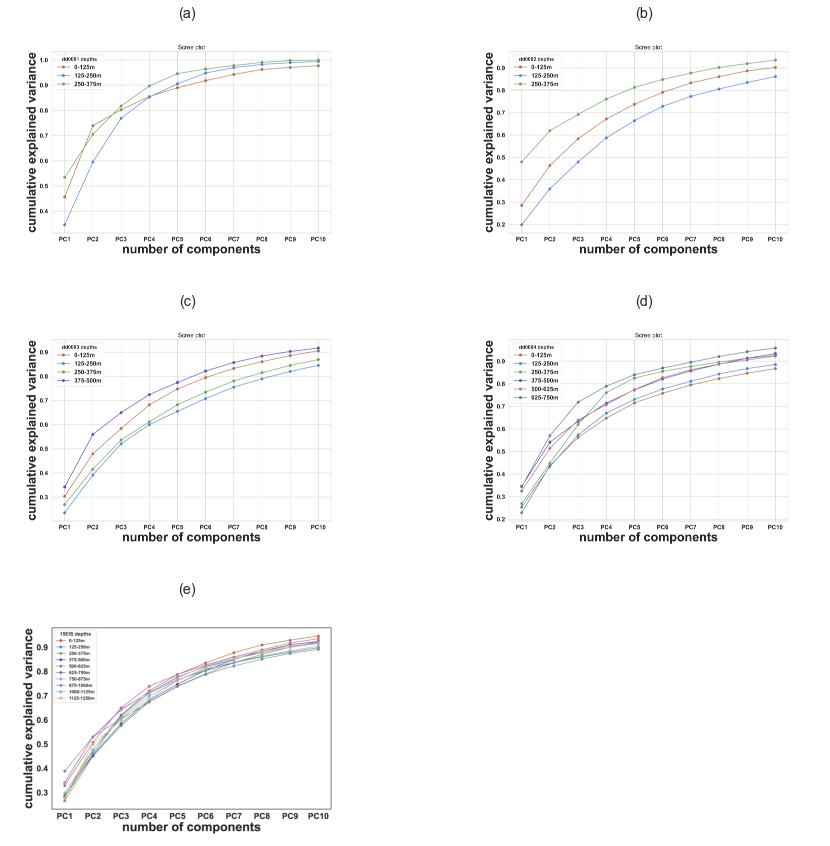

In [611]:
# code for displaying multiple images in one figure

#import libraries
import cv2
from matplotlib import pyplot as plt

# create figure

fig = plt.figure(figsize=(15, 15))

# setting values to rows and column variables
rows = 3
columns = 2

# reading images
Image1 = cv2.imread('/UNSW/PhD/Paper_drafts/Figures/dd001_Screeplot.png')
Image2 = cv2.imread('/UNSW/PhD/Paper_drafts/Figures/dd002_Screeplot.png')
Image3 = cv2.imread('/UNSW/PhD/Paper_drafts/Figures/dd003B_Screeplot.png')
Image4 = cv2.imread('/UNSW/PhD/Paper_drafts/Figures/dd004_Screeplot.png')
Image5 = cv2.imread('/UNSW/PhD/Paper_drafts/Figures/15EIS_Screeplot.png')

# Adds a subplot at the 1st position
fig.add_subplot(rows, columns, 1)

# showing image
plt.imshow(Image1)
plt.axis('off')
plt.title("(a)")

# Adds a subplot at the 2nd position
fig.add_subplot(rows, columns, 2)

# showing image
plt.imshow(Image2)
plt.axis('off')
plt.title("(b)")

# Adds a subplot at the 3rd position
fig.add_subplot(rows, columns, 3)

# showing image
plt.imshow(Image3)
plt.axis('off')
plt.title("(c)")

# Adds a subplot at the 4th position
fig.add_subplot(rows, columns, 4)

# showing image
plt.imshow(Image4)
plt.axis('off')
plt.title("(d)")

# Adds a subplot at the 4th position
fig.add_subplot(rows, columns, 5)

# showing image
plt.imshow(Image5)
plt.axis('off')
plt.title("(e)")

plt.savefig('/UNSW/PhD/Paper_drafts/Figures/All_Drillhole_Screeplot.png', bbox_inches='tight', dpi = 600)

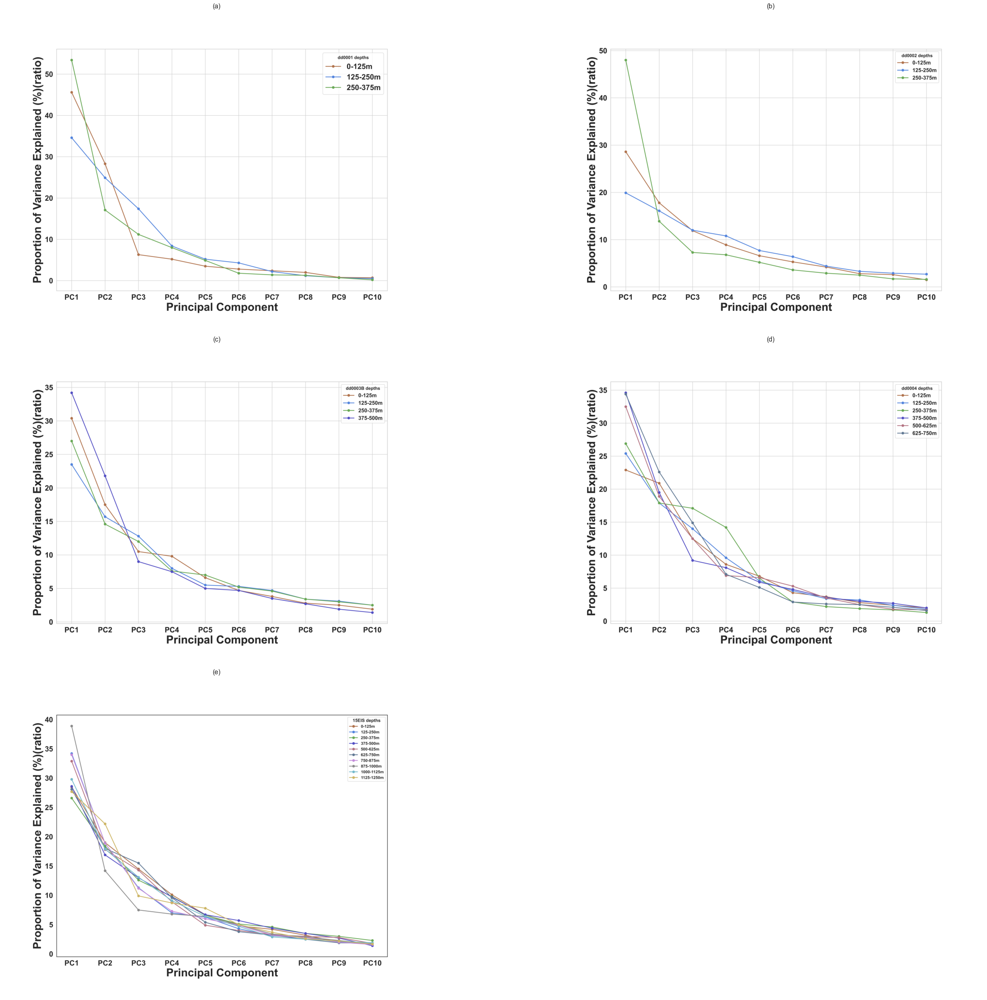

In [612]:
# create figure

fig = plt.figure(figsize=(35, 30))

# setting values to rows and column variables
rows = 3
columns = 2

# reading images
Imaged1 = cv2.imread('/UNSW/PhD/Paper_drafts/Figures/dd001_Elbowplot.png')
Imaged2 = cv2.imread('/UNSW/PhD/Paper_drafts/Figures/dd002_Elbowplot.png')
Imaged3 = cv2.imread('/UNSW/PhD/Paper_drafts/Figures/dd003B_Elbowplot.png')
Imaged4 = cv2.imread('/UNSW/PhD/Paper_drafts/Figures/dd004_Elbowplot.png')
Imaged5 = cv2.imread('/UNSW/PhD/Paper_drafts/Figures/15EIS_Elbowplot.png')

# Adds a subplot at the 1st position
fig.add_subplot(rows, columns, 1)

# showing image
plt.imshow(Imaged1)
plt.axis('off')
plt.title("(a)")

# Adds a subplot at the 2nd position
fig.add_subplot(rows, columns, 2)

# showing image
plt.imshow(Imaged2)
plt.axis('off')
plt.title("(b)")

# Adds a subplot at the 3rd position
fig.add_subplot(rows, columns, 3)

# showing image
plt.imshow(Imaged3)
plt.axis('off')
plt.title("(c)")

# Adds a subplot at the 4th position
fig.add_subplot(rows, columns, 4)

# showing image
plt.imshow(Imaged4)
plt.axis('off')
plt.title("(d)")

# Adds a subplot at the 4th position
fig.add_subplot(rows, columns, 5)

# showing image
plt.imshow(Imaged5)
plt.axis('off')
plt.title("(e)")
plt.tight_layout()

plt.savefig('/UNSW/PhD/Paper_drafts/Figures/All_Drillhole_Elbowplot.png', bbox_inches='tight', dpi = 300)

In [ ]:
# https://bleedai.com/super-resolution-with-opencv/
#!pip install Pillow